### Decide patch size

* mmp-x = mmp-y = 0.5 um
* Let's try these patch size:
    * 44 x 44: There are 147204 useful patches in all. 
    * 92 x 92: There are 125570 patches in all,  There are 29105 useful patches in all
    * 188 x 188: There are 29962 patches in all, There are 6179 useful patches in all
    * 380 x 380:  There are 7280 patches in all, There are 1216 useful patches in all

In [1]:
import os
os.environ['PATH']="D:/openslide-win64-20171122/bin"+';'+os.environ['PATH']
import openslide
import xml
import xml.etree.ElementTree as ET
import PIL
import PIL.ImageDraw as ImageDraw
import PIL.Image as Image
from shapely.geometry import Polygon, Point
import matplotlib.pyplot as plt
from skimage import measure
from skimage.transform import resize
import numpy as np


import torch
import torch.utils.data as data_utils
from torchvision import datasets, transforms
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
from torch.autograd import Variable
import imageio

# Crop patches and save

### PatchDataset

In [2]:
class TSDataset_save(data_utils.Dataset):
    def __init__(self,slidedir, annotdir, patch_shape, energy_threshold):
        self.slidedir = slidedir
        self.annotdir = annotdir
        self.patch_shape = patch_shape
        self.energy_threshold = energy_threshold
        
        self.slide = openslide.OpenSlide(slidedir)
        self.slide_shape = self.slide.dimensions
        self.annot_mask = self.read_annotation()
        self.grid = self.create_grid()
        #print(self.grid)
        
        
    def read_annotation(self):
        tree = ET.parse(self.annotdir)
        root = tree.getroot()
        points_arr_tumor = []
        points_arr_stroma = []
        for r in root.iter('Annotation'):
            if r.attrib['Id']== '1':
                for v in r.iter('Vertex'):
                    points_arr_tumor.append((int(v.attrib['X']), int(v.attrib['Y'])))
            if r.attrib['Id']== '2':
                for v in r.iter('Vertex'):
                    points_arr_stroma.append((int(v.attrib['X']), int(v.attrib['Y'])))
        points_tumor = tuple(points_arr_tumor)
        points_stroma = tuple(points_arr_stroma)
        mask =  Image.new('1', self.slide_shape)
        draw = ImageDraw.Draw(mask)
        draw.polygon(points_tumor, fill=1, outline=1)
        draw.polygon(points_stroma, fill=2, outline=2)
      
        return mask
    
    def create_grid(self):
        grid = []
        num_grid_x = self.slide_shape[0] // self.patch_shape[0]
        num_grid_y = self.slide_shape[1] // self.patch_shape[1]
        for i in range(num_grid_x):
            for j in range(num_grid_y):
                upperLeft = (int(i*self.patch_shape[0]), int(j*self.patch_shape[1]))
                grid.append(upperLeft)
        #print(grid)
        #print(len(grid))
        return grid
    
    def energy(self, patch):
        energy_patch = 0
        for i in range(3):
            energy_patch += np.mean(np.square(np.gradient(patch[:,:,i])))
        energy_patch /= 3
        #print(energy_patch)
        return energy_patch
    
    def __len__(self):
        print(type(self.grid))
        return len(self.grid)
    
    def __getitem__(self,idx):
        upperLeft = self.grid[idx]
        patch = self.slide.read_region(upperLeft,0,self.patch_shape)
        patch = np.array(patch)[:,:,:3]
        mask_patch = self.annot_mask.crop((upperLeft[0],upperLeft[1],
                                           upperLeft[0]+self.patch_shape[0],
                                           upperLeft[1]+self.patch_shape[1]))
        if mask_patch.histogram()[1] >= 0.9 * self.patch_shape[0]*self.patch_shape[1]:
            label_region = 1
        elif mask_patch.histogram()[2] >= 0.9 * self.patch_shape[0]*self.patch_shape[1]:
            label_region = 2
        else:
            label_region = 0
        
        if  self.energy(patch)  <= self.energy_threshold:
            label_energy = 0
        else:
            label_energy = 1
        return patch, [label_region, label_energy]
        
                                                                              
                                                                              

In [3]:
def show_batch(data, label):
    #print(label[0].numpy())
    patches = data.numpy()
    num_patch = patches.shape[0]
    fig, ax = plt.subplots(1,num_patch, squeeze=False)
    for i in range(num_patch):
        ax[0,i].imshow(patches[i,:,:,:])
        ax[0,i].set_title(str(label[0].numpy()[0])+','+str(label[1].numpy()[0]))

### Specify args

In [4]:
class Args():
    def __init__(self):
        self.slidedir = "D:/Ashel-slide/458603.svs"
        self.annotdir = "D:/Ashel-slide/458603.xml"
        self.save_root_dir = "D:/Ashel-slide/458603"
        self.patch_shape = (92,92)
args = Args()


### Create Dataset and Dataloader

In [5]:
patch_set = TSDataset_save(slidedir = args.slidedir, 
                      annotdir = args.annotdir, 
                      patch_shape = args.patch_shape, 
                      energy_threshold = 7000)
patch_loader = data_utils.DataLoader(patch_set, batch_size = 1, shuffle = False)
print("There are {} patches in all".format(len(patch_set)))

<class 'list'>
There are 259600 patches in all


### Save patches

In [6]:
save_root_dir = os.path.join(args.save_root_dir,str(args.patch_shape[0]))
save_tumor_dir = os.path.join(save_root_dir,'tumor')
save_stroma_dir = os.path.join(save_root_dir,'stroma')
#save_other_dir = os.path.join(save_root_dir,'other')
save_tumor_blank = os.path.join(save_tumor_dir,'blank')
save_tumor_non_blank = os.path.join(save_tumor_dir,'non-blank')
save_stroma_blank = os.path.join(save_stroma_dir,'blank')
save_stroma_non_blank = os.path.join(save_stroma_dir,'non-blank')
os.makedirs(save_tumor_blank)
os.makedirs(save_tumor_non_blank)
os.makedirs(save_stroma_blank)
os.makedirs(save_stroma_non_blank)
#os.makedirs(save_other_dir )

In [7]:
number_useful = 0
for batch_idx, (data, label) in enumerate(patch_loader):
    label_region = label[0].numpy()[0]
    label_energy = label[1].numpy()[0]
    patch = data.numpy()[0,:,:,:]
    print(batch_idx,label_region, label_energy)
    # Choose the right subdirectory to write into
    if label_region == 0 :
        continue
        #savedir = save_other_dir
    elif label_region == 1:
        if label_energy == 0:
            savedir = save_tumor_blank
        else:
            savedir = save_tumor_non_blank
            number_useful +=1
    else:
        if label_energy == 0:
            savedir = save_stroma_blank
        else:
            savedir = save_stroma_non_blank
            number_useful +=1
    patch_to_save = Image.fromarray(patch)
    patch_to_save.save(os.path.join(savedir,str(batch_idx)+'.png'))   
    

<class 'list'>
0 0 0
1 0 0
2 0 0
3 0 0
4 0 0
5 0 0
6 0 0
7 0 0
8 0 0
9 0 0
10 0 0
11 0 0
12 0 0
13 0 0
14 0 0
15 0 0
16 0 0
17 0 0
18 0 0
19 0 0
20 0 0
21 0 0
22 0 0
23 0 0
24 0 0
25 0 0
26 0 0
27 0 0
28 0 0
29 0 0
30 0 0
31 0 0
32 0 0
33 0 0
34 0 0
35 0 0
36 0 0
37 0 0
38 0 0
39 0 0
40 0 0
41 0 0
42 0 0
43 0 0
44 0 0
45 0 0
46 0 0
47 0 0
48 0 0
49 0 0
50 0 0
51 0 0
52 0 0
53 0 0
54 0 0
55 0 0
56 0 0
57 0 0
58 0 0
59 0 0
60 0 0
61 0 0
62 0 0
63 0 0
64 0 0
65 0 0
66 0 0
67 0 0
68 0 0
69 0 0
70 0 0
71 0 0
72 0 0
73 0 0
74 0 0
75 0 0
76 0 0
77 0 0
78 0 0
79 0 0
80 0 0
81 0 0
82 0 0
83 0 0
84 0 0
85 0 0
86 0 0
87 0 0
88 0 0
89 0 0
90 0 0
91 0 0
92 0 0
93 0 0
94 0 0
95 0 0
96 0 0
97 0 0
98 0 0
99 0 0
100 0 0
101 0 0
102 0 0
103 0 0
104 0 0
105 0 0
106 0 0
107 0 0
108 0 0
109 0 0
110 0 0
111 0 0
112 0 0
113 0 0
114 0 0
115 0 0
116 0 0
117 0 0
118 0 0
119 0 0
120 0 0
121 0 0
122 0 0
123 0 0
124 0 0
125 0 0
126 0 0
127 0 0
128 0 0
129 0 0
130 0 0
131 0 0
132 0 0
133 0 0
134 0 0
135 0 0
136 0 0

1087 0 0
1088 0 0
1089 0 0
1090 0 0
1091 0 0
1092 0 0
1093 0 0
1094 0 0
1095 0 0
1096 0 0
1097 0 0
1098 0 0
1099 0 0
1100 0 0
1101 0 0
1102 0 0
1103 0 0
1104 0 0
1105 0 0
1106 0 0
1107 0 0
1108 0 0
1109 0 0
1110 0 0
1111 0 0
1112 0 0
1113 0 0
1114 0 0
1115 0 0
1116 0 0
1117 0 0
1118 0 0
1119 0 0
1120 0 0
1121 0 0
1122 0 0
1123 0 0
1124 0 0
1125 0 0
1126 0 0
1127 0 0
1128 0 0
1129 0 0
1130 0 0
1131 0 0
1132 0 0
1133 0 0
1134 0 0
1135 0 0
1136 0 0
1137 0 0
1138 0 0
1139 0 0
1140 0 0
1141 0 0
1142 0 0
1143 0 0
1144 0 0
1145 0 0
1146 0 0
1147 0 0
1148 0 0
1149 0 0
1150 0 0
1151 0 0
1152 0 0
1153 0 0
1154 0 0
1155 0 0
1156 0 0
1157 0 0
1158 0 0
1159 0 0
1160 0 0
1161 0 0
1162 0 0
1163 0 0
1164 0 0
1165 0 0
1166 0 0
1167 0 0
1168 0 0
1169 0 0
1170 0 0
1171 0 0
1172 0 0
1173 0 0
1174 0 0
1175 0 0
1176 0 0
1177 0 0
1178 0 0
1179 0 0
1180 0 0
1181 0 0
1182 0 0
1183 0 0
1184 0 0
1185 0 0
1186 0 0
1187 0 0
1188 0 0
1189 0 0
1190 0 0
1191 0 0
1192 0 0
1193 0 0
1194 0 0
1195 0 0
1196 0 0
1197 0 0
1

2028 0 0
2029 0 0
2030 0 0
2031 0 0
2032 0 0
2033 0 0
2034 0 0
2035 0 0
2036 0 0
2037 0 0
2038 0 0
2039 0 0
2040 0 0
2041 0 0
2042 0 0
2043 0 0
2044 0 0
2045 0 0
2046 0 0
2047 0 0
2048 0 0
2049 0 0
2050 0 0
2051 0 0
2052 0 0
2053 0 0
2054 0 0
2055 0 0
2056 0 0
2057 0 0
2058 0 0
2059 0 0
2060 0 0
2061 0 0
2062 0 0
2063 0 0
2064 0 0
2065 0 0
2066 0 0
2067 0 0
2068 0 0
2069 0 0
2070 0 0
2071 0 0
2072 0 0
2073 0 0
2074 0 0
2075 0 0
2076 0 0
2077 0 0
2078 0 0
2079 0 0
2080 0 0
2081 0 0
2082 0 0
2083 0 0
2084 0 0
2085 0 0
2086 0 0
2087 0 0
2088 0 0
2089 0 0
2090 0 0
2091 0 0
2092 0 0
2093 0 0
2094 0 0
2095 0 0
2096 0 0
2097 0 0
2098 0 0
2099 0 0
2100 0 0
2101 0 0
2102 0 0
2103 0 0
2104 0 0
2105 0 0
2106 0 0
2107 0 0
2108 0 0
2109 0 0
2110 0 0
2111 0 0
2112 0 0
2113 0 0
2114 0 0
2115 0 0
2116 0 0
2117 0 0
2118 0 0
2119 0 0
2120 0 0
2121 0 0
2122 0 0
2123 0 0
2124 0 0
2125 0 0
2126 0 0
2127 0 0
2128 0 0
2129 0 0
2130 0 0
2131 0 0
2132 0 0
2133 0 0
2134 0 0
2135 0 0
2136 0 0
2137 0 0
2138 0 0
2

2975 0 0
2976 0 0
2977 0 0
2978 0 0
2979 0 0
2980 0 0
2981 0 0
2982 0 0
2983 0 0
2984 0 0
2985 0 0
2986 0 0
2987 0 0
2988 0 0
2989 0 0
2990 0 0
2991 0 0
2992 0 0
2993 0 0
2994 0 0
2995 0 0
2996 0 0
2997 0 0
2998 0 0
2999 0 0
3000 0 0
3001 0 0
3002 0 0
3003 0 0
3004 0 0
3005 0 0
3006 0 0
3007 0 0
3008 0 0
3009 0 0
3010 0 0
3011 0 0
3012 0 0
3013 0 0
3014 0 0
3015 0 0
3016 0 0
3017 0 0
3018 0 0
3019 0 0
3020 0 0
3021 0 0
3022 0 0
3023 0 0
3024 0 0
3025 0 0
3026 0 0
3027 0 0
3028 0 0
3029 0 0
3030 0 0
3031 0 0
3032 0 0
3033 0 0
3034 0 0
3035 0 0
3036 0 0
3037 0 0
3038 0 0
3039 0 0
3040 0 0
3041 0 0
3042 0 0
3043 0 0
3044 0 0
3045 0 0
3046 0 0
3047 0 0
3048 0 0
3049 0 0
3050 0 0
3051 0 0
3052 0 0
3053 0 0
3054 0 0
3055 0 0
3056 0 0
3057 0 0
3058 0 0
3059 0 0
3060 0 0
3061 0 0
3062 0 0
3063 0 0
3064 0 0
3065 0 0
3066 0 0
3067 0 0
3068 0 0
3069 0 0
3070 0 0
3071 0 0
3072 0 0
3073 0 0
3074 0 0
3075 0 0
3076 0 0
3077 0 0
3078 0 0
3079 0 0
3080 0 0
3081 0 0
3082 0 0
3083 0 0
3084 0 0
3085 0 0
3

3916 0 0
3917 0 0
3918 0 0
3919 0 0
3920 0 0
3921 0 0
3922 0 0
3923 0 0
3924 0 0
3925 0 0
3926 0 0
3927 0 0
3928 0 0
3929 0 0
3930 0 0
3931 0 0
3932 0 0
3933 0 0
3934 0 0
3935 0 0
3936 0 0
3937 0 0
3938 0 0
3939 0 0
3940 0 0
3941 0 0
3942 0 0
3943 0 0
3944 0 0
3945 0 0
3946 0 0
3947 0 0
3948 0 0
3949 0 0
3950 0 0
3951 0 0
3952 0 0
3953 0 0
3954 0 0
3955 0 0
3956 0 0
3957 0 0
3958 0 0
3959 0 0
3960 0 0
3961 0 0
3962 0 0
3963 0 0
3964 0 0
3965 0 0
3966 0 0
3967 0 0
3968 0 0
3969 0 0
3970 0 0
3971 0 0
3972 0 0
3973 0 0
3974 0 0
3975 0 0
3976 0 0
3977 0 0
3978 0 0
3979 0 0
3980 0 0
3981 0 0
3982 0 0
3983 0 0
3984 0 0
3985 0 0
3986 0 0
3987 0 0
3988 0 0
3989 0 0
3990 0 0
3991 0 0
3992 0 0
3993 0 0
3994 0 0
3995 0 0
3996 0 0
3997 0 0
3998 0 0
3999 0 1
4000 0 0
4001 0 0
4002 0 0
4003 0 0
4004 0 0
4005 0 0
4006 0 0
4007 0 0
4008 0 0
4009 0 0
4010 0 0
4011 0 0
4012 0 0
4013 0 0
4014 0 0
4015 0 0
4016 0 0
4017 0 0
4018 0 0
4019 0 0
4020 0 0
4021 0 0
4022 0 0
4023 0 0
4024 0 0
4025 0 0
4026 0 0
4

4855 0 0
4856 0 0
4857 0 0
4858 0 0
4859 0 0
4860 0 0
4861 0 0
4862 0 0
4863 0 0
4864 0 0
4865 0 0
4866 0 0
4867 0 0
4868 0 0
4869 0 0
4870 0 0
4871 0 0
4872 0 0
4873 0 0
4874 0 0
4875 0 0
4876 0 0
4877 0 0
4878 0 0
4879 0 0
4880 0 0
4881 0 0
4882 0 0
4883 0 0
4884 0 0
4885 0 0
4886 0 0
4887 0 0
4888 0 0
4889 0 0
4890 0 0
4891 0 0
4892 0 0
4893 0 0
4894 0 0
4895 0 0
4896 0 0
4897 0 0
4898 0 0
4899 0 0
4900 0 0
4901 0 0
4902 0 0
4903 0 0
4904 0 0
4905 0 0
4906 0 0
4907 0 0
4908 0 0
4909 0 0
4910 0 0
4911 0 0
4912 0 0
4913 0 0
4914 0 0
4915 0 0
4916 0 0
4917 0 0
4918 0 0
4919 0 0
4920 0 0
4921 0 0
4922 0 0
4923 0 0
4924 0 0
4925 0 0
4926 0 0
4927 0 0
4928 0 0
4929 0 0
4930 0 0
4931 0 0
4932 0 0
4933 0 0
4934 0 0
4935 0 0
4936 0 0
4937 0 0
4938 0 0
4939 0 0
4940 0 0
4941 0 0
4942 0 0
4943 0 0
4944 0 0
4945 0 0
4946 0 0
4947 0 0
4948 0 0
4949 0 0
4950 0 0
4951 0 0
4952 0 0
4953 0 0
4954 0 0
4955 0 0
4956 0 0
4957 0 0
4958 0 0
4959 0 0
4960 0 0
4961 0 0
4962 0 0
4963 0 0
4964 0 0
4965 0 0
4

5839 0 0
5840 0 0
5841 0 0
5842 0 0
5843 0 0
5844 0 0
5845 0 0
5846 0 0
5847 0 0
5848 0 0
5849 0 0
5850 0 0
5851 0 0
5852 0 0
5853 0 0
5854 0 0
5855 0 0
5856 0 0
5857 0 0
5858 0 0
5859 0 0
5860 0 0
5861 0 0
5862 0 0
5863 0 0
5864 0 0
5865 0 0
5866 0 0
5867 0 0
5868 0 0
5869 0 0
5870 0 0
5871 0 0
5872 0 0
5873 0 0
5874 0 0
5875 0 0
5876 0 0
5877 0 0
5878 0 0
5879 0 0
5880 0 0
5881 0 0
5882 0 0
5883 0 0
5884 0 0
5885 0 0
5886 0 0
5887 0 0
5888 0 0
5889 0 0
5890 0 0
5891 0 0
5892 0 0
5893 0 0
5894 0 0
5895 0 0
5896 0 0
5897 0 0
5898 0 0
5899 0 0
5900 0 0
5901 0 0
5902 0 0
5903 0 0
5904 0 0
5905 0 0
5906 0 0
5907 0 0
5908 0 0
5909 0 0
5910 0 0
5911 0 0
5912 0 0
5913 0 0
5914 0 0
5915 0 0
5916 0 0
5917 0 0
5918 0 0
5919 0 0
5920 0 0
5921 0 0
5922 0 0
5923 0 0
5924 0 0
5925 0 0
5926 0 0
5927 0 0
5928 0 0
5929 0 0
5930 0 0
5931 0 0
5932 0 0
5933 0 0
5934 0 0
5935 0 0
5936 0 0
5937 0 0
5938 0 0
5939 0 0
5940 0 0
5941 0 0
5942 0 0
5943 0 0
5944 0 0
5945 0 0
5946 0 0
5947 0 0
5948 0 0
5949 0 0
5

6786 0 0
6787 0 0
6788 0 0
6789 0 0
6790 0 0
6791 0 0
6792 0 0
6793 0 0
6794 0 0
6795 0 0
6796 0 0
6797 0 0
6798 0 0
6799 0 1
6800 0 0
6801 0 0
6802 0 0
6803 0 0
6804 0 0
6805 0 0
6806 0 0
6807 0 0
6808 0 0
6809 0 0
6810 0 0
6811 0 0
6812 0 0
6813 0 0
6814 0 0
6815 0 0
6816 0 0
6817 0 0
6818 0 0
6819 0 0
6820 0 0
6821 0 0
6822 0 0
6823 0 0
6824 0 0
6825 0 0
6826 0 0
6827 0 0
6828 0 0
6829 0 0
6830 0 0
6831 0 0
6832 0 0
6833 0 0
6834 0 0
6835 0 0
6836 0 0
6837 0 0
6838 0 0
6839 0 0
6840 0 0
6841 0 0
6842 0 0
6843 0 0
6844 0 0
6845 0 0
6846 0 0
6847 0 0
6848 0 0
6849 0 0
6850 0 0
6851 0 0
6852 0 0
6853 0 0
6854 0 0
6855 0 0
6856 0 0
6857 0 0
6858 0 0
6859 0 0
6860 0 0
6861 0 0
6862 0 0
6863 0 0
6864 0 0
6865 0 0
6866 0 0
6867 0 0
6868 0 0
6869 0 0
6870 0 0
6871 0 0
6872 0 0
6873 0 0
6874 0 0
6875 0 0
6876 0 0
6877 0 0
6878 0 0
6879 0 0
6880 0 0
6881 0 0
6882 0 0
6883 0 0
6884 0 0
6885 0 0
6886 0 0
6887 0 0
6888 0 0
6889 0 0
6890 0 0
6891 0 0
6892 0 0
6893 0 0
6894 0 0
6895 0 0
6896 0 0
6

7699 0 0
7700 0 0
7701 0 0
7702 0 0
7703 0 0
7704 0 0
7705 0 0
7706 0 0
7707 0 0
7708 0 0
7709 0 0
7710 0 0
7711 0 0
7712 0 0
7713 0 0
7714 0 0
7715 0 0
7716 0 0
7717 0 0
7718 0 0
7719 0 0
7720 0 0
7721 0 0
7722 0 0
7723 0 0
7724 0 0
7725 0 0
7726 0 0
7727 0 0
7728 0 0
7729 0 0
7730 0 0
7731 0 0
7732 0 0
7733 0 0
7734 0 0
7735 0 0
7736 0 0
7737 0 0
7738 0 0
7739 0 0
7740 0 0
7741 0 0
7742 0 0
7743 0 0
7744 0 0
7745 0 0
7746 0 0
7747 0 0
7748 0 0
7749 0 0
7750 0 0
7751 0 0
7752 0 0
7753 0 0
7754 0 0
7755 0 0
7756 0 0
7757 0 0
7758 0 0
7759 0 0
7760 0 0
7761 0 0
7762 0 0
7763 0 0
7764 0 0
7765 0 0
7766 0 0
7767 0 0
7768 0 0
7769 0 0
7770 0 0
7771 0 0
7772 0 0
7773 0 0
7774 0 0
7775 0 0
7776 0 0
7777 0 0
7778 0 0
7779 0 0
7780 0 0
7781 0 0
7782 0 0
7783 0 0
7784 0 0
7785 0 0
7786 0 0
7787 0 0
7788 0 0
7789 0 0
7790 0 0
7791 0 0
7792 0 0
7793 0 0
7794 0 0
7795 0 0
7796 0 0
7797 0 0
7798 0 0
7799 0 0
7800 0 0
7801 0 0
7802 0 0
7803 0 0
7804 0 0
7805 0 0
7806 0 0
7807 0 0
7808 0 0
7809 0 0
7

8622 0 0
8623 0 0
8624 0 0
8625 0 0
8626 0 0
8627 0 0
8628 0 0
8629 0 0
8630 0 0
8631 0 0
8632 0 0
8633 0 0
8634 0 0
8635 0 0
8636 0 0
8637 0 0
8638 0 0
8639 0 0
8640 0 0
8641 0 0
8642 0 0
8643 0 0
8644 0 0
8645 0 0
8646 0 0
8647 0 0
8648 0 0
8649 0 0
8650 0 0
8651 0 0
8652 0 0
8653 0 0
8654 0 0
8655 0 0
8656 0 1
8657 0 1
8658 0 1
8659 0 1
8660 0 0
8661 0 0
8662 0 0
8663 0 0
8664 0 0
8665 0 1
8666 0 1
8667 0 1
8668 0 0
8669 0 1
8670 0 0
8671 0 0
8672 0 0
8673 0 0
8674 0 0
8675 0 0
8676 0 0
8677 0 0
8678 0 0
8679 0 0
8680 0 0
8681 0 0
8682 0 0
8683 0 0
8684 0 0
8685 0 0
8686 0 1
8687 0 1
8688 0 1
8689 0 1
8690 0 0
8691 0 0
8692 2 0
8693 2 0
8694 2 0
8695 2 0
8696 2 0
8697 2 0
8698 2 0
8699 2 0
8700 2 0
8701 2 0
8702 2 0
8703 2 1
8704 2 0
8705 2 0
8706 2 0
8707 2 0
8708 2 0
8709 2 0
8710 0 0
8711 0 0
8712 0 0
8713 0 0
8714 0 0
8715 0 1
8716 0 0
8717 0 0
8718 0 1
8719 0 0
8720 0 0
8721 0 0
8722 0 1
8723 0 0
8724 0 0
8725 0 0
8726 0 0
8727 0 0
8728 0 0
8729 0 0
8730 0 0
8731 0 0
8732 0 0
8

9534 0 0
9535 0 0
9536 0 0
9537 0 0
9538 0 0
9539 0 0
9540 0 0
9541 0 0
9542 0 0
9543 0 0
9544 0 0
9545 0 0
9546 0 0
9547 0 0
9548 0 0
9549 0 0
9550 0 0
9551 0 0
9552 0 0
9553 0 0
9554 0 0
9555 0 0
9556 0 0
9557 0 0
9558 0 0
9559 0 0
9560 0 0
9561 0 0
9562 0 0
9563 0 0
9564 0 0
9565 0 0
9566 0 0
9567 0 0
9568 0 0
9569 0 0
9570 0 0
9571 0 0
9572 0 0
9573 0 0
9574 0 0
9575 0 0
9576 0 0
9577 0 0
9578 0 0
9579 0 0
9580 0 0
9581 0 0
9582 0 0
9583 0 0
9584 0 0
9585 0 0
9586 0 0
9587 0 0
9588 0 0
9589 0 0
9590 0 0
9591 0 0
9592 0 0
9593 0 0
9594 0 0
9595 0 0
9596 0 0
9597 0 0
9598 0 0
9599 0 1
9600 0 0
9601 0 0
9602 0 0
9603 0 0
9604 0 0
9605 0 0
9606 0 0
9607 0 0
9608 0 0
9609 0 0
9610 0 0
9611 0 0
9612 0 0
9613 0 0
9614 0 0
9615 0 0
9616 0 0
9617 0 0
9618 0 0
9619 0 0
9620 0 0
9621 0 0
9622 0 0
9623 0 0
9624 0 0
9625 0 0
9626 0 0
9627 0 0
9628 0 0
9629 0 0
9630 0 0
9631 0 0
9632 0 0
9633 0 0
9634 0 0
9635 0 0
9636 0 0
9637 0 0
9638 0 0
9639 0 0
9640 0 0
9641 0 0
9642 0 0
9643 0 0
9644 0 0
9

10426 0 0
10427 0 0
10428 0 0
10429 0 0
10430 0 0
10431 0 0
10432 0 0
10433 0 0
10434 0 0
10435 0 0
10436 0 0
10437 0 0
10438 0 0
10439 0 0
10440 0 0
10441 0 0
10442 0 0
10443 0 0
10444 0 0
10445 0 0
10446 0 0
10447 0 0
10448 0 0
10449 0 0
10450 0 0
10451 0 0
10452 0 0
10453 0 0
10454 0 0
10455 0 0
10456 0 0
10457 0 0
10458 0 0
10459 0 0
10460 0 0
10461 0 0
10462 0 0
10463 0 0
10464 0 0
10465 0 0
10466 0 0
10467 0 0
10468 0 0
10469 0 0
10470 0 0
10471 0 0
10472 0 0
10473 0 0
10474 0 0
10475 0 0
10476 0 0
10477 0 0
10478 0 0
10479 0 0
10480 0 0
10481 0 0
10482 0 0
10483 0 0
10484 0 0
10485 0 0
10486 0 0
10487 0 0
10488 0 0
10489 0 0
10490 0 0
10491 0 0
10492 0 0
10493 0 0
10494 0 0
10495 0 0
10496 0 0
10497 0 0
10498 0 0
10499 0 0
10500 0 0
10501 0 0
10502 0 0
10503 0 0
10504 0 0
10505 0 0
10506 0 0
10507 0 0
10508 0 0
10509 0 0
10510 0 0
10511 0 0
10512 0 0
10513 0 0
10514 0 0
10515 0 0
10516 0 0
10517 0 0
10518 0 0
10519 0 0
10520 0 0
10521 0 0
10522 0 0
10523 0 0
10524 0 0
10525 0 0


11265 0 0
11266 0 0
11267 0 0
11268 0 0
11269 0 0
11270 0 0
11271 0 0
11272 0 0
11273 0 0
11274 0 0
11275 0 0
11276 0 0
11277 0 0
11278 0 0
11279 0 0
11280 0 0
11281 0 0
11282 0 0
11283 0 0
11284 0 0
11285 0 0
11286 0 0
11287 0 0
11288 0 0
11289 0 0
11290 0 0
11291 0 0
11292 0 0
11293 0 0
11294 0 0
11295 0 0
11296 0 0
11297 0 0
11298 0 0
11299 0 0
11300 0 0
11301 0 0
11302 0 0
11303 0 0
11304 0 0
11305 0 0
11306 0 0
11307 0 0
11308 0 0
11309 0 0
11310 0 0
11311 0 0
11312 0 0
11313 0 0
11314 0 0
11315 0 0
11316 0 0
11317 0 0
11318 0 0
11319 0 0
11320 0 0
11321 0 0
11322 0 0
11323 0 0
11324 0 0
11325 0 0
11326 0 0
11327 0 0
11328 0 0
11329 0 0
11330 0 0
11331 0 0
11332 0 0
11333 0 0
11334 0 0
11335 0 0
11336 0 0
11337 0 0
11338 0 0
11339 0 0
11340 0 0
11341 0 0
11342 0 0
11343 0 0
11344 0 0
11345 0 0
11346 0 0
11347 0 0
11348 0 0
11349 0 0
11350 0 0
11351 0 0
11352 0 0
11353 0 0
11354 0 0
11355 0 0
11356 0 0
11357 0 0
11358 0 0
11359 0 0
11360 0 0
11361 0 0
11362 0 0
11363 0 0
11364 0 0


12129 0 0
12130 0 0
12131 0 0
12132 0 0
12133 0 0
12134 0 0
12135 0 0
12136 0 0
12137 0 0
12138 0 0
12139 0 0
12140 0 0
12141 0 0
12142 0 0
12143 0 0
12144 0 0
12145 0 0
12146 0 0
12147 0 0
12148 0 0
12149 0 0
12150 0 0
12151 0 0
12152 0 0
12153 0 0
12154 0 0
12155 0 0
12156 0 0
12157 0 0
12158 0 0
12159 0 0
12160 0 0
12161 0 0
12162 0 0
12163 0 0
12164 0 0
12165 0 0
12166 0 0
12167 0 0
12168 0 0
12169 0 0
12170 0 0
12171 0 0
12172 0 0
12173 0 0
12174 0 0
12175 0 0
12176 0 0
12177 0 0
12178 0 0
12179 0 0
12180 0 0
12181 0 0
12182 0 0
12183 0 0
12184 0 0
12185 0 0
12186 0 0
12187 0 0
12188 0 0
12189 0 0
12190 0 0
12191 0 0
12192 0 0
12193 0 0
12194 0 0
12195 0 0
12196 0 0
12197 0 0
12198 0 0
12199 0 0
12200 0 0
12201 0 0
12202 0 0
12203 0 0
12204 0 0
12205 0 0
12206 0 0
12207 0 0
12208 0 0
12209 0 0
12210 0 0
12211 0 0
12212 0 0
12213 0 0
12214 0 0
12215 0 0
12216 0 0
12217 0 0
12218 0 0
12219 0 0
12220 0 0
12221 0 0
12222 0 0
12223 0 0
12224 0 0
12225 0 0
12226 0 0
12227 0 0
12228 0 0


12982 0 0
12983 0 0
12984 0 0
12985 0 0
12986 0 0
12987 0 0
12988 0 0
12989 0 0
12990 0 0
12991 0 0
12992 0 0
12993 0 0
12994 0 0
12995 0 0
12996 0 0
12997 0 0
12998 0 0
12999 0 0
13000 0 0
13001 0 0
13002 0 0
13003 0 0
13004 0 0
13005 0 0
13006 0 0
13007 0 0
13008 0 0
13009 0 0
13010 0 0
13011 0 0
13012 0 0
13013 0 0
13014 0 0
13015 0 0
13016 0 0
13017 0 0
13018 0 0
13019 0 0
13020 0 0
13021 0 0
13022 0 0
13023 0 0
13024 0 0
13025 0 0
13026 0 0
13027 0 0
13028 0 0
13029 0 0
13030 0 0
13031 0 0
13032 0 0
13033 0 0
13034 0 0
13035 0 0
13036 0 0
13037 0 0
13038 0 0
13039 0 0
13040 0 0
13041 0 0
13042 0 0
13043 0 0
13044 0 0
13045 0 0
13046 1 0
13047 1 0
13048 1 0
13049 1 0
13050 1 0
13051 1 0
13052 1 0
13053 1 0
13054 1 0
13055 1 0
13056 1 0
13057 1 1
13058 1 1
13059 1 1
13060 1 1
13061 1 1
13062 1 1
13063 1 1
13064 1 1
13065 1 1
13066 1 0
13067 1 0
13068 1 0
13069 1 1
13070 1 1
13071 1 1
13072 1 1
13073 1 1
13074 1 1
13075 1 1
13076 1 0
13077 1 1
13078 1 1
13079 1 1
13080 1 1
13081 1 1


13814 0 0
13815 0 0
13816 0 0
13817 0 0
13818 0 0
13819 0 0
13820 0 0
13821 0 0
13822 0 0
13823 0 0
13824 0 0
13825 0 0
13826 0 0
13827 0 0
13828 0 0
13829 0 0
13830 0 0
13831 0 0
13832 0 0
13833 1 0
13834 1 0
13835 1 0
13836 1 0
13837 1 0
13838 1 0
13839 1 0
13840 1 0
13841 1 0
13842 1 0
13843 1 0
13844 1 0
13845 1 0
13846 1 0
13847 1 0
13848 1 0
13849 1 0
13850 1 0
13851 1 0
13852 1 0
13853 1 0
13854 1 0
13855 1 0
13856 1 0
13857 1 1
13858 1 1
13859 1 1
13860 1 1
13861 1 1
13862 1 1
13863 1 1
13864 1 1
13865 1 1
13866 1 1
13867 1 1
13868 1 1
13869 1 1
13870 1 0
13871 1 0
13872 1 0
13873 1 1
13874 1 1
13875 1 1
13876 1 0
13877 1 1
13878 1 1
13879 1 0
13880 1 1
13881 1 0
13882 1 1
13883 1 1
13884 1 1
13885 1 1
13886 1 0
13887 1 0
13888 1 0
13889 1 1
13890 1 1
13891 1 1
13892 1 1
13893 0 1
13894 2 0
13895 2 0
13896 2 0
13897 2 0
13898 2 0
13899 2 0
13900 2 0
13901 2 0
13902 2 0
13903 2 1
13904 2 0
13905 2 0
13906 2 0
13907 2 0
13908 2 0
13909 2 0
13910 2 1
13911 2 1
13912 2 1
13913 2 1


14656 1 0
14657 1 0
14658 1 1
14659 1 1
14660 1 1
14661 1 1
14662 1 0
14663 1 0
14664 1 1
14665 1 1
14666 1 0
14667 1 1
14668 1 1
14669 1 1
14670 1 1
14671 1 0
14672 1 0
14673 1 0
14674 1 1
14675 1 0
14676 1 1
14677 1 1
14678 1 1
14679 1 1
14680 1 1
14681 1 1
14682 1 0
14683 1 1
14684 1 1
14685 1 1
14686 1 1
14687 1 1
14688 1 0
14689 1 0
14690 1 1
14691 1 1
14692 1 1
14693 0 1
14694 2 1
14695 2 1
14696 2 0
14697 2 0
14698 2 0
14699 2 1
14700 2 0
14701 2 0
14702 2 0
14703 2 0
14704 2 0
14705 2 0
14706 2 0
14707 2 0
14708 2 0
14709 2 0
14710 2 0
14711 2 1
14712 2 0
14713 2 0
14714 2 0
14715 2 0
14716 2 1
14717 2 1
14718 2 0
14719 2 0
14720 2 0
14721 2 0
14722 2 0
14723 2 0
14724 2 0
14725 2 0
14726 2 0
14727 2 0
14728 2 0
14729 2 0
14730 2 0
14731 2 0
14732 2 0
14733 2 0
14734 2 0
14735 2 0
14736 2 0
14737 0 0
14738 0 0
14739 0 0
14740 0 0
14741 0 0
14742 0 0
14743 0 0
14744 0 0
14745 0 0
14746 0 0
14747 0 0
14748 0 0
14749 0 0
14750 0 0
14751 0 0
14752 0 0
14753 0 0
14754 0 0
14755 0 0


15485 1 1
15486 1 1
15487 1 1
15488 1 1
15489 1 1
15490 1 1
15491 1 0
15492 1 0
15493 0 1
15494 2 1
15495 2 0
15496 2 1
15497 2 0
15498 2 0
15499 2 0
15500 2 0
15501 2 0
15502 2 0
15503 2 0
15504 2 1
15505 2 1
15506 2 1
15507 2 0
15508 2 0
15509 2 0
15510 2 0
15511 2 0
15512 2 0
15513 2 0
15514 2 0
15515 2 1
15516 2 1
15517 2 1
15518 2 0
15519 2 0
15520 2 0
15521 2 0
15522 2 0
15523 2 0
15524 2 1
15525 2 0
15526 2 0
15527 2 0
15528 2 0
15529 2 0
15530 2 0
15531 2 0
15532 2 0
15533 2 0
15534 2 0
15535 2 0
15536 2 0
15537 2 0
15538 0 0
15539 0 0
15540 0 0
15541 0 0
15542 0 0
15543 0 0
15544 0 0
15545 0 0
15546 0 0
15547 0 0
15548 0 0
15549 0 0
15550 0 0
15551 0 0
15552 0 0
15553 0 0
15554 0 0
15555 0 0
15556 0 0
15557 0 0
15558 0 0
15559 0 0
15560 0 0
15561 0 0
15562 0 0
15563 0 0
15564 0 0
15565 0 0
15566 0 0
15567 0 0
15568 0 0
15569 0 0
15570 0 0
15571 0 0
15572 0 0
15573 0 0
15574 0 0
15575 0 0
15576 0 0
15577 0 0
15578 0 0
15579 0 0
15580 0 0
15581 0 0
15582 0 0
15583 0 0
15584 0 0


16334 2 0
16335 2 0
16336 2 0
16337 2 0
16338 2 0
16339 2 0
16340 0 0
16341 0 0
16342 0 0
16343 0 0
16344 0 0
16345 0 0
16346 0 0
16347 0 0
16348 0 0
16349 0 0
16350 0 0
16351 0 0
16352 0 0
16353 0 0
16354 0 0
16355 0 0
16356 0 0
16357 0 0
16358 0 0
16359 0 0
16360 0 0
16361 0 0
16362 0 0
16363 0 0
16364 0 0
16365 0 0
16366 0 0
16367 0 0
16368 0 0
16369 0 0
16370 0 0
16371 0 0
16372 0 0
16373 0 0
16374 0 0
16375 0 0
16376 0 0
16377 0 0
16378 0 0
16379 0 0
16380 0 0
16381 0 0
16382 0 0
16383 0 0
16384 0 0
16385 0 0
16386 0 0
16387 0 0
16388 0 0
16389 0 0
16390 0 0
16391 0 0
16392 0 0
16393 0 0
16394 0 0
16395 0 0
16396 0 0
16397 0 0
16398 0 0
16399 0 1
16400 0 0
16401 0 0
16402 0 0
16403 0 0
16404 0 0
16405 0 0
16406 0 0
16407 0 0
16408 0 0
16409 0 0
16410 0 0
16411 0 0
16412 0 0
16413 0 0
16414 0 0
16415 0 0
16416 0 0
16417 0 0
16418 0 0
16419 0 0
16420 0 0
16421 0 0
16422 0 0
16423 0 0
16424 0 0
16425 0 0
16426 0 0
16427 0 0
16428 0 0
16429 0 0
16430 0 0
16431 0 0
16432 0 0
16433 0 0


17183 0 0
17184 0 0
17185 0 0
17186 0 0
17187 0 0
17188 0 0
17189 0 0
17190 0 0
17191 0 0
17192 0 0
17193 0 0
17194 0 0
17195 0 0
17196 0 0
17197 0 0
17198 0 0
17199 0 1
17200 0 0
17201 0 0
17202 0 0
17203 0 0
17204 0 0
17205 0 0
17206 0 0
17207 0 0
17208 0 0
17209 0 0
17210 0 0
17211 0 0
17212 0 0
17213 0 0
17214 0 0
17215 0 0
17216 0 0
17217 0 0
17218 0 0
17219 0 0
17220 0 0
17221 0 0
17222 0 0
17223 0 0
17224 0 0
17225 0 0
17226 0 0
17227 0 0
17228 0 0
17229 0 0
17230 0 0
17231 0 0
17232 0 0
17233 0 0
17234 0 0
17235 0 0
17236 0 0
17237 0 0
17238 0 0
17239 0 0
17240 0 0
17241 0 0
17242 0 0
17243 0 0
17244 0 0
17245 0 0
17246 0 0
17247 0 0
17248 0 0
17249 0 0
17250 0 0
17251 0 0
17252 0 0
17253 0 0
17254 0 0
17255 0 0
17256 0 0
17257 0 0
17258 0 0
17259 0 0
17260 0 0
17261 0 0
17262 0 0
17263 0 0
17264 0 0
17265 0 0
17266 0 0
17267 0 0
17268 0 0
17269 0 0
17270 0 0
17271 0 0
17272 0 0
17273 0 0
17274 0 0
17275 0 0
17276 0 0
17277 0 0
17278 0 0
17279 0 0
17280 0 0
17281 0 0
17282 0 0


18034 0 0
18035 0 0
18036 0 0
18037 0 0
18038 0 0
18039 0 0
18040 0 0
18041 0 0
18042 0 0
18043 0 0
18044 0 0
18045 0 0
18046 0 0
18047 0 0
18048 0 0
18049 0 0
18050 0 0
18051 0 0
18052 0 0
18053 0 0
18054 0 0
18055 0 0
18056 0 0
18057 0 0
18058 0 0
18059 0 0
18060 0 0
18061 0 0
18062 0 0
18063 0 0
18064 0 0
18065 0 0
18066 0 0
18067 0 0
18068 0 0
18069 0 0
18070 0 0
18071 0 0
18072 0 0
18073 0 0
18074 0 0
18075 0 0
18076 0 0
18077 0 0
18078 0 0
18079 0 0
18080 0 0
18081 0 0
18082 0 0
18083 0 0
18084 0 0
18085 0 0
18086 0 0
18087 0 0
18088 0 0
18089 0 0
18090 0 0
18091 0 0
18092 0 0
18093 0 0
18094 0 0
18095 0 0
18096 0 0
18097 0 0
18098 0 0
18099 0 0
18100 0 0
18101 0 0
18102 0 0
18103 0 0
18104 0 0
18105 0 0
18106 0 0
18107 0 0
18108 0 0
18109 0 0
18110 0 0
18111 0 0
18112 0 0
18113 0 0
18114 0 0
18115 0 0
18116 0 0
18117 0 0
18118 0 0
18119 0 0
18120 0 0
18121 0 0
18122 0 0
18123 0 0
18124 0 0
18125 0 0
18126 0 0
18127 0 0
18128 0 0
18129 0 0
18130 0 0
18131 0 0
18132 0 0
18133 0 0


18875 0 0
18876 0 0
18877 0 0
18878 0 0
18879 0 0
18880 0 0
18881 0 0
18882 0 0
18883 0 0
18884 0 0
18885 0 0
18886 0 0
18887 0 0
18888 0 0
18889 0 0
18890 0 0
18891 0 0
18892 0 0
18893 0 0
18894 0 0
18895 0 0
18896 0 0
18897 0 0
18898 0 0
18899 0 0
18900 0 0
18901 0 0
18902 0 0
18903 0 0
18904 0 0
18905 0 0
18906 0 0
18907 0 0
18908 0 0
18909 0 0
18910 0 0
18911 0 0
18912 0 0
18913 0 0
18914 0 0
18915 0 0
18916 0 0
18917 0 0
18918 0 0
18919 0 0
18920 0 0
18921 0 0
18922 0 0
18923 0 0
18924 0 0
18925 0 0
18926 0 0
18927 0 0
18928 0 0
18929 0 0
18930 0 0
18931 0 0
18932 0 0
18933 0 0
18934 0 0
18935 0 0
18936 0 0
18937 0 0
18938 0 0
18939 0 0
18940 0 0
18941 0 0
18942 0 0
18943 0 0
18944 0 0
18945 0 0
18946 0 0
18947 0 0
18948 0 0
18949 0 0
18950 0 0
18951 0 0
18952 0 0
18953 0 0
18954 0 0
18955 0 0
18956 0 0
18957 0 0
18958 0 0
18959 0 0
18960 0 0
18961 0 0
18962 0 0
18963 0 0
18964 0 0
18965 0 0
18966 0 0
18967 0 0
18968 0 0
18969 0 0
18970 0 0
18971 0 0
18972 0 0
18973 0 0
18974 0 0


19715 0 0
19716 0 0
19717 0 0
19718 0 0
19719 0 0
19720 0 0
19721 0 0
19722 0 0
19723 0 0
19724 0 0
19725 0 0
19726 0 0
19727 0 0
19728 0 0
19729 0 0
19730 0 0
19731 0 0
19732 0 0
19733 0 0
19734 0 0
19735 0 0
19736 0 0
19737 0 0
19738 0 0
19739 0 0
19740 0 0
19741 0 0
19742 0 0
19743 0 0
19744 0 0
19745 0 0
19746 0 0
19747 0 0
19748 0 0
19749 0 0
19750 0 0
19751 0 0
19752 0 0
19753 0 0
19754 0 0
19755 0 0
19756 0 0
19757 0 0
19758 0 0
19759 0 0
19760 0 0
19761 0 0
19762 0 0
19763 0 0
19764 0 0
19765 0 0
19766 0 0
19767 0 0
19768 0 0
19769 0 0
19770 0 0
19771 0 0
19772 0 0
19773 0 0
19774 0 0
19775 0 0
19776 0 0
19777 0 0
19778 0 0
19779 1 0
19780 1 0
19781 1 0
19782 1 0
19783 1 0
19784 1 0
19785 1 0
19786 1 0
19787 1 0
19788 1 0
19789 1 0
19790 1 0
19791 1 0
19792 1 0
19793 1 0
19794 1 0
19795 1 0
19796 1 0
19797 1 0
19798 1 0
19799 1 0
19800 1 0
19801 1 0
19802 1 0
19803 1 0
19804 1 0
19805 1 0
19806 1 0
19807 1 0
19808 1 0
19809 1 0
19810 1 0
19811 1 0
19812 1 0
19813 1 0
19814 1 0


20582 1 0
20583 1 0
20584 1 0
20585 1 0
20586 1 0
20587 1 0
20588 1 0
20589 1 0
20590 1 0
20591 1 0
20592 1 0
20593 1 0
20594 1 0
20595 1 0
20596 1 0
20597 1 0
20598 1 0
20599 1 0
20600 1 0
20601 1 0
20602 1 0
20603 1 0
20604 1 0
20605 1 0
20606 1 0
20607 1 0
20608 1 0
20609 1 0
20610 1 0
20611 1 0
20612 1 0
20613 1 0
20614 1 0
20615 1 0
20616 1 0
20617 1 0
20618 1 0
20619 1 0
20620 1 0
20621 1 0
20622 1 0
20623 1 0
20624 1 0
20625 1 0
20626 1 0
20627 1 0
20628 1 0
20629 1 0
20630 1 0
20631 1 0
20632 1 0
20633 1 0
20634 1 0
20635 1 0
20636 1 0
20637 1 0
20638 1 0
20639 1 0
20640 1 0
20641 1 0
20642 1 0
20643 1 1
20644 1 0
20645 1 0
20646 1 0
20647 1 1
20648 1 1
20649 1 1
20650 1 0
20651 1 1
20652 1 1
20653 1 0
20654 1 0
20655 1 0
20656 1 0
20657 1 0
20658 1 0
20659 1 0
20660 1 0
20661 1 0
20662 1 0
20663 1 0
20664 1 0
20665 1 0
20666 1 0
20667 1 0
20668 1 0
20669 1 0
20670 1 0
20671 1 0
20672 1 0
20673 1 0
20674 1 0
20675 1 0
20676 1 0
20677 1 0
20678 1 1
20679 1 0
20680 1 1
20681 1 0


21402 1 0
21403 1 0
21404 1 0
21405 1 0
21406 1 0
21407 1 0
21408 1 0
21409 1 0
21410 1 0
21411 1 0
21412 1 0
21413 1 0
21414 1 0
21415 1 0
21416 1 0
21417 1 0
21418 1 0
21419 1 0
21420 1 0
21421 1 0
21422 1 0
21423 1 0
21424 1 0
21425 1 0
21426 1 0
21427 1 0
21428 1 0
21429 1 0
21430 1 0
21431 1 0
21432 1 0
21433 1 0
21434 1 0
21435 1 0
21436 1 0
21437 1 0
21438 1 0
21439 1 0
21440 1 0
21441 1 0
21442 1 0
21443 1 0
21444 1 0
21445 1 0
21446 1 1
21447 1 0
21448 1 0
21449 1 0
21450 1 0
21451 1 0
21452 1 0
21453 1 1
21454 1 1
21455 1 1
21456 1 0
21457 1 0
21458 1 0
21459 1 0
21460 1 1
21461 1 1
21462 1 1
21463 1 1
21464 1 0
21465 1 0
21466 1 1
21467 1 0
21468 1 0
21469 1 0
21470 1 0
21471 1 0
21472 1 0
21473 1 0
21474 1 1
21475 1 0
21476 1 0
21477 1 0
21478 1 0
21479 1 1
21480 1 0
21481 1 0
21482 1 0
21483 1 0
21484 1 0
21485 1 0
21486 1 1
21487 1 1
21488 1 0
21489 1 0
21490 1 0
21491 1 1
21492 1 1
21493 0 0
21494 0 0
21495 0 0
21496 2 1
21497 2 0
21498 2 0
21499 2 1
21500 2 1
21501 2 1


22251 1 0
22252 1 0
22253 1 0
22254 1 1
22255 1 0
22256 1 0
22257 1 1
22258 1 1
22259 1 1
22260 1 1
22261 1 1
22262 1 1
22263 1 0
22264 1 1
22265 1 1
22266 1 1
22267 1 1
22268 1 0
22269 1 1
22270 1 0
22271 1 1
22272 1 1
22273 1 0
22274 1 0
22275 1 1
22276 1 1
22277 1 0
22278 1 1
22279 1 1
22280 1 0
22281 1 0
22282 1 1
22283 1 1
22284 1 0
22285 1 0
22286 1 1
22287 1 0
22288 1 1
22289 1 1
22290 1 1
22291 1 0
22292 1 1
22293 0 1
22294 0 1
22295 0 1
22296 2 0
22297 2 0
22298 2 0
22299 2 0
22300 2 0
22301 2 0
22302 2 0
22303 2 0
22304 2 0
22305 2 0
22306 2 0
22307 2 0
22308 2 0
22309 2 0
22310 2 0
22311 2 0
22312 2 0
22313 2 0
22314 2 0
22315 2 0
22316 2 1
22317 2 0
22318 2 0
22319 2 0
22320 2 1
22321 2 0
22322 2 0
22323 2 0
22324 2 0
22325 2 0
22326 2 0
22327 2 0
22328 2 0
22329 2 0
22330 2 0
22331 2 0
22332 2 0
22333 2 0
22334 2 0
22335 2 0
22336 2 0
22337 2 0
22338 2 0
22339 2 0
22340 2 0
22341 2 0
22342 2 0
22343 2 0
22344 2 0
22345 2 0
22346 2 0
22347 2 0
22348 2 0
22349 2 0
22350 2 0


23080 1 0
23081 1 0
23082 1 0
23083 1 1
23084 1 1
23085 1 1
23086 1 0
23087 1 0
23088 1 1
23089 1 1
23090 1 1
23091 1 1
23092 1 0
23093 0 0
23094 0 0
23095 0 0
23096 2 0
23097 2 0
23098 2 0
23099 2 0
23100 2 0
23101 2 0
23102 2 0
23103 2 0
23104 2 0
23105 2 0
23106 2 0
23107 2 1
23108 2 0
23109 2 0
23110 2 0
23111 2 0
23112 2 0
23113 2 0
23114 2 0
23115 2 0
23116 2 0
23117 2 0
23118 2 0
23119 2 0
23120 2 0
23121 2 0
23122 2 1
23123 2 1
23124 2 0
23125 2 0
23126 2 0
23127 2 0
23128 2 0
23129 2 0
23130 2 0
23131 2 0
23132 2 0
23133 2 0
23134 2 0
23135 2 0
23136 2 0
23137 2 0
23138 2 0
23139 2 0
23140 2 0
23141 2 0
23142 2 0
23143 2 0
23144 2 0
23145 2 0
23146 2 0
23147 2 0
23148 2 0
23149 2 0
23150 2 0
23151 2 0
23152 2 0
23153 2 0
23154 2 0
23155 2 0
23156 2 0
23157 2 0
23158 2 0
23159 2 0
23160 0 0
23161 0 0
23162 0 0
23163 0 0
23164 0 0
23165 0 0
23166 0 0
23167 0 0
23168 0 0
23169 0 0
23170 0 0
23171 0 0
23172 0 0
23173 0 0
23174 0 0
23175 0 0
23176 0 0
23177 0 0
23178 0 0
23179 0 0


23907 2 0
23908 2 0
23909 2 0
23910 2 1
23911 2 0
23912 2 0
23913 2 0
23914 2 0
23915 2 0
23916 2 0
23917 2 0
23918 2 0
23919 2 0
23920 2 0
23921 2 1
23922 2 1
23923 2 1
23924 2 0
23925 2 0
23926 2 1
23927 2 0
23928 2 0
23929 2 0
23930 2 0
23931 2 0
23932 2 0
23933 2 0
23934 2 0
23935 2 0
23936 2 0
23937 2 0
23938 2 0
23939 2 0
23940 2 0
23941 2 0
23942 2 0
23943 2 0
23944 2 0
23945 2 0
23946 2 0
23947 2 0
23948 2 0
23949 2 0
23950 2 0
23951 2 0
23952 2 0
23953 2 0
23954 2 0
23955 2 0
23956 2 0
23957 2 0
23958 2 0
23959 2 0
23960 2 0
23961 2 0
23962 0 0
23963 0 0
23964 0 0
23965 0 0
23966 0 0
23967 0 0
23968 0 0
23969 0 0
23970 0 0
23971 0 0
23972 0 0
23973 0 0
23974 0 0
23975 0 0
23976 0 0
23977 0 0
23978 0 0
23979 0 0
23980 0 0
23981 0 0
23982 0 0
23983 0 0
23984 0 0
23985 0 0
23986 0 0
23987 0 0
23988 0 0
23989 0 0
23990 0 0
23991 0 0
23992 0 0
23993 0 0
23994 0 0
23995 0 0
23996 0 0
23997 0 0
23998 0 0
23999 0 0
24000 0 0
24001 0 0
24002 0 0
24003 0 0
24004 0 0
24005 0 0
24006 0 0


24750 2 0
24751 2 0
24752 2 0
24753 2 0
24754 2 0
24755 2 0
24756 2 0
24757 2 0
24758 2 0
24759 2 0
24760 2 0
24761 2 0
24762 2 0
24763 0 0
24764 0 0
24765 0 0
24766 0 0
24767 0 0
24768 0 0
24769 0 0
24770 0 0
24771 0 0
24772 0 0
24773 0 0
24774 0 0
24775 0 0
24776 0 0
24777 0 0
24778 0 0
24779 0 0
24780 0 0
24781 0 0
24782 0 0
24783 0 0
24784 0 0
24785 0 0
24786 0 0
24787 0 0
24788 0 0
24789 0 0
24790 0 0
24791 0 0
24792 0 0
24793 0 0
24794 0 0
24795 0 0
24796 0 0
24797 0 0
24798 0 0
24799 0 0
24800 0 0
24801 0 0
24802 0 0
24803 0 0
24804 0 0
24805 0 0
24806 0 0
24807 0 0
24808 0 0
24809 0 0
24810 0 0
24811 0 0
24812 0 0
24813 0 0
24814 0 0
24815 0 0
24816 0 0
24817 0 0
24818 0 0
24819 0 0
24820 0 0
24821 0 0
24822 0 0
24823 0 0
24824 0 0
24825 0 0
24826 0 0
24827 0 0
24828 0 0
24829 0 0
24830 0 0
24831 0 0
24832 0 0
24833 0 0
24834 0 0
24835 0 0
24836 0 0
24837 0 0
24838 0 0
24839 0 0
24840 0 0
24841 0 0
24842 0 0
24843 0 0
24844 0 0
24845 0 0
24846 0 0
24847 0 0
24848 0 0
24849 0 0


25629 0 0
25630 0 0
25631 0 0
25632 0 0
25633 0 0
25634 0 0
25635 0 0
25636 0 0
25637 0 0
25638 0 0
25639 0 0
25640 0 0
25641 0 0
25642 0 0
25643 0 0
25644 0 0
25645 0 0
25646 0 0
25647 0 0
25648 0 0
25649 0 0
25650 0 0
25651 0 0
25652 0 0
25653 0 0
25654 0 0
25655 0 0
25656 0 0
25657 0 0
25658 0 0
25659 0 0
25660 0 0
25661 0 0
25662 0 0
25663 0 0
25664 0 0
25665 0 0
25666 0 0
25667 0 0
25668 0 0
25669 0 0
25670 0 0
25671 0 0
25672 0 0
25673 0 0
25674 0 0
25675 0 0
25676 0 0
25677 0 0
25678 0 0
25679 0 0
25680 0 0
25681 0 0
25682 0 0
25683 0 0
25684 0 0
25685 0 0
25686 0 0
25687 0 0
25688 0 0
25689 0 0
25690 0 0
25691 0 0
25692 0 0
25693 0 0
25694 0 0
25695 0 0
25696 0 0
25697 0 0
25698 0 0
25699 0 0
25700 0 0
25701 0 0
25702 0 0
25703 0 0
25704 0 0
25705 0 0
25706 0 0
25707 0 0
25708 0 0
25709 0 0
25710 0 0
25711 0 0
25712 0 0
25713 0 0
25714 0 0
25715 0 0
25716 0 0
25717 0 0
25718 0 0
25719 0 0
25720 0 0
25721 0 0
25722 0 0
25723 0 0
25724 0 0
25725 0 0
25726 0 0
25727 0 0
25728 0 0


26487 0 0
26488 0 0
26489 0 0
26490 0 0
26491 0 0
26492 0 0
26493 0 0
26494 0 0
26495 0 0
26496 0 0
26497 0 0
26498 0 0
26499 0 0
26500 0 0
26501 0 0
26502 0 0
26503 0 0
26504 0 0
26505 0 0
26506 0 0
26507 0 0
26508 0 0
26509 0 0
26510 0 0
26511 0 0
26512 0 0
26513 0 0
26514 0 0
26515 0 0
26516 0 0
26517 0 0
26518 0 0
26519 0 0
26520 0 0
26521 0 0
26522 0 0
26523 0 0
26524 0 0
26525 0 0
26526 0 0
26527 0 0
26528 0 0
26529 0 0
26530 0 0
26531 0 0
26532 0 0
26533 0 0
26534 0 0
26535 0 0
26536 0 0
26537 0 0
26538 0 0
26539 0 0
26540 0 0
26541 0 0
26542 0 0
26543 0 0
26544 0 0
26545 0 0
26546 0 0
26547 0 0
26548 0 0
26549 0 0
26550 0 0
26551 0 0
26552 0 0
26553 0 0
26554 0 0
26555 0 0
26556 0 0
26557 0 0
26558 0 0
26559 0 0
26560 0 0
26561 0 0
26562 0 0
26563 0 0
26564 0 0
26565 1 0
26566 1 0
26567 1 0
26568 1 0
26569 1 0
26570 1 0
26571 1 0
26572 1 0
26573 1 0
26574 1 0
26575 1 0
26576 1 0
26577 1 0
26578 1 0
26579 1 0
26580 1 0
26581 1 0
26582 1 0
26583 1 0
26584 1 0
26585 1 0
26586 1 0


27310 0 0
27311 0 0
27312 0 0
27313 0 0
27314 0 0
27315 0 0
27316 0 0
27317 0 0
27318 0 0
27319 0 0
27320 0 0
27321 0 0
27322 0 0
27323 0 0
27324 0 0
27325 0 0
27326 0 0
27327 0 0
27328 0 0
27329 0 0
27330 0 0
27331 0 0
27332 0 0
27333 0 0
27334 0 0
27335 0 0
27336 0 0
27337 0 0
27338 0 0
27339 0 0
27340 0 0
27341 0 0
27342 0 0
27343 0 0
27344 0 0
27345 0 0
27346 0 0
27347 0 0
27348 0 0
27349 0 0
27350 0 0
27351 0 0
27352 0 0
27353 0 0
27354 0 0
27355 0 0
27356 0 0
27357 0 0
27358 0 0
27359 0 0
27360 0 0
27361 0 0
27362 0 0
27363 1 0
27364 1 0
27365 1 0
27366 1 0
27367 1 0
27368 1 0
27369 1 0
27370 1 0
27371 1 0
27372 1 0
27373 1 0
27374 1 0
27375 1 0
27376 1 0
27377 1 0
27378 1 0
27379 1 0
27380 1 0
27381 1 0
27382 1 0
27383 1 0
27384 1 0
27385 1 0
27386 1 0
27387 1 0
27388 1 0
27389 1 0
27390 1 0
27391 1 0
27392 1 0
27393 1 0
27394 1 0
27395 1 0
27396 1 0
27397 1 0
27398 1 0
27399 1 0
27400 1 0
27401 1 0
27402 1 0
27403 1 0
27404 1 0
27405 1 0
27406 1 0
27407 1 0
27408 1 0
27409 1 0


28154 0 0
28155 0 0
28156 0 0
28157 0 0
28158 0 0
28159 0 0
28160 0 0
28161 0 0
28162 0 0
28163 1 0
28164 1 0
28165 1 0
28166 1 0
28167 1 0
28168 1 0
28169 1 0
28170 1 0
28171 1 0
28172 1 0
28173 1 0
28174 1 0
28175 1 0
28176 1 0
28177 1 0
28178 1 0
28179 1 0
28180 1 0
28181 1 0
28182 1 0
28183 1 0
28184 1 0
28185 1 0
28186 1 0
28187 1 0
28188 1 0
28189 1 0
28190 1 0
28191 1 0
28192 1 0
28193 1 0
28194 1 0
28195 1 0
28196 1 0
28197 1 0
28198 1 0
28199 1 0
28200 1 0
28201 1 0
28202 1 0
28203 1 0
28204 1 0
28205 1 0
28206 1 0
28207 1 0
28208 1 0
28209 1 0
28210 1 0
28211 1 0
28212 1 0
28213 1 0
28214 1 0
28215 1 0
28216 1 0
28217 1 0
28218 1 1
28219 1 1
28220 1 1
28221 1 0
28222 1 0
28223 1 0
28224 1 1
28225 1 1
28226 1 0
28227 1 1
28228 1 0
28229 1 1
28230 1 0
28231 1 1
28232 1 1
28233 1 1
28234 1 1
28235 1 1
28236 1 1
28237 1 0
28238 1 1
28239 1 0
28240 1 0
28241 1 1
28242 1 1
28243 1 1
28244 1 1
28245 1 0
28246 1 0
28247 1 0
28248 1 0
28249 1 1
28250 1 1
28251 1 1
28252 1 0
28253 1 1


28980 1 0
28981 1 0
28982 1 0
28983 1 0
28984 1 0
28985 1 0
28986 1 0
28987 1 0
28988 1 0
28989 1 0
28990 1 0
28991 1 0
28992 1 0
28993 1 0
28994 1 0
28995 1 0
28996 1 0
28997 1 0
28998 1 0
28999 1 0
29000 1 0
29001 1 0
29002 1 0
29003 1 0
29004 1 0
29005 1 0
29006 1 0
29007 1 0
29008 1 0
29009 1 0
29010 1 0
29011 1 0
29012 1 0
29013 1 0
29014 1 0
29015 1 0
29016 1 0
29017 1 0
29018 1 0
29019 1 1
29020 1 1
29021 1 0
29022 1 0
29023 1 0
29024 1 1
29025 1 1
29026 1 1
29027 1 0
29028 1 0
29029 1 1
29030 1 1
29031 1 0
29032 1 0
29033 1 0
29034 1 1
29035 1 0
29036 1 1
29037 1 0
29038 1 0
29039 1 0
29040 1 1
29041 1 1
29042 1 1
29043 1 0
29044 1 0
29045 1 0
29046 1 1
29047 1 1
29048 1 1
29049 1 0
29050 1 1
29051 1 1
29052 1 1
29053 1 1
29054 1 1
29055 1 1
29056 1 1
29057 1 1
29058 1 1
29059 1 1
29060 1 1
29061 1 1
29062 1 1
29063 1 1
29064 1 1
29065 1 0
29066 1 0
29067 1 0
29068 1 1
29069 1 1
29070 1 0
29071 1 0
29072 1 0
29073 1 0
29074 1 0
29075 1 0
29076 1 0
29077 1 1
29078 1 0
29079 1 1


29800 1 0
29801 1 0
29802 1 0
29803 1 0
29804 1 0
29805 1 0
29806 1 0
29807 1 0
29808 1 0
29809 1 0
29810 1 0
29811 1 0
29812 1 0
29813 1 0
29814 1 0
29815 1 0
29816 1 0
29817 1 0
29818 1 0
29819 1 0
29820 1 1
29821 1 1
29822 1 0
29823 1 0
29824 1 0
29825 1 0
29826 1 1
29827 1 1
29828 1 1
29829 1 0
29830 1 1
29831 1 0
29832 1 0
29833 1 0
29834 1 0
29835 1 1
29836 1 0
29837 1 1
29838 1 0
29839 1 0
29840 1 1
29841 1 0
29842 1 1
29843 1 0
29844 1 0
29845 1 0
29846 1 1
29847 1 1
29848 1 1
29849 1 0
29850 1 0
29851 1 0
29852 1 1
29853 1 1
29854 1 1
29855 1 0
29856 1 1
29857 1 1
29858 1 1
29859 1 0
29860 1 1
29861 1 1
29862 1 1
29863 1 1
29864 1 0
29865 1 0
29866 1 0
29867 1 1
29868 1 0
29869 1 1
29870 1 0
29871 1 1
29872 1 0
29873 1 0
29874 1 1
29875 1 0
29876 1 0
29877 1 0
29878 1 1
29879 1 1
29880 1 1
29881 1 1
29882 1 1
29883 1 1
29884 1 1
29885 1 1
29886 1 0
29887 1 0
29888 1 0
29889 1 0
29890 1 0
29891 1 0
29892 1 0
29893 0 0
29894 0 1
29895 0 1
29896 0 0
29897 2 0
29898 2 0
29899 2 0


30630 1 0
30631 1 0
30632 1 0
30633 1 0
30634 1 1
30635 1 1
30636 1 1
30637 1 0
30638 1 1
30639 1 0
30640 1 0
30641 1 0
30642 1 1
30643 1 1
30644 1 1
30645 1 1
30646 1 1
30647 1 1
30648 1 1
30649 1 1
30650 1 1
30651 1 1
30652 1 1
30653 1 0
30654 1 1
30655 1 1
30656 1 1
30657 1 1
30658 1 1
30659 1 1
30660 1 1
30661 1 1
30662 1 1
30663 1 1
30664 1 1
30665 1 1
30666 1 1
30667 1 1
30668 1 0
30669 1 0
30670 1 0
30671 1 0
30672 1 0
30673 1 1
30674 1 0
30675 1 0
30676 1 0
30677 1 1
30678 1 1
30679 1 1
30680 1 1
30681 1 1
30682 1 1
30683 1 1
30684 1 1
30685 1 1
30686 1 0
30687 1 0
30688 1 0
30689 1 0
30690 1 0
30691 1 0
30692 1 0
30693 1 0
30694 0 0
30695 0 0
30696 0 0
30697 0 0
30698 2 0
30699 2 0
30700 2 0
30701 2 0
30702 2 0
30703 2 0
30704 2 0
30705 2 0
30706 2 0
30707 2 0
30708 2 0
30709 2 0
30710 2 0
30711 2 0
30712 2 0
30713 2 0
30714 2 1
30715 2 0
30716 2 0
30717 2 0
30718 2 1
30719 2 0
30720 2 0
30721 2 0
30722 2 0
30723 2 0
30724 2 0
30725 2 0
30726 2 0
30727 2 0
30728 2 0
30729 2 0


31469 1 1
31470 1 1
31471 1 1
31472 1 0
31473 1 0
31474 1 1
31475 1 1
31476 1 0
31477 1 0
31478 1 1
31479 1 0
31480 1 1
31481 1 1
31482 1 1
31483 1 0
31484 1 0
31485 1 0
31486 1 0
31487 1 1
31488 1 0
31489 1 0
31490 1 0
31491 1 0
31492 1 0
31493 1 1
31494 0 1
31495 0 1
31496 0 0
31497 0 0
31498 2 0
31499 2 0
31500 2 0
31501 2 0
31502 2 0
31503 2 0
31504 2 0
31505 2 0
31506 2 0
31507 2 0
31508 2 0
31509 2 0
31510 2 0
31511 2 0
31512 2 1
31513 2 1
31514 2 1
31515 2 0
31516 2 0
31517 2 0
31518 2 0
31519 2 0
31520 2 0
31521 2 0
31522 2 0
31523 2 0
31524 2 0
31525 2 0
31526 2 0
31527 2 0
31528 2 0
31529 2 1
31530 2 0
31531 2 0
31532 2 0
31533 2 1
31534 2 0
31535 2 0
31536 2 0
31537 2 0
31538 2 0
31539 2 0
31540 2 0
31541 2 0
31542 2 0
31543 2 0
31544 2 0
31545 2 0
31546 2 0
31547 2 0
31548 2 0
31549 2 0
31550 2 0
31551 2 0
31552 2 0
31553 2 0
31554 2 0
31555 2 0
31556 2 0
31557 2 0
31558 2 0
31559 2 0
31560 2 0
31561 2 0
31562 2 0
31563 2 0
31564 2 0
31565 2 0
31566 2 0
31567 2 0
31568 2 0


32305 2 0
32306 2 0
32307 2 0
32308 2 0
32309 2 0
32310 2 0
32311 2 0
32312 2 1
32313 2 1
32314 2 1
32315 2 1
32316 2 0
32317 2 0
32318 2 0
32319 2 0
32320 2 0
32321 2 0
32322 2 0
32323 2 0
32324 2 0
32325 2 0
32326 2 0
32327 2 0
32328 2 0
32329 2 0
32330 2 0
32331 2 1
32332 2 1
32333 2 1
32334 2 0
32335 2 0
32336 2 1
32337 2 0
32338 2 1
32339 2 1
32340 2 0
32341 2 0
32342 2 0
32343 2 0
32344 2 0
32345 2 0
32346 2 0
32347 2 0
32348 2 0
32349 2 0
32350 2 0
32351 2 0
32352 2 0
32353 2 0
32354 2 0
32355 2 0
32356 2 0
32357 2 0
32358 2 0
32359 2 0
32360 2 0
32361 2 0
32362 2 0
32363 2 0
32364 2 0
32365 2 0
32366 2 0
32367 2 0
32368 2 0
32369 2 0
32370 2 0
32371 2 0
32372 2 0
32373 2 0
32374 2 0
32375 2 0
32376 2 0
32377 0 0
32378 0 0
32379 0 0
32380 0 0
32381 0 0
32382 0 0
32383 0 0
32384 0 0
32385 0 0
32386 0 0
32387 0 0
32388 0 0
32389 0 0
32390 0 0
32391 0 0
32392 0 0
32393 0 0
32394 0 0
32395 0 0
32396 0 0
32397 0 0
32398 0 0
32399 0 0
32400 0 0
32401 0 0
32402 0 0
32403 0 0
32404 0 0


33136 2 0
33137 2 1
33138 2 0
33139 2 1
33140 2 0
33141 2 0
33142 2 1
33143 2 0
33144 2 0
33145 2 0
33146 2 0
33147 2 0
33148 2 0
33149 2 0
33150 2 0
33151 2 0
33152 2 0
33153 2 0
33154 2 0
33155 2 0
33156 2 0
33157 2 0
33158 2 0
33159 2 0
33160 2 0
33161 2 0
33162 2 0
33163 2 0
33164 2 0
33165 2 0
33166 2 0
33167 2 0
33168 2 0
33169 2 0
33170 2 0
33171 2 0
33172 2 0
33173 2 0
33174 2 0
33175 2 0
33176 2 0
33177 2 0
33178 2 0
33179 0 0
33180 0 0
33181 0 0
33182 0 0
33183 0 0
33184 0 0
33185 0 0
33186 0 0
33187 0 0
33188 0 0
33189 0 0
33190 0 0
33191 0 0
33192 0 0
33193 0 0
33194 0 0
33195 0 0
33196 0 0
33197 0 0
33198 0 0
33199 0 1
33200 0 0
33201 0 0
33202 0 0
33203 0 0
33204 0 0
33205 0 0
33206 0 0
33207 0 0
33208 0 0
33209 0 0
33210 0 0
33211 0 0
33212 0 0
33213 0 0
33214 0 0
33215 0 0
33216 0 0
33217 0 0
33218 0 0
33219 0 0
33220 0 0
33221 0 0
33222 0 0
33223 0 0
33224 0 0
33225 0 0
33226 0 0
33227 0 0
33228 0 0
33229 0 0
33230 0 0
33231 0 0
33232 0 0
33233 0 0
33234 0 0
33235 0 0


33970 2 0
33971 2 0
33972 2 0
33973 2 0
33974 2 0
33975 2 0
33976 2 0
33977 2 0
33978 2 0
33979 2 0
33980 0 0
33981 0 0
33982 0 0
33983 0 0
33984 0 0
33985 0 0
33986 0 0
33987 0 0
33988 0 0
33989 0 0
33990 0 0
33991 0 0
33992 0 0
33993 0 0
33994 0 0
33995 0 0
33996 0 0
33997 0 0
33998 0 0
33999 0 1
34000 0 0
34001 0 0
34002 0 0
34003 0 0
34004 0 0
34005 0 0
34006 0 0
34007 0 0
34008 0 0
34009 0 0
34010 0 0
34011 0 0
34012 0 0
34013 0 0
34014 0 0
34015 0 0
34016 0 0
34017 0 0
34018 0 0
34019 0 0
34020 0 0
34021 0 0
34022 0 0
34023 0 0
34024 0 0
34025 0 0
34026 0 0
34027 0 0
34028 0 0
34029 0 0
34030 0 0
34031 0 0
34032 0 0
34033 0 0
34034 0 0
34035 0 0
34036 0 0
34037 0 0
34038 0 0
34039 0 0
34040 0 0
34041 0 0
34042 0 0
34043 0 0
34044 0 0
34045 0 0
34046 0 0
34047 0 0
34048 0 0
34049 0 0
34050 0 0
34051 0 0
34052 0 0
34053 0 0
34054 0 0
34055 0 0
34056 0 0
34057 0 0
34058 0 0
34059 0 0
34060 0 0
34061 0 0
34062 0 0
34063 0 0
34064 0 0
34065 0 0
34066 0 0
34067 0 0
34068 0 0
34069 0 0


34818 0 0
34819 0 0
34820 0 0
34821 0 0
34822 0 0
34823 0 0
34824 0 0
34825 0 0
34826 0 0
34827 0 0
34828 0 0
34829 0 0
34830 0 0
34831 0 0
34832 0 0
34833 0 0
34834 0 0
34835 0 0
34836 0 0
34837 0 0
34838 0 0
34839 0 0
34840 0 0
34841 0 0
34842 0 0
34843 0 0
34844 0 0
34845 0 0
34846 0 0
34847 0 0
34848 0 0
34849 0 0
34850 0 0
34851 0 0
34852 0 0
34853 0 0
34854 0 0
34855 0 0
34856 0 0
34857 0 0
34858 0 0
34859 0 0
34860 0 0
34861 0 0
34862 0 0
34863 0 0
34864 0 0
34865 0 0
34866 0 0
34867 0 0
34868 0 0
34869 0 0
34870 0 0
34871 0 0
34872 0 0
34873 0 0
34874 0 0
34875 0 0
34876 0 0
34877 0 0
34878 0 0
34879 0 0
34880 0 0
34881 0 0
34882 0 0
34883 0 0
34884 0 0
34885 0 0
34886 0 0
34887 0 0
34888 0 0
34889 0 0
34890 0 0
34891 0 0
34892 0 0
34893 0 0
34894 0 0
34895 0 0
34896 0 0
34897 0 0
34898 0 0
34899 0 0
34900 0 0
34901 0 0
34902 0 0
34903 0 0
34904 0 0
34905 0 0
34906 0 0
34907 0 0
34908 0 0
34909 0 0
34910 0 0
34911 0 0
34912 0 0
34913 0 0
34914 0 0
34915 0 0
34916 0 0
34917 0 0


35670 0 0
35671 0 0
35672 0 0
35673 0 0
35674 0 0
35675 0 0
35676 0 0
35677 0 0
35678 0 0
35679 0 0
35680 0 0
35681 0 0
35682 0 0
35683 0 0
35684 0 0
35685 0 0
35686 0 0
35687 0 0
35688 0 0
35689 0 0
35690 0 0
35691 0 0
35692 0 0
35693 0 0
35694 0 0
35695 0 0
35696 0 0
35697 0 0
35698 0 0
35699 0 0
35700 0 0
35701 0 0
35702 0 0
35703 0 0
35704 0 0
35705 0 0
35706 0 0
35707 0 0
35708 0 0
35709 0 0
35710 0 0
35711 0 0
35712 0 0
35713 0 0
35714 0 0
35715 0 0
35716 0 0
35717 0 0
35718 0 0
35719 0 0
35720 0 0
35721 0 0
35722 0 0
35723 0 0
35724 0 0
35725 0 0
35726 0 0
35727 0 0
35728 0 0
35729 0 0
35730 0 0
35731 0 0
35732 0 0
35733 0 0
35734 0 0
35735 0 0
35736 0 0
35737 0 0
35738 0 0
35739 0 0
35740 0 0
35741 0 0
35742 0 0
35743 0 0
35744 0 0
35745 0 0
35746 0 0
35747 0 0
35748 0 0
35749 0 0
35750 0 0
35751 0 0
35752 0 0
35753 0 0
35754 0 0
35755 0 0
35756 1 0
35757 1 0
35758 1 0
35759 1 0
35760 1 0
35761 1 0
35762 1 0
35763 1 0
35764 1 0
35765 1 0
35766 1 0
35767 1 0
35768 1 0
35769 1 0


36547 0 0
36548 0 0
36549 0 0
36550 0 0
36551 0 0
36552 0 0
36553 0 0
36554 0 0
36555 1 0
36556 1 0
36557 1 0
36558 1 0
36559 1 0
36560 1 0
36561 1 0
36562 1 0
36563 1 0
36564 1 0
36565 1 0
36566 1 0
36567 1 0
36568 1 0
36569 1 0
36570 1 0
36571 1 0
36572 1 0
36573 1 0
36574 1 0
36575 1 0
36576 1 0
36577 1 0
36578 1 0
36579 1 0
36580 1 0
36581 1 0
36582 1 0
36583 1 0
36584 1 0
36585 1 0
36586 1 0
36587 1 0
36588 1 0
36589 1 0
36590 1 0
36591 1 0
36592 1 0
36593 1 0
36594 1 0
36595 1 0
36596 1 0
36597 1 0
36598 1 0
36599 1 0
36600 1 0
36601 1 0
36602 1 0
36603 1 0
36604 1 0
36605 1 0
36606 1 0
36607 1 0
36608 1 0
36609 1 0
36610 1 0
36611 1 0
36612 1 0
36613 1 0
36614 1 0
36615 1 0
36616 1 0
36617 1 0
36618 1 0
36619 1 0
36620 1 0
36621 1 0
36622 1 0
36623 1 0
36624 1 0
36625 1 0
36626 1 0
36627 1 0
36628 1 0
36629 1 1
36630 1 1
36631 1 0
36632 1 1
36633 1 1
36634 1 1
36635 1 1
36636 1 0
36637 1 0
36638 1 1
36639 1 1
36640 1 1
36641 1 1
36642 1 1
36643 1 1
36644 1 1
36645 1 0
36646 1 0


37379 1 0
37380 1 0
37381 1 0
37382 1 0
37383 1 0
37384 1 0
37385 1 0
37386 1 0
37387 1 0
37388 1 0
37389 1 0
37390 1 0
37391 1 0
37392 1 0
37393 1 0
37394 1 0
37395 1 0
37396 1 0
37397 1 0
37398 1 0
37399 1 0
37400 1 0
37401 1 0
37402 1 0
37403 1 0
37404 1 0
37405 1 0
37406 1 0
37407 1 0
37408 1 0
37409 1 0
37410 1 0
37411 1 0
37412 1 0
37413 1 0
37414 1 0
37415 1 0
37416 1 0
37417 1 0
37418 1 0
37419 1 0
37420 1 0
37421 1 0
37422 1 0
37423 1 0
37424 1 0
37425 1 0
37426 1 0
37427 1 0
37428 1 1
37429 1 1
37430 1 0
37431 1 0
37432 1 0
37433 1 0
37434 1 0
37435 1 0
37436 1 1
37437 1 0
37438 1 0
37439 1 1
37440 1 1
37441 1 1
37442 1 0
37443 1 1
37444 1 1
37445 1 1
37446 1 0
37447 1 1
37448 1 0
37449 1 1
37450 1 1
37451 1 1
37452 1 1
37453 1 1
37454 1 1
37455 1 1
37456 1 1
37457 1 1
37458 1 1
37459 1 1
37460 1 1
37461 1 0
37462 1 0
37463 1 1
37464 1 1
37465 1 1
37466 1 0
37467 1 1
37468 1 1
37469 1 1
37470 1 1
37471 1 1
37472 1 1
37473 1 1
37474 1 1
37475 1 1
37476 1 1
37477 1 0
37478 1 0


38207 1 0
38208 1 0
38209 1 0
38210 1 0
38211 1 0
38212 1 0
38213 1 0
38214 1 0
38215 1 0
38216 1 0
38217 1 0
38218 1 0
38219 1 0
38220 1 0
38221 1 0
38222 1 0
38223 1 0
38224 1 0
38225 1 0
38226 1 0
38227 1 0
38228 1 1
38229 1 1
38230 1 1
38231 1 1
38232 1 0
38233 1 0
38234 1 0
38235 1 0
38236 1 0
38237 1 1
38238 1 0
38239 1 0
38240 1 1
38241 1 1
38242 1 1
38243 1 1
38244 1 0
38245 1 1
38246 1 1
38247 1 1
38248 1 1
38249 1 0
38250 1 0
38251 1 1
38252 1 1
38253 1 0
38254 1 1
38255 1 1
38256 1 0
38257 1 1
38258 1 1
38259 1 1
38260 1 1
38261 1 1
38262 1 1
38263 1 1
38264 1 0
38265 1 1
38266 1 1
38267 1 1
38268 1 1
38269 1 1
38270 1 1
38271 1 1
38272 1 1
38273 1 1
38274 1 1
38275 1 1
38276 1 1
38277 1 1
38278 1 1
38279 1 1
38280 1 1
38281 1 0
38282 1 0
38283 1 1
38284 1 1
38285 1 1
38286 1 1
38287 1 1
38288 1 1
38289 1 1
38290 1 0
38291 1 1
38292 1 0
38293 1 0
38294 1 0
38295 1 1
38296 1 0
38297 0 0
38298 0 0
38299 0 1
38300 2 0
38301 2 1
38302 2 1
38303 2 1
38304 2 0
38305 2 1
38306 2 1


39039 1 1
39040 1 1
39041 1 1
39042 1 1
39043 1 1
39044 1 0
39045 1 0
39046 1 0
39047 1 1
39048 1 0
39049 1 1
39050 1 1
39051 1 1
39052 1 1
39053 1 1
39054 1 1
39055 1 1
39056 1 1
39057 1 1
39058 1 1
39059 1 1
39060 1 0
39061 1 1
39062 1 1
39063 1 1
39064 1 1
39065 1 1
39066 1 1
39067 1 1
39068 1 1
39069 1 1
39070 1 1
39071 1 1
39072 1 1
39073 1 1
39074 1 1
39075 1 1
39076 1 1
39077 1 0
39078 1 0
39079 1 1
39080 1 1
39081 1 1
39082 1 1
39083 1 1
39084 1 1
39085 1 1
39086 1 1
39087 1 1
39088 1 1
39089 1 1
39090 1 1
39091 1 0
39092 1 0
39093 1 0
39094 1 1
39095 1 1
39096 1 1
39097 0 0
39098 0 0
39099 0 1
39100 2 1
39101 2 0
39102 2 1
39103 2 1
39104 2 1
39105 2 0
39106 2 0
39107 2 1
39108 2 1
39109 2 1
39110 2 0
39111 2 1
39112 2 0
39113 2 0
39114 2 0
39115 2 1
39116 2 0
39117 2 0
39118 2 0
39119 2 0
39120 2 0
39121 2 0
39122 2 0
39123 2 1
39124 2 0
39125 2 0
39126 2 1
39127 2 1
39128 2 0
39129 2 0
39130 2 0
39131 2 0
39132 2 0
39133 2 0
39134 2 1
39135 2 0
39136 2 1
39137 2 0
39138 2 0


39878 1 1
39879 1 1
39880 1 1
39881 1 1
39882 1 1
39883 1 1
39884 1 1
39885 1 1
39886 1 1
39887 1 1
39888 1 1
39889 1 1
39890 1 1
39891 1 1
39892 1 1
39893 1 1
39894 1 1
39895 1 1
39896 1 1
39897 1 0
39898 0 0
39899 0 0
39900 2 1
39901 2 1
39902 2 0
39903 2 1
39904 2 1
39905 2 1
39906 2 1
39907 2 1
39908 2 1
39909 2 1
39910 2 1
39911 2 1
39912 2 0
39913 2 1
39914 2 1
39915 2 0
39916 2 0
39917 2 0
39918 2 0
39919 2 0
39920 2 0
39921 2 1
39922 2 1
39923 2 1
39924 2 0
39925 2 0
39926 2 1
39927 2 1
39928 2 1
39929 2 1
39930 2 1
39931 2 1
39932 2 0
39933 2 0
39934 2 0
39935 2 0
39936 2 0
39937 2 0
39938 2 0
39939 2 0
39940 2 0
39941 2 0
39942 2 0
39943 2 0
39944 2 0
39945 2 0
39946 2 0
39947 2 0
39948 2 0
39949 2 0
39950 2 0
39951 2 0
39952 2 0
39953 2 0
39954 2 0
39955 2 0
39956 2 0
39957 2 0
39958 2 0
39959 2 0
39960 2 0
39961 2 0
39962 2 0
39963 2 0
39964 2 0
39965 2 0
39966 2 0
39967 2 0
39968 2 0
39969 2 0
39970 2 0
39971 2 0
39972 2 0
39973 2 0
39974 2 0
39975 2 0
39976 2 0
39977 2 0


40705 2 1
40706 2 0
40707 2 1
40708 2 0
40709 2 0
40710 2 0
40711 2 0
40712 2 1
40713 2 1
40714 2 1
40715 2 0
40716 2 0
40717 2 0
40718 2 0
40719 2 0
40720 2 0
40721 2 0
40722 2 0
40723 2 1
40724 2 0
40725 2 1
40726 2 0
40727 2 0
40728 2 1
40729 2 0
40730 2 0
40731 2 0
40732 2 0
40733 2 0
40734 2 0
40735 2 1
40736 2 1
40737 2 0
40738 2 1
40739 2 0
40740 2 0
40741 2 0
40742 2 0
40743 2 0
40744 2 0
40745 2 0
40746 2 0
40747 2 0
40748 2 0
40749 2 0
40750 2 0
40751 2 0
40752 2 0
40753 2 0
40754 2 0
40755 2 0
40756 2 0
40757 2 0
40758 2 0
40759 2 0
40760 2 0
40761 2 0
40762 2 0
40763 2 0
40764 2 0
40765 2 0
40766 2 0
40767 2 0
40768 2 0
40769 2 0
40770 2 0
40771 2 0
40772 2 0
40773 2 0
40774 2 0
40775 2 0
40776 2 0
40777 2 0
40778 2 0
40779 2 0
40780 2 0
40781 2 0
40782 2 0
40783 2 0
40784 0 0
40785 0 0
40786 0 0
40787 0 0
40788 0 0
40789 0 0
40790 0 0
40791 0 0
40792 0 0
40793 0 0
40794 0 0
40795 0 0
40796 0 0
40797 0 0
40798 0 0
40799 0 0
40800 0 0
40801 0 0
40802 0 0
40803 0 0
40804 0 0


41558 2 0
41559 2 0
41560 2 0
41561 2 0
41562 2 0
41563 2 0
41564 2 0
41565 2 0
41566 2 0
41567 2 0
41568 2 0
41569 2 0
41570 2 0
41571 2 0
41572 2 0
41573 2 0
41574 2 0
41575 2 0
41576 2 0
41577 2 0
41578 2 0
41579 2 0
41580 2 0
41581 2 0
41582 2 0
41583 2 0
41584 0 0
41585 0 0
41586 0 0
41587 0 0
41588 0 0
41589 0 0
41590 0 0
41591 0 0
41592 0 0
41593 0 0
41594 0 0
41595 0 0
41596 0 0
41597 0 0
41598 0 0
41599 0 1
41600 0 0
41601 0 0
41602 0 0
41603 0 0
41604 0 0
41605 0 0
41606 0 0
41607 0 0
41608 0 0
41609 0 0
41610 0 0
41611 0 0
41612 0 0
41613 0 0
41614 0 0
41615 0 0
41616 0 0
41617 0 0
41618 0 0
41619 0 0
41620 0 0
41621 0 0
41622 0 0
41623 0 0
41624 0 0
41625 0 0
41626 0 0
41627 0 0
41628 0 0
41629 0 0
41630 0 0
41631 0 0
41632 0 0
41633 0 0
41634 0 0
41635 0 0
41636 0 0
41637 0 0
41638 0 0
41639 0 0
41640 0 0
41641 0 0
41642 0 0
41643 0 0
41644 0 0
41645 0 0
41646 0 0
41647 0 0
41648 0 0
41649 0 0
41650 0 0
41651 0 0
41652 0 0
41653 0 0
41654 0 0
41655 0 0
41656 0 0
41657 0 0


42385 0 0
42386 0 0
42387 0 0
42388 0 0
42389 0 0
42390 0 0
42391 0 0
42392 0 0
42393 0 0
42394 0 0
42395 0 0
42396 0 0
42397 0 0
42398 0 0
42399 0 1
42400 0 0
42401 0 0
42402 0 0
42403 0 0
42404 0 0
42405 0 0
42406 0 0
42407 0 0
42408 0 0
42409 0 0
42410 0 0
42411 0 0
42412 0 0
42413 0 0
42414 0 0
42415 0 0
42416 0 0
42417 0 0
42418 0 0
42419 0 0
42420 0 0
42421 0 0
42422 0 0
42423 0 0
42424 0 0
42425 0 0
42426 0 0
42427 0 0
42428 0 0
42429 0 0
42430 0 0
42431 0 0
42432 0 0
42433 0 0
42434 0 0
42435 0 0
42436 0 0
42437 0 0
42438 0 0
42439 0 0
42440 0 0
42441 0 0
42442 0 0
42443 0 0
42444 0 0
42445 0 0
42446 0 0
42447 0 0
42448 0 0
42449 0 0
42450 0 0
42451 0 0
42452 0 0
42453 0 0
42454 0 0
42455 0 0
42456 0 0
42457 0 0
42458 0 0
42459 0 0
42460 0 0
42461 0 0
42462 0 0
42463 0 0
42464 0 0
42465 0 0
42466 0 0
42467 0 0
42468 0 0
42469 0 0
42470 0 0
42471 0 0
42472 0 0
42473 0 0
42474 0 0
42475 0 0
42476 0 0
42477 0 0
42478 0 0
42479 0 0
42480 0 0
42481 0 0
42482 0 0
42483 0 0
42484 0 0


43282 0 0
43283 0 0
43284 0 0
43285 0 0
43286 0 0
43287 0 0
43288 0 0
43289 0 0
43290 0 0
43291 0 0
43292 0 0
43293 0 0
43294 0 0
43295 0 0
43296 0 0
43297 0 0
43298 0 0
43299 0 0
43300 0 0
43301 0 0
43302 0 0
43303 0 0
43304 0 0
43305 0 0
43306 0 0
43307 0 0
43308 0 0
43309 0 0
43310 0 0
43311 0 0
43312 0 0
43313 0 0
43314 0 0
43315 0 0
43316 0 0
43317 0 0
43318 0 0
43319 0 0
43320 0 0
43321 0 0
43322 0 0
43323 0 0
43324 0 0
43325 0 0
43326 0 0
43327 0 0
43328 0 0
43329 0 0
43330 0 0
43331 0 0
43332 0 0
43333 0 0
43334 0 0
43335 0 0
43336 0 0
43337 0 0
43338 0 0
43339 0 0
43340 0 0
43341 0 0
43342 0 0
43343 0 0
43344 0 0
43345 0 0
43346 0 0
43347 0 0
43348 1 0
43349 1 0
43350 1 0
43351 1 0
43352 1 0
43353 1 0
43354 1 0
43355 1 0
43356 1 0
43357 1 0
43358 1 0
43359 1 0
43360 1 0
43361 1 0
43362 1 0
43363 1 0
43364 1 0
43365 1 0
43366 1 0
43367 1 0
43368 1 0
43369 1 0
43370 1 0
43371 1 0
43372 1 0
43373 1 0
43374 1 0
43375 1 0
43376 1 0
43377 1 0
43378 1 0
43379 1 0
43380 1 0
43381 1 0


44149 1 0
44150 1 0
44151 1 0
44152 1 0
44153 1 0
44154 1 0
44155 1 0
44156 1 0
44157 1 0
44158 1 0
44159 1 0
44160 1 0
44161 1 0
44162 1 0
44163 1 0
44164 1 0
44165 1 0
44166 1 0
44167 1 0
44168 1 0
44169 1 0
44170 1 0
44171 1 0
44172 1 0
44173 1 0
44174 1 0
44175 1 0
44176 1 0
44177 1 0
44178 1 0
44179 1 0
44180 1 0
44181 1 0
44182 1 0
44183 1 0
44184 1 0
44185 1 0
44186 1 0
44187 1 0
44188 1 0
44189 1 0
44190 1 0
44191 1 0
44192 1 0
44193 1 0
44194 1 0
44195 1 0
44196 1 0
44197 1 0
44198 1 0
44199 1 0
44200 1 0
44201 1 0
44202 1 0
44203 1 0
44204 1 0
44205 1 0
44206 1 0
44207 1 0
44208 1 0
44209 1 0
44210 1 0
44211 1 0
44212 1 0
44213 1 1
44214 1 1
44215 1 1
44216 1 0
44217 1 1
44218 1 1
44219 1 1
44220 1 1
44221 1 1
44222 1 1
44223 1 1
44224 1 1
44225 1 1
44226 1 1
44227 1 1
44228 1 1
44229 1 1
44230 1 1
44231 1 1
44232 1 1
44233 1 1
44234 1 1
44235 1 1
44236 1 1
44237 1 0
44238 1 0
44239 1 0
44240 1 0
44241 1 0
44242 1 1
44243 1 1
44244 1 1
44245 1 1
44246 1 1
44247 1 0
44248 1 0


44970 1 0
44971 1 0
44972 1 0
44973 1 0
44974 1 0
44975 1 0
44976 1 0
44977 1 0
44978 1 0
44979 1 0
44980 1 0
44981 1 1
44982 1 1
44983 1 1
44984 1 0
44985 1 0
44986 1 0
44987 1 0
44988 1 0
44989 1 0
44990 1 0
44991 1 0
44992 1 0
44993 1 0
44994 1 0
44995 1 0
44996 1 0
44997 1 0
44998 1 0
44999 1 0
45000 1 0
45001 1 0
45002 1 1
45003 1 1
45004 1 0
45005 1 1
45006 1 0
45007 1 1
45008 1 1
45009 1 1
45010 1 1
45011 1 1
45012 1 0
45013 1 1
45014 1 1
45015 1 0
45016 1 1
45017 1 1
45018 1 1
45019 1 1
45020 1 1
45021 1 0
45022 1 1
45023 1 1
45024 1 1
45025 1 1
45026 1 1
45027 1 1
45028 1 1
45029 1 1
45030 1 1
45031 1 1
45032 1 1
45033 1 1
45034 1 1
45035 1 1
45036 1 1
45037 1 1
45038 1 1
45039 1 1
45040 1 1
45041 1 1
45042 1 1
45043 1 0
45044 1 1
45045 1 1
45046 1 0
45047 1 1
45048 1 1
45049 1 1
45050 1 1
45051 1 1
45052 1 0
45053 1 0
45054 1 1
45055 1 1
45056 1 1
45057 1 1
45058 1 0
45059 1 1
45060 1 1
45061 1 1
45062 1 1
45063 1 1
45064 1 1
45065 1 1
45066 1 1
45067 1 1
45068 1 1
45069 1 1


45801 1 0
45802 1 0
45803 1 1
45804 1 1
45805 1 1
45806 1 0
45807 1 0
45808 1 0
45809 1 0
45810 1 0
45811 1 1
45812 1 0
45813 1 1
45814 1 1
45815 1 1
45816 1 0
45817 1 0
45818 1 0
45819 1 0
45820 1 1
45821 1 1
45822 1 1
45823 1 1
45824 1 1
45825 1 1
45826 1 1
45827 1 1
45828 1 1
45829 1 1
45830 1 1
45831 1 1
45832 1 0
45833 1 1
45834 1 1
45835 1 0
45836 1 1
45837 1 1
45838 1 1
45839 1 1
45840 1 1
45841 1 1
45842 1 0
45843 1 1
45844 1 0
45845 1 1
45846 1 1
45847 1 1
45848 1 1
45849 1 0
45850 1 1
45851 1 1
45852 1 1
45853 1 1
45854 1 1
45855 1 1
45856 1 1
45857 1 1
45858 1 1
45859 1 1
45860 1 1
45861 1 1
45862 1 1
45863 1 1
45864 1 1
45865 1 1
45866 1 1
45867 1 1
45868 1 1
45869 1 1
45870 1 1
45871 1 1
45872 1 1
45873 1 1
45874 1 1
45875 1 1
45876 1 1
45877 1 1
45878 1 1
45879 1 1
45880 1 1
45881 1 1
45882 1 1
45883 1 1
45884 1 1
45885 1 1
45886 1 1
45887 1 1
45888 1 1
45889 1 1
45890 1 1
45891 1 1
45892 1 1
45893 1 1
45894 1 1
45895 1 1
45896 1 1
45897 1 1
45898 1 1
45899 1 1
45900 0 1


46654 1 1
46655 1 1
46656 1 1
46657 1 1
46658 1 1
46659 1 1
46660 1 1
46661 1 1
46662 1 1
46663 1 1
46664 1 1
46665 1 1
46666 1 1
46667 1 1
46668 1 1
46669 1 1
46670 1 1
46671 1 1
46672 1 1
46673 1 1
46674 1 1
46675 1 1
46676 1 1
46677 1 0
46678 1 1
46679 1 0
46680 1 1
46681 1 1
46682 1 0
46683 1 1
46684 1 1
46685 1 1
46686 1 1
46687 1 1
46688 1 1
46689 1 1
46690 1 1
46691 1 1
46692 1 1
46693 1 1
46694 1 1
46695 1 1
46696 1 1
46697 1 1
46698 1 1
46699 1 1
46700 0 0
46701 0 1
46702 2 1
46703 2 1
46704 2 1
46705 2 0
46706 2 1
46707 2 1
46708 2 1
46709 2 1
46710 2 0
46711 2 0
46712 2 0
46713 2 1
46714 2 1
46715 2 0
46716 2 0
46717 2 1
46718 2 1
46719 2 1
46720 2 0
46721 2 0
46722 2 1
46723 2 0
46724 2 1
46725 2 1
46726 2 0
46727 2 0
46728 2 1
46729 2 1
46730 2 0
46731 2 0
46732 2 0
46733 2 0
46734 2 0
46735 2 0
46736 2 0
46737 2 0
46738 2 0
46739 2 0
46740 2 0
46741 2 1
46742 2 0
46743 2 0
46744 2 0
46745 2 0
46746 2 0
46747 2 0
46748 2 0
46749 2 0
46750 2 1
46751 2 0
46752 2 0
46753 2 1


47500 1 1
47501 0 0
47502 2 1
47503 2 1
47504 2 1
47505 2 1
47506 2 1
47507 2 1
47508 2 1
47509 2 1
47510 2 0
47511 2 1
47512 2 1
47513 2 1
47514 2 0
47515 2 1
47516 2 0
47517 2 0
47518 2 0
47519 2 0
47520 2 0
47521 2 0
47522 2 1
47523 2 1
47524 2 1
47525 2 1
47526 2 1
47527 2 0
47528 2 0
47529 2 1
47530 2 1
47531 2 0
47532 2 0
47533 2 0
47534 2 1
47535 2 0
47536 2 0
47537 2 0
47538 2 0
47539 2 0
47540 2 1
47541 2 1
47542 2 1
47543 2 0
47544 2 0
47545 2 0
47546 2 0
47547 2 0
47548 2 0
47549 2 0
47550 2 0
47551 2 0
47552 2 0
47553 2 1
47554 2 1
47555 2 1
47556 2 0
47557 2 0
47558 2 0
47559 2 0
47560 2 0
47561 2 1
47562 2 0
47563 2 0
47564 2 0
47565 2 0
47566 2 1
47567 2 0
47568 2 1
47569 2 0
47570 2 0
47571 2 0
47572 2 0
47573 2 1
47574 2 0
47575 2 0
47576 2 0
47577 2 0
47578 2 0
47579 2 0
47580 2 0
47581 2 0
47582 2 0
47583 2 0
47584 2 0
47585 0 0
47586 0 0
47587 0 0
47588 0 0
47589 0 0
47590 0 0
47591 0 0
47592 0 0
47593 0 0
47594 0 0
47595 0 0
47596 0 0
47597 0 0
47598 0 0
47599 0 0


48329 2 1
48330 2 0
48331 2 0
48332 2 0
48333 2 0
48334 2 0
48335 2 0
48336 2 0
48337 2 0
48338 2 0
48339 2 0
48340 2 1
48341 2 1
48342 2 1
48343 2 1
48344 2 0
48345 2 0
48346 2 0
48347 2 0
48348 2 0
48349 2 0
48350 2 0
48351 2 1
48352 2 0
48353 2 0
48354 2 1
48355 2 0
48356 2 0
48357 2 0
48358 2 0
48359 2 0
48360 2 0
48361 2 1
48362 2 1
48363 2 1
48364 2 0
48365 2 0
48366 2 0
48367 2 0
48368 2 0
48369 2 1
48370 2 0
48371 2 0
48372 2 1
48373 2 0
48374 2 0
48375 2 0
48376 2 0
48377 2 0
48378 2 0
48379 2 0
48380 2 0
48381 2 0
48382 2 0
48383 2 0
48384 2 0
48385 0 0
48386 0 0
48387 0 0
48388 0 0
48389 0 0
48390 0 0
48391 0 0
48392 0 0
48393 0 0
48394 0 0
48395 0 0
48396 0 0
48397 0 0
48398 0 0
48399 0 0
48400 0 0
48401 0 0
48402 0 0
48403 0 0
48404 0 0
48405 0 0
48406 0 0
48407 0 0
48408 0 0
48409 0 0
48410 0 0
48411 0 0
48412 0 0
48413 0 0
48414 0 0
48415 0 0
48416 0 0
48417 0 0
48418 0 0
48419 0 0
48420 0 0
48421 0 0
48422 0 0
48423 0 0
48424 0 0
48425 0 0
48426 0 0
48427 0 0
48428 0 0


49169 2 1
49170 2 1
49171 2 1
49172 2 0
49173 2 0
49174 2 0
49175 2 0
49176 2 0
49177 2 1
49178 2 0
49179 2 0
49180 2 0
49181 2 0
49182 2 0
49183 2 0
49184 2 0
49185 0 0
49186 0 0
49187 0 0
49188 0 0
49189 0 0
49190 0 0
49191 0 0
49192 0 0
49193 0 0
49194 0 0
49195 0 0
49196 0 0
49197 0 0
49198 0 0
49199 0 1
49200 0 0
49201 0 0
49202 0 0
49203 0 0
49204 0 0
49205 0 0
49206 0 0
49207 0 0
49208 0 0
49209 0 0
49210 0 0
49211 0 0
49212 0 0
49213 0 0
49214 0 0
49215 0 0
49216 0 0
49217 0 0
49218 0 0
49219 0 0
49220 0 0
49221 0 0
49222 0 0
49223 0 0
49224 0 0
49225 0 0
49226 0 0
49227 0 0
49228 0 0
49229 0 0
49230 0 0
49231 0 0
49232 0 0
49233 0 0
49234 0 0
49235 0 0
49236 0 0
49237 0 0
49238 0 0
49239 0 0
49240 0 0
49241 0 0
49242 0 0
49243 0 0
49244 0 0
49245 0 0
49246 0 0
49247 0 0
49248 0 0
49249 0 0
49250 0 0
49251 0 0
49252 0 0
49253 0 0
49254 0 0
49255 0 0
49256 0 0
49257 0 0
49258 0 0
49259 0 0
49260 0 0
49261 0 0
49262 0 0
49263 0 0
49264 0 0
49265 0 0
49266 0 0
49267 0 0
49268 0 0


50034 0 0
50035 0 0
50036 0 0
50037 0 0
50038 0 0
50039 0 0
50040 0 0
50041 0 0
50042 0 0
50043 0 0
50044 0 0
50045 0 0
50046 0 0
50047 0 0
50048 0 0
50049 0 0
50050 0 0
50051 0 0
50052 0 0
50053 0 0
50054 0 0
50055 0 0
50056 0 0
50057 0 0
50058 0 0
50059 0 0
50060 0 0
50061 0 0
50062 0 0
50063 0 0
50064 0 0
50065 0 0
50066 0 0
50067 0 0
50068 0 0
50069 0 0
50070 0 0
50071 0 0
50072 0 0
50073 0 0
50074 0 0
50075 0 0
50076 0 0
50077 0 0
50078 0 0
50079 0 0
50080 0 0
50081 0 0
50082 0 0
50083 0 0
50084 0 0
50085 0 0
50086 0 0
50087 0 0
50088 0 0
50089 0 0
50090 0 0
50091 0 0
50092 0 0
50093 0 0
50094 0 0
50095 0 0
50096 0 0
50097 0 0
50098 0 0
50099 0 0
50100 0 0
50101 0 0
50102 0 0
50103 0 0
50104 0 0
50105 0 0
50106 0 0
50107 0 0
50108 0 0
50109 0 0
50110 0 0
50111 0 0
50112 0 0
50113 0 0
50114 0 0
50115 0 0
50116 0 0
50117 0 0
50118 0 0
50119 0 0
50120 0 0
50121 0 0
50122 0 0
50123 0 0
50124 0 0
50125 0 0
50126 0 0
50127 0 0
50128 0 0
50129 0 0
50130 0 0
50131 0 0
50132 0 0
50133 0 0


50857 0 0
50858 0 0
50859 0 0
50860 0 0
50861 0 0
50862 0 0
50863 0 0
50864 0 0
50865 0 0
50866 0 0
50867 0 0
50868 0 0
50869 0 0
50870 0 0
50871 0 0
50872 0 0
50873 0 0
50874 0 0
50875 0 0
50876 0 0
50877 0 0
50878 0 0
50879 0 0
50880 0 0
50881 0 0
50882 0 0
50883 0 0
50884 0 0
50885 0 0
50886 0 0
50887 0 0
50888 0 0
50889 0 0
50890 0 0
50891 0 0
50892 0 0
50893 0 0
50894 0 0
50895 0 0
50896 0 0
50897 0 0
50898 0 0
50899 0 0
50900 0 0
50901 0 0
50902 0 0
50903 0 0
50904 0 0
50905 0 0
50906 0 0
50907 0 0
50908 0 0
50909 0 0
50910 0 0
50911 0 0
50912 0 0
50913 0 0
50914 0 0
50915 0 0
50916 0 0
50917 0 0
50918 0 0
50919 0 0
50920 0 0
50921 0 0
50922 0 0
50923 0 0
50924 0 0
50925 0 0
50926 0 0
50927 0 0
50928 0 0
50929 0 0
50930 0 0
50931 0 0
50932 0 0
50933 0 0
50934 0 0
50935 0 0
50936 0 0
50937 0 0
50938 0 0
50939 0 0
50940 1 0
50941 1 0
50942 1 0
50943 1 0
50944 1 0
50945 1 0
50946 1 0
50947 1 0
50948 1 0
50949 1 0
50950 1 0
50951 1 0
50952 1 0
50953 1 0
50954 1 0
50955 1 0
50956 1 0


51679 0 0
51680 0 0
51681 0 0
51682 0 0
51683 0 0
51684 0 0
51685 0 0
51686 0 0
51687 0 0
51688 0 0
51689 0 0
51690 0 0
51691 0 0
51692 0 0
51693 0 0
51694 0 0
51695 0 0
51696 0 0
51697 0 0
51698 0 0
51699 0 0
51700 0 0
51701 0 0
51702 0 0
51703 0 0
51704 0 0
51705 0 0
51706 0 0
51707 0 0
51708 0 0
51709 0 0
51710 0 0
51711 0 0
51712 0 0
51713 0 0
51714 0 0
51715 0 0
51716 0 0
51717 0 0
51718 0 0
51719 0 0
51720 0 0
51721 0 0
51722 0 0
51723 0 0
51724 0 0
51725 0 0
51726 0 0
51727 0 0
51728 0 0
51729 0 0
51730 0 0
51731 0 0
51732 0 0
51733 0 0
51734 0 0
51735 0 0
51736 0 0
51737 0 0
51738 0 0
51739 1 0
51740 1 0
51741 1 0
51742 1 0
51743 1 0
51744 1 0
51745 1 0
51746 1 0
51747 1 0
51748 1 0
51749 1 0
51750 1 0
51751 1 0
51752 1 0
51753 1 0
51754 1 0
51755 1 0
51756 1 0
51757 1 0
51758 1 0
51759 1 0
51760 1 0
51761 1 0
51762 1 0
51763 1 0
51764 1 0
51765 1 0
51766 1 0
51767 1 1
51768 1 1
51769 1 1
51770 1 0
51771 1 1
51772 1 0
51773 1 0
51774 1 0
51775 1 0
51776 1 0
51777 1 0
51778 1 0


52517 0 0
52518 0 0
52519 0 0
52520 0 0
52521 0 0
52522 0 0
52523 0 0
52524 0 0
52525 0 0
52526 0 0
52527 0 0
52528 0 0
52529 0 0
52530 0 0
52531 0 0
52532 0 0
52533 0 0
52534 0 0
52535 0 0
52536 0 0
52537 1 0
52538 1 0
52539 1 0
52540 1 0
52541 1 0
52542 1 0
52543 1 0
52544 1 0
52545 1 0
52546 1 0
52547 1 0
52548 1 0
52549 1 0
52550 1 0
52551 1 0
52552 1 0
52553 1 0
52554 1 0
52555 1 0
52556 1 0
52557 1 0
52558 1 0
52559 1 0
52560 1 0
52561 1 0
52562 1 0
52563 1 0
52564 1 0
52565 1 0
52566 1 0
52567 1 1
52568 1 1
52569 1 1
52570 1 1
52571 1 0
52572 1 0
52573 1 0
52574 1 0
52575 1 0
52576 1 0
52577 1 0
52578 1 0
52579 1 0
52580 1 0
52581 1 0
52582 1 0
52583 1 0
52584 1 0
52585 1 0
52586 1 0
52587 1 0
52588 1 0
52589 1 0
52590 1 0
52591 1 0
52592 1 0
52593 1 0
52594 1 1
52595 1 1
52596 1 1
52597 1 1
52598 1 1
52599 1 1
52600 1 1
52601 1 1
52602 1 1
52603 1 1
52604 1 1
52605 1 1
52606 1 1
52607 1 1
52608 1 1
52609 1 0
52610 1 0
52611 1 1
52612 1 1
52613 1 1
52614 1 1
52615 1 1
52616 1 0


53346 1 0
53347 1 0
53348 1 0
53349 1 0
53350 1 0
53351 1 0
53352 1 0
53353 1 0
53354 1 0
53355 1 0
53356 1 0
53357 1 0
53358 1 0
53359 1 0
53360 1 0
53361 1 0
53362 1 0
53363 1 0
53364 1 0
53365 1 0
53366 1 1
53367 1 1
53368 1 1
53369 1 1
53370 1 0
53371 1 0
53372 1 0
53373 1 0
53374 1 0
53375 1 0
53376 1 0
53377 1 0
53378 1 0
53379 1 0
53380 1 0
53381 1 0
53382 1 0
53383 1 0
53384 1 0
53385 1 0
53386 1 1
53387 1 0
53388 1 0
53389 1 0
53390 1 1
53391 1 1
53392 1 0
53393 1 0
53394 1 1
53395 1 1
53396 1 1
53397 1 0
53398 1 1
53399 1 1
53400 1 0
53401 1 1
53402 1 1
53403 1 0
53404 1 1
53405 1 1
53406 1 1
53407 1 1
53408 1 1
53409 1 1
53410 1 1
53411 1 1
53412 1 1
53413 1 1
53414 1 1
53415 1 1
53416 1 1
53417 1 1
53418 1 1
53419 1 0
53420 1 0
53421 1 0
53422 1 1
53423 1 1
53424 1 1
53425 1 1
53426 1 0
53427 1 1
53428 1 1
53429 1 1
53430 1 1
53431 1 0
53432 1 0
53433 1 0
53434 1 1
53435 1 0
53436 1 0
53437 1 1
53438 1 1
53439 1 0
53440 1 0
53441 1 0
53442 1 0
53443 1 0
53444 1 1
53445 1 1


54187 1 0
54188 1 1
54189 1 0
54190 1 0
54191 1 0
54192 1 0
54193 1 0
54194 1 0
54195 1 0
54196 1 0
54197 1 0
54198 1 0
54199 1 1
54200 1 1
54201 1 1
54202 1 1
54203 1 0
54204 1 1
54205 1 1
54206 1 0
54207 1 1
54208 1 1
54209 1 0
54210 1 1
54211 1 1
54212 1 1
54213 1 1
54214 1 1
54215 1 0
54216 1 0
54217 1 1
54218 1 1
54219 1 0
54220 1 1
54221 1 1
54222 1 0
54223 1 0
54224 1 1
54225 1 0
54226 1 0
54227 1 0
54228 1 0
54229 1 1
54230 1 0
54231 1 0
54232 1 1
54233 1 0
54234 1 0
54235 1 0
54236 1 0
54237 1 0
54238 1 1
54239 1 1
54240 1 1
54241 1 1
54242 1 0
54243 1 0
54244 1 0
54245 1 1
54246 1 1
54247 1 1
54248 1 1
54249 1 1
54250 1 1
54251 1 1
54252 1 1
54253 1 1
54254 1 1
54255 1 1
54256 1 1
54257 1 1
54258 1 1
54259 1 1
54260 1 1
54261 1 1
54262 1 1
54263 1 1
54264 1 1
54265 1 0
54266 1 0
54267 1 0
54268 1 1
54269 1 1
54270 1 1
54271 1 0
54272 1 1
54273 1 1
54274 1 1
54275 1 1
54276 1 1
54277 1 0
54278 1 1
54279 1 1
54280 1 1
54281 1 1
54282 1 1
54283 1 0
54284 1 1
54285 1 1
54286 1 1


55044 1 0
55045 1 0
55046 1 0
55047 1 1
55048 1 1
55049 1 0
55050 1 1
55051 1 1
55052 1 0
55053 1 0
55054 1 1
55055 1 1
55056 1 1
55057 1 0
55058 1 0
55059 1 0
55060 1 1
55061 1 1
55062 1 1
55063 1 1
55064 1 0
55065 1 1
55066 1 1
55067 1 1
55068 1 1
55069 1 1
55070 1 1
55071 1 1
55072 1 1
55073 1 1
55074 1 1
55075 1 1
55076 1 0
55077 1 0
55078 1 0
55079 1 1
55080 1 1
55081 1 1
55082 1 1
55083 1 1
55084 1 1
55085 1 1
55086 1 1
55087 1 1
55088 1 1
55089 1 1
55090 1 1
55091 1 0
55092 1 1
55093 1 1
55094 1 1
55095 1 1
55096 1 1
55097 1 1
55098 1 1
55099 1 1
55100 0 1
55101 0 1
55102 2 1
55103 2 1
55104 2 0
55105 2 0
55106 2 0
55107 2 1
55108 2 1
55109 2 1
55110 2 1
55111 2 0
55112 2 0
55113 2 1
55114 2 1
55115 2 1
55116 2 1
55117 2 1
55118 2 1
55119 2 1
55120 2 1
55121 2 1
55122 2 1
55123 2 1
55124 2 1
55125 2 1
55126 2 1
55127 2 1
55128 2 0
55129 2 1
55130 2 1
55131 2 1
55132 2 1
55133 2 1
55134 2 0
55135 2 1
55136 2 1
55137 2 1
55138 2 0
55139 2 0
55140 2 1
55141 2 1
55142 2 1
55143 2 1


55871 1 1
55872 1 1
55873 1 1
55874 1 1
55875 1 1
55876 1 1
55877 1 1
55878 1 1
55879 1 1
55880 1 1
55881 1 1
55882 1 1
55883 1 1
55884 1 1
55885 1 1
55886 1 1
55887 1 1
55888 1 1
55889 1 1
55890 1 1
55891 1 1
55892 1 1
55893 1 1
55894 1 1
55895 1 1
55896 1 1
55897 1 1
55898 1 1
55899 1 1
55900 0 0
55901 0 1
55902 2 1
55903 2 1
55904 2 1
55905 2 1
55906 2 0
55907 2 1
55908 2 1
55909 2 1
55910 2 1
55911 2 0
55912 2 1
55913 2 1
55914 2 1
55915 2 1
55916 2 1
55917 2 1
55918 2 1
55919 2 1
55920 2 1
55921 2 1
55922 2 1
55923 2 1
55924 2 1
55925 2 1
55926 2 1
55927 2 1
55928 2 1
55929 2 0
55930 2 1
55931 2 1
55932 2 1
55933 2 1
55934 2 1
55935 2 1
55936 2 1
55937 2 1
55938 2 1
55939 2 1
55940 2 1
55941 2 1
55942 2 1
55943 2 1
55944 2 1
55945 2 1
55946 2 1
55947 2 1
55948 2 1
55949 2 1
55950 2 1
55951 2 1
55952 2 1
55953 2 0
55954 2 1
55955 2 1
55956 2 0
55957 2 0
55958 2 0
55959 2 0
55960 2 1
55961 2 1
55962 2 1
55963 2 1
55964 2 0
55965 2 1
55966 2 1
55967 2 1
55968 2 1
55969 2 1
55970 2 0


56701 0 1
56702 2 1
56703 2 1
56704 2 1
56705 2 1
56706 2 1
56707 2 1
56708 2 1
56709 2 1
56710 2 1
56711 2 0
56712 2 1
56713 2 1
56714 2 1
56715 2 1
56716 2 1
56717 2 1
56718 2 1
56719 2 1
56720 2 1
56721 2 1
56722 2 1
56723 2 1
56724 2 1
56725 2 1
56726 2 1
56727 2 1
56728 2 0
56729 2 1
56730 2 1
56731 2 1
56732 2 1
56733 2 1
56734 2 1
56735 2 1
56736 2 1
56737 2 1
56738 2 1
56739 2 1
56740 2 1
56741 2 1
56742 2 1
56743 2 1
56744 2 1
56745 2 1
56746 2 1
56747 2 1
56748 2 1
56749 2 1
56750 2 1
56751 2 1
56752 2 1
56753 2 1
56754 2 1
56755 2 0
56756 2 0
56757 2 0
56758 2 0
56759 2 0
56760 2 0
56761 2 1
56762 2 0
56763 2 0
56764 2 1
56765 2 1
56766 2 0
56767 2 1
56768 2 1
56769 2 1
56770 2 1
56771 2 0
56772 2 1
56773 2 0
56774 2 0
56775 2 0
56776 2 0
56777 2 0
56778 2 0
56779 2 0
56780 2 0
56781 2 0
56782 2 0
56783 2 0
56784 2 0
56785 2 0
56786 0 0
56787 0 0
56788 0 0
56789 0 0
56790 0 0
56791 0 0
56792 0 0
56793 0 0
56794 0 0
56795 0 0
56796 0 0
56797 0 0
56798 0 0
56799 0 0
56800 0 0


57532 2 1
57533 2 1
57534 2 1
57535 2 1
57536 2 1
57537 2 1
57538 2 1
57539 2 1
57540 2 1
57541 2 1
57542 2 1
57543 2 1
57544 2 1
57545 2 1
57546 2 1
57547 2 1
57548 2 1
57549 2 1
57550 2 1
57551 2 1
57552 2 1
57553 2 1
57554 2 1
57555 2 0
57556 2 0
57557 2 0
57558 2 0
57559 2 0
57560 2 0
57561 2 0
57562 2 1
57563 2 0
57564 2 0
57565 2 0
57566 2 1
57567 2 1
57568 2 0
57569 2 0
57570 2 1
57571 2 1
57572 2 1
57573 2 1
57574 2 0
57575 2 0
57576 2 0
57577 2 0
57578 2 0
57579 2 0
57580 2 0
57581 2 0
57582 2 0
57583 2 0
57584 2 0
57585 2 0
57586 0 0
57587 0 0
57588 0 0
57589 0 0
57590 0 0
57591 0 0
57592 0 0
57593 0 0
57594 0 0
57595 0 0
57596 0 0
57597 0 0
57598 0 0
57599 0 0
57600 0 0
57601 0 0
57602 0 0
57603 0 0
57604 0 0
57605 0 0
57606 0 0
57607 0 0
57608 0 0
57609 0 0
57610 0 0
57611 0 0
57612 0 0
57613 0 0
57614 0 0
57615 0 0
57616 0 0
57617 0 0
57618 0 0
57619 0 0
57620 0 0
57621 0 0
57622 0 0
57623 0 0
57624 0 0
57625 0 0
57626 0 0
57627 0 0
57628 0 0
57629 0 0
57630 0 0
57631 0 0


58367 2 1
58368 2 1
58369 2 1
58370 2 1
58371 2 1
58372 2 1
58373 2 0
58374 2 0
58375 2 0
58376 2 0
58377 2 0
58378 2 0
58379 2 0
58380 2 0
58381 2 0
58382 2 0
58383 2 0
58384 2 0
58385 2 0
58386 0 0
58387 0 0
58388 0 0
58389 0 0
58390 0 0
58391 0 0
58392 0 0
58393 0 0
58394 0 0
58395 0 0
58396 0 0
58397 0 0
58398 0 0
58399 0 0
58400 0 0
58401 0 0
58402 0 0
58403 0 0
58404 0 0
58405 0 0
58406 0 0
58407 0 0
58408 0 0
58409 0 0
58410 0 0
58411 0 0
58412 0 0
58413 0 0
58414 0 0
58415 0 0
58416 0 0
58417 0 0
58418 0 0
58419 0 0
58420 0 0
58421 0 0
58422 0 0
58423 0 0
58424 0 0
58425 0 0
58426 0 0
58427 0 0
58428 0 0
58429 0 0
58430 0 0
58431 0 0
58432 0 0
58433 0 0
58434 0 0
58435 0 0
58436 0 0
58437 0 0
58438 0 0
58439 0 0
58440 0 0
58441 0 0
58442 0 0
58443 0 0
58444 0 0
58445 0 0
58446 0 0
58447 0 0
58448 0 0
58449 0 0
58450 0 0
58451 0 0
58452 0 0
58453 0 0
58454 0 0
58455 0 0
58456 0 0
58457 0 0
58458 0 0
58459 0 0
58460 0 0
58461 0 0
58462 0 0
58463 0 0
58464 0 0
58465 0 0
58466 0 0


59226 0 0
59227 0 0
59228 0 0
59229 0 0
59230 0 0
59231 0 0
59232 0 0
59233 0 0
59234 0 0
59235 0 0
59236 0 0
59237 0 0
59238 0 0
59239 0 0
59240 0 0
59241 0 0
59242 0 0
59243 0 0
59244 0 0
59245 0 0
59246 0 0
59247 0 0
59248 0 0
59249 0 0
59250 0 0
59251 0 0
59252 0 0
59253 0 0
59254 0 0
59255 0 0
59256 0 0
59257 0 0
59258 0 0
59259 0 0
59260 0 0
59261 0 0
59262 0 0
59263 0 0
59264 0 0
59265 0 0
59266 0 0
59267 0 0
59268 0 0
59269 0 0
59270 0 0
59271 0 0
59272 0 0
59273 0 0
59274 0 0
59275 0 0
59276 0 0
59277 0 0
59278 0 0
59279 0 0
59280 0 0
59281 0 0
59282 0 0
59283 0 0
59284 0 0
59285 0 0
59286 0 0
59287 0 0
59288 0 0
59289 0 0
59290 0 0
59291 0 0
59292 0 0
59293 0 0
59294 0 0
59295 0 0
59296 0 0
59297 0 0
59298 0 0
59299 0 0
59300 0 0
59301 0 0
59302 0 0
59303 0 0
59304 0 0
59305 0 0
59306 0 0
59307 0 0
59308 0 0
59309 0 0
59310 0 0
59311 0 0
59312 0 0
59313 0 0
59314 0 0
59315 0 0
59316 0 0
59317 0 0
59318 0 0
59319 0 0
59320 0 0
59321 0 0
59322 0 0
59323 0 0
59324 0 0
59325 0 0


60092 0 0
60093 0 0
60094 0 0
60095 0 0
60096 0 0
60097 0 0
60098 0 0
60099 0 0
60100 0 0
60101 0 0
60102 0 0
60103 0 0
60104 0 0
60105 0 0
60106 0 0
60107 0 0
60108 0 0
60109 0 0
60110 0 0
60111 0 0
60112 0 0
60113 0 0
60114 0 0
60115 0 0
60116 0 0
60117 0 0
60118 0 0
60119 0 0
60120 0 0
60121 0 0
60122 0 0
60123 0 0
60124 0 0
60125 0 0
60126 0 0
60127 0 0
60128 0 0
60129 1 0
60130 1 0
60131 1 0
60132 1 0
60133 1 0
60134 1 0
60135 1 0
60136 1 0
60137 1 0
60138 1 0
60139 1 0
60140 1 0
60141 1 0
60142 1 0
60143 1 0
60144 1 0
60145 1 0
60146 1 0
60147 1 0
60148 1 0
60149 1 0
60150 1 0
60151 1 0
60152 1 0
60153 1 0
60154 1 0
60155 1 0
60156 1 0
60157 1 0
60158 1 0
60159 1 0
60160 1 0
60161 1 0
60162 1 0
60163 1 0
60164 1 0
60165 1 0
60166 1 0
60167 1 0
60168 1 0
60169 1 0
60170 1 0
60171 1 0
60172 1 0
60173 1 0
60174 1 0
60175 1 0
60176 1 0
60177 1 0
60178 1 0
60179 1 0
60180 1 0
60181 1 0
60182 1 0
60183 1 0
60184 1 0
60185 1 1
60186 1 1
60187 1 1
60188 1 1
60189 1 0
60190 1 1
60191 1 1


60947 1 0
60948 1 0
60949 1 0
60950 1 0
60951 1 0
60952 1 0
60953 1 0
60954 1 0
60955 1 0
60956 1 0
60957 1 0
60958 1 0
60959 1 0
60960 1 0
60961 1 0
60962 1 0
60963 1 0
60964 1 0
60965 1 0
60966 1 0
60967 1 0
60968 1 0
60969 1 0
60970 1 0
60971 1 0
60972 1 0
60973 1 0
60974 1 0
60975 1 0
60976 1 0
60977 1 0
60978 1 0
60979 1 0
60980 1 0
60981 1 0
60982 1 0
60983 1 0
60984 1 1
60985 1 1
60986 1 1
60987 1 0
60988 1 0
60989 1 1
60990 1 1
60991 1 0
60992 1 0
60993 1 1
60994 1 1
60995 1 1
60996 1 1
60997 1 1
60998 1 1
60999 1 1
61000 1 0
61001 1 1
61002 1 0
61003 1 1
61004 1 1
61005 1 1
61006 1 1
61007 1 1
61008 1 1
61009 1 1
61010 1 1
61011 1 1
61012 1 1
61013 1 1
61014 1 0
61015 1 0
61016 1 0
61017 1 1
61018 1 1
61019 1 1
61020 1 1
61021 1 1
61022 1 1
61023 1 1
61024 1 1
61025 1 1
61026 1 1
61027 1 1
61028 1 0
61029 1 0
61030 1 1
61031 1 1
61032 1 0
61033 1 0
61034 1 1
61035 1 1
61036 1 1
61037 1 1
61038 1 1
61039 1 1
61040 1 1
61041 1 0
61042 1 0
61043 1 0
61044 1 0
61045 1 0
61046 1 0


61794 1 1
61795 1 1
61796 1 1
61797 1 1
61798 1 1
61799 1 1
61800 1 1
61801 1 1
61802 1 1
61803 1 0
61804 1 1
61805 1 1
61806 1 1
61807 1 1
61808 1 1
61809 1 0
61810 1 0
61811 1 0
61812 1 0
61813 1 0
61814 1 0
61815 1 1
61816 1 1
61817 1 1
61818 1 0
61819 1 0
61820 1 0
61821 1 0
61822 1 1
61823 1 1
61824 1 0
61825 1 1
61826 1 1
61827 1 1
61828 1 1
61829 1 1
61830 1 1
61831 1 1
61832 1 0
61833 1 0
61834 1 1
61835 1 1
61836 1 1
61837 1 1
61838 1 1
61839 1 1
61840 1 1
61841 1 0
61842 1 1
61843 1 1
61844 1 1
61845 1 1
61846 1 0
61847 1 0
61848 1 0
61849 1 0
61850 1 1
61851 1 1
61852 1 1
61853 1 0
61854 1 0
61855 1 0
61856 1 1
61857 1 1
61858 1 1
61859 1 0
61860 1 1
61861 1 1
61862 1 1
61863 1 0
61864 1 0
61865 1 1
61866 1 1
61867 1 1
61868 1 1
61869 1 1
61870 1 1
61871 1 1
61872 1 1
61873 1 1
61874 1 1
61875 1 1
61876 1 1
61877 1 1
61878 1 1
61879 1 1
61880 1 0
61881 1 1
61882 1 1
61883 1 1
61884 1 1
61885 1 1
61886 1 1
61887 1 1
61888 1 1
61889 1 0
61890 1 0
61891 1 1
61892 1 1
61893 1 1


62641 1 0
62642 1 1
62643 1 1
62644 1 0
62645 1 0
62646 1 0
62647 1 0
62648 1 0
62649 1 0
62650 1 1
62651 1 1
62652 1 1
62653 1 1
62654 1 0
62655 1 1
62656 1 1
62657 1 1
62658 1 1
62659 1 0
62660 1 1
62661 1 1
62662 1 1
62663 1 0
62664 1 0
62665 1 1
62666 1 1
62667 1 1
62668 1 1
62669 1 1
62670 1 1
62671 1 1
62672 1 1
62673 1 1
62674 1 1
62675 1 1
62676 1 1
62677 1 1
62678 1 1
62679 1 1
62680 1 1
62681 1 1
62682 1 1
62683 1 1
62684 1 0
62685 1 1
62686 1 1
62687 1 1
62688 1 0
62689 1 0
62690 1 1
62691 1 1
62692 1 1
62693 1 1
62694 1 1
62695 1 1
62696 1 1
62697 1 1
62698 1 1
62699 0 1
62700 2 0
62701 2 1
62702 2 1
62703 2 0
62704 2 1
62705 2 0
62706 2 0
62707 2 1
62708 2 1
62709 2 0
62710 2 1
62711 2 1
62712 2 1
62713 2 1
62714 2 1
62715 2 1
62716 2 1
62717 2 1
62718 2 1
62719 2 1
62720 2 1
62721 2 1
62722 2 0
62723 2 0
62724 2 1
62725 2 1
62726 2 1
62727 2 1
62728 2 1
62729 2 1
62730 2 1
62731 2 1
62732 2 1
62733 2 1
62734 2 1
62735 2 1
62736 2 1
62737 2 1
62738 2 1
62739 2 1
62740 2 1


63475 1 1
63476 1 1
63477 1 1
63478 1 0
63479 1 1
63480 1 1
63481 1 0
63482 1 0
63483 1 1
63484 1 0
63485 1 1
63486 1 1
63487 1 1
63488 1 1
63489 1 1
63490 1 1
63491 1 1
63492 1 1
63493 1 1
63494 1 1
63495 1 0
63496 1 1
63497 1 1
63498 0 1
63499 0 1
63500 2 1
63501 2 1
63502 2 1
63503 2 1
63504 2 1
63505 2 1
63506 2 1
63507 2 1
63508 2 1
63509 2 1
63510 2 1
63511 2 1
63512 2 1
63513 2 1
63514 2 1
63515 2 1
63516 2 1
63517 2 1
63518 2 1
63519 2 1
63520 2 1
63521 2 1
63522 2 0
63523 2 1
63524 2 1
63525 2 1
63526 2 1
63527 2 1
63528 2 1
63529 2 1
63530 2 1
63531 2 1
63532 2 1
63533 2 1
63534 2 1
63535 2 1
63536 2 1
63537 2 1
63538 2 1
63539 2 1
63540 2 1
63541 2 0
63542 2 1
63543 2 1
63544 2 1
63545 2 1
63546 2 1
63547 2 1
63548 2 1
63549 2 1
63550 2 1
63551 2 1
63552 2 0
63553 2 0
63554 2 0
63555 2 0
63556 2 0
63557 2 0
63558 2 0
63559 2 0
63560 2 0
63561 2 0
63562 2 0
63563 2 0
63564 2 0
63565 2 1
63566 2 0
63567 2 0
63568 2 0
63569 2 0
63570 2 0
63571 2 0
63572 2 0
63573 2 0
63574 2 0


64300 2 1
64301 2 1
64302 2 1
64303 2 1
64304 2 1
64305 2 0
64306 2 1
64307 2 1
64308 2 0
64309 2 1
64310 2 1
64311 2 1
64312 2 1
64313 2 1
64314 2 1
64315 2 1
64316 2 1
64317 2 1
64318 2 1
64319 2 1
64320 2 1
64321 2 1
64322 2 0
64323 2 1
64324 2 1
64325 2 1
64326 2 1
64327 2 1
64328 2 1
64329 2 1
64330 2 1
64331 2 1
64332 2 1
64333 2 1
64334 2 1
64335 2 1
64336 2 1
64337 2 1
64338 2 0
64339 2 0
64340 2 0
64341 2 1
64342 2 1
64343 2 0
64344 2 1
64345 2 1
64346 2 1
64347 2 1
64348 2 1
64349 2 1
64350 2 1
64351 2 1
64352 2 0
64353 2 0
64354 2 0
64355 2 0
64356 2 0
64357 2 0
64358 2 0
64359 2 0
64360 2 0
64361 2 0
64362 2 0
64363 2 1
64364 2 1
64365 2 0
64366 2 0
64367 2 0
64368 2 0
64369 2 0
64370 2 0
64371 2 0
64372 2 0
64373 2 0
64374 2 0
64375 2 0
64376 2 0
64377 2 0
64378 2 0
64379 2 0
64380 2 0
64381 2 0
64382 2 0
64383 2 0
64384 2 0
64385 2 0
64386 0 0
64387 0 0
64388 0 0
64389 0 0
64390 0 0
64391 0 0
64392 0 0
64393 0 0
64394 0 0
64395 0 0
64396 0 0
64397 0 0
64398 0 0
64399 0 1


65141 2 1
65142 2 0
65143 2 1
65144 2 1
65145 2 1
65146 2 1
65147 2 1
65148 2 1
65149 2 1
65150 2 0
65151 2 0
65152 2 0
65153 2 0
65154 2 0
65155 2 0
65156 2 0
65157 2 0
65158 2 0
65159 2 0
65160 2 0
65161 2 1
65162 2 1
65163 2 1
65164 2 1
65165 2 0
65166 2 0
65167 2 0
65168 2 0
65169 2 0
65170 2 0
65171 2 0
65172 2 0
65173 2 0
65174 2 0
65175 2 0
65176 2 0
65177 2 0
65178 2 0
65179 2 0
65180 2 0
65181 2 0
65182 2 0
65183 2 0
65184 2 0
65185 2 0
65186 0 0
65187 0 0
65188 0 0
65189 0 0
65190 0 0
65191 0 0
65192 0 0
65193 0 0
65194 0 0
65195 0 0
65196 0 0
65197 0 0
65198 0 0
65199 0 0
65200 0 0
65201 0 0
65202 0 0
65203 0 0
65204 0 0
65205 0 0
65206 0 0
65207 0 0
65208 0 0
65209 0 0
65210 0 0
65211 0 0
65212 0 0
65213 0 0
65214 0 0
65215 0 0
65216 0 0
65217 0 0
65218 0 0
65219 0 0
65220 0 0
65221 0 0
65222 0 0
65223 0 0
65224 0 0
65225 0 0
65226 0 0
65227 0 0
65228 0 0
65229 0 0
65230 0 0
65231 0 0
65232 0 0
65233 0 0
65234 0 0
65235 0 0
65236 0 0
65237 0 0
65238 0 0
65239 0 0
65240 0 0


65966 2 0
65967 2 0
65968 2 0
65969 2 0
65970 2 0
65971 2 0
65972 2 0
65973 2 0
65974 2 0
65975 2 0
65976 2 0
65977 2 0
65978 2 0
65979 2 0
65980 2 0
65981 2 0
65982 2 0
65983 2 0
65984 2 0
65985 2 0
65986 0 0
65987 0 0
65988 0 0
65989 0 0
65990 0 0
65991 0 0
65992 0 0
65993 0 0
65994 0 0
65995 0 0
65996 0 0
65997 0 0
65998 0 0
65999 0 0
66000 0 0
66001 0 0
66002 0 0
66003 0 0
66004 0 0
66005 0 0
66006 0 0
66007 0 0
66008 0 0
66009 0 0
66010 0 0
66011 0 0
66012 0 0
66013 0 0
66014 0 0
66015 0 0
66016 0 0
66017 0 0
66018 0 0
66019 0 0
66020 0 0
66021 0 0
66022 0 0
66023 0 0
66024 0 0
66025 0 0
66026 0 0
66027 0 0
66028 0 0
66029 0 0
66030 0 0
66031 0 0
66032 0 0
66033 0 0
66034 0 0
66035 0 0
66036 0 0
66037 0 0
66038 0 0
66039 0 0
66040 0 0
66041 0 0
66042 0 0
66043 0 0
66044 0 0
66045 0 0
66046 0 0
66047 0 0
66048 0 0
66049 0 0
66050 0 0
66051 0 0
66052 0 0
66053 0 0
66054 0 0
66055 0 0
66056 0 0
66057 0 0
66058 0 0
66059 0 0
66060 0 0
66061 0 0
66062 0 0
66063 0 0
66064 0 0
66065 0 0


66823 0 0
66824 0 0
66825 0 0
66826 0 0
66827 0 0
66828 0 0
66829 0 0
66830 0 0
66831 0 0
66832 0 0
66833 0 0
66834 0 0
66835 0 0
66836 0 0
66837 0 0
66838 0 0
66839 0 0
66840 0 0
66841 0 0
66842 0 0
66843 0 0
66844 0 0
66845 0 0
66846 0 0
66847 0 0
66848 0 0
66849 0 0
66850 0 0
66851 0 0
66852 0 0
66853 0 0
66854 0 0
66855 0 0
66856 0 0
66857 0 0
66858 0 0
66859 0 0
66860 0 0
66861 0 0
66862 0 0
66863 0 0
66864 0 0
66865 0 0
66866 0 0
66867 0 0
66868 0 0
66869 0 0
66870 0 0
66871 0 0
66872 0 0
66873 0 0
66874 0 0
66875 0 0
66876 0 0
66877 0 0
66878 0 0
66879 0 0
66880 0 0
66881 0 0
66882 0 0
66883 0 0
66884 0 0
66885 0 0
66886 0 0
66887 0 0
66888 0 0
66889 0 0
66890 0 0
66891 0 0
66892 0 0
66893 0 0
66894 0 0
66895 0 0
66896 0 0
66897 0 0
66898 0 0
66899 0 0
66900 0 0
66901 0 0
66902 0 0
66903 0 0
66904 0 0
66905 0 0
66906 0 0
66907 0 0
66908 0 0
66909 0 0
66910 0 0
66911 0 0
66912 0 0
66913 0 0
66914 0 0
66915 0 0
66916 0 0
66917 0 0
66918 0 0
66919 0 0
66920 0 0
66921 1 0
66922 1 0


67671 0 0
67672 0 0
67673 0 0
67674 0 0
67675 0 0
67676 0 0
67677 0 0
67678 0 0
67679 0 0
67680 0 0
67681 0 0
67682 0 0
67683 0 0
67684 0 0
67685 0 0
67686 0 0
67687 0 0
67688 0 0
67689 0 0
67690 0 0
67691 0 0
67692 0 0
67693 0 0
67694 0 0
67695 0 0
67696 0 0
67697 0 0
67698 0 0
67699 0 0
67700 0 0
67701 0 0
67702 0 0
67703 0 0
67704 0 0
67705 0 0
67706 0 0
67707 0 0
67708 0 0
67709 0 0
67710 0 0
67711 0 0
67712 0 0
67713 0 0
67714 0 0
67715 0 0
67716 0 0
67717 0 0
67718 0 0
67719 0 0
67720 0 0
67721 1 0
67722 1 0
67723 1 0
67724 1 0
67725 1 0
67726 1 0
67727 1 0
67728 1 0
67729 1 0
67730 1 0
67731 1 0
67732 1 0
67733 1 0
67734 1 0
67735 1 0
67736 1 0
67737 1 0
67738 1 0
67739 1 0
67740 1 0
67741 1 0
67742 1 0
67743 1 0
67744 1 0
67745 1 0
67746 1 0
67747 1 0
67748 1 0
67749 1 0
67750 1 0
67751 1 0
67752 1 0
67753 1 0
67754 1 0
67755 1 0
67756 1 0
67757 1 0
67758 1 0
67759 1 0
67760 1 0
67761 1 0
67762 1 0
67763 1 0
67764 1 0
67765 1 0
67766 1 0
67767 1 0
67768 1 0
67769 1 0
67770 1 0


68533 1 0
68534 1 0
68535 1 0
68536 1 0
68537 1 0
68538 1 0
68539 1 0
68540 1 0
68541 1 0
68542 1 0
68543 1 0
68544 1 0
68545 1 0
68546 1 0
68547 1 0
68548 1 0
68549 1 0
68550 1 0
68551 1 0
68552 1 0
68553 1 0
68554 1 0
68555 1 0
68556 1 0
68557 1 0
68558 1 0
68559 1 0
68560 1 0
68561 1 0
68562 1 0
68563 1 0
68564 1 0
68565 1 0
68566 1 0
68567 1 0
68568 1 0
68569 1 0
68570 1 0
68571 1 0
68572 1 0
68573 1 0
68574 1 0
68575 1 0
68576 1 1
68577 1 1
68578 1 0
68579 1 1
68580 1 1
68581 1 1
68582 1 1
68583 1 1
68584 1 1
68585 1 1
68586 1 1
68587 1 1
68588 1 1
68589 1 1
68590 1 1
68591 1 1
68592 1 1
68593 1 1
68594 1 1
68595 1 1
68596 1 1
68597 1 1
68598 1 1
68599 1 1
68600 1 0
68601 1 0
68602 1 1
68603 1 1
68604 1 1
68605 1 1
68606 1 0
68607 1 1
68608 1 1
68609 1 1
68610 1 1
68611 1 1
68612 1 0
68613 1 1
68614 1 1
68615 1 1
68616 1 1
68617 1 1
68618 1 1
68619 1 1
68620 1 1
68621 1 1
68622 1 1
68623 1 1
68624 1 1
68625 1 1
68626 1 1
68627 1 1
68628 1 1
68629 1 1
68630 1 1
68631 1 1
68632 1 1


69353 1 0
69354 1 0
69355 1 0
69356 1 0
69357 1 0
69358 1 0
69359 1 0
69360 1 0
69361 1 0
69362 1 0
69363 1 0
69364 1 0
69365 1 0
69366 1 0
69367 1 0
69368 1 0
69369 1 0
69370 1 0
69371 1 0
69372 1 0
69373 1 0
69374 1 0
69375 1 0
69376 1 0
69377 1 1
69378 1 1
69379 1 1
69380 1 1
69381 1 1
69382 1 1
69383 1 1
69384 1 1
69385 1 1
69386 1 1
69387 1 1
69388 1 1
69389 1 1
69390 1 1
69391 1 1
69392 1 1
69393 1 1
69394 1 1
69395 1 1
69396 1 1
69397 1 1
69398 1 1
69399 1 1
69400 1 1
69401 1 1
69402 1 1
69403 1 1
69404 1 1
69405 1 0
69406 1 0
69407 1 1
69408 1 1
69409 1 1
69410 1 0
69411 1 0
69412 1 1
69413 1 1
69414 1 1
69415 1 1
69416 1 1
69417 1 1
69418 1 1
69419 1 1
69420 1 1
69421 1 1
69422 1 1
69423 1 1
69424 1 1
69425 1 1
69426 1 1
69427 1 1
69428 1 1
69429 1 1
69430 1 1
69431 1 1
69432 1 1
69433 1 1
69434 1 0
69435 1 0
69436 1 1
69437 1 1
69438 1 1
69439 1 1
69440 1 1
69441 1 1
69442 1 0
69443 1 1
69444 1 0
69445 1 0
69446 1 0
69447 1 0
69448 1 1
69449 1 1
69450 1 1
69451 1 1
69452 1 1


70196 1 1
70197 1 0
70198 1 0
70199 1 1
70200 1 1
70201 1 1
70202 1 1
70203 1 1
70204 1 1
70205 1 1
70206 1 1
70207 1 1
70208 1 1
70209 1 0
70210 1 1
70211 1 1
70212 1 1
70213 1 1
70214 1 1
70215 1 1
70216 1 1
70217 1 1
70218 1 1
70219 1 1
70220 1 1
70221 1 1
70222 1 1
70223 1 1
70224 1 1
70225 1 1
70226 1 1
70227 1 1
70228 1 1
70229 1 1
70230 1 1
70231 1 1
70232 1 1
70233 1 1
70234 1 1
70235 1 0
70236 1 1
70237 1 1
70238 1 1
70239 1 1
70240 1 1
70241 1 1
70242 1 1
70243 1 1
70244 1 1
70245 1 0
70246 1 0
70247 1 1
70248 1 1
70249 1 1
70250 1 0
70251 1 1
70252 1 0
70253 1 0
70254 1 1
70255 1 1
70256 1 1
70257 1 1
70258 1 0
70259 1 1
70260 1 1
70261 1 1
70262 1 0
70263 1 1
70264 1 1
70265 1 1
70266 1 1
70267 1 0
70268 1 0
70269 1 0
70270 1 1
70271 1 0
70272 1 1
70273 1 1
70274 1 1
70275 1 1
70276 1 1
70277 1 1
70278 1 1
70279 1 1
70280 1 1
70281 1 0
70282 1 0
70283 1 1
70284 1 1
70285 1 1
70286 1 1
70287 1 1
70288 0 1
70289 0 1
70290 0 1
70291 0 1
70292 0 1
70293 0 1
70294 2 1
70295 2 1


71015 1 1
71016 1 1
71017 1 1
71018 1 1
71019 1 1
71020 1 1
71021 1 0
71022 1 1
71023 1 1
71024 1 1
71025 1 1
71026 1 1
71027 1 1
71028 1 1
71029 1 1
71030 1 1
71031 1 1
71032 1 1
71033 1 1
71034 1 1
71035 1 1
71036 1 1
71037 1 1
71038 1 1
71039 1 1
71040 1 1
71041 1 0
71042 1 0
71043 1 1
71044 1 0
71045 1 0
71046 1 0
71047 1 0
71048 1 0
71049 1 0
71050 1 0
71051 1 0
71052 1 0
71053 1 1
71054 1 1
71055 1 1
71056 1 1
71057 1 1
71058 1 1
71059 1 1
71060 1 1
71061 1 1
71062 1 1
71063 1 1
71064 1 1
71065 1 1
71066 1 1
71067 1 1
71068 1 0
71069 1 0
71070 1 0
71071 1 0
71072 1 0
71073 1 0
71074 1 1
71075 1 1
71076 1 1
71077 1 1
71078 1 1
71079 1 1
71080 1 1
71081 1 1
71082 1 1
71083 1 1
71084 1 1
71085 1 1
71086 1 1
71087 0 1
71088 0 1
71089 0 1
71090 0 1
71091 0 1
71092 0 1
71093 2 1
71094 2 1
71095 2 1
71096 2 1
71097 2 1
71098 2 1
71099 2 1
71100 2 1
71101 2 1
71102 2 1
71103 2 1
71104 2 1
71105 2 1
71106 2 1
71107 2 1
71108 2 1
71109 2 1
71110 2 1
71111 2 1
71112 2 1
71113 2 1
71114 2 1


71838 1 0
71839 1 0
71840 1 0
71841 1 0
71842 1 1
71843 1 0
71844 1 1
71845 1 1
71846 1 0
71847 1 0
71848 1 0
71849 1 0
71850 1 0
71851 1 1
71852 1 1
71853 1 1
71854 1 1
71855 1 0
71856 1 0
71857 1 0
71858 1 1
71859 1 1
71860 1 1
71861 1 1
71862 1 1
71863 1 0
71864 1 1
71865 1 1
71866 1 1
71867 1 1
71868 1 1
71869 1 0
71870 1 0
71871 1 0
71872 1 0
71873 1 0
71874 1 1
71875 1 0
71876 1 1
71877 1 1
71878 1 1
71879 1 0
71880 1 1
71881 1 1
71882 1 1
71883 1 1
71884 1 1
71885 1 1
71886 0 1
71887 0 0
71888 0 0
71889 0 1
71890 0 1
71891 0 1
71892 0 1
71893 2 1
71894 2 1
71895 2 1
71896 2 1
71897 2 1
71898 2 1
71899 2 1
71900 2 1
71901 2 1
71902 2 1
71903 2 1
71904 2 1
71905 2 1
71906 2 1
71907 2 1
71908 2 1
71909 2 1
71910 2 1
71911 2 1
71912 2 1
71913 2 1
71914 2 1
71915 2 1
71916 2 1
71917 2 1
71918 2 1
71919 2 1
71920 2 1
71921 2 1
71922 2 1
71923 2 1
71924 2 1
71925 2 1
71926 2 1
71927 2 1
71928 2 1
71929 2 1
71930 2 1
71931 2 0
71932 2 0
71933 2 1
71934 2 1
71935 2 1
71936 2 1
71937 2 1


72681 1 1
72682 1 1
72683 1 1
72684 1 1
72685 0 1
72686 0 1
72687 0 1
72688 0 1
72689 0 1
72690 0 1
72691 0 1
72692 2 1
72693 2 1
72694 2 1
72695 2 1
72696 2 1
72697 2 1
72698 2 1
72699 2 1
72700 2 1
72701 2 1
72702 2 1
72703 2 1
72704 2 1
72705 2 1
72706 2 1
72707 2 1
72708 2 1
72709 2 1
72710 2 1
72711 2 1
72712 2 1
72713 2 1
72714 2 1
72715 2 1
72716 2 1
72717 2 1
72718 2 1
72719 2 1
72720 2 1
72721 2 1
72722 2 1
72723 2 1
72724 2 1
72725 2 1
72726 2 1
72727 2 1
72728 2 1
72729 2 1
72730 2 1
72731 2 1
72732 2 1
72733 2 1
72734 2 1
72735 2 1
72736 2 0
72737 2 1
72738 2 1
72739 2 0
72740 2 0
72741 2 0
72742 2 0
72743 2 0
72744 2 0
72745 2 0
72746 2 0
72747 2 0
72748 2 0
72749 2 0
72750 2 0
72751 2 0
72752 2 0
72753 2 0
72754 2 0
72755 2 0
72756 2 0
72757 2 0
72758 2 0
72759 2 0
72760 2 0
72761 2 0
72762 2 0
72763 2 0
72764 2 0
72765 2 0
72766 2 0
72767 2 0
72768 2 0
72769 2 0
72770 2 0
72771 2 0
72772 2 0
72773 2 0
72774 2 0
72775 2 0
72776 2 0
72777 2 0
72778 2 0
72779 2 0
72780 2 0


73517 2 1
73518 2 1
73519 2 1
73520 2 1
73521 2 1
73522 2 1
73523 2 1
73524 2 1
73525 2 1
73526 2 1
73527 2 1
73528 2 1
73529 2 1
73530 2 1
73531 2 1
73532 2 0
73533 2 0
73534 2 1
73535 2 1
73536 2 1
73537 2 1
73538 2 0
73539 2 0
73540 2 0
73541 2 0
73542 2 0
73543 2 0
73544 2 0
73545 2 0
73546 2 0
73547 2 0
73548 2 0
73549 2 0
73550 2 0
73551 2 0
73552 2 0
73553 2 0
73554 2 0
73555 2 0
73556 2 0
73557 2 0
73558 2 0
73559 2 0
73560 2 0
73561 2 0
73562 2 0
73563 2 0
73564 2 0
73565 2 0
73566 2 0
73567 2 0
73568 2 0
73569 2 0
73570 2 0
73571 2 0
73572 2 0
73573 2 0
73574 2 0
73575 2 0
73576 2 0
73577 2 0
73578 2 0
73579 2 0
73580 2 0
73581 2 0
73582 2 0
73583 0 0
73584 0 0
73585 0 0
73586 0 0
73587 0 0
73588 0 0
73589 0 0
73590 0 0
73591 0 0
73592 0 0
73593 0 0
73594 0 0
73595 0 0
73596 0 0
73597 0 0
73598 0 0
73599 0 1
73600 0 0
73601 0 0
73602 0 0
73603 0 0
73604 0 0
73605 0 0
73606 0 0
73607 0 0
73608 0 0
73609 0 0
73610 0 0
73611 0 0
73612 0 0
73613 0 0
73614 0 0
73615 0 0
73616 0 0


74349 2 0
74350 2 0
74351 2 0
74352 2 0
74353 2 0
74354 2 0
74355 2 0
74356 2 0
74357 2 0
74358 2 0
74359 2 0
74360 2 0
74361 2 0
74362 2 0
74363 2 0
74364 2 0
74365 2 0
74366 2 0
74367 2 0
74368 2 0
74369 2 0
74370 2 0
74371 2 0
74372 2 0
74373 2 0
74374 2 0
74375 2 0
74376 2 0
74377 2 0
74378 2 0
74379 2 0
74380 2 0
74381 2 0
74382 0 0
74383 0 0
74384 0 0
74385 0 0
74386 0 0
74387 0 0
74388 0 0
74389 0 0
74390 0 0
74391 0 0
74392 0 0
74393 0 0
74394 0 0
74395 0 0
74396 0 0
74397 0 0
74398 0 0
74399 0 1
74400 0 0
74401 0 0
74402 0 0
74403 0 0
74404 0 0
74405 0 0
74406 0 0
74407 0 0
74408 0 0
74409 0 0
74410 0 0
74411 0 0
74412 0 0
74413 0 0
74414 0 0
74415 0 0
74416 0 0
74417 0 0
74418 0 0
74419 0 0
74420 0 0
74421 0 0
74422 0 0
74423 0 0
74424 0 0
74425 0 0
74426 0 0
74427 0 0
74428 0 0
74429 0 0
74430 0 0
74431 0 0
74432 0 0
74433 0 0
74434 0 0
74435 0 0
74436 0 0
74437 0 0
74438 0 0
74439 0 0
74440 0 0
74441 0 0
74442 0 0
74443 0 0
74444 0 0
74445 0 0
74446 0 0
74447 0 0
74448 0 0


75179 2 0
75180 2 0
75181 0 0
75182 0 0
75183 0 0
75184 0 0
75185 0 0
75186 0 0
75187 0 0
75188 0 0
75189 0 0
75190 0 0
75191 0 0
75192 0 0
75193 0 0
75194 0 0
75195 0 0
75196 0 0
75197 0 0
75198 0 0
75199 0 0
75200 0 0
75201 0 0
75202 0 0
75203 0 0
75204 0 0
75205 0 0
75206 0 0
75207 0 0
75208 0 0
75209 0 0
75210 0 0
75211 0 0
75212 0 0
75213 0 0
75214 0 0
75215 0 0
75216 0 0
75217 0 0
75218 0 0
75219 0 0
75220 0 0
75221 0 0
75222 0 0
75223 0 0
75224 0 0
75225 0 0
75226 0 0
75227 0 0
75228 0 0
75229 0 0
75230 0 0
75231 0 0
75232 0 0
75233 0 0
75234 0 0
75235 0 0
75236 0 0
75237 0 0
75238 0 0
75239 0 0
75240 0 0
75241 0 0
75242 0 0
75243 0 0
75244 0 0
75245 0 0
75246 0 0
75247 0 0
75248 0 0
75249 0 0
75250 0 0
75251 0 0
75252 0 0
75253 0 0
75254 0 0
75255 0 0
75256 0 0
75257 0 0
75258 0 0
75259 0 0
75260 0 0
75261 0 0
75262 0 0
75263 0 0
75264 0 0
75265 0 0
75266 0 0
75267 0 0
75268 0 0
75269 0 0
75270 0 0
75271 0 0
75272 0 0
75273 0 0
75274 0 0
75275 0 0
75276 0 0
75277 0 0
75278 0 0


76002 0 0
76003 0 0
76004 0 0
76005 0 0
76006 0 0
76007 0 0
76008 0 0
76009 0 0
76010 0 0
76011 0 0
76012 0 0
76013 0 0
76014 0 0
76015 0 0
76016 0 0
76017 0 0
76018 0 0
76019 0 0
76020 0 0
76021 0 0
76022 0 0
76023 0 0
76024 0 0
76025 0 0
76026 0 0
76027 0 0
76028 0 0
76029 0 0
76030 0 0
76031 0 0
76032 0 0
76033 0 0
76034 0 0
76035 0 0
76036 0 0
76037 0 0
76038 0 0
76039 0 0
76040 0 0
76041 0 0
76042 0 0
76043 0 0
76044 0 0
76045 0 0
76046 0 0
76047 0 0
76048 0 0
76049 0 0
76050 0 0
76051 0 0
76052 0 0
76053 0 0
76054 0 0
76055 0 0
76056 0 0
76057 0 0
76058 0 0
76059 0 0
76060 0 0
76061 0 0
76062 0 0
76063 0 0
76064 0 0
76065 0 0
76066 0 0
76067 0 0
76068 0 0
76069 0 0
76070 0 0
76071 0 0
76072 0 0
76073 0 0
76074 0 0
76075 0 0
76076 0 0
76077 0 0
76078 0 0
76079 0 0
76080 0 0
76081 0 0
76082 0 0
76083 0 0
76084 0 0
76085 0 0
76086 0 0
76087 0 0
76088 0 0
76089 0 0
76090 0 0
76091 0 0
76092 0 0
76093 0 0
76094 0 0
76095 0 0
76096 0 0
76097 0 0
76098 0 0
76099 0 0
76100 0 0
76101 0 0


76845 0 0
76846 0 0
76847 0 0
76848 0 0
76849 0 0
76850 0 0
76851 0 0
76852 0 0
76853 0 0
76854 0 0
76855 0 0
76856 0 0
76857 0 0
76858 0 0
76859 0 0
76860 0 0
76861 0 0
76862 0 0
76863 0 0
76864 0 0
76865 0 0
76866 0 0
76867 0 0
76868 0 0
76869 0 0
76870 0 0
76871 0 0
76872 0 0
76873 0 0
76874 0 0
76875 0 0
76876 0 0
76877 0 0
76878 0 0
76879 0 0
76880 0 0
76881 0 0
76882 0 0
76883 0 0
76884 0 0
76885 0 0
76886 0 0
76887 0 0
76888 0 0
76889 0 0
76890 0 0
76891 0 0
76892 0 0
76893 0 0
76894 0 0
76895 0 0
76896 0 0
76897 0 0
76898 0 0
76899 0 0
76900 0 0
76901 0 0
76902 0 0
76903 0 0
76904 0 0
76905 0 0
76906 0 0
76907 1 0
76908 1 0
76909 1 0
76910 1 0
76911 1 0
76912 1 0
76913 1 0
76914 1 0
76915 1 0
76916 1 0
76917 1 0
76918 1 0
76919 1 0
76920 1 0
76921 1 0
76922 1 0
76923 1 0
76924 1 0
76925 1 0
76926 1 0
76927 1 0
76928 1 0
76929 1 0
76930 1 0
76931 1 0
76932 1 0
76933 1 0
76934 1 0
76935 1 0
76936 1 0
76937 1 0
76938 1 0
76939 1 0
76940 1 0
76941 1 0
76942 1 0
76943 1 0
76944 1 0


77712 1 0
77713 1 0
77714 1 0
77715 1 0
77716 1 0
77717 1 0
77718 1 0
77719 1 0
77720 1 0
77721 1 0
77722 1 0
77723 1 0
77724 1 0
77725 1 0
77726 1 0
77727 1 0
77728 1 0
77729 1 0
77730 1 0
77731 1 0
77732 1 0
77733 1 0
77734 1 0
77735 1 0
77736 1 0
77737 1 0
77738 1 0
77739 1 0
77740 1 0
77741 1 0
77742 1 0
77743 1 0
77744 1 0
77745 1 0
77746 1 0
77747 1 0
77748 1 0
77749 1 0
77750 1 0
77751 1 0
77752 1 0
77753 1 0
77754 1 0
77755 1 0
77756 1 0
77757 1 0
77758 1 0
77759 1 0
77760 1 0
77761 1 0
77762 1 0
77763 1 0
77764 1 0
77765 1 0
77766 1 1
77767 1 1
77768 1 1
77769 1 0
77770 1 1
77771 1 1
77772 1 0
77773 1 1
77774 1 1
77775 1 1
77776 1 1
77777 1 1
77778 1 1
77779 1 1
77780 1 1
77781 1 1
77782 1 1
77783 1 1
77784 1 1
77785 1 1
77786 1 1
77787 1 1
77788 1 1
77789 1 1
77790 1 1
77791 1 1
77792 1 0
77793 1 0
77794 1 1
77795 1 1
77796 1 1
77797 1 1
77798 1 1
77799 1 1
77800 1 1
77801 1 1
77802 1 1
77803 1 1
77804 1 1
77805 1 1
77806 1 1
77807 1 1
77808 1 1
77809 1 1
77810 1 1
77811 1 1


78542 1 0
78543 1 0
78544 1 0
78545 1 0
78546 1 0
78547 1 0
78548 1 0
78549 1 0
78550 1 0
78551 1 0
78552 1 0
78553 1 0
78554 1 0
78555 1 0
78556 1 0
78557 1 0
78558 1 0
78559 1 0
78560 1 0
78561 1 0
78562 1 0
78563 1 0
78564 1 0
78565 1 1
78566 1 1
78567 1 1
78568 1 0
78569 1 0
78570 1 0
78571 1 1
78572 1 1
78573 1 1
78574 1 1
78575 1 1
78576 1 1
78577 1 1
78578 1 1
78579 1 1
78580 1 1
78581 1 1
78582 1 1
78583 1 1
78584 1 1
78585 1 1
78586 1 1
78587 1 1
78588 1 1
78589 1 1
78590 1 1
78591 1 1
78592 1 1
78593 1 1
78594 1 1
78595 1 0
78596 1 1
78597 1 0
78598 1 0
78599 1 0
78600 1 0
78601 1 1
78602 1 1
78603 1 1
78604 1 1
78605 1 1
78606 1 1
78607 1 1
78608 1 1
78609 1 1
78610 1 1
78611 1 1
78612 1 1
78613 1 1
78614 1 1
78615 1 0
78616 1 0
78617 1 1
78618 1 0
78619 1 0
78620 1 1
78621 1 1
78622 1 1
78623 1 1
78624 1 1
78625 1 1
78626 1 0
78627 1 0
78628 1 1
78629 1 1
78630 1 0
78631 1 1
78632 1 1
78633 1 1
78634 1 1
78635 1 0
78636 1 0
78637 1 1
78638 1 1
78639 1 1
78640 1 0
78641 1 0


79366 1 1
79367 1 1
79368 1 1
79369 1 1
79370 1 1
79371 1 1
79372 1 1
79373 1 1
79374 1 1
79375 1 1
79376 1 1
79377 1 1
79378 1 1
79379 1 1
79380 1 1
79381 1 1
79382 1 1
79383 1 1
79384 1 1
79385 1 1
79386 1 1
79387 1 1
79388 1 1
79389 1 1
79390 1 0
79391 1 1
79392 1 1
79393 1 1
79394 1 1
79395 1 1
79396 1 1
79397 1 1
79398 1 0
79399 1 0
79400 1 1
79401 1 1
79402 1 1
79403 1 1
79404 1 1
79405 1 1
79406 1 0
79407 1 1
79408 1 1
79409 1 1
79410 1 1
79411 1 1
79412 1 1
79413 1 0
79414 1 1
79415 1 1
79416 1 1
79417 1 0
79418 1 0
79419 1 0
79420 1 0
79421 1 0
79422 1 0
79423 1 0
79424 1 0
79425 1 0
79426 1 0
79427 1 0
79428 1 0
79429 1 0
79430 1 0
79431 1 1
79432 1 1
79433 1 0
79434 1 0
79435 1 0
79436 1 1
79437 1 1
79438 1 1
79439 1 1
79440 1 1
79441 1 0
79442 1 0
79443 1 0
79444 1 0
79445 1 0
79446 1 0
79447 1 0
79448 1 0
79449 1 0
79450 1 0
79451 1 0
79452 1 0
79453 1 0
79454 1 0
79455 1 0
79456 1 0
79457 1 0
79458 1 0
79459 1 0
79460 1 0
79461 1 0
79462 1 0
79463 1 0
79464 1 0
79465 1 0


80205 1 1
80206 1 1
80207 1 1
80208 1 1
80209 1 1
80210 1 1
80211 1 1
80212 1 1
80213 1 0
80214 1 0
80215 1 0
80216 1 0
80217 1 0
80218 1 0
80219 1 0
80220 1 0
80221 1 0
80222 1 0
80223 1 0
80224 1 0
80225 1 0
80226 1 0
80227 1 0
80228 1 0
80229 1 0
80230 1 0
80231 1 0
80232 1 0
80233 1 0
80234 1 0
80235 1 0
80236 1 0
80237 1 0
80238 1 0
80239 1 1
80240 1 1
80241 1 0
80242 1 0
80243 1 0
80244 1 0
80245 1 0
80246 1 0
80247 1 0
80248 1 0
80249 1 0
80250 1 0
80251 1 0
80252 1 0
80253 1 0
80254 1 0
80255 1 0
80256 1 0
80257 1 0
80258 1 0
80259 1 0
80260 1 0
80261 1 0
80262 1 0
80263 1 0
80264 1 0
80265 1 0
80266 1 0
80267 1 0
80268 1 0
80269 1 0
80270 1 0
80271 1 1
80272 1 0
80273 1 0
80274 1 1
80275 1 1
80276 1 1
80277 1 1
80278 1 1
80279 1 1
80280 1 1
80281 1 1
80282 1 1
80283 1 1
80284 1 1
80285 1 1
80286 1 1
80287 1 1
80288 1 1
80289 1 1
80290 1 1
80291 1 1
80292 1 1
80293 1 1
80294 1 0
80295 0 1
80296 0 1
80297 2 1
80298 2 1
80299 2 1
80300 2 1
80301 2 1
80302 2 1
80303 2 1
80304 2 1


81037 1 0
81038 1 0
81039 1 0
81040 1 0
81041 1 0
81042 1 0
81043 1 0
81044 1 0
81045 1 0
81046 1 0
81047 1 0
81048 1 0
81049 1 0
81050 1 0
81051 1 0
81052 1 0
81053 1 0
81054 1 0
81055 1 0
81056 1 0
81057 1 0
81058 1 0
81059 1 0
81060 1 0
81061 1 0
81062 1 0
81063 1 0
81064 1 0
81065 1 0
81066 1 0
81067 1 0
81068 1 0
81069 1 0
81070 1 0
81071 1 1
81072 1 1
81073 1 0
81074 1 0
81075 1 1
81076 1 1
81077 1 1
81078 1 1
81079 1 1
81080 1 1
81081 1 1
81082 1 1
81083 1 1
81084 1 1
81085 1 1
81086 1 0
81087 1 0
81088 1 1
81089 1 1
81090 1 1
81091 1 0
81092 1 1
81093 1 1
81094 1 1
81095 1 1
81096 1 1
81097 1 1
81098 0 1
81099 2 1
81100 2 1
81101 2 1
81102 2 1
81103 2 1
81104 2 1
81105 2 1
81106 2 1
81107 2 1
81108 2 1
81109 2 1
81110 2 1
81111 2 0
81112 2 1
81113 2 1
81114 2 1
81115 2 1
81116 2 1
81117 2 1
81118 2 1
81119 2 1
81120 2 1
81121 2 1
81122 2 1
81123 2 1
81124 2 1
81125 2 1
81126 2 1
81127 2 1
81128 2 1
81129 2 1
81130 2 1
81131 2 0
81132 2 0
81133 2 0
81134 2 0
81135 2 0
81136 2 0


81879 1 1
81880 1 1
81881 1 1
81882 1 1
81883 1 1
81884 1 1
81885 1 1
81886 1 1
81887 1 1
81888 1 0
81889 1 0
81890 1 1
81891 1 0
81892 1 0
81893 1 0
81894 1 0
81895 1 0
81896 1 1
81897 1 1
81898 1 1
81899 1 1
81900 0 1
81901 0 1
81902 2 1
81903 2 1
81904 2 1
81905 2 1
81906 2 1
81907 2 1
81908 2 1
81909 2 1
81910 2 1
81911 2 1
81912 2 0
81913 2 1
81914 2 1
81915 2 1
81916 2 1
81917 2 1
81918 2 1
81919 2 1
81920 2 1
81921 2 1
81922 2 1
81923 2 1
81924 2 1
81925 2 1
81926 2 1
81927 2 1
81928 2 1
81929 2 1
81930 2 1
81931 2 0
81932 2 0
81933 2 0
81934 2 0
81935 2 0
81936 2 0
81937 2 0
81938 2 0
81939 2 0
81940 2 0
81941 2 0
81942 2 0
81943 2 0
81944 2 0
81945 2 0
81946 2 0
81947 2 0
81948 2 0
81949 2 0
81950 2 0
81951 2 0
81952 2 0
81953 2 0
81954 2 0
81955 2 0
81956 2 0
81957 2 0
81958 2 0
81959 2 0
81960 2 0
81961 2 0
81962 2 0
81963 2 0
81964 2 0
81965 2 0
81966 2 0
81967 2 0
81968 2 0
81969 2 0
81970 0 0
81971 0 0
81972 0 0
81973 0 0
81974 0 0
81975 0 0
81976 0 0
81977 0 0
81978 0 0


82727 2 0
82728 2 0
82729 2 0
82730 2 0
82731 2 0
82732 2 0
82733 2 0
82734 2 0
82735 2 0
82736 2 0
82737 2 0
82738 2 0
82739 2 0
82740 2 0
82741 2 0
82742 2 0
82743 2 0
82744 2 0
82745 2 0
82746 2 0
82747 2 0
82748 2 0
82749 2 0
82750 2 0
82751 2 0
82752 2 0
82753 2 0
82754 2 0
82755 2 0
82756 2 0
82757 2 0
82758 2 0
82759 2 0
82760 2 0
82761 2 0
82762 2 0
82763 2 0
82764 2 0
82765 2 0
82766 2 0
82767 0 0
82768 0 0
82769 0 0
82770 0 0
82771 0 0
82772 0 0
82773 0 0
82774 0 0
82775 0 0
82776 0 0
82777 0 0
82778 0 0
82779 0 0
82780 0 0
82781 0 0
82782 0 0
82783 0 0
82784 0 0
82785 0 0
82786 0 0
82787 0 0
82788 0 0
82789 0 0
82790 0 0
82791 0 0
82792 0 0
82793 0 0
82794 0 0
82795 0 0
82796 0 0
82797 0 0
82798 0 0
82799 0 1
82800 0 0
82801 0 0
82802 0 0
82803 0 0
82804 0 0
82805 0 0
82806 0 0
82807 0 0
82808 0 0
82809 0 0
82810 0 0
82811 0 0
82812 0 0
82813 0 0
82814 0 0
82815 0 0
82816 0 0
82817 0 0
82818 0 0
82819 0 0
82820 0 0
82821 0 0
82822 0 0
82823 0 0
82824 0 0
82825 0 0
82826 0 0


83558 2 0
83559 2 0
83560 2 0
83561 2 0
83562 2 0
83563 2 0
83564 0 0
83565 0 0
83566 0 0
83567 0 0
83568 0 0
83569 0 0
83570 0 0
83571 0 0
83572 0 0
83573 0 0
83574 0 0
83575 0 0
83576 0 0
83577 0 0
83578 0 0
83579 0 0
83580 0 0
83581 0 0
83582 0 0
83583 0 0
83584 0 0
83585 0 0
83586 0 0
83587 0 0
83588 0 0
83589 0 0
83590 0 0
83591 0 0
83592 0 0
83593 0 0
83594 0 0
83595 0 0
83596 0 0
83597 0 0
83598 0 0
83599 0 0
83600 0 0
83601 0 0
83602 0 0
83603 0 0
83604 0 0
83605 0 0
83606 0 0
83607 0 0
83608 0 0
83609 0 0
83610 0 0
83611 0 0
83612 0 0
83613 0 0
83614 0 0
83615 0 0
83616 0 0
83617 0 0
83618 0 0
83619 0 0
83620 0 0
83621 0 0
83622 0 0
83623 0 0
83624 0 0
83625 0 0
83626 0 0
83627 0 0
83628 0 0
83629 0 0
83630 0 0
83631 0 0
83632 0 0
83633 0 0
83634 0 0
83635 0 0
83636 0 0
83637 0 0
83638 0 0
83639 0 0
83640 0 0
83641 0 0
83642 0 0
83643 0 0
83644 0 0
83645 0 0
83646 0 0
83647 0 0
83648 0 0
83649 0 0
83650 0 0
83651 0 0
83652 0 0
83653 0 0
83654 0 0
83655 0 0
83656 0 0
83657 0 0


84389 0 0
84390 0 0
84391 0 0
84392 0 0
84393 0 0
84394 0 0
84395 0 0
84396 0 0
84397 0 0
84398 0 0
84399 0 0
84400 0 0
84401 0 0
84402 0 0
84403 0 0
84404 0 0
84405 0 0
84406 0 0
84407 0 0
84408 0 0
84409 0 0
84410 0 0
84411 0 0
84412 0 0
84413 0 0
84414 0 0
84415 0 0
84416 0 0
84417 0 0
84418 0 0
84419 0 0
84420 0 0
84421 0 0
84422 0 0
84423 0 0
84424 0 0
84425 0 0
84426 0 0
84427 0 0
84428 0 0
84429 0 0
84430 0 0
84431 0 0
84432 0 0
84433 0 0
84434 0 0
84435 0 0
84436 0 0
84437 0 0
84438 0 0
84439 0 0
84440 0 0
84441 0 0
84442 0 0
84443 0 0
84444 0 0
84445 0 0
84446 0 0
84447 0 0
84448 0 0
84449 0 0
84450 0 0
84451 0 0
84452 0 0
84453 0 0
84454 0 0
84455 0 0
84456 0 0
84457 0 0
84458 0 0
84459 0 0
84460 0 0
84461 0 0
84462 0 0
84463 0 0
84464 0 0
84465 0 0
84466 0 0
84467 0 0
84468 0 0
84469 0 0
84470 0 0
84471 0 0
84472 0 0
84473 0 0
84474 0 0
84475 0 0
84476 0 0
84477 0 0
84478 0 0
84479 0 0
84480 0 0
84481 0 0
84482 0 0
84483 0 0
84484 0 0
84485 0 0
84486 1 0
84487 1 0
84488 1 0


85214 0 0
85215 0 0
85216 0 0
85217 0 0
85218 0 0
85219 0 0
85220 0 0
85221 0 0
85222 0 0
85223 0 0
85224 0 0
85225 0 0
85226 0 0
85227 0 0
85228 0 0
85229 0 0
85230 0 0
85231 0 0
85232 0 0
85233 0 0
85234 0 0
85235 0 0
85236 0 0
85237 0 0
85238 0 0
85239 0 0
85240 0 0
85241 0 0
85242 0 0
85243 0 0
85244 0 0
85245 0 0
85246 0 0
85247 0 0
85248 0 0
85249 0 0
85250 0 0
85251 0 0
85252 0 0
85253 0 0
85254 0 0
85255 0 0
85256 0 0
85257 0 0
85258 0 0
85259 0 0
85260 0 0
85261 0 0
85262 0 0
85263 0 0
85264 0 0
85265 0 0
85266 0 0
85267 0 0
85268 0 0
85269 0 0
85270 0 0
85271 0 0
85272 0 0
85273 0 0
85274 0 0
85275 0 0
85276 0 0
85277 0 0
85278 0 0
85279 0 0
85280 0 0
85281 0 0
85282 0 0
85283 0 0
85284 1 0
85285 1 0
85286 1 0
85287 1 0
85288 1 0
85289 1 0
85290 1 0
85291 1 0
85292 1 0
85293 1 0
85294 1 0
85295 1 0
85296 1 0
85297 1 0
85298 1 0
85299 1 0
85300 1 0
85301 1 0
85302 1 0
85303 1 0
85304 1 0
85305 1 0
85306 1 0
85307 1 0
85308 1 0
85309 1 0
85310 1 0
85311 1 0
85312 1 0
85313 1 0


86050 0 0
86051 0 0
86052 0 0
86053 0 0
86054 0 0
86055 0 0
86056 0 0
86057 0 0
86058 0 0
86059 0 0
86060 0 0
86061 0 0
86062 0 0
86063 0 0
86064 0 0
86065 0 0
86066 0 0
86067 0 0
86068 0 0
86069 0 0
86070 0 0
86071 0 0
86072 0 0
86073 0 0
86074 0 0
86075 0 0
86076 0 0
86077 0 0
86078 0 0
86079 0 0
86080 0 0
86081 1 0
86082 1 0
86083 1 0
86084 1 0
86085 1 0
86086 1 0
86087 1 0
86088 1 0
86089 1 0
86090 1 0
86091 1 0
86092 1 0
86093 1 0
86094 1 0
86095 1 0
86096 1 0
86097 1 0
86098 1 0
86099 1 0
86100 1 0
86101 1 0
86102 1 0
86103 1 0
86104 1 0
86105 1 0
86106 1 0
86107 1 0
86108 1 0
86109 1 0
86110 1 0
86111 1 0
86112 1 0
86113 1 0
86114 1 0
86115 1 0
86116 1 0
86117 1 0
86118 1 0
86119 1 0
86120 1 0
86121 1 0
86122 1 0
86123 1 0
86124 1 0
86125 1 0
86126 1 0
86127 1 0
86128 1 0
86129 1 0
86130 1 0
86131 1 0
86132 1 0
86133 1 0
86134 1 0
86135 1 0
86136 1 0
86137 1 0
86138 1 0
86139 1 0
86140 1 0
86141 1 0
86142 1 0
86143 1 0
86144 1 0
86145 1 0
86146 1 0
86147 1 0
86148 1 0
86149 1 0


86887 1 0
86888 1 0
86889 1 0
86890 1 0
86891 1 0
86892 1 0
86893 1 0
86894 1 0
86895 1 0
86896 1 0
86897 1 0
86898 1 0
86899 1 0
86900 1 0
86901 1 0
86902 1 0
86903 1 0
86904 1 0
86905 1 0
86906 1 0
86907 1 0
86908 1 0
86909 1 0
86910 1 0
86911 1 0
86912 1 0
86913 1 0
86914 1 0
86915 1 0
86916 1 0
86917 1 0
86918 1 0
86919 1 0
86920 1 0
86921 1 0
86922 1 0
86923 1 0
86924 1 0
86925 1 0
86926 1 0
86927 1 0
86928 1 0
86929 1 0
86930 1 0
86931 1 0
86932 1 0
86933 1 0
86934 1 0
86935 1 0
86936 1 0
86937 1 0
86938 1 0
86939 1 0
86940 1 0
86941 1 0
86942 1 0
86943 1 0
86944 1 0
86945 1 0
86946 1 0
86947 1 0
86948 1 0
86949 1 0
86950 1 1
86951 1 0
86952 1 0
86953 1 0
86954 1 0
86955 1 0
86956 1 1
86957 1 1
86958 1 1
86959 1 1
86960 1 1
86961 1 1
86962 1 1
86963 1 1
86964 1 1
86965 1 1
86966 1 1
86967 1 1
86968 1 1
86969 1 1
86970 1 1
86971 1 1
86972 1 1
86973 1 1
86974 1 1
86975 1 1
86976 1 1
86977 1 1
86978 1 1
86979 1 1
86980 1 1
86981 1 1
86982 1 0
86983 1 0
86984 1 1
86985 1 1
86986 1 1


87729 1 0
87730 1 0
87731 1 0
87732 1 0
87733 1 0
87734 1 0
87735 1 0
87736 1 0
87737 1 0
87738 1 0
87739 1 0
87740 1 0
87741 1 0
87742 1 0
87743 1 0
87744 1 0
87745 1 0
87746 1 0
87747 1 0
87748 1 0
87749 1 1
87750 1 1
87751 1 1
87752 1 0
87753 1 1
87754 1 0
87755 1 0
87756 1 0
87757 1 0
87758 1 1
87759 1 1
87760 1 1
87761 1 1
87762 1 1
87763 1 1
87764 1 1
87765 1 1
87766 1 1
87767 1 1
87768 1 1
87769 1 1
87770 1 1
87771 1 1
87772 1 1
87773 1 1
87774 1 1
87775 1 1
87776 1 1
87777 1 1
87778 1 1
87779 1 1
87780 1 1
87781 1 1
87782 1 1
87783 1 1
87784 1 0
87785 1 0
87786 1 1
87787 1 1
87788 1 1
87789 1 1
87790 1 1
87791 1 1
87792 1 1
87793 1 0
87794 1 1
87795 1 1
87796 1 1
87797 1 1
87798 1 1
87799 1 1
87800 1 1
87801 1 0
87802 1 0
87803 1 0
87804 1 1
87805 1 0
87806 1 1
87807 1 1
87808 1 1
87809 1 1
87810 1 0
87811 1 1
87812 1 1
87813 1 0
87814 1 1
87815 1 0
87816 1 1
87817 1 1
87818 1 1
87819 1 1
87820 1 0
87821 1 0
87822 1 0
87823 1 0
87824 1 0
87825 1 0
87826 1 0
87827 1 0
87828 1 0


88566 1 1
88567 1 1
88568 1 1
88569 1 1
88570 1 1
88571 1 1
88572 1 1
88573 1 1
88574 1 1
88575 1 1
88576 1 1
88577 1 1
88578 1 1
88579 1 0
88580 1 1
88581 1 1
88582 1 1
88583 1 1
88584 1 1
88585 1 0
88586 1 1
88587 1 1
88588 1 1
88589 1 1
88590 1 1
88591 1 1
88592 1 0
88593 1 1
88594 1 1
88595 1 1
88596 1 1
88597 1 1
88598 1 1
88599 1 1
88600 1 1
88601 1 1
88602 1 1
88603 1 1
88604 1 1
88605 1 1
88606 1 0
88607 1 1
88608 1 1
88609 1 1
88610 1 1
88611 1 1
88612 1 0
88613 1 0
88614 1 1
88615 1 0
88616 1 1
88617 1 1
88618 1 1
88619 1 1
88620 1 1
88621 1 0
88622 1 0
88623 1 0
88624 1 0
88625 1 0
88626 1 0
88627 1 0
88628 1 0
88629 1 0
88630 1 0
88631 1 0
88632 1 0
88633 1 0
88634 1 0
88635 1 0
88636 1 0
88637 1 1
88638 1 0
88639 1 0
88640 1 0
88641 1 0
88642 1 0
88643 1 0
88644 1 0
88645 1 0
88646 1 0
88647 1 0
88648 1 0
88649 1 0
88650 1 0
88651 1 0
88652 1 1
88653 1 1
88654 1 1
88655 1 0
88656 1 1
88657 1 1
88658 1 0
88659 1 0
88660 1 0
88661 1 0
88662 1 0
88663 1 0
88664 1 1
88665 1 1


89389 1 1
89390 1 1
89391 1 1
89392 1 1
89393 1 1
89394 1 1
89395 1 1
89396 1 1
89397 1 1
89398 1 1
89399 1 1
89400 1 1
89401 1 1
89402 1 1
89403 1 1
89404 1 0
89405 1 0
89406 1 1
89407 1 1
89408 1 1
89409 1 1
89410 1 1
89411 1 1
89412 1 1
89413 1 1
89414 1 1
89415 1 1
89416 1 1
89417 1 0
89418 1 0
89419 1 1
89420 1 1
89421 1 1
89422 1 1
89423 1 0
89424 1 0
89425 1 0
89426 1 0
89427 1 0
89428 1 0
89429 1 0
89430 1 0
89431 1 0
89432 1 0
89433 1 0
89434 1 0
89435 1 0
89436 1 0
89437 1 0
89438 1 0
89439 1 0
89440 1 0
89441 1 0
89442 1 0
89443 1 0
89444 1 0
89445 1 0
89446 1 0
89447 1 0
89448 1 0
89449 1 0
89450 1 0
89451 1 0
89452 1 1
89453 1 1
89454 1 1
89455 1 1
89456 1 0
89457 1 0
89458 1 1
89459 1 0
89460 1 0
89461 1 0
89462 1 0
89463 1 1
89464 1 1
89465 1 1
89466 1 1
89467 1 0
89468 1 1
89469 1 1
89470 1 1
89471 1 1
89472 1 1
89473 1 1
89474 1 1
89475 1 1
89476 1 1
89477 1 1
89478 1 1
89479 1 0
89480 1 1
89481 1 1
89482 1 1
89483 1 1
89484 1 1
89485 1 0
89486 1 1
89487 1 1
89488 1 1


90216 1 0
90217 1 1
90218 1 1
90219 1 1
90220 1 1
90221 1 0
90222 1 0
90223 1 0
90224 1 0
90225 1 0
90226 1 0
90227 1 0
90228 1 0
90229 1 0
90230 1 0
90231 1 0
90232 1 0
90233 1 0
90234 1 0
90235 1 0
90236 1 0
90237 1 0
90238 1 0
90239 1 0
90240 1 0
90241 1 0
90242 1 0
90243 1 0
90244 0 0
90245 0 0
90246 0 0
90247 0 0
90248 0 0
90249 1 0
90250 1 0
90251 1 0
90252 1 0
90253 1 0
90254 1 1
90255 1 0
90256 1 0
90257 1 0
90258 1 1
90259 1 0
90260 1 0
90261 1 0
90262 1 1
90263 1 1
90264 1 1
90265 1 1
90266 1 1
90267 1 0
90268 1 0
90269 1 0
90270 1 1
90271 1 1
90272 1 1
90273 1 1
90274 1 1
90275 1 1
90276 1 1
90277 1 1
90278 1 1
90279 1 1
90280 1 1
90281 1 1
90282 1 1
90283 1 1
90284 1 1
90285 1 1
90286 1 1
90287 1 1
90288 1 1
90289 1 1
90290 1 1
90291 1 0
90292 1 0
90293 1 0
90294 1 0
90295 1 1
90296 1 1
90297 1 1
90298 1 1
90299 1 0
90300 1 1
90301 1 1
90302 1 1
90303 1 1
90304 1 1
90305 1 1
90306 1 1
90307 1 1
90308 1 1
90309 1 1
90310 1 1
90311 1 1
90312 1 1
90313 1 0
90314 1 1
90315 1 0


91037 0 0
91038 0 0
91039 0 0
91040 0 0
91041 0 1
91042 0 1
91043 0 1
91044 0 0
91045 0 0
91046 0 0
91047 0 1
91048 0 1
91049 0 1
91050 1 1
91051 1 1
91052 1 0
91053 1 1
91054 1 1
91055 1 1
91056 1 1
91057 1 1
91058 1 1
91059 1 0
91060 1 0
91061 1 1
91062 1 1
91063 1 1
91064 1 1
91065 1 1
91066 1 1
91067 1 1
91068 1 1
91069 1 1
91070 1 1
91071 1 1
91072 1 1
91073 1 1
91074 1 1
91075 1 1
91076 1 1
91077 1 1
91078 1 1
91079 1 1
91080 1 1
91081 1 1
91082 1 1
91083 1 1
91084 1 1
91085 1 1
91086 1 1
91087 1 1
91088 1 1
91089 1 1
91090 1 1
91091 1 0
91092 1 0
91093 1 0
91094 1 0
91095 1 1
91096 1 1
91097 1 1
91098 1 1
91099 1 0
91100 1 1
91101 1 1
91102 1 1
91103 1 1
91104 1 0
91105 1 0
91106 1 1
91107 1 0
91108 1 1
91109 1 1
91110 1 0
91111 1 1
91112 1 0
91113 1 1
91114 1 1
91115 1 1
91116 1 0
91117 1 0
91118 1 0
91119 1 0
91120 1 0
91121 1 0
91122 1 1
91123 1 1
91124 1 1
91125 1 1
91126 1 1
91127 1 1
91128 1 1
91129 1 1
91130 1 0
91131 1 0
91132 1 0
91133 1 0
91134 1 0
91135 1 0
91136 1 0


91869 1 1
91870 1 1
91871 1 1
91872 1 1
91873 1 1
91874 1 1
91875 1 1
91876 1 1
91877 1 0
91878 1 0
91879 1 1
91880 1 1
91881 1 1
91882 1 1
91883 1 1
91884 1 1
91885 1 1
91886 1 1
91887 1 1
91888 1 1
91889 1 0
91890 1 1
91891 1 0
91892 1 0
91893 1 0
91894 1 1
91895 1 1
91896 1 0
91897 1 1
91898 1 1
91899 1 0
91900 1 0
91901 1 1
91902 1 1
91903 1 0
91904 1 0
91905 1 0
91906 1 0
91907 1 0
91908 1 0
91909 1 0
91910 1 1
91911 1 1
91912 1 1
91913 1 0
91914 1 0
91915 1 0
91916 1 0
91917 1 1
91918 1 1
91919 1 1
91920 1 0
91921 1 0
91922 1 0
91923 1 1
91924 1 1
91925 1 1
91926 1 1
91927 1 0
91928 1 0
91929 1 1
91930 1 0
91931 1 0
91932 1 0
91933 1 0
91934 1 0
91935 1 0
91936 1 0
91937 1 0
91938 1 0
91939 1 0
91940 1 0
91941 1 0
91942 1 0
91943 1 0
91944 1 0
91945 0 0
91946 0 0
91947 0 0
91948 0 0
91949 0 0
91950 0 0
91951 0 0
91952 0 0
91953 0 0
91954 0 0
91955 0 0
91956 0 0
91957 0 0
91958 0 0
91959 0 0
91960 0 0
91961 0 0
91962 0 0
91963 0 0
91964 0 0
91965 0 0
91966 0 0
91967 0 0
91968 0 0


92689 1 0
92690 1 1
92691 1 1
92692 1 0
92693 1 0
92694 1 0
92695 1 1
92696 1 0
92697 1 1
92698 1 1
92699 1 1
92700 1 1
92701 1 1
92702 1 0
92703 1 0
92704 1 1
92705 1 1
92706 1 0
92707 1 0
92708 1 0
92709 1 1
92710 1 0
92711 1 0
92712 1 1
92713 1 0
92714 1 0
92715 1 1
92716 1 0
92717 1 1
92718 1 0
92719 1 0
92720 1 1
92721 1 0
92722 1 0
92723 1 0
92724 1 1
92725 1 1
92726 1 0
92727 1 1
92728 1 1
92729 1 0
92730 1 1
92731 1 1
92732 1 0
92733 1 0
92734 1 0
92735 1 0
92736 1 0
92737 1 0
92738 1 0
92739 1 0
92740 1 0
92741 1 0
92742 1 0
92743 1 0
92744 1 0
92745 1 0
92746 1 0
92747 1 0
92748 1 0
92749 1 0
92750 1 0
92751 0 0
92752 0 0
92753 0 0
92754 0 0
92755 0 0
92756 0 0
92757 0 0
92758 0 0
92759 0 0
92760 0 0
92761 0 0
92762 0 0
92763 0 0
92764 0 0
92765 0 0
92766 0 0
92767 0 0
92768 0 0
92769 0 0
92770 0 0
92771 0 0
92772 0 0
92773 0 0
92774 0 0
92775 0 0
92776 0 0
92777 0 0
92778 0 0
92779 0 0
92780 0 0
92781 0 0
92782 0 0
92783 0 0
92784 0 0
92785 0 0
92786 0 0
92787 0 0
92788 0 0


93511 1 0
93512 1 0
93513 1 0
93514 1 0
93515 1 1
93516 1 1
93517 1 1
93518 1 0
93519 1 1
93520 1 1
93521 1 1
93522 1 1
93523 1 0
93524 1 1
93525 1 1
93526 1 0
93527 1 0
93528 1 0
93529 1 1
93530 1 1
93531 1 1
93532 1 0
93533 1 0
93534 1 0
93535 1 0
93536 1 0
93537 1 0
93538 1 0
93539 1 0
93540 1 0
93541 1 0
93542 1 0
93543 1 0
93544 1 0
93545 1 0
93546 1 0
93547 1 0
93548 1 0
93549 1 0
93550 1 0
93551 1 0
93552 1 0
93553 0 0
93554 0 0
93555 0 0
93556 0 0
93557 0 0
93558 0 0
93559 0 0
93560 0 0
93561 0 0
93562 0 0
93563 0 0
93564 0 0
93565 0 0
93566 0 0
93567 0 0
93568 0 0
93569 0 0
93570 0 0
93571 0 0
93572 0 0
93573 0 0
93574 0 0
93575 0 0
93576 0 0
93577 0 0
93578 0 0
93579 0 0
93580 0 0
93581 0 0
93582 0 0
93583 0 0
93584 0 0
93585 0 0
93586 0 0
93587 0 0
93588 0 0
93589 0 0
93590 0 0
93591 0 0
93592 0 0
93593 0 0
93594 0 0
93595 0 0
93596 0 0
93597 0 0
93598 0 0
93599 0 1
93600 0 0
93601 0 0
93602 0 0
93603 0 0
93604 0 0
93605 0 0
93606 0 0
93607 0 0
93608 0 0
93609 0 0
93610 0 0


94351 1 0
94352 1 0
94353 0 0
94354 0 0
94355 0 0
94356 0 0
94357 0 0
94358 0 0
94359 0 0
94360 0 0
94361 0 0
94362 0 0
94363 0 0
94364 0 0
94365 0 0
94366 0 0
94367 0 0
94368 0 0
94369 0 0
94370 0 0
94371 0 0
94372 0 0
94373 0 0
94374 0 0
94375 0 0
94376 0 0
94377 0 0
94378 0 0
94379 0 0
94380 0 0
94381 0 0
94382 0 0
94383 0 0
94384 0 0
94385 0 0
94386 0 0
94387 0 0
94388 0 0
94389 0 0
94390 0 0
94391 0 0
94392 0 0
94393 0 0
94394 0 0
94395 0 0
94396 0 0
94397 0 0
94398 0 0
94399 0 1
94400 0 0
94401 0 0
94402 0 0
94403 0 0
94404 0 0
94405 0 0
94406 0 0
94407 0 0
94408 0 0
94409 0 0
94410 0 0
94411 0 0
94412 0 0
94413 0 0
94414 0 0
94415 0 0
94416 0 0
94417 0 0
94418 0 0
94419 0 0
94420 0 0
94421 0 0
94422 0 0
94423 0 0
94424 0 0
94425 0 0
94426 0 0
94427 0 0
94428 0 0
94429 0 0
94430 0 0
94431 0 0
94432 0 0
94433 0 0
94434 0 0
94435 0 0
94436 0 0
94437 0 0
94438 0 0
94439 0 0
94440 0 0
94441 0 0
94442 0 0
94443 0 0
94444 0 0
94445 0 0
94446 0 0
94447 0 0
94448 0 0
94449 0 0
94450 0 0


95175 0 0
95176 0 0
95177 0 0
95178 0 0
95179 0 0
95180 0 0
95181 0 0
95182 0 0
95183 0 0
95184 0 0
95185 0 0
95186 0 0
95187 0 0
95188 0 0
95189 0 0
95190 0 0
95191 0 0
95192 0 0
95193 0 0
95194 0 0
95195 0 0
95196 0 0
95197 0 0
95198 0 0
95199 0 1
95200 0 0
95201 0 0
95202 0 0
95203 0 0
95204 0 0
95205 0 0
95206 0 0
95207 0 0
95208 0 0
95209 0 0
95210 0 0
95211 0 0
95212 0 0
95213 0 0
95214 0 0
95215 0 0
95216 0 0
95217 0 0
95218 0 0
95219 0 0
95220 0 0
95221 0 0
95222 0 0
95223 0 0
95224 0 0
95225 0 0
95226 0 0
95227 0 0
95228 0 0
95229 0 0
95230 0 0
95231 0 0
95232 0 0
95233 0 0
95234 0 0
95235 0 0
95236 0 0
95237 0 0
95238 0 0
95239 0 0
95240 0 0
95241 0 0
95242 0 0
95243 0 0
95244 0 0
95245 0 0
95246 0 0
95247 0 0
95248 0 0
95249 0 0
95250 0 0
95251 0 0
95252 0 0
95253 0 0
95254 0 0
95255 0 0
95256 0 0
95257 0 0
95258 1 0
95259 1 0
95260 1 0
95261 1 0
95262 1 0
95263 1 0
95264 1 0
95265 1 0
95266 1 0
95267 1 0
95268 1 0
95269 1 0
95270 1 0
95271 1 0
95272 1 0
95273 1 0
95274 1 0


96064 1 0
96065 1 0
96066 1 0
96067 1 0
96068 1 0
96069 1 0
96070 1 0
96071 1 0
96072 1 0
96073 1 0
96074 1 0
96075 1 0
96076 1 0
96077 1 0
96078 1 0
96079 1 0
96080 1 0
96081 1 0
96082 1 0
96083 1 0
96084 1 0
96085 1 0
96086 1 0
96087 1 0
96088 1 0
96089 1 0
96090 1 0
96091 1 0
96092 1 0
96093 1 0
96094 1 0
96095 1 0
96096 1 0
96097 1 0
96098 1 0
96099 1 0
96100 1 0
96101 1 0
96102 1 0
96103 1 0
96104 1 0
96105 1 0
96106 1 0
96107 1 0
96108 1 0
96109 1 0
96110 1 0
96111 1 0
96112 1 0
96113 1 0
96114 1 0
96115 1 0
96116 1 0
96117 1 0
96118 1 0
96119 1 0
96120 1 0
96121 1 0
96122 1 0
96123 1 0
96124 1 0
96125 1 0
96126 1 0
96127 1 0
96128 1 0
96129 1 0
96130 1 0
96131 1 0
96132 1 0
96133 1 0
96134 1 0
96135 1 0
96136 1 0
96137 1 0
96138 1 0
96139 1 0
96140 1 0
96141 1 0
96142 1 0
96143 1 0
96144 1 0
96145 1 0
96146 1 0
96147 1 0
96148 1 0
96149 1 0
96150 1 0
96151 1 0
96152 1 0
96153 1 0
96154 1 0
96155 1 1
96156 1 1
96157 1 1
96158 1 1
96159 1 1
96160 1 1
96161 1 0
96162 1 0
96163 1 0


96901 1 0
96902 1 0
96903 1 0
96904 1 0
96905 1 0
96906 1 0
96907 1 0
96908 1 0
96909 1 0
96910 1 0
96911 1 0
96912 1 0
96913 1 0
96914 1 0
96915 1 0
96916 1 0
96917 1 0
96918 1 0
96919 1 0
96920 1 0
96921 1 0
96922 1 0
96923 1 0
96924 1 0
96925 1 0
96926 1 0
96927 1 0
96928 1 0
96929 1 0
96930 1 0
96931 1 0
96932 1 0
96933 1 0
96934 1 0
96935 1 0
96936 1 0
96937 1 0
96938 1 0
96939 1 0
96940 1 0
96941 1 0
96942 1 0
96943 1 0
96944 1 0
96945 1 0
96946 1 0
96947 1 0
96948 1 0
96949 1 0
96950 1 0
96951 1 0
96952 1 0
96953 1 0
96954 1 0
96955 1 0
96956 1 0
96957 1 0
96958 1 0
96959 1 0
96960 1 0
96961 1 0
96962 1 0
96963 1 1
96964 1 1
96965 1 1
96966 1 1
96967 1 1
96968 1 0
96969 1 0
96970 1 0
96971 1 1
96972 1 1
96973 1 1
96974 1 1
96975 1 0
96976 1 0
96977 1 1
96978 1 1
96979 1 0
96980 1 0
96981 1 1
96982 1 0
96983 1 0
96984 1 1
96985 1 1
96986 1 1
96987 1 1
96988 1 0
96989 1 0
96990 1 1
96991 1 1
96992 1 1
96993 1 1
96994 1 1
96995 1 1
96996 1 1
96997 1 1
96998 1 1
96999 1 1
97000 1 0


97745 1 0
97746 1 0
97747 1 0
97748 1 0
97749 1 0
97750 1 0
97751 1 0
97752 1 0
97753 1 0
97754 1 0
97755 1 0
97756 1 0
97757 1 0
97758 1 0
97759 1 0
97760 1 0
97761 1 0
97762 1 0
97763 1 0
97764 1 0
97765 1 1
97766 1 1
97767 1 1
97768 1 0
97769 1 0
97770 1 0
97771 1 0
97772 1 1
97773 1 1
97774 1 1
97775 1 0
97776 1 0
97777 1 0
97778 1 0
97779 1 0
97780 1 0
97781 1 0
97782 1 0
97783 1 0
97784 1 0
97785 1 1
97786 1 0
97787 1 0
97788 1 1
97789 1 0
97790 1 1
97791 1 1
97792 1 1
97793 1 1
97794 1 1
97795 1 1
97796 1 0
97797 1 0
97798 1 1
97799 1 1
97800 1 1
97801 1 1
97802 1 0
97803 1 1
97804 1 0
97805 1 0
97806 1 1
97807 1 1
97808 1 1
97809 1 0
97810 1 0
97811 1 1
97812 1 1
97813 1 0
97814 1 0
97815 1 0
97816 1 0
97817 1 0
97818 1 0
97819 1 0
97820 1 0
97821 0 1
97822 2 1
97823 2 1
97824 2 1
97825 2 1
97826 2 1
97827 2 1
97828 2 1
97829 2 1
97830 2 1
97831 2 0
97832 2 0
97833 2 0
97834 2 1
97835 2 1
97836 2 1
97837 2 1
97838 2 1
97839 2 1
97840 2 1
97841 2 0
97842 2 0
97843 2 1
97844 2 1


98580 1 0
98581 1 0
98582 1 0
98583 1 1
98584 1 0
98585 1 1
98586 1 0
98587 1 0
98588 1 1
98589 1 1
98590 1 1
98591 1 1
98592 1 1
98593 1 0
98594 1 0
98595 1 0
98596 1 1
98597 1 1
98598 1 1
98599 1 1
98600 1 0
98601 1 0
98602 1 0
98603 1 0
98604 1 0
98605 1 1
98606 1 1
98607 1 0
98608 1 0
98609 1 1
98610 1 1
98611 1 1
98612 1 1
98613 1 0
98614 1 0
98615 1 0
98616 1 1
98617 1 1
98618 1 0
98619 0 0
98620 2 1
98621 2 1
98622 2 1
98623 2 1
98624 2 1
98625 2 1
98626 2 0
98627 2 0
98628 2 1
98629 2 1
98630 2 0
98631 2 0
98632 2 0
98633 2 1
98634 2 1
98635 2 1
98636 2 1
98637 2 1
98638 2 1
98639 2 1
98640 2 1
98641 2 1
98642 2 1
98643 2 1
98644 2 1
98645 2 1
98646 2 1
98647 2 1
98648 2 1
98649 2 1
98650 0 1
98651 0 1
98652 0 1
98653 0 1
98654 0 1
98655 1 1
98656 1 1
98657 1 1
98658 1 1
98659 1 1
98660 1 1
98661 1 1
98662 1 1
98663 1 1
98664 1 1
98665 1 1
98666 1 1
98667 1 1
98668 1 1
98669 1 1
98670 1 1
98671 1 1
98672 1 1
98673 1 1
98674 1 1
98675 1 1
98676 1 1
98677 1 1
98678 1 1
98679 1 1


99411 1 1
99412 1 1
99413 1 0
99414 1 0
99415 1 0
99416 1 0
99417 1 0
99418 0 1
99419 2 0
99420 2 1
99421 2 1
99422 2 1
99423 2 1
99424 2 1
99425 2 1
99426 2 1
99427 2 0
99428 2 1
99429 2 1
99430 2 0
99431 2 0
99432 2 1
99433 2 1
99434 2 1
99435 2 1
99436 2 1
99437 2 1
99438 2 1
99439 2 1
99440 2 0
99441 2 1
99442 2 1
99443 2 1
99444 2 1
99445 2 1
99446 2 1
99447 2 1
99448 2 1
99449 2 1
99450 0 1
99451 0 1
99452 0 1
99453 0 1
99454 0 1
99455 0 1
99456 1 1
99457 1 1
99458 1 1
99459 1 1
99460 1 1
99461 1 1
99462 1 1
99463 1 1
99464 1 1
99465 1 1
99466 1 1
99467 1 1
99468 1 1
99469 1 1
99470 1 1
99471 1 1
99472 1 1
99473 1 1
99474 1 1
99475 1 1
99476 1 1
99477 1 1
99478 1 1
99479 1 1
99480 1 1
99481 1 1
99482 1 1
99483 1 1
99484 1 1
99485 1 1
99486 1 1
99487 1 1
99488 1 1
99489 1 1
99490 1 1
99491 1 1
99492 1 1
99493 1 1
99494 1 1
99495 1 1
99496 1 0
99497 1 1
99498 1 0
99499 1 0
99500 1 0
99501 1 1
99502 1 1
99503 1 1
99504 1 1
99505 1 1
99506 1 1
99507 1 1
99508 1 1
99509 1 0
99510 1 1


100226 2 0
100227 2 1
100228 2 1
100229 2 1
100230 2 1
100231 2 1
100232 2 1
100233 2 1
100234 2 1
100235 2 1
100236 2 1
100237 2 1
100238 2 1
100239 2 0
100240 2 1
100241 2 1
100242 2 1
100243 2 1
100244 2 1
100245 2 1
100246 2 1
100247 2 1
100248 2 1
100249 2 1
100250 0 1
100251 0 1
100252 0 1
100253 0 1
100254 0 1
100255 0 0
100256 1 1
100257 1 1
100258 1 1
100259 1 1
100260 1 1
100261 1 1
100262 1 1
100263 1 1
100264 1 1
100265 1 1
100266 1 1
100267 1 1
100268 1 1
100269 1 1
100270 1 1
100271 1 1
100272 1 1
100273 1 1
100274 1 1
100275 1 1
100276 1 1
100277 1 1
100278 1 1
100279 1 1
100280 1 1
100281 1 1
100282 1 1
100283 1 1
100284 1 1
100285 1 1
100286 1 1
100287 1 1
100288 1 1
100289 1 1
100290 1 0
100291 1 1
100292 1 1
100293 1 1
100294 1 1
100295 1 1
100296 1 1
100297 1 1
100298 1 1
100299 1 1
100300 1 1
100301 1 0
100302 1 0
100303 1 0
100304 1 1
100305 1 1
100306 1 1
100307 1 1
100308 1 1
100309 1 1
100310 1 1
100311 1 0
100312 1 1
100313 1 1
100314 1 1
100315 1 1
100316 1 1

100983 1 1
100984 1 1
100985 1 1
100986 1 1
100987 1 1
100988 1 1
100989 1 0
100990 1 1
100991 1 0
100992 1 1
100993 1 1
100994 1 1
100995 1 1
100996 1 0
100997 1 1
100998 1 1
100999 1 1
101000 1 1
101001 1 1
101002 1 1
101003 1 0
101004 1 0
101005 1 0
101006 1 0
101007 1 1
101008 1 0
101009 1 1
101010 1 1
101011 1 1
101012 1 0
101013 1 0
101014 1 0
101015 1 0
101016 0 1
101017 2 1
101018 2 1
101019 2 1
101020 2 0
101021 2 1
101022 2 0
101023 2 1
101024 2 1
101025 2 1
101026 2 1
101027 2 1
101028 2 1
101029 2 1
101030 2 1
101031 2 1
101032 2 1
101033 2 1
101034 2 1
101035 2 1
101036 2 1
101037 2 1
101038 2 1
101039 2 1
101040 2 1
101041 2 1
101042 2 1
101043 2 1
101044 2 1
101045 2 1
101046 2 1
101047 2 1
101048 2 1
101049 2 1
101050 0 1
101051 0 1
101052 0 1
101053 0 1
101054 0 1
101055 0 1
101056 1 1
101057 1 1
101058 1 1
101059 1 1
101060 1 1
101061 1 1
101062 1 1
101063 1 1
101064 1 1
101065 1 1
101066 1 1
101067 1 1
101068 1 1
101069 1 1
101070 1 1
101071 1 1
101072 1 1
101073 1 1

101751 1 0
101752 1 0
101753 1 0
101754 1 1
101755 1 0
101756 1 0
101757 1 0
101758 1 1
101759 1 1
101760 1 0
101761 1 0
101762 1 0
101763 1 0
101764 1 0
101765 1 0
101766 1 0
101767 1 0
101768 1 0
101769 1 1
101770 1 0
101771 1 1
101772 1 0
101773 1 1
101774 1 1
101775 1 1
101776 1 0
101777 1 0
101778 1 1
101779 1 0
101780 1 1
101781 1 0
101782 1 1
101783 1 1
101784 1 1
101785 1 1
101786 1 1
101787 1 1
101788 1 0
101789 1 0
101790 1 0
101791 1 1
101792 1 1
101793 1 0
101794 1 1
101795 1 1
101796 1 0
101797 1 0
101798 1 1
101799 1 1
101800 1 1
101801 1 1
101802 1 1
101803 1 1
101804 1 1
101805 1 1
101806 1 1
101807 1 1
101808 1 1
101809 1 0
101810 1 1
101811 1 1
101812 1 0
101813 1 1
101814 1 0
101815 2 0
101816 2 1
101817 2 1
101818 2 1
101819 2 0
101820 2 1
101821 2 1
101822 2 1
101823 2 0
101824 2 0
101825 2 1
101826 2 1
101827 2 1
101828 2 1
101829 2 1
101830 2 1
101831 2 1
101832 2 1
101833 2 1
101834 2 1
101835 2 1
101836 2 1
101837 2 1
101838 2 1
101839 2 1
101840 2 1
101841 2 1

102507 1 0
102508 1 0
102509 1 0
102510 1 0
102511 1 0
102512 1 0
102513 1 0
102514 1 0
102515 1 0
102516 1 0
102517 1 0
102518 1 0
102519 1 0
102520 1 0
102521 1 0
102522 1 0
102523 1 0
102524 1 0
102525 1 0
102526 1 0
102527 1 0
102528 1 0
102529 1 0
102530 1 0
102531 1 0
102532 1 0
102533 1 0
102534 1 0
102535 1 0
102536 1 0
102537 1 0
102538 1 0
102539 1 0
102540 1 0
102541 1 0
102542 1 0
102543 1 0
102544 1 0
102545 1 0
102546 1 0
102547 1 0
102548 1 0
102549 1 0
102550 1 0
102551 1 0
102552 1 0
102553 1 0
102554 1 0
102555 1 0
102556 1 1
102557 1 0
102558 1 0
102559 1 0
102560 1 0
102561 1 0
102562 1 0
102563 1 0
102564 1 1
102565 1 0
102566 1 0
102567 1 0
102568 1 0
102569 1 0
102570 1 1
102571 1 0
102572 1 0
102573 1 1
102574 1 0
102575 1 0
102576 1 0
102577 1 1
102578 1 1
102579 1 1
102580 1 1
102581 1 0
102582 1 1
102583 1 1
102584 1 1
102585 1 1
102586 1 1
102587 1 1
102588 1 1
102589 1 1
102590 1 0
102591 1 1
102592 1 1
102593 1 0
102594 1 1
102595 1 0
102596 1 1
102597 1 1

103269 1 0
103270 1 0
103271 1 0
103272 1 0
103273 1 0
103274 1 0
103275 1 0
103276 1 0
103277 1 0
103278 1 0
103279 1 0
103280 1 0
103281 1 0
103282 1 0
103283 1 0
103284 1 0
103285 1 0
103286 1 0
103287 1 0
103288 1 0
103289 1 0
103290 1 0
103291 1 0
103292 1 0
103293 1 0
103294 1 0
103295 1 0
103296 1 0
103297 1 0
103298 1 0
103299 1 0
103300 1 0
103301 1 0
103302 1 0
103303 1 0
103304 1 0
103305 1 0
103306 1 0
103307 1 0
103308 1 0
103309 1 0
103310 1 0
103311 1 0
103312 1 0
103313 1 0
103314 1 0
103315 1 0
103316 1 0
103317 1 0
103318 1 0
103319 1 0
103320 1 0
103321 1 0
103322 1 0
103323 1 0
103324 1 0
103325 1 0
103326 1 0
103327 1 0
103328 1 0
103329 1 0
103330 1 0
103331 1 0
103332 1 0
103333 1 0
103334 1 0
103335 1 0
103336 1 0
103337 1 0
103338 1 0
103339 1 0
103340 1 0
103341 1 0
103342 1 0
103343 1 0
103344 1 0
103345 1 0
103346 1 0
103347 1 0
103348 1 0
103349 1 0
103350 1 0
103351 1 0
103352 1 0
103353 1 1
103354 1 1
103355 1 1
103356 1 0
103357 1 0
103358 1 1
103359 1 0

104035 0 0
104036 0 0
104037 0 0
104038 0 0
104039 0 0
104040 0 0
104041 0 0
104042 0 0
104043 0 0
104044 0 0
104045 0 0
104046 0 0
104047 1 0
104048 1 0
104049 1 0
104050 1 0
104051 1 0
104052 1 0
104053 1 0
104054 1 0
104055 1 0
104056 1 0
104057 1 0
104058 1 0
104059 1 0
104060 1 0
104061 1 0
104062 1 0
104063 1 0
104064 1 0
104065 1 0
104066 1 0
104067 1 0
104068 1 0
104069 1 0
104070 1 0
104071 1 0
104072 1 0
104073 1 0
104074 1 0
104075 1 0
104076 1 0
104077 1 0
104078 1 0
104079 1 0
104080 1 0
104081 1 0
104082 1 0
104083 1 0
104084 1 0
104085 1 0
104086 1 0
104087 1 0
104088 1 0
104089 1 0
104090 1 0
104091 1 0
104092 1 0
104093 1 0
104094 1 0
104095 1 0
104096 1 0
104097 1 0
104098 1 0
104099 1 0
104100 1 0
104101 1 0
104102 1 0
104103 1 0
104104 1 0
104105 1 0
104106 1 0
104107 1 0
104108 1 0
104109 1 0
104110 1 0
104111 1 0
104112 1 0
104113 1 0
104114 1 0
104115 1 0
104116 1 0
104117 1 0
104118 1 0
104119 1 0
104120 1 0
104121 1 0
104122 1 0
104123 1 0
104124 1 0
104125 1 0

104840 0 0
104841 0 0
104842 0 0
104843 0 0
104844 0 0
104845 0 0
104846 1 0
104847 1 0
104848 1 0
104849 1 0
104850 1 0
104851 1 0
104852 1 0
104853 1 0
104854 1 0
104855 1 0
104856 1 0
104857 1 0
104858 1 0
104859 1 0
104860 1 0
104861 1 0
104862 1 0
104863 1 0
104864 1 0
104865 1 0
104866 1 0
104867 1 0
104868 1 0
104869 1 0
104870 1 0
104871 1 0
104872 1 0
104873 1 0
104874 1 0
104875 1 0
104876 1 0
104877 1 0
104878 1 0
104879 1 0
104880 1 0
104881 1 0
104882 1 0
104883 1 0
104884 1 0
104885 1 0
104886 1 0
104887 1 0
104888 1 0
104889 1 0
104890 1 0
104891 1 0
104892 1 0
104893 1 0
104894 1 0
104895 1 0
104896 1 0
104897 1 0
104898 1 0
104899 1 0
104900 1 0
104901 1 0
104902 1 0
104903 1 0
104904 1 0
104905 1 0
104906 1 0
104907 1 0
104908 1 0
104909 1 0
104910 1 0
104911 1 0
104912 1 0
104913 1 0
104914 1 0
104915 1 0
104916 1 0
104917 1 0
104918 1 0
104919 1 0
104920 1 0
104921 1 0
104922 1 0
104923 1 0
104924 1 0
104925 1 0
104926 1 0
104927 1 0
104928 1 0
104929 1 0
104930 1 0

105614 0 0
105615 0 0
105616 0 0
105617 0 0
105618 0 0
105619 0 0
105620 0 0
105621 0 0
105622 0 0
105623 0 0
105624 0 0
105625 0 0
105626 0 0
105627 0 0
105628 0 0
105629 0 0
105630 0 0
105631 0 0
105632 0 0
105633 0 0
105634 0 0
105635 0 0
105636 0 0
105637 0 0
105638 0 0
105639 0 0
105640 0 0
105641 0 0
105642 0 0
105643 0 0
105644 0 0
105645 1 0
105646 1 0
105647 1 0
105648 1 0
105649 1 0
105650 1 0
105651 1 0
105652 1 0
105653 1 0
105654 1 0
105655 1 0
105656 1 0
105657 1 0
105658 1 0
105659 1 0
105660 1 0
105661 1 0
105662 1 0
105663 1 0
105664 1 0
105665 1 0
105666 1 0
105667 1 0
105668 1 0
105669 1 0
105670 1 0
105671 1 0
105672 1 0
105673 1 0
105674 1 0
105675 1 0
105676 1 0
105677 1 0
105678 1 0
105679 1 0
105680 1 0
105681 1 0
105682 1 0
105683 1 0
105684 1 0
105685 1 0
105686 1 0
105687 1 0
105688 1 0
105689 1 0
105690 1 0
105691 1 0
105692 1 0
105693 1 0
105694 1 0
105695 1 0
105696 1 0
105697 1 0
105698 1 0
105699 1 0
105700 1 0
105701 1 0
105702 1 0
105703 1 0
105704 1 0

106375 0 0
106376 0 0
106377 0 0
106378 0 0
106379 0 1
106380 0 1
106381 0 1
106382 0 1
106383 0 0
106384 0 0
106385 0 0
106386 0 0
106387 0 0
106388 0 1
106389 0 1
106390 0 0
106391 0 0
106392 0 1
106393 0 0
106394 0 0
106395 0 0
106396 0 0
106397 0 0
106398 0 0
106399 0 1
106400 0 0
106401 0 0
106402 0 0
106403 0 0
106404 0 0
106405 0 0
106406 0 0
106407 0 0
106408 0 0
106409 0 0
106410 0 0
106411 0 0
106412 0 0
106413 0 0
106414 0 0
106415 0 0
106416 0 0
106417 0 0
106418 0 0
106419 0 0
106420 0 0
106421 0 0
106422 0 0
106423 0 0
106424 0 0
106425 0 0
106426 0 0
106427 0 0
106428 0 0
106429 0 0
106430 0 0
106431 0 0
106432 0 0
106433 0 0
106434 0 0
106435 0 0
106436 0 0
106437 0 0
106438 0 0
106439 0 0
106440 0 0
106441 0 0
106442 0 0
106443 0 0
106444 0 0
106445 1 0
106446 1 0
106447 1 0
106448 1 0
106449 1 0
106450 1 0
106451 1 0
106452 1 0
106453 1 0
106454 1 0
106455 1 0
106456 1 0
106457 1 0
106458 1 0
106459 1 0
106460 1 0
106461 1 0
106462 1 0
106463 1 0
106464 1 0
106465 1 0

107145 1 0
107146 1 0
107147 1 0
107148 1 0
107149 1 0
107150 1 0
107151 0 0
107152 0 0
107153 0 0
107154 0 0
107155 0 0
107156 0 0
107157 0 0
107158 0 0
107159 0 0
107160 0 0
107161 0 0
107162 0 0
107163 0 0
107164 0 0
107165 0 0
107166 0 0
107167 0 0
107168 0 0
107169 0 0
107170 0 0
107171 0 0
107172 0 0
107173 0 0
107174 0 0
107175 0 0
107176 0 0
107177 0 0
107178 0 0
107179 0 1
107180 0 1
107181 0 0
107182 0 0
107183 0 0
107184 0 0
107185 0 0
107186 0 0
107187 0 0
107188 0 0
107189 0 0
107190 0 0
107191 0 0
107192 0 0
107193 0 0
107194 0 0
107195 0 0
107196 0 0
107197 0 0
107198 0 0
107199 0 1
107200 0 0
107201 0 0
107202 0 0
107203 0 0
107204 0 0
107205 0 0
107206 0 0
107207 0 0
107208 0 0
107209 0 0
107210 0 0
107211 0 0
107212 0 0
107213 0 0
107214 0 0
107215 0 0
107216 0 0
107217 0 0
107218 0 0
107219 0 0
107220 0 0
107221 0 0
107222 0 0
107223 0 0
107224 0 0
107225 0 0
107226 0 0
107227 0 0
107228 0 0
107229 0 0
107230 0 0
107231 0 0
107232 0 0
107233 0 0
107234 0 0
107235 0 0

107897 1 1
107898 1 1
107899 1 1
107900 1 1
107901 1 1
107902 1 0
107903 1 1
107904 1 1
107905 1 1
107906 1 1
107907 1 1
107908 1 1
107909 1 0
107910 1 0
107911 1 1
107912 1 1
107913 1 1
107914 1 1
107915 1 0
107916 1 0
107917 1 1
107918 1 0
107919 1 0
107920 1 1
107921 1 1
107922 1 1
107923 1 1
107924 1 1
107925 1 0
107926 1 1
107927 1 0
107928 1 0
107929 1 1
107930 1 1
107931 1 1
107932 1 1
107933 1 1
107934 1 0
107935 1 0
107936 1 0
107937 1 1
107938 1 1
107939 1 1
107940 1 1
107941 1 0
107942 1 0
107943 1 0
107944 1 0
107945 1 0
107946 1 0
107947 1 0
107948 1 0
107949 1 0
107950 1 0
107951 0 0
107952 0 0
107953 0 0
107954 0 0
107955 0 0
107956 0 0
107957 0 0
107958 0 0
107959 0 0
107960 0 0
107961 0 0
107962 0 0
107963 0 0
107964 0 0
107965 0 0
107966 0 0
107967 0 0
107968 0 0
107969 0 0
107970 0 0
107971 0 0
107972 0 0
107973 0 0
107974 0 0
107975 0 0
107976 0 0
107977 0 1
107978 0 1
107979 0 1
107980 0 1
107981 0 0
107982 0 0
107983 0 0
107984 0 0
107985 0 1
107986 0 0
107987 0 1

108643 2 1
108644 2 1
108645 2 1
108646 2 1
108647 2 1
108648 2 1
108649 2 1
108650 0 0
108651 0 1
108652 0 1
108653 0 1
108654 0 1
108655 0 0
108656 0 1
108657 0 1
108658 1 0
108659 1 1
108660 1 1
108661 1 1
108662 1 1
108663 1 1
108664 1 1
108665 1 1
108666 1 1
108667 1 1
108668 1 1
108669 1 1
108670 1 1
108671 1 1
108672 1 1
108673 1 1
108674 1 1
108675 1 1
108676 1 1
108677 1 0
108678 1 1
108679 1 1
108680 1 1
108681 1 1
108682 1 1
108683 1 1
108684 1 1
108685 1 1
108686 1 1
108687 1 1
108688 1 1
108689 1 1
108690 1 1
108691 1 1
108692 1 1
108693 1 1
108694 1 1
108695 1 1
108696 1 1
108697 1 1
108698 1 1
108699 1 1
108700 1 1
108701 1 1
108702 1 1
108703 1 1
108704 1 1
108705 1 1
108706 1 1
108707 1 1
108708 1 1
108709 1 1
108710 1 1
108711 1 0
108712 1 0
108713 1 1
108714 1 0
108715 1 0
108716 1 0
108717 1 0
108718 1 1
108719 1 1
108720 1 1
108721 1 1
108722 1 1
108723 1 1
108724 1 0
108725 1 0
108726 1 1
108727 1 1
108728 1 1
108729 1 0
108730 1 1
108731 1 1
108732 1 1
108733 1 0

109409 2 1
109410 2 1
109411 2 1
109412 2 1
109413 2 1
109414 2 1
109415 2 1
109416 2 1
109417 2 1
109418 2 1
109419 2 1
109420 2 1
109421 2 1
109422 2 1
109423 2 1
109424 2 1
109425 2 1
109426 2 1
109427 2 1
109428 2 1
109429 2 1
109430 2 1
109431 2 1
109432 2 1
109433 2 1
109434 2 1
109435 2 1
109436 2 1
109437 2 1
109438 2 1
109439 2 1
109440 2 1
109441 2 1
109442 2 1
109443 2 1
109444 2 1
109445 2 1
109446 2 1
109447 2 1
109448 2 0
109449 2 1
109450 2 1
109451 0 0
109452 0 1
109453 0 1
109454 0 1
109455 0 1
109456 0 1
109457 0 0
109458 0 1
109459 1 1
109460 1 0
109461 1 1
109462 1 1
109463 1 1
109464 1 1
109465 1 1
109466 1 1
109467 1 1
109468 1 1
109469 1 1
109470 1 1
109471 1 1
109472 1 1
109473 1 1
109474 1 1
109475 1 1
109476 1 1
109477 1 1
109478 1 1
109479 1 1
109480 1 1
109481 1 1
109482 1 1
109483 1 1
109484 1 1
109485 1 1
109486 1 1
109487 1 1
109488 1 1
109489 1 1
109490 1 1
109491 1 1
109492 1 1
109493 1 1
109494 1 1
109495 1 1
109496 1 1
109497 1 1
109498 1 1
109499 1 1

110159 1 0
110160 1 0
110161 1 1
110162 1 1
110163 1 1
110164 1 1
110165 1 0
110166 1 1
110167 1 0
110168 1 1
110169 1 1
110170 1 0
110171 1 0
110172 1 0
110173 1 0
110174 1 0
110175 1 1
110176 1 1
110177 1 1
110178 1 1
110179 1 1
110180 1 0
110181 1 0
110182 1 1
110183 1 1
110184 1 0
110185 1 0
110186 1 0
110187 1 0
110188 1 0
110189 1 1
110190 1 1
110191 1 0
110192 1 0
110193 1 0
110194 1 1
110195 1 1
110196 1 1
110197 0 1
110198 2 1
110199 2 1
110200 2 0
110201 2 0
110202 2 1
110203 2 1
110204 2 1
110205 2 1
110206 2 1
110207 2 1
110208 2 1
110209 2 1
110210 2 1
110211 2 1
110212 2 1
110213 2 1
110214 2 1
110215 2 1
110216 2 1
110217 2 1
110218 2 1
110219 2 1
110220 2 1
110221 2 1
110222 2 1
110223 2 1
110224 2 1
110225 2 1
110226 2 1
110227 2 1
110228 2 1
110229 2 1
110230 2 1
110231 2 1
110232 2 0
110233 2 1
110234 2 1
110235 2 1
110236 2 1
110237 2 1
110238 2 1
110239 2 1
110240 2 1
110241 2 1
110242 2 1
110243 2 1
110244 2 1
110245 2 1
110246 2 0
110247 2 0
110248 2 0
110249 2 1

110918 1 0
110919 1 0
110920 1 0
110921 1 0
110922 1 0
110923 1 0
110924 1 0
110925 1 0
110926 1 0
110927 1 0
110928 1 0
110929 1 1
110930 1 1
110931 1 1
110932 1 1
110933 1 0
110934 1 0
110935 1 1
110936 1 0
110937 1 0
110938 1 1
110939 1 1
110940 1 0
110941 1 0
110942 1 0
110943 1 0
110944 1 0
110945 1 0
110946 1 0
110947 1 0
110948 1 0
110949 1 0
110950 1 0
110951 1 1
110952 1 1
110953 1 1
110954 1 0
110955 1 0
110956 1 1
110957 1 0
110958 1 1
110959 1 0
110960 1 0
110961 1 1
110962 1 1
110963 1 1
110964 1 0
110965 1 0
110966 1 0
110967 1 1
110968 1 1
110969 1 0
110970 1 0
110971 1 0
110972 1 0
110973 1 1
110974 1 0
110975 1 1
110976 1 0
110977 1 1
110978 1 1
110979 1 1
110980 1 1
110981 1 0
110982 1 0
110983 1 1
110984 1 1
110985 1 0
110986 1 1
110987 1 1
110988 1 1
110989 1 1
110990 1 1
110991 1 1
110992 1 0
110993 1 1
110994 1 1
110995 0 1
110996 2 0
110997 2 0
110998 2 0
110999 2 0
111000 2 0
111001 2 0
111002 2 1
111003 2 1
111004 2 1
111005 2 1
111006 2 1
111007 2 1
111008 2 1

111669 1 0
111670 1 0
111671 1 0
111672 1 0
111673 1 0
111674 1 0
111675 1 0
111676 1 0
111677 1 0
111678 1 0
111679 1 0
111680 1 0
111681 1 0
111682 1 0
111683 1 0
111684 1 0
111685 1 0
111686 1 0
111687 1 0
111688 1 0
111689 1 0
111690 1 0
111691 1 0
111692 1 0
111693 1 0
111694 1 0
111695 1 0
111696 1 0
111697 1 0
111698 1 0
111699 1 0
111700 1 0
111701 1 0
111702 1 0
111703 1 0
111704 1 0
111705 1 0
111706 1 0
111707 1 0
111708 1 0
111709 1 0
111710 1 0
111711 1 0
111712 1 0
111713 1 0
111714 1 0
111715 1 0
111716 1 0
111717 1 0
111718 1 0
111719 1 0
111720 1 0
111721 1 0
111722 1 0
111723 1 0
111724 1 0
111725 1 0
111726 1 1
111727 1 0
111728 1 0
111729 1 1
111730 1 1
111731 1 1
111732 1 0
111733 1 0
111734 1 1
111735 1 1
111736 1 0
111737 1 0
111738 1 1
111739 1 0
111740 1 0
111741 1 0
111742 1 0
111743 1 0
111744 1 0
111745 1 0
111746 1 0
111747 1 0
111748 1 0
111749 1 0
111750 1 0
111751 1 1
111752 1 1
111753 1 1
111754 1 1
111755 1 1
111756 1 0
111757 1 1
111758 1 1
111759 1 1

112424 0 0
112425 0 0
112426 0 0
112427 0 0
112428 0 0
112429 0 0
112430 0 0
112431 0 0
112432 0 0
112433 0 0
112434 0 0
112435 0 0
112436 0 0
112437 0 0
112438 0 0
112439 0 0
112440 0 0
112441 0 0
112442 0 0
112443 0 0
112444 0 0
112445 1 0
112446 1 0
112447 1 0
112448 1 0
112449 1 0
112450 1 0
112451 1 0
112452 1 0
112453 1 0
112454 1 0
112455 1 0
112456 1 0
112457 1 0
112458 1 0
112459 1 0
112460 1 0
112461 1 0
112462 1 0
112463 1 0
112464 1 0
112465 1 0
112466 1 0
112467 1 0
112468 1 0
112469 1 0
112470 1 0
112471 1 0
112472 1 0
112473 1 0
112474 1 0
112475 1 0
112476 1 0
112477 1 0
112478 1 0
112479 1 0
112480 1 0
112481 1 0
112482 1 0
112483 1 0
112484 1 0
112485 1 0
112486 1 0
112487 1 0
112488 1 0
112489 1 0
112490 1 0
112491 1 0
112492 1 0
112493 1 0
112494 1 0
112495 1 0
112496 1 0
112497 1 0
112498 1 0
112499 1 0
112500 1 0
112501 1 0
112502 1 0
112503 1 0
112504 1 0
112505 1 0
112506 1 0
112507 1 0
112508 1 0
112509 1 0
112510 1 0
112511 1 0
112512 1 0
112513 1 0
112514 1 0

113181 0 0
113182 0 0
113183 0 0
113184 0 1
113185 0 1
113186 0 1
113187 0 1
113188 0 1
113189 0 1
113190 0 1
113191 0 0
113192 0 0
113193 0 0
113194 0 0
113195 0 0
113196 0 0
113197 0 0
113198 0 0
113199 0 1
113200 0 0
113201 0 0
113202 0 0
113203 0 0
113204 0 0
113205 0 0
113206 0 0
113207 0 0
113208 0 0
113209 0 0
113210 0 0
113211 0 0
113212 0 0
113213 0 0
113214 0 0
113215 0 0
113216 0 0
113217 0 0
113218 0 0
113219 0 0
113220 0 0
113221 0 0
113222 0 0
113223 0 0
113224 0 0
113225 0 0
113226 0 0
113227 0 0
113228 0 0
113229 0 0
113230 0 0
113231 0 0
113232 0 0
113233 0 0
113234 0 0
113235 0 0
113236 0 0
113237 0 0
113238 0 0
113239 0 0
113240 0 0
113241 0 0
113242 0 0
113243 0 0
113244 0 0
113245 1 0
113246 1 0
113247 1 0
113248 1 0
113249 1 0
113250 1 0
113251 1 0
113252 1 0
113253 1 0
113254 1 0
113255 1 0
113256 1 0
113257 1 0
113258 1 0
113259 1 0
113260 1 0
113261 1 0
113262 1 0
113263 1 0
113264 1 0
113265 1 0
113266 1 0
113267 1 0
113268 1 0
113269 1 0
113270 1 0
113271 1 0

113943 1 0
113944 1 0
113945 1 0
113946 1 0
113947 1 0
113948 0 0
113949 0 0
113950 0 0
113951 0 0
113952 0 0
113953 0 0
113954 0 0
113955 0 0
113956 0 0
113957 0 0
113958 0 0
113959 0 0
113960 0 0
113961 0 0
113962 0 0
113963 0 0
113964 0 0
113965 0 0
113966 0 0
113967 0 0
113968 0 0
113969 0 0
113970 0 0
113971 0 0
113972 0 0
113973 0 0
113974 0 0
113975 0 1
113976 0 1
113977 0 1
113978 0 1
113979 0 1
113980 0 1
113981 0 0
113982 0 0
113983 0 0
113984 0 0
113985 0 0
113986 0 0
113987 0 0
113988 0 1
113989 0 1
113990 0 0
113991 0 0
113992 0 0
113993 0 0
113994 0 0
113995 0 0
113996 0 0
113997 0 0
113998 0 0
113999 0 1
114000 0 0
114001 0 0
114002 0 0
114003 0 0
114004 0 0
114005 0 0
114006 0 0
114007 0 0
114008 0 0
114009 0 0
114010 0 0
114011 0 0
114012 0 0
114013 0 0
114014 0 0
114015 0 0
114016 0 0
114017 0 0
114018 0 0
114019 0 0
114020 0 0
114021 0 0
114022 0 0
114023 0 0
114024 0 0
114025 0 0
114026 0 0
114027 0 0
114028 0 0
114029 0 0
114030 0 0
114031 0 0
114032 0 0
114033 0 0

114690 1 1
114691 1 1
114692 1 0
114693 1 0
114694 1 1
114695 1 1
114696 1 1
114697 1 1
114698 1 1
114699 1 1
114700 1 1
114701 1 1
114702 1 1
114703 1 1
114704 1 1
114705 1 1
114706 1 1
114707 1 1
114708 1 1
114709 1 1
114710 1 1
114711 1 1
114712 1 1
114713 1 1
114714 1 1
114715 1 0
114716 1 0
114717 1 1
114718 1 1
114719 1 1
114720 1 1
114721 1 1
114722 1 1
114723 1 1
114724 1 1
114725 1 1
114726 1 1
114727 1 1
114728 1 1
114729 1 1
114730 1 1
114731 1 1
114732 1 1
114733 1 1
114734 1 0
114735 1 0
114736 1 0
114737 1 0
114738 1 0
114739 1 0
114740 1 0
114741 1 0
114742 1 0
114743 1 0
114744 1 0
114745 1 0
114746 1 0
114747 0 0
114748 0 0
114749 0 0
114750 0 0
114751 0 0
114752 0 0
114753 0 0
114754 0 0
114755 0 0
114756 0 0
114757 0 0
114758 0 0
114759 0 0
114760 0 0
114761 0 0
114762 0 0
114763 0 0
114764 0 0
114765 0 0
114766 0 0
114767 0 0
114768 0 0
114769 0 0
114770 0 0
114771 0 0
114772 0 0
114773 0 0
114774 0 0
114775 0 1
114776 0 1
114777 0 1
114778 0 1
114779 0 0
114780 0 0

115445 2 1
115446 2 1
115447 2 1
115448 2 1
115449 2 1
115450 2 1
115451 2 1
115452 2 1
115453 0 0
115454 0 1
115455 0 1
115456 0 1
115457 0 1
115458 0 1
115459 0 1
115460 0 1
115461 0 1
115462 0 1
115463 1 1
115464 1 1
115465 1 1
115466 1 1
115467 1 1
115468 1 1
115469 1 1
115470 1 1
115471 1 1
115472 1 1
115473 1 1
115474 1 1
115475 1 1
115476 1 1
115477 1 1
115478 1 1
115479 1 1
115480 1 1
115481 1 1
115482 1 1
115483 1 1
115484 1 1
115485 1 1
115486 1 1
115487 1 1
115488 1 1
115489 1 1
115490 1 1
115491 1 1
115492 1 0
115493 1 1
115494 1 0
115495 1 0
115496 1 1
115497 1 1
115498 1 1
115499 1 1
115500 1 1
115501 1 1
115502 1 1
115503 1 1
115504 1 1
115505 1 1
115506 1 1
115507 1 1
115508 1 1
115509 1 1
115510 1 1
115511 1 1
115512 1 1
115513 1 1
115514 1 1
115515 1 1
115516 1 1
115517 1 1
115518 1 1
115519 1 1
115520 1 1
115521 1 1
115522 1 1
115523 1 1
115524 1 1
115525 1 1
115526 1 1
115527 1 1
115528 1 1
115529 1 0
115530 1 0
115531 1 0
115532 1 0
115533 1 1
115534 1 1
115535 1 0

116201 2 1
116202 2 1
116203 2 1
116204 2 1
116205 2 1
116206 2 1
116207 2 0
116208 2 0
116209 2 1
116210 2 1
116211 2 1
116212 2 1
116213 2 1
116214 2 1
116215 2 1
116216 2 1
116217 2 1
116218 2 1
116219 2 1
116220 2 1
116221 2 1
116222 2 1
116223 2 1
116224 2 1
116225 2 1
116226 2 1
116227 2 1
116228 2 1
116229 2 0
116230 2 1
116231 2 1
116232 2 1
116233 2 1
116234 2 1
116235 2 1
116236 2 1
116237 2 1
116238 2 1
116239 2 1
116240 2 1
116241 2 1
116242 2 0
116243 2 1
116244 2 1
116245 2 1
116246 2 1
116247 2 1
116248 2 1
116249 2 1
116250 2 1
116251 2 1
116252 2 1
116253 2 1
116254 0 1
116255 0 1
116256 0 1
116257 0 1
116258 0 1
116259 0 1
116260 0 1
116261 0 1
116262 0 1
116263 1 1
116264 1 1
116265 1 1
116266 1 1
116267 1 1
116268 1 0
116269 1 1
116270 1 1
116271 1 1
116272 1 0
116273 1 0
116274 1 1
116275 1 1
116276 1 1
116277 1 1
116278 1 1
116279 1 1
116280 1 1
116281 1 1
116282 1 1
116283 1 1
116284 1 1
116285 1 1
116286 1 1
116287 1 1
116288 1 1
116289 1 1
116290 1 0
116291 1 1

116970 1 0
116971 1 0
116972 1 0
116973 1 0
116974 1 0
116975 1 0
116976 1 0
116977 1 0
116978 1 0
116979 1 0
116980 1 0
116981 1 0
116982 0 0
116983 2 1
116984 2 1
116985 2 1
116986 2 0
116987 2 1
116988 2 1
116989 2 1
116990 2 1
116991 2 1
116992 2 1
116993 2 1
116994 2 1
116995 2 1
116996 2 1
116997 2 1
116998 2 1
116999 2 1
117000 2 1
117001 2 1
117002 2 1
117003 2 1
117004 2 1
117005 2 0
117006 2 1
117007 2 1
117008 2 1
117009 2 1
117010 2 1
117011 2 1
117012 2 0
117013 2 1
117014 2 1
117015 2 1
117016 2 1
117017 2 1
117018 2 1
117019 2 1
117020 2 1
117021 2 1
117022 2 1
117023 2 1
117024 2 1
117025 2 1
117026 2 1
117027 2 1
117028 2 1
117029 2 1
117030 2 1
117031 2 1
117032 2 1
117033 2 1
117034 2 1
117035 2 1
117036 2 1
117037 2 1
117038 2 1
117039 2 1
117040 2 1
117041 2 1
117042 2 0
117043 2 1
117044 2 0
117045 2 1
117046 2 1
117047 2 1
117048 2 1
117049 2 1
117050 2 1
117051 2 1
117052 2 1
117053 2 1
117054 0 1
117055 0 1
117056 0 1
117057 0 1
117058 0 1
117059 0 0
117060 0 1

117723 1 0
117724 1 0
117725 1 0
117726 1 0
117727 1 0
117728 1 1
117729 1 1
117730 1 1
117731 1 0
117732 1 1
117733 1 1
117734 1 1
117735 1 1
117736 1 1
117737 1 1
117738 1 1
117739 1 1
117740 1 1
117741 1 1
117742 1 1
117743 1 1
117744 1 1
117745 1 0
117746 1 1
117747 1 1
117748 1 1
117749 1 1
117750 1 1
117751 1 1
117752 1 1
117753 1 1
117754 1 1
117755 1 1
117756 1 0
117757 1 0
117758 1 0
117759 1 1
117760 1 1
117761 1 1
117762 1 1
117763 1 1
117764 1 0
117765 1 0
117766 1 0
117767 1 0
117768 1 0
117769 1 0
117770 1 0
117771 1 0
117772 1 0
117773 1 0
117774 1 0
117775 1 0
117776 1 0
117777 1 0
117778 1 0
117779 1 1
117780 0 1
117781 2 1
117782 2 1
117783 2 1
117784 2 1
117785 2 1
117786 2 1
117787 2 1
117788 2 1
117789 2 1
117790 2 1
117791 2 1
117792 2 1
117793 2 1
117794 2 1
117795 2 1
117796 2 1
117797 2 1
117798 2 1
117799 2 1
117800 2 1
117801 2 1
117802 2 1
117803 2 1
117804 2 1
117805 2 1
117806 2 1
117807 2 1
117808 2 1
117809 2 1
117810 2 1
117811 2 1
117812 2 1
117813 2 1

118477 1 0
118478 1 0
118479 1 0
118480 1 0
118481 1 0
118482 1 0
118483 1 0
118484 1 0
118485 1 0
118486 1 0
118487 1 0
118488 1 0
118489 1 0
118490 1 1
118491 1 1
118492 1 1
118493 1 0
118494 1 0
118495 1 0
118496 1 0
118497 1 1
118498 1 1
118499 1 1
118500 1 1
118501 1 1
118502 1 1
118503 1 1
118504 1 0
118505 1 0
118506 1 1
118507 1 1
118508 1 0
118509 1 0
118510 1 0
118511 1 1
118512 1 0
118513 1 0
118514 1 0
118515 1 0
118516 1 0
118517 1 0
118518 1 0
118519 1 0
118520 1 1
118521 1 0
118522 1 0
118523 1 0
118524 1 0
118525 1 0
118526 1 0
118527 1 1
118528 1 1
118529 1 0
118530 1 0
118531 1 1
118532 1 0
118533 1 1
118534 1 1
118535 1 1
118536 1 1
118537 1 1
118538 1 1
118539 1 1
118540 1 1
118541 1 1
118542 1 1
118543 1 0
118544 1 0
118545 1 0
118546 1 1
118547 1 1
118548 1 1
118549 1 1
118550 1 1
118551 1 0
118552 1 1
118553 1 1
118554 1 1
118555 1 1
118556 1 0
118557 1 1
118558 1 1
118559 1 1
118560 1 1
118561 1 1
118562 1 1
118563 1 0
118564 1 1
118565 1 0
118566 1 0
118567 1 0

119263 1 0
119264 1 0
119265 1 0
119266 1 0
119267 1 1
119268 1 1
119269 1 1
119270 1 0
119271 1 0
119272 1 0
119273 1 0
119274 1 0
119275 1 0
119276 1 0
119277 1 0
119278 1 1
119279 1 0
119280 1 0
119281 1 0
119282 1 0
119283 1 0
119284 1 0
119285 1 0
119286 1 0
119287 1 0
119288 1 0
119289 1 0
119290 1 1
119291 1 1
119292 1 1
119293 1 1
119294 1 1
119295 1 1
119296 1 1
119297 1 1
119298 1 1
119299 1 0
119300 1 0
119301 1 1
119302 1 0
119303 1 0
119304 1 0
119305 1 0
119306 1 0
119307 1 0
119308 1 0
119309 1 0
119310 1 0
119311 1 0
119312 1 0
119313 1 0
119314 1 0
119315 1 0
119316 1 0
119317 1 0
119318 1 1
119319 1 0
119320 1 1
119321 1 0
119322 1 1
119323 1 1
119324 1 1
119325 1 1
119326 1 1
119327 1 1
119328 1 1
119329 1 0
119330 1 1
119331 1 1
119332 1 1
119333 1 1
119334 1 1
119335 1 1
119336 1 0
119337 1 1
119338 1 1
119339 1 1
119340 1 1
119341 1 1
119342 1 1
119343 1 1
119344 1 1
119345 1 1
119346 1 1
119347 1 1
119348 1 1
119349 1 1
119350 1 1
119351 1 1
119352 1 1
119353 1 1

120051 1 0
120052 1 0
120053 1 0
120054 1 0
120055 1 0
120056 1 0
120057 1 0
120058 1 0
120059 1 0
120060 1 0
120061 1 0
120062 1 0
120063 1 0
120064 1 0
120065 1 0
120066 1 0
120067 1 1
120068 1 0
120069 1 0
120070 1 1
120071 1 0
120072 1 0
120073 1 0
120074 1 0
120075 1 0
120076 1 1
120077 1 0
120078 1 0
120079 1 0
120080 1 0
120081 1 0
120082 1 0
120083 1 0
120084 1 0
120085 1 0
120086 1 0
120087 1 0
120088 1 1
120089 1 0
120090 1 0
120091 1 1
120092 1 0
120093 1 0
120094 1 1
120095 1 1
120096 1 1
120097 1 1
120098 1 0
120099 1 1
120100 1 1
120101 1 0
120102 1 0
120103 1 0
120104 1 0
120105 1 0
120106 1 0
120107 1 0
120108 1 0
120109 1 0
120110 1 0
120111 1 1
120112 1 1
120113 1 1
120114 1 1
120115 1 0
120116 1 0
120117 1 0
120118 1 0
120119 1 1
120120 1 1
120121 1 0
120122 1 1
120123 1 0
120124 1 1
120125 1 1
120126 1 1
120127 1 0
120128 1 0
120129 1 0
120130 1 1
120131 1 1
120132 1 1
120133 1 0
120134 1 1
120135 1 1
120136 1 1
120137 1 1
120138 1 1
120139 1 1
120140 1 1
120141 1 1

120850 1 0
120851 1 0
120852 1 0
120853 1 0
120854 1 0
120855 1 0
120856 1 1
120857 1 1
120858 1 0
120859 1 0
120860 1 0
120861 1 0
120862 1 0
120863 1 0
120864 1 0
120865 1 0
120866 1 0
120867 1 0
120868 1 1
120869 1 0
120870 1 0
120871 1 1
120872 1 0
120873 1 0
120874 1 1
120875 1 0
120876 1 0
120877 1 0
120878 1 1
120879 1 0
120880 1 1
120881 1 1
120882 1 0
120883 1 0
120884 1 1
120885 1 0
120886 1 0
120887 1 0
120888 1 0
120889 1 0
120890 1 0
120891 1 0
120892 1 0
120893 1 0
120894 1 0
120895 1 0
120896 1 0
120897 1 0
120898 1 0
120899 1 0
120900 1 0
120901 1 0
120902 1 0
120903 1 0
120904 1 0
120905 1 0
120906 1 0
120907 1 0
120908 1 1
120909 1 0
120910 1 0
120911 1 1
120912 1 1
120913 1 1
120914 1 1
120915 1 1
120916 1 1
120917 1 1
120918 1 0
120919 1 1
120920 1 1
120921 1 1
120922 1 0
120923 1 1
120924 1 1
120925 1 1
120926 1 1
120927 1 1
120928 1 1
120929 1 1
120930 1 1
120931 1 1
120932 1 1
120933 1 1
120934 1 0
120935 1 0
120936 1 1
120937 1 1
120938 1 1
120939 1 0
120940 1 1

121600 0 0
121601 0 0
121602 0 0
121603 0 0
121604 0 0
121605 0 0
121606 0 0
121607 0 0
121608 0 0
121609 0 0
121610 0 0
121611 0 0
121612 0 0
121613 0 0
121614 0 0
121615 0 0
121616 0 0
121617 0 0
121618 0 0
121619 0 0
121620 0 0
121621 0 0
121622 0 0
121623 0 0
121624 0 0
121625 0 0
121626 0 0
121627 0 0
121628 0 0
121629 0 0
121630 0 0
121631 0 0
121632 0 0
121633 0 0
121634 0 0
121635 0 0
121636 0 0
121637 0 0
121638 0 0
121639 0 0
121640 0 0
121641 0 0
121642 0 0
121643 0 0
121644 0 0
121645 1 0
121646 1 0
121647 1 0
121648 1 0
121649 1 0
121650 1 0
121651 1 0
121652 1 0
121653 1 0
121654 1 0
121655 1 0
121656 1 0
121657 1 0
121658 1 0
121659 1 1
121660 1 0
121661 1 0
121662 1 0
121663 1 0
121664 1 1
121665 1 1
121666 1 1
121667 1 0
121668 1 0
121669 1 0
121670 1 0
121671 1 0
121672 1 1
121673 1 1
121674 1 0
121675 1 0
121676 1 0
121677 1 0
121678 1 1
121679 1 0
121680 1 0
121681 1 1
121682 1 0
121683 1 0
121684 1 0
121685 1 0
121686 1 1
121687 1 0
121688 1 0
121689 1 0
121690 1 0

122386 0 0
122387 0 0
122388 0 0
122389 0 0
122390 0 0
122391 0 0
122392 0 0
122393 0 0
122394 0 0
122395 0 0
122396 0 0
122397 0 0
122398 0 0
122399 0 1
122400 0 0
122401 0 0
122402 0 0
122403 0 0
122404 0 0
122405 0 0
122406 0 0
122407 0 0
122408 0 0
122409 0 0
122410 0 0
122411 0 0
122412 0 0
122413 0 0
122414 0 0
122415 0 0
122416 0 0
122417 0 0
122418 0 0
122419 0 0
122420 0 0
122421 0 0
122422 0 0
122423 0 0
122424 0 0
122425 0 0
122426 0 0
122427 0 0
122428 0 0
122429 0 0
122430 0 0
122431 0 0
122432 0 0
122433 0 0
122434 0 0
122435 0 0
122436 0 0
122437 0 0
122438 0 0
122439 0 0
122440 0 0
122441 0 0
122442 0 0
122443 0 0
122444 0 0
122445 1 0
122446 1 0
122447 1 0
122448 1 0
122449 1 0
122450 1 0
122451 1 0
122452 1 0
122453 1 0
122454 1 0
122455 1 0
122456 1 0
122457 1 0
122458 1 0
122459 1 0
122460 1 0
122461 1 0
122462 1 0
122463 1 0
122464 1 1
122465 1 1
122466 1 1
122467 1 1
122468 1 1
122469 1 0
122470 1 1
122471 1 1
122472 1 1
122473 1 1
122474 1 1
122475 1 0
122476 1 1

123141 0 0
123142 0 0
123143 0 0
123144 0 0
123145 0 0
123146 0 0
123147 0 0
123148 0 0
123149 0 0
123150 0 0
123151 0 0
123152 0 0
123153 0 0
123154 0 0
123155 0 0
123156 0 0
123157 0 0
123158 0 0
123159 0 0
123160 0 0
123161 0 0
123162 0 0
123163 0 0
123164 0 0
123165 0 0
123166 0 0
123167 0 0
123168 0 0
123169 0 0
123170 0 0
123171 0 0
123172 0 0
123173 0 0
123174 0 0
123175 0 0
123176 0 0
123177 0 0
123178 0 0
123179 0 0
123180 0 0
123181 0 0
123182 0 0
123183 0 0
123184 0 0
123185 0 0
123186 0 0
123187 0 0
123188 0 0
123189 0 0
123190 0 0
123191 0 0
123192 0 0
123193 0 0
123194 0 0
123195 0 0
123196 0 0
123197 0 0
123198 0 0
123199 0 0
123200 0 0
123201 0 0
123202 0 0
123203 0 0
123204 0 0
123205 0 0
123206 0 0
123207 0 0
123208 0 0
123209 0 0
123210 0 0
123211 0 0
123212 0 0
123213 0 0
123214 0 0
123215 0 0
123216 0 0
123217 0 0
123218 0 0
123219 0 0
123220 0 0
123221 0 0
123222 0 0
123223 0 0
123224 0 0
123225 0 0
123226 0 0
123227 0 0
123228 0 0
123229 0 0
123230 0 1
123231 0 0

123910 1 0
123911 1 0
123912 1 0
123913 1 0
123914 1 0
123915 0 0
123916 0 0
123917 0 0
123918 0 0
123919 0 0
123920 0 0
123921 0 0
123922 0 0
123923 0 0
123924 0 0
123925 0 0
123926 0 0
123927 0 0
123928 0 0
123929 0 0
123930 0 0
123931 0 0
123932 0 0
123933 0 0
123934 0 0
123935 0 0
123936 0 0
123937 0 0
123938 0 0
123939 0 0
123940 0 0
123941 0 0
123942 0 0
123943 0 0
123944 0 0
123945 0 0
123946 0 0
123947 0 0
123948 0 0
123949 0 0
123950 0 0
123951 0 0
123952 0 0
123953 0 0
123954 0 0
123955 0 0
123956 0 0
123957 0 0
123958 0 0
123959 0 0
123960 0 0
123961 0 0
123962 0 0
123963 0 0
123964 0 0
123965 0 0
123966 0 0
123967 0 0
123968 0 0
123969 0 0
123970 0 0
123971 0 0
123972 0 0
123973 0 0
123974 0 0
123975 0 0
123976 0 0
123977 0 0
123978 0 0
123979 0 0
123980 0 0
123981 0 0
123982 0 0
123983 0 0
123984 0 0
123985 0 0
123986 0 0
123987 0 0
123988 0 0
123989 0 0
123990 0 0
123991 0 0
123992 0 0
123993 0 0
123994 0 0
123995 0 0
123996 0 0
123997 0 0
123998 0 0
123999 0 1
124000 0 0

124672 2 1
124673 2 1
124674 2 1
124675 2 1
124676 2 1
124677 2 1
124678 2 1
124679 2 1
124680 2 1
124681 0 1
124682 1 1
124683 1 1
124684 1 1
124685 1 1
124686 1 1
124687 1 1
124688 1 1
124689 1 1
124690 1 1
124691 1 1
124692 1 1
124693 1 1
124694 1 0
124695 1 0
124696 1 0
124697 1 0
124698 1 0
124699 1 0
124700 1 0
124701 1 0
124702 1 0
124703 1 0
124704 0 0
124705 0 0
124706 0 0
124707 0 0
124708 0 0
124709 0 0
124710 0 0
124711 0 0
124712 0 0
124713 0 0
124714 0 0
124715 0 0
124716 0 0
124717 0 0
124718 0 0
124719 0 0
124720 0 0
124721 0 0
124722 0 0
124723 0 0
124724 0 0
124725 0 0
124726 0 0
124727 0 0
124728 0 0
124729 0 0
124730 0 0
124731 0 0
124732 0 0
124733 0 0
124734 0 0
124735 0 0
124736 0 0
124737 0 0
124738 0 0
124739 0 0
124740 0 0
124741 0 0
124742 0 0
124743 0 0
124744 0 0
124745 0 0
124746 0 0
124747 0 0
124748 0 0
124749 0 0
124750 0 0
124751 0 0
124752 0 0
124753 0 0
124754 0 0
124755 0 0
124756 0 0
124757 0 0
124758 0 0
124759 0 0
124760 0 0
124761 0 0
124762 0 0

125435 2 0
125436 2 1
125437 2 0
125438 2 0
125439 2 1
125440 2 0
125441 2 0
125442 2 0
125443 2 0
125444 2 0
125445 2 0
125446 2 0
125447 2 0
125448 2 0
125449 2 0
125450 2 0
125451 2 0
125452 2 0
125453 2 1
125454 2 0
125455 2 0
125456 2 1
125457 2 0
125458 2 1
125459 2 1
125460 2 0
125461 2 0
125462 2 0
125463 2 0
125464 2 1
125465 2 1
125466 2 0
125467 2 1
125468 2 1
125469 2 1
125470 2 1
125471 2 1
125472 2 1
125473 2 1
125474 2 1
125475 2 1
125476 2 1
125477 2 1
125478 2 1
125479 2 1
125480 2 1
125481 2 0
125482 2 0
125483 2 0
125484 0 1
125485 0 1
125486 1 1
125487 1 1
125488 1 1
125489 1 1
125490 1 1
125491 1 1
125492 1 1
125493 1 1
125494 1 0
125495 1 0
125496 1 0
125497 0 0
125498 0 0
125499 0 0
125500 0 0
125501 0 0
125502 0 0
125503 0 0
125504 0 0
125505 0 0
125506 0 0
125507 0 0
125508 0 1
125509 0 1
125510 0 0
125511 0 0
125512 0 0
125513 0 0
125514 0 0
125515 0 0
125516 0 0
125517 0 0
125518 0 0
125519 0 0
125520 0 0
125521 0 0
125522 0 0
125523 0 0
125524 0 0
125525 0 0

126196 2 1
126197 2 1
126198 2 1
126199 2 1
126200 2 1
126201 2 0
126202 2 0
126203 2 0
126204 2 1
126205 2 1
126206 2 0
126207 2 0
126208 2 0
126209 2 0
126210 2 0
126211 2 0
126212 2 0
126213 2 0
126214 2 0
126215 2 0
126216 2 0
126217 2 0
126218 2 0
126219 2 0
126220 2 0
126221 2 0
126222 2 0
126223 2 0
126224 2 0
126225 2 0
126226 2 0
126227 2 0
126228 2 0
126229 2 0
126230 2 0
126231 2 0
126232 2 0
126233 2 0
126234 2 0
126235 2 0
126236 2 0
126237 2 0
126238 2 0
126239 2 0
126240 2 0
126241 2 0
126242 2 0
126243 2 0
126244 2 0
126245 2 0
126246 2 0
126247 2 0
126248 2 0
126249 2 0
126250 2 0
126251 2 0
126252 2 0
126253 2 0
126254 2 0
126255 2 0
126256 2 0
126257 2 0
126258 2 1
126259 2 1
126260 2 0
126261 2 0
126262 2 1
126263 2 1
126264 2 1
126265 2 1
126266 2 1
126267 2 1
126268 2 0
126269 2 1
126270 2 0
126271 2 1
126272 2 1
126273 2 1
126274 2 1
126275 2 1
126276 2 1
126277 2 1
126278 2 1
126279 2 1
126280 2 1
126281 2 1
126282 2 1
126283 2 1
126284 2 1
126285 2 1
126286 0 1

126959 2 1
126960 2 1
126961 2 1
126962 2 1
126963 2 1
126964 2 1
126965 2 1
126966 2 1
126967 2 1
126968 2 1
126969 2 1
126970 2 1
126971 2 1
126972 2 1
126973 2 1
126974 2 1
126975 2 1
126976 2 1
126977 2 1
126978 2 1
126979 2 1
126980 2 1
126981 2 1
126982 2 0
126983 2 1
126984 2 1
126985 2 1
126986 2 1
126987 2 1
126988 2 1
126989 2 1
126990 2 1
126991 2 1
126992 2 1
126993 2 1
126994 2 1
126995 2 1
126996 2 1
126997 2 1
126998 2 1
126999 2 0
127000 2 1
127001 2 0
127002 2 1
127003 2 1
127004 2 0
127005 2 0
127006 2 0
127007 2 0
127008 2 0
127009 2 0
127010 2 0
127011 2 0
127012 2 0
127013 2 0
127014 2 0
127015 2 0
127016 2 0
127017 2 0
127018 2 0
127019 2 0
127020 2 0
127021 2 0
127022 2 0
127023 2 0
127024 2 0
127025 2 0
127026 2 0
127027 2 0
127028 2 0
127029 2 0
127030 2 0
127031 2 0
127032 2 0
127033 2 0
127034 2 0
127035 2 1
127036 2 1
127037 2 1
127038 2 0
127039 2 1
127040 2 1
127041 2 1
127042 2 1
127043 2 1
127044 2 1
127045 2 1
127046 2 1
127047 2 1
127048 2 1
127049 2 1

127723 1 1
127724 1 1
127725 1 1
127726 1 1
127727 1 0
127728 1 1
127729 1 1
127730 1 1
127731 1 1
127732 1 1
127733 1 1
127734 1 1
127735 1 1
127736 1 1
127737 1 1
127738 1 1
127739 1 1
127740 1 1
127741 1 1
127742 1 0
127743 1 1
127744 1 1
127745 1 0
127746 1 0
127747 1 0
127748 1 0
127749 1 0
127750 1 0
127751 1 0
127752 1 0
127753 1 1
127754 1 1
127755 1 1
127756 1 1
127757 0 1
127758 2 1
127759 2 1
127760 2 1
127761 2 1
127762 2 1
127763 2 1
127764 2 1
127765 2 1
127766 2 0
127767 2 1
127768 2 1
127769 2 1
127770 2 1
127771 2 1
127772 2 1
127773 2 1
127774 2 1
127775 2 1
127776 2 1
127777 2 1
127778 2 1
127779 2 1
127780 2 1
127781 2 1
127782 2 1
127783 2 1
127784 2 1
127785 2 1
127786 2 1
127787 2 1
127788 2 1
127789 2 1
127790 2 1
127791 2 1
127792 2 1
127793 2 1
127794 2 1
127795 2 1
127796 2 1
127797 2 1
127798 2 1
127799 2 0
127800 2 0
127801 2 0
127802 2 0
127803 2 0
127804 2 0
127805 2 0
127806 2 0
127807 2 0
127808 2 0
127809 2 0
127810 2 0
127811 2 0
127812 2 0
127813 2 0

128492 1 0
128493 1 1
128494 1 1
128495 1 0
128496 1 1
128497 1 1
128498 1 0
128499 1 0
128500 1 0
128501 1 0
128502 1 1
128503 1 1
128504 1 1
128505 1 1
128506 1 1
128507 1 1
128508 1 1
128509 1 1
128510 1 1
128511 1 1
128512 1 1
128513 1 1
128514 1 1
128515 1 1
128516 1 0
128517 1 1
128518 1 1
128519 1 1
128520 1 1
128521 1 1
128522 1 1
128523 1 1
128524 1 0
128525 1 0
128526 1 1
128527 1 1
128528 1 1
128529 1 1
128530 1 1
128531 1 1
128532 1 1
128533 1 1
128534 1 1
128535 1 1
128536 1 1
128537 1 1
128538 1 1
128539 1 1
128540 1 1
128541 1 1
128542 1 1
128543 1 1
128544 1 0
128545 1 0
128546 1 0
128547 1 0
128548 1 0
128549 1 0
128550 1 0
128551 1 1
128552 1 1
128553 1 1
128554 1 1
128555 1 1
128556 0 1
128557 2 1
128558 2 1
128559 2 1
128560 2 1
128561 2 1
128562 2 1
128563 2 1
128564 2 1
128565 2 1
128566 2 1
128567 2 1
128568 2 1
128569 2 1
128570 2 1
128571 2 1
128572 2 1
128573 2 1
128574 2 1
128575 2 1
128576 2 1
128577 2 1
128578 2 1
128579 2 0
128580 2 1
128581 2 1
128582 2 1

129255 1 1
129256 1 1
129257 1 1
129258 1 1
129259 1 1
129260 1 1
129261 1 1
129262 1 1
129263 1 1
129264 1 1
129265 1 0
129266 1 0
129267 1 0
129268 1 0
129269 1 1
129270 1 1
129271 1 1
129272 1 1
129273 1 1
129274 1 1
129275 1 1
129276 1 0
129277 1 1
129278 1 1
129279 1 1
129280 1 0
129281 1 1
129282 1 1
129283 1 1
129284 1 1
129285 1 1
129286 1 0
129287 1 1
129288 1 1
129289 1 1
129290 1 1
129291 1 1
129292 1 1
129293 1 1
129294 1 1
129295 1 1
129296 1 1
129297 1 1
129298 1 1
129299 1 0
129300 1 1
129301 1 0
129302 1 0
129303 1 1
129304 1 1
129305 1 0
129306 1 1
129307 1 1
129308 1 1
129309 1 0
129310 1 1
129311 1 1
129312 1 1
129313 1 1
129314 1 1
129315 1 0
129316 1 1
129317 1 1
129318 1 1
129319 1 1
129320 1 1
129321 1 1
129322 1 1
129323 1 1
129324 1 1
129325 1 1
129326 1 1
129327 1 0
129328 1 1
129329 1 0
129330 1 1
129331 1 1
129332 1 1
129333 1 1
129334 1 1
129335 1 1
129336 1 0
129337 1 0
129338 1 1
129339 1 1
129340 1 0
129341 1 0
129342 1 0
129343 1 0
129344 1 0
129345 1 0

130042 0 1
130043 0 1
130044 1 0
130045 1 0
130046 1 0
130047 1 1
130048 1 1
130049 1 0
130050 1 1
130051 1 1
130052 1 1
130053 1 1
130054 1 1
130055 1 0
130056 1 1
130057 1 1
130058 1 1
130059 1 1
130060 1 0
130061 1 1
130062 1 1
130063 1 1
130064 1 1
130065 1 1
130066 1 1
130067 1 1
130068 1 1
130069 1 1
130070 1 0
130071 1 0
130072 1 1
130073 1 1
130074 1 1
130075 1 1
130076 1 1
130077 1 1
130078 1 0
130079 1 1
130080 1 1
130081 1 1
130082 1 1
130083 1 1
130084 1 1
130085 1 1
130086 1 1
130087 1 0
130088 1 0
130089 1 1
130090 1 1
130091 1 0
130092 1 1
130093 1 1
130094 1 1
130095 1 0
130096 1 1
130097 1 1
130098 1 1
130099 1 1
130100 1 1
130101 1 0
130102 1 0
130103 1 1
130104 1 1
130105 1 1
130106 1 1
130107 1 1
130108 1 1
130109 1 0
130110 1 0
130111 1 1
130112 1 1
130113 1 1
130114 1 1
130115 1 1
130116 1 1
130117 1 1
130118 1 1
130119 1 1
130120 1 0
130121 1 1
130122 1 1
130123 1 1
130124 1 0
130125 1 0
130126 1 1
130127 1 1
130128 1 1
130129 1 1
130130 1 1
130131 1 1
130132 1 1

130790 0 0
130791 0 0
130792 0 0
130793 0 0
130794 0 0
130795 0 0
130796 0 0
130797 0 0
130798 0 0
130799 0 1
130800 0 0
130801 0 0
130802 0 0
130803 0 0
130804 0 0
130805 0 0
130806 0 0
130807 0 0
130808 0 1
130809 0 0
130810 0 0
130811 0 0
130812 0 0
130813 0 0
130814 0 0
130815 0 0
130816 0 0
130817 0 0
130818 0 0
130819 0 0
130820 0 0
130821 0 0
130822 0 0
130823 0 0
130824 0 0
130825 0 0
130826 0 0
130827 0 0
130828 0 0
130829 0 0
130830 0 0
130831 0 0
130832 0 0
130833 0 1
130834 0 1
130835 0 0
130836 0 0
130837 0 1
130838 0 0
130839 0 0
130840 0 0
130841 0 0
130842 0 0
130843 0 0
130844 1 1
130845 1 1
130846 1 0
130847 1 0
130848 1 1
130849 1 1
130850 1 1
130851 1 0
130852 1 0
130853 1 0
130854 1 1
130855 1 1
130856 1 1
130857 1 1
130858 1 1
130859 1 1
130860 1 1
130861 1 1
130862 1 1
130863 1 1
130864 1 0
130865 1 0
130866 1 1
130867 1 0
130868 1 1
130869 1 1
130870 1 1
130871 1 1
130872 1 1
130873 1 1
130874 1 0
130875 1 0
130876 1 1
130877 1 1
130878 1 1
130879 1 0
130880 1 0

131560 0 0
131561 0 0
131562 0 0
131563 0 0
131564 0 0
131565 0 0
131566 0 0
131567 0 0
131568 0 0
131569 0 0
131570 0 0
131571 0 0
131572 0 0
131573 0 0
131574 0 0
131575 0 0
131576 0 0
131577 0 0
131578 0 0
131579 0 0
131580 0 0
131581 0 0
131582 0 0
131583 0 0
131584 0 0
131585 0 0
131586 0 0
131587 0 0
131588 0 0
131589 0 0
131590 0 0
131591 0 0
131592 0 0
131593 0 0
131594 0 0
131595 0 0
131596 0 0
131597 0 0
131598 0 0
131599 0 1
131600 0 0
131601 0 0
131602 0 0
131603 0 0
131604 0 0
131605 0 0
131606 0 0
131607 0 0
131608 0 1
131609 0 0
131610 0 0
131611 0 0
131612 0 1
131613 0 1
131614 0 1
131615 0 1
131616 0 1
131617 0 1
131618 0 0
131619 0 0
131620 0 0
131621 0 0
131622 0 0
131623 0 0
131624 0 0
131625 0 0
131626 0 0
131627 0 0
131628 0 0
131629 0 0
131630 0 0
131631 0 0
131632 0 0
131633 0 0
131634 0 0
131635 0 0
131636 0 0
131637 0 1
131638 0 1
131639 0 0
131640 0 1
131641 0 1
131642 0 1
131643 1 0
131644 1 0
131645 1 0
131646 1 1
131647 1 1
131648 1 1
131649 1 1
131650 1 1

132316 0 0
132317 0 0
132318 0 0
132319 0 0
132320 0 0
132321 0 0
132322 0 0
132323 0 0
132324 0 0
132325 0 0
132326 0 0
132327 0 0
132328 0 0
132329 0 1
132330 0 1
132331 0 0
132332 0 0
132333 0 0
132334 0 0
132335 0 0
132336 0 0
132337 0 0
132338 0 0
132339 0 0
132340 0 0
132341 0 0
132342 0 0
132343 0 0
132344 0 0
132345 0 0
132346 0 0
132347 0 0
132348 0 0
132349 0 0
132350 0 0
132351 0 0
132352 0 0
132353 0 0
132354 0 0
132355 0 0
132356 0 0
132357 0 0
132358 0 0
132359 0 0
132360 0 0
132361 0 0
132362 0 0
132363 0 0
132364 0 0
132365 0 0
132366 0 0
132367 0 0
132368 0 0
132369 0 0
132370 0 0
132371 0 0
132372 0 0
132373 0 0
132374 0 0
132375 0 0
132376 0 0
132377 0 0
132378 0 0
132379 0 0
132380 0 0
132381 0 0
132382 0 0
132383 0 0
132384 0 0
132385 0 0
132386 0 0
132387 0 0
132388 0 0
132389 0 0
132390 0 0
132391 0 0
132392 0 0
132393 0 0
132394 0 0
132395 0 0
132396 0 0
132397 0 0
132398 0 0
132399 0 1
132400 0 0
132401 0 0
132402 0 0
132403 0 0
132404 0 0
132405 0 0
132406 0 0

133090 0 0
133091 0 0
133092 0 0
133093 0 0
133094 0 0
133095 0 0
133096 0 0
133097 0 0
133098 0 0
133099 0 0
133100 0 0
133101 0 0
133102 0 0
133103 0 0
133104 0 0
133105 0 0
133106 0 0
133107 0 0
133108 0 0
133109 0 0
133110 0 0
133111 0 0
133112 0 0
133113 0 0
133114 0 0
133115 0 0
133116 0 0
133117 0 0
133118 0 0
133119 0 0
133120 0 0
133121 0 0
133122 0 1
133123 0 0
133124 0 1
133125 0 0
133126 0 0
133127 0 1
133128 0 1
133129 0 1
133130 0 1
133131 0 0
133132 0 0
133133 0 1
133134 0 0
133135 0 0
133136 0 0
133137 0 0
133138 0 0
133139 0 0
133140 0 0
133141 0 0
133142 0 0
133143 0 0
133144 0 0
133145 0 0
133146 0 0
133147 0 0
133148 0 0
133149 0 0
133150 0 0
133151 0 0
133152 0 0
133153 0 0
133154 0 0
133155 0 0
133156 0 0
133157 0 0
133158 0 0
133159 0 0
133160 0 0
133161 0 0
133162 0 0
133163 0 0
133164 0 0
133165 0 0
133166 0 0
133167 0 0
133168 0 0
133169 0 0
133170 0 0
133171 0 0
133172 0 0
133173 0 0
133174 0 0
133175 0 0
133176 0 0
133177 0 0
133178 0 0
133179 0 0
133180 0 0

133869 2 1
133870 2 0
133871 2 1
133872 2 0
133873 2 0
133874 2 0
133875 2 0
133876 2 0
133877 2 0
133878 2 0
133879 2 0
133880 2 0
133881 2 0
133882 0 0
133883 0 0
133884 0 0
133885 0 0
133886 0 0
133887 0 0
133888 0 0
133889 0 0
133890 0 0
133891 0 0
133892 0 0
133893 0 0
133894 0 0
133895 0 0
133896 0 0
133897 0 0
133898 0 0
133899 0 0
133900 0 0
133901 0 0
133902 0 0
133903 0 0
133904 0 0
133905 0 0
133906 0 0
133907 0 0
133908 0 0
133909 0 0
133910 0 0
133911 0 0
133912 0 0
133913 0 0
133914 0 0
133915 0 0
133916 0 0
133917 0 1
133918 0 0
133919 0 1
133920 0 1
133921 0 1
133922 0 1
133923 0 1
133924 0 0
133925 0 1
133926 0 1
133927 0 1
133928 0 1
133929 0 1
133930 0 1
133931 0 1
133932 0 1
133933 0 0
133934 0 0
133935 0 1
133936 0 1
133937 0 0
133938 0 0
133939 0 0
133940 0 0
133941 0 0
133942 0 0
133943 0 0
133944 0 0
133945 0 0
133946 0 0
133947 0 0
133948 0 0
133949 0 0
133950 0 0
133951 0 0
133952 0 0
133953 0 0
133954 0 0
133955 0 0
133956 0 0
133957 0 0
133958 0 0
133959 0 0

134627 2 1
134628 2 1
134629 2 1
134630 2 1
134631 2 1
134632 2 1
134633 2 1
134634 2 1
134635 2 1
134636 2 1
134637 2 1
134638 2 1
134639 2 1
134640 2 1
134641 2 1
134642 2 1
134643 2 1
134644 2 1
134645 2 1
134646 2 1
134647 2 1
134648 2 1
134649 2 1
134650 2 1
134651 2 1
134652 2 1
134653 2 1
134654 2 1
134655 2 1
134656 2 1
134657 2 1
134658 2 1
134659 2 1
134660 2 0
134661 2 0
134662 2 0
134663 2 0
134664 2 0
134665 2 0
134666 2 0
134667 2 1
134668 2 0
134669 2 0
134670 2 0
134671 2 0
134672 2 0
134673 2 0
134674 2 0
134675 2 0
134676 2 0
134677 2 0
134678 2 0
134679 2 0
134680 0 0
134681 0 0
134682 0 0
134683 0 0
134684 0 0
134685 0 0
134686 0 0
134687 0 0
134688 0 0
134689 0 0
134690 0 0
134691 0 0
134692 0 0
134693 0 0
134694 0 0
134695 0 0
134696 0 0
134697 0 0
134698 0 0
134699 0 0
134700 0 0
134701 0 0
134702 0 0
134703 0 0
134704 0 0
134705 0 0
134706 0 0
134707 0 0
134708 0 0
134709 0 0
134710 0 0
134711 0 0
134712 0 0
134713 0 0
134714 0 0
134715 0 1
134716 0 0
134717 0 1

135406 2 1
135407 2 1
135408 2 1
135409 2 1
135410 2 1
135411 2 1
135412 2 1
135413 2 1
135414 2 1
135415 2 1
135416 2 1
135417 2 1
135418 2 1
135419 2 1
135420 2 1
135421 2 1
135422 2 1
135423 2 1
135424 2 1
135425 2 1
135426 2 1
135427 2 1
135428 2 1
135429 2 1
135430 2 1
135431 2 0
135432 2 0
135433 2 1
135434 2 1
135435 2 1
135436 2 0
135437 2 0
135438 2 1
135439 2 1
135440 2 1
135441 2 1
135442 2 1
135443 2 1
135444 2 1
135445 2 1
135446 2 1
135447 2 1
135448 2 1
135449 2 1
135450 2 1
135451 2 1
135452 2 1
135453 2 1
135454 2 1
135455 2 1
135456 2 0
135457 2 0
135458 2 0
135459 2 0
135460 2 1
135461 2 1
135462 2 1
135463 2 1
135464 2 1
135465 2 1
135466 2 1
135467 2 0
135468 2 0
135469 2 0
135470 2 0
135471 2 0
135472 2 0
135473 2 0
135474 2 0
135475 2 0
135476 2 0
135477 2 0
135478 2 0
135479 0 0
135480 0 0
135481 0 0
135482 0 0
135483 0 0
135484 0 0
135485 0 0
135486 0 0
135487 0 0
135488 0 0
135489 0 0
135490 0 0
135491 0 0
135492 0 0
135493 0 0
135494 0 0
135495 0 0
135496 0 0

136159 2 1
136160 2 1
136161 2 1
136162 2 1
136163 2 1
136164 2 1
136165 2 1
136166 2 1
136167 2 1
136168 2 1
136169 2 0
136170 2 0
136171 2 1
136172 2 1
136173 2 1
136174 2 1
136175 2 1
136176 2 1
136177 2 1
136178 2 1
136179 2 1
136180 2 1
136181 2 1
136182 2 1
136183 2 0
136184 2 1
136185 2 0
136186 2 0
136187 2 0
136188 2 0
136189 2 0
136190 2 0
136191 2 0
136192 2 0
136193 2 0
136194 2 0
136195 2 0
136196 2 0
136197 2 1
136198 2 1
136199 2 1
136200 2 1
136201 2 1
136202 2 1
136203 2 1
136204 2 1
136205 2 1
136206 2 1
136207 2 1
136208 2 1
136209 2 1
136210 2 1
136211 2 1
136212 2 1
136213 2 1
136214 2 1
136215 2 1
136216 2 1
136217 2 1
136218 2 1
136219 2 1
136220 2 1
136221 2 1
136222 2 1
136223 2 1
136224 2 1
136225 2 1
136226 2 1
136227 2 1
136228 2 1
136229 2 1
136230 2 1
136231 2 1
136232 2 1
136233 2 1
136234 2 1
136235 2 1
136236 2 1
136237 2 1
136238 2 1
136239 2 1
136240 2 1
136241 2 1
136242 2 1
136243 2 1
136244 2 1
136245 2 1
136246 2 1
136247 2 1
136248 2 1
136249 2 1

136923 1 0
136924 1 0
136925 1 0
136926 1 0
136927 1 0
136928 0 0
136929 2 0
136930 2 0
136931 2 0
136932 2 1
136933 2 1
136934 2 1
136935 2 1
136936 2 1
136937 2 1
136938 2 1
136939 2 1
136940 2 1
136941 2 1
136942 2 1
136943 2 1
136944 2 1
136945 2 1
136946 2 1
136947 2 1
136948 2 1
136949 2 1
136950 2 1
136951 2 1
136952 2 1
136953 2 1
136954 2 1
136955 2 1
136956 2 1
136957 2 1
136958 2 1
136959 2 0
136960 2 1
136961 2 1
136962 2 1
136963 2 1
136964 2 1
136965 2 1
136966 2 1
136967 2 1
136968 2 1
136969 2 1
136970 2 1
136971 2 0
136972 2 1
136973 2 1
136974 2 1
136975 2 1
136976 2 1
136977 2 1
136978 2 1
136979 2 1
136980 2 1
136981 2 1
136982 2 0
136983 2 1
136984 2 0
136985 2 1
136986 2 0
136987 2 0
136988 2 0
136989 2 0
136990 2 0
136991 2 0
136992 2 0
136993 2 0
136994 2 0
136995 2 0
136996 2 0
136997 2 0
136998 2 1
136999 2 1
137000 2 1
137001 2 1
137002 2 1
137003 2 1
137004 2 1
137005 2 1
137006 2 1
137007 2 1
137008 2 1
137009 2 1
137010 2 1
137011 2 1
137012 2 1
137013 2 1

137688 1 1
137689 1 1
137690 1 1
137691 1 1
137692 1 1
137693 1 1
137694 1 1
137695 1 1
137696 1 1
137697 1 1
137698 1 1
137699 1 1
137700 1 1
137701 1 1
137702 1 1
137703 1 1
137704 1 1
137705 1 0
137706 1 0
137707 1 0
137708 1 0
137709 1 0
137710 1 0
137711 1 0
137712 1 0
137713 1 0
137714 1 0
137715 1 0
137716 1 0
137717 1 0
137718 1 0
137719 1 0
137720 1 0
137721 1 0
137722 1 0
137723 1 0
137724 1 0
137725 0 0
137726 0 0
137727 2 0
137728 2 0
137729 2 0
137730 2 0
137731 2 1
137732 2 1
137733 2 1
137734 2 1
137735 2 1
137736 2 1
137737 2 0
137738 2 1
137739 2 1
137740 2 1
137741 2 1
137742 2 1
137743 2 1
137744 2 1
137745 2 1
137746 2 1
137747 2 1
137748 2 1
137749 2 1
137750 2 1
137751 2 1
137752 2 1
137753 2 1
137754 2 1
137755 2 1
137756 2 1
137757 2 1
137758 2 1
137759 2 1
137760 2 1
137761 2 1
137762 2 1
137763 2 1
137764 2 1
137765 2 1
137766 2 1
137767 2 1
137768 2 1
137769 2 1
137770 2 1
137771 2 1
137772 2 1
137773 2 1
137774 2 1
137775 2 1
137776 2 1
137777 2 1
137778 2 1

138455 1 1
138456 1 0
138457 1 0
138458 1 1
138459 1 1
138460 1 1
138461 1 1
138462 1 1
138463 1 1
138464 1 1
138465 1 0
138466 1 1
138467 1 1
138468 1 1
138469 1 1
138470 1 1
138471 1 1
138472 1 1
138473 1 1
138474 1 1
138475 1 0
138476 1 0
138477 1 1
138478 1 1
138479 1 1
138480 1 1
138481 1 1
138482 1 1
138483 1 1
138484 1 1
138485 1 1
138486 1 1
138487 1 1
138488 1 1
138489 1 1
138490 1 1
138491 1 1
138492 1 1
138493 1 1
138494 1 1
138495 1 1
138496 1 1
138497 1 1
138498 1 1
138499 1 1
138500 1 1
138501 1 1
138502 1 1
138503 1 0
138504 1 0
138505 1 0
138506 1 0
138507 1 0
138508 1 0
138509 1 0
138510 1 0
138511 1 0
138512 1 0
138513 1 0
138514 1 0
138515 1 0
138516 1 0
138517 1 0
138518 1 0
138519 1 0
138520 1 0
138521 1 0
138522 0 0
138523 0 0
138524 0 0
138525 2 0
138526 2 0
138527 2 0
138528 2 0
138529 2 0
138530 2 1
138531 2 1
138532 2 0
138533 2 1
138534 2 1
138535 2 1
138536 2 1
138537 2 1
138538 2 1
138539 2 1
138540 2 1
138541 2 1
138542 2 1
138543 2 1
138544 2 1
138545 2 1

139255 1 1
139256 1 1
139257 1 1
139258 1 1
139259 1 0
139260 1 0
139261 1 1
139262 1 1
139263 1 1
139264 1 1
139265 1 1
139266 1 1
139267 1 1
139268 1 1
139269 1 1
139270 1 1
139271 1 1
139272 1 1
139273 1 0
139274 1 1
139275 1 0
139276 1 0
139277 1 0
139278 1 1
139279 1 1
139280 1 0
139281 1 1
139282 1 1
139283 1 1
139284 1 1
139285 1 1
139286 1 1
139287 1 1
139288 1 1
139289 1 1
139290 1 1
139291 1 1
139292 1 1
139293 1 1
139294 1 1
139295 1 0
139296 1 0
139297 1 1
139298 1 1
139299 1 0
139300 1 0
139301 1 0
139302 1 0
139303 1 0
139304 1 0
139305 1 0
139306 1 0
139307 1 0
139308 1 0
139309 1 0
139310 1 0
139311 1 1
139312 1 0
139313 1 0
139314 1 0
139315 1 0
139316 1 0
139317 1 0
139318 1 0
139319 0 0
139320 0 0
139321 0 0
139322 0 0
139323 0 0
139324 2 0
139325 2 0
139326 2 0
139327 2 0
139328 2 0
139329 2 1
139330 2 1
139331 2 1
139332 2 1
139333 2 1
139334 2 1
139335 2 1
139336 2 1
139337 2 1
139338 2 1
139339 2 1
139340 2 1
139341 2 1
139342 2 1
139343 2 1
139344 2 1
139345 2 1

140021 0 0
140022 0 0
140023 0 0
140024 0 0
140025 0 0
140026 0 0
140027 0 0
140028 0 0
140029 0 0
140030 0 0
140031 0 0
140032 0 0
140033 0 0
140034 0 0
140035 0 1
140036 0 0
140037 0 0
140038 0 1
140039 0 1
140040 0 0
140041 0 1
140042 0 1
140043 1 1
140044 1 1
140045 1 1
140046 1 1
140047 1 1
140048 1 1
140049 1 1
140050 1 1
140051 1 1
140052 1 0
140053 1 1
140054 1 1
140055 1 1
140056 1 1
140057 1 1
140058 1 1
140059 1 1
140060 1 1
140061 1 0
140062 1 1
140063 1 1
140064 1 1
140065 1 1
140066 1 1
140067 1 1
140068 1 1
140069 1 1
140070 1 1
140071 1 1
140072 1 1
140073 1 1
140074 1 0
140075 1 0
140076 1 0
140077 1 0
140078 1 1
140079 1 0
140080 1 0
140081 1 0
140082 1 1
140083 1 0
140084 1 1
140085 1 1
140086 1 1
140087 1 1
140088 1 0
140089 1 1
140090 1 1
140091 1 1
140092 1 1
140093 1 1
140094 1 0
140095 1 0
140096 1 0
140097 1 0
140098 1 0
140099 1 0
140100 1 0
140101 1 0
140102 1 0
140103 1 0
140104 1 0
140105 1 0
140106 1 0
140107 1 0
140108 1 0
140109 1 0
140110 1 0
140111 1 0

140829 0 0
140830 0 0
140831 0 0
140832 0 0
140833 0 0
140834 0 0
140835 0 0
140836 0 0
140837 0 0
140838 0 0
140839 0 1
140840 0 1
140841 0 1
140842 0 1
140843 1 1
140844 1 1
140845 1 1
140846 1 0
140847 1 1
140848 1 1
140849 1 1
140850 1 1
140851 1 1
140852 1 1
140853 1 1
140854 1 1
140855 1 1
140856 1 1
140857 1 0
140858 1 0
140859 1 1
140860 1 1
140861 1 1
140862 1 1
140863 1 1
140864 1 1
140865 1 1
140866 1 0
140867 1 0
140868 1 1
140869 1 1
140870 1 1
140871 1 0
140872 1 1
140873 1 1
140874 1 1
140875 1 1
140876 1 1
140877 1 1
140878 1 1
140879 1 1
140880 1 1
140881 1 1
140882 1 1
140883 1 0
140884 1 1
140885 1 1
140886 1 1
140887 1 1
140888 1 1
140889 1 1
140890 1 1
140891 1 1
140892 1 1
140893 1 1
140894 1 0
140895 1 0
140896 1 0
140897 1 0
140898 1 0
140899 1 0
140900 1 0
140901 1 0
140902 1 0
140903 1 0
140904 1 0
140905 1 0
140906 1 0
140907 1 0
140908 1 0
140909 1 0
140910 1 0
140911 1 0
140912 1 0
140913 0 0
140914 0 0
140915 0 0
140916 0 0
140917 0 0
140918 0 0
140919 0 0

141574 0 0
141575 0 0
141576 0 0
141577 0 0
141578 0 0
141579 0 0
141580 0 0
141581 0 0
141582 0 0
141583 0 0
141584 0 0
141585 0 0
141586 0 0
141587 0 0
141588 0 0
141589 0 0
141590 0 0
141591 0 0
141592 0 0
141593 0 0
141594 0 0
141595 0 0
141596 0 0
141597 0 0
141598 0 0
141599 0 0
141600 0 0
141601 0 0
141602 0 0
141603 0 0
141604 0 0
141605 0 0
141606 0 0
141607 0 0
141608 0 0
141609 0 0
141610 0 0
141611 0 0
141612 0 0
141613 0 0
141614 0 0
141615 0 0
141616 0 0
141617 0 0
141618 0 0
141619 0 0
141620 0 0
141621 0 0
141622 0 0
141623 0 0
141624 0 0
141625 0 0
141626 0 0
141627 0 0
141628 0 0
141629 0 0
141630 0 0
141631 0 0
141632 0 0
141633 0 0
141634 0 0
141635 0 0
141636 0 0
141637 0 0
141638 0 0
141639 0 0
141640 0 0
141641 0 1
141642 0 1
141643 0 1
141644 0 1
141645 1 1
141646 1 1
141647 1 1
141648 1 1
141649 1 1
141650 1 1
141651 1 1
141652 1 1
141653 1 1
141654 1 1
141655 1 1
141656 1 1
141657 1 1
141658 1 0
141659 1 0
141660 1 0
141661 1 0
141662 1 1
141663 1 1
141664 1 1

142389 0 0
142390 0 0
142391 0 0
142392 0 0
142393 0 0
142394 0 0
142395 0 0
142396 0 0
142397 0 0
142398 0 0
142399 0 0
142400 0 0
142401 0 0
142402 0 0
142403 0 0
142404 0 0
142405 0 0
142406 0 0
142407 0 0
142408 0 0
142409 0 0
142410 0 0
142411 0 0
142412 0 0
142413 0 0
142414 0 0
142415 0 0
142416 0 0
142417 0 0
142418 0 0
142419 0 0
142420 0 0
142421 0 0
142422 0 0
142423 0 0
142424 0 0
142425 0 0
142426 0 0
142427 0 0
142428 0 0
142429 0 0
142430 0 0
142431 0 0
142432 0 0
142433 0 0
142434 0 0
142435 0 0
142436 0 0
142437 0 0
142438 0 0
142439 0 0
142440 0 0
142441 0 0
142442 0 0
142443 0 0
142444 0 1
142445 0 1
142446 0 1
142447 1 0
142448 1 0
142449 1 1
142450 1 1
142451 1 1
142452 1 1
142453 1 1
142454 1 0
142455 1 0
142456 1 1
142457 1 1
142458 1 1
142459 1 0
142460 1 1
142461 1 1
142462 1 1
142463 1 1
142464 1 0
142465 1 1
142466 1 1
142467 1 1
142468 1 1
142469 1 1
142470 1 1
142471 1 0
142472 1 1
142473 1 1
142474 1 1
142475 1 1
142476 1 1
142477 1 1
142478 1 1
142479 1 1

143184 0 0
143185 0 0
143186 0 0
143187 0 0
143188 0 0
143189 0 0
143190 0 0
143191 0 0
143192 0 0
143193 0 0
143194 0 0
143195 0 0
143196 0 0
143197 0 0
143198 0 0
143199 0 0
143200 0 0
143201 0 0
143202 0 0
143203 0 0
143204 0 0
143205 0 0
143206 0 0
143207 0 0
143208 0 0
143209 0 0
143210 0 0
143211 0 0
143212 0 0
143213 0 0
143214 0 0
143215 0 0
143216 0 0
143217 0 0
143218 0 0
143219 0 0
143220 0 0
143221 0 0
143222 0 0
143223 0 0
143224 0 0
143225 0 0
143226 0 0
143227 0 0
143228 0 0
143229 0 0
143230 0 0
143231 0 0
143232 0 0
143233 0 0
143234 0 0
143235 0 0
143236 0 0
143237 0 0
143238 0 0
143239 0 0
143240 0 0
143241 0 0
143242 0 0
143243 0 0
143244 0 0
143245 0 0
143246 0 0
143247 0 1
143248 0 0
143249 0 0
143250 0 0
143251 0 0
143252 0 1
143253 1 1
143254 1 1
143255 1 1
143256 1 1
143257 1 0
143258 1 1
143259 1 1
143260 1 0
143261 1 0
143262 1 0
143263 1 1
143264 1 1
143265 1 1
143266 1 1
143267 1 0
143268 1 0
143269 1 0
143270 1 0
143271 1 1
143272 1 1
143273 1 0
143274 1 1

143965 0 0
143966 0 0
143967 0 0
143968 0 0
143969 0 0
143970 0 0
143971 0 0
143972 0 0
143973 0 0
143974 0 0
143975 0 0
143976 0 0
143977 0 0
143978 0 0
143979 0 0
143980 0 0
143981 0 0
143982 0 0
143983 0 0
143984 0 0
143985 0 0
143986 0 0
143987 0 0
143988 0 0
143989 0 0
143990 0 0
143991 0 0
143992 0 0
143993 0 0
143994 0 0
143995 0 0
143996 0 0
143997 0 0
143998 0 0
143999 0 1
144000 0 0
144001 0 0
144002 0 0
144003 0 0
144004 0 0
144005 0 0
144006 0 0
144007 0 0
144008 0 0
144009 0 0
144010 0 0
144011 0 0
144012 0 0
144013 0 0
144014 0 0
144015 0 0
144016 0 0
144017 0 0
144018 0 0
144019 0 0
144020 0 0
144021 0 0
144022 0 0
144023 0 0
144024 0 0
144025 0 0
144026 0 0
144027 0 0
144028 0 0
144029 0 0
144030 0 0
144031 0 0
144032 0 0
144033 0 0
144034 0 0
144035 0 0
144036 0 0
144037 0 0
144038 0 0
144039 0 0
144040 0 0
144041 0 0
144042 0 0
144043 0 0
144044 0 0
144045 0 0
144046 0 0
144047 0 0
144048 0 1
144049 0 0
144050 0 1
144051 0 1
144052 0 1
144053 0 1
144054 0 1
144055 0 1

144719 0 1
144720 0 1
144721 0 1
144722 0 1
144723 0 1
144724 0 1
144725 0 1
144726 0 1
144727 0 1
144728 0 1
144729 0 1
144730 0 1
144731 0 1
144732 0 1
144733 0 1
144734 0 1
144735 0 1
144736 0 1
144737 0 0
144738 0 0
144739 0 0
144740 0 0
144741 0 0
144742 0 0
144743 0 0
144744 0 0
144745 0 0
144746 0 0
144747 0 0
144748 0 0
144749 0 0
144750 0 0
144751 0 0
144752 0 0
144753 0 0
144754 0 0
144755 0 0
144756 0 0
144757 0 0
144758 0 0
144759 0 0
144760 0 0
144761 0 0
144762 0 0
144763 0 0
144764 0 0
144765 0 0
144766 0 0
144767 0 0
144768 0 0
144769 0 0
144770 0 0
144771 0 0
144772 0 0
144773 0 0
144774 0 0
144775 0 0
144776 0 0
144777 0 0
144778 0 0
144779 0 0
144780 0 0
144781 0 0
144782 0 0
144783 0 0
144784 0 0
144785 0 0
144786 0 0
144787 0 0
144788 0 0
144789 0 0
144790 0 0
144791 0 0
144792 0 0
144793 0 0
144794 0 0
144795 0 0
144796 0 0
144797 0 0
144798 0 0
144799 0 0
144800 0 0
144801 0 0
144802 0 0
144803 0 0
144804 0 0
144805 0 0
144806 0 0
144807 0 0
144808 0 0
144809 0 0

145490 0 0
145491 0 0
145492 0 0
145493 0 0
145494 0 0
145495 0 0
145496 0 1
145497 0 1
145498 0 1
145499 0 1
145500 0 1
145501 0 0
145502 0 0
145503 0 0
145504 0 1
145505 0 0
145506 0 0
145507 0 0
145508 0 1
145509 0 1
145510 0 1
145511 0 1
145512 0 1
145513 0 1
145514 0 1
145515 0 1
145516 0 1
145517 0 1
145518 0 1
145519 0 1
145520 0 1
145521 0 1
145522 0 1
145523 0 1
145524 0 1
145525 0 1
145526 0 1
145527 0 1
145528 0 1
145529 0 1
145530 0 1
145531 0 1
145532 0 1
145533 0 1
145534 0 1
145535 0 1
145536 0 1
145537 0 1
145538 0 0
145539 0 0
145540 0 0
145541 0 0
145542 0 0
145543 0 0
145544 0 0
145545 0 0
145546 0 0
145547 0 0
145548 0 0
145549 0 0
145550 0 0
145551 0 0
145552 0 0
145553 0 0
145554 0 0
145555 0 0
145556 0 0
145557 0 0
145558 0 0
145559 0 0
145560 0 0
145561 0 0
145562 0 0
145563 0 0
145564 0 0
145565 0 0
145566 0 0
145567 0 0
145568 0 0
145569 0 0
145570 0 0
145571 0 0
145572 0 0
145573 0 0
145574 0 0
145575 0 0
145576 0 0
145577 0 0
145578 0 0
145579 0 0
145580 0 0

146260 0 0
146261 0 0
146262 0 0
146263 0 0
146264 0 0
146265 0 0
146266 0 0
146267 0 0
146268 0 0
146269 0 0
146270 0 0
146271 0 0
146272 0 0
146273 0 0
146274 0 0
146275 0 0
146276 0 0
146277 0 0
146278 0 0
146279 0 0
146280 0 0
146281 0 0
146282 0 0
146283 0 0
146284 0 0
146285 0 0
146286 0 0
146287 0 0
146288 0 0
146289 0 0
146290 0 0
146291 0 0
146292 0 0
146293 0 0
146294 0 0
146295 0 1
146296 0 1
146297 0 1
146298 0 1
146299 0 1
146300 0 1
146301 0 0
146302 0 0
146303 0 0
146304 0 0
146305 0 0
146306 0 1
146307 0 1
146308 0 1
146309 0 1
146310 0 1
146311 0 1
146312 0 0
146313 0 0
146314 0 1
146315 0 1
146316 0 1
146317 0 1
146318 0 1
146319 0 1
146320 0 1
146321 0 1
146322 0 1
146323 0 1
146324 0 1
146325 0 1
146326 0 1
146327 0 1
146328 0 1
146329 0 1
146330 0 1
146331 0 1
146332 0 1
146333 0 1
146334 0 1
146335 0 1
146336 0 1
146337 0 1
146338 0 0
146339 0 0
146340 0 0
146341 0 0
146342 0 0
146343 0 0
146344 0 0
146345 0 0
146346 0 0
146347 0 0
146348 0 0
146349 0 0
146350 0 0

147020 2 1
147021 2 1
147022 2 1
147023 2 1
147024 2 1
147025 2 1
147026 2 1
147027 2 1
147028 2 0
147029 2 1
147030 2 0
147031 2 0
147032 2 0
147033 2 0
147034 2 0
147035 2 0
147036 2 0
147037 2 0
147038 2 0
147039 2 0
147040 2 0
147041 2 0
147042 2 0
147043 2 0
147044 2 0
147045 2 0
147046 2 0
147047 2 0
147048 2 0
147049 2 0
147050 2 0
147051 2 0
147052 0 0
147053 0 0
147054 0 0
147055 0 0
147056 0 0
147057 0 0
147058 0 0
147059 0 0
147060 0 0
147061 0 0
147062 0 0
147063 0 0
147064 0 0
147065 0 0
147066 0 0
147067 0 0
147068 0 0
147069 0 0
147070 0 0
147071 0 0
147072 0 0
147073 0 0
147074 0 0
147075 0 0
147076 0 1
147077 0 1
147078 0 0
147079 0 0
147080 0 0
147081 0 0
147082 0 0
147083 0 0
147084 0 0
147085 0 0
147086 0 0
147087 0 0
147088 0 0
147089 0 0
147090 0 0
147091 0 0
147092 0 0
147093 0 0
147094 0 1
147095 0 0
147096 0 1
147097 0 1
147098 0 1
147099 0 1
147100 0 1
147101 0 0
147102 0 0
147103 0 0
147104 0 0
147105 0 1
147106 0 1
147107 0 1
147108 0 1
147109 0 0
147110 0 0

147785 2 0
147786 2 0
147787 2 0
147788 2 0
147789 2 0
147790 2 0
147791 2 0
147792 2 0
147793 2 0
147794 2 0
147795 2 0
147796 2 0
147797 2 1
147798 2 0
147799 2 0
147800 2 0
147801 2 0
147802 2 0
147803 2 0
147804 2 0
147805 2 1
147806 2 1
147807 2 0
147808 2 0
147809 2 0
147810 2 0
147811 2 0
147812 2 1
147813 2 1
147814 2 0
147815 2 1
147816 2 0
147817 2 0
147818 2 1
147819 2 0
147820 2 1
147821 2 0
147822 2 0
147823 2 1
147824 2 1
147825 2 1
147826 2 1
147827 2 0
147828 2 1
147829 2 1
147830 2 0
147831 2 0
147832 2 0
147833 2 0
147834 2 0
147835 2 0
147836 2 0
147837 2 0
147838 2 0
147839 2 0
147840 2 0
147841 2 0
147842 2 0
147843 2 0
147844 2 0
147845 2 0
147846 2 0
147847 2 0
147848 2 0
147849 2 0
147850 0 0
147851 0 0
147852 0 0
147853 0 0
147854 0 0
147855 0 0
147856 0 0
147857 0 0
147858 0 0
147859 0 0
147860 0 0
147861 0 0
147862 0 0
147863 0 0
147864 0 0
147865 0 0
147866 0 0
147867 0 0
147868 0 0
147869 0 0
147870 0 0
147871 0 0
147872 0 0
147873 0 0
147874 0 0
147875 0 0

148538 2 0
148539 2 0
148540 2 0
148541 2 1
148542 2 1
148543 2 1
148544 2 1
148545 2 1
148546 2 1
148547 2 1
148548 2 0
148549 2 0
148550 2 0
148551 2 0
148552 2 0
148553 2 0
148554 2 0
148555 2 0
148556 2 0
148557 2 0
148558 2 0
148559 2 0
148560 2 0
148561 2 0
148562 2 0
148563 2 0
148564 2 0
148565 2 0
148566 2 0
148567 2 0
148568 2 0
148569 2 0
148570 2 0
148571 2 0
148572 2 0
148573 2 0
148574 2 0
148575 2 0
148576 2 0
148577 2 0
148578 2 0
148579 2 0
148580 2 0
148581 2 0
148582 2 1
148583 2 1
148584 2 0
148585 2 1
148586 2 0
148587 2 0
148588 2 0
148589 2 0
148590 2 0
148591 2 0
148592 2 0
148593 2 0
148594 2 1
148595 2 0
148596 2 0
148597 2 0
148598 2 0
148599 2 0
148600 2 0
148601 2 0
148602 2 1
148603 2 0
148604 2 0
148605 2 1
148606 2 1
148607 2 1
148608 2 1
148609 2 0
148610 2 1
148611 2 0
148612 2 0
148613 2 1
148614 2 1
148615 2 0
148616 2 0
148617 2 0
148618 2 1
148619 2 0
148620 2 0
148621 2 1
148622 2 1
148623 2 1
148624 2 1
148625 2 1
148626 2 1
148627 2 0
148628 2 1

149315 2 0
149316 2 0
149317 2 0
149318 2 0
149319 2 0
149320 2 0
149321 2 0
149322 2 0
149323 2 0
149324 2 0
149325 2 0
149326 2 0
149327 2 0
149328 2 0
149329 2 0
149330 2 0
149331 2 0
149332 2 0
149333 2 0
149334 2 0
149335 2 0
149336 2 0
149337 2 0
149338 2 0
149339 2 0
149340 2 0
149341 2 0
149342 2 1
149343 2 1
149344 2 0
149345 2 0
149346 2 0
149347 2 0
149348 2 0
149349 2 0
149350 2 0
149351 2 0
149352 2 0
149353 2 0
149354 2 0
149355 2 0
149356 2 0
149357 2 0
149358 2 1
149359 2 0
149360 2 0
149361 2 1
149362 2 0
149363 2 0
149364 2 0
149365 2 0
149366 2 0
149367 2 0
149368 2 0
149369 2 0
149370 2 0
149371 2 0
149372 2 0
149373 2 0
149374 2 0
149375 2 0
149376 2 0
149377 2 0
149378 2 0
149379 2 0
149380 2 0
149381 2 0
149382 2 0
149383 2 0
149384 2 1
149385 2 0
149386 2 0
149387 2 0
149388 2 0
149389 2 0
149390 2 0
149391 2 0
149392 2 0
149393 2 0
149394 2 0
149395 2 0
149396 2 0
149397 2 1
149398 2 0
149399 2 0
149400 2 0
149401 2 1
149402 2 1
149403 2 0
149404 2 0
149405 2 0

150099 0 0
150100 0 0
150101 0 0
150102 0 0
150103 0 0
150104 0 0
150105 0 0
150106 0 0
150107 0 0
150108 0 0
150109 0 0
150110 2 0
150111 2 0
150112 2 0
150113 2 0
150114 2 0
150115 2 0
150116 2 0
150117 2 0
150118 2 0
150119 2 0
150120 2 0
150121 2 0
150122 2 0
150123 2 0
150124 2 0
150125 2 0
150126 2 0
150127 2 0
150128 2 0
150129 2 0
150130 2 0
150131 2 0
150132 2 0
150133 2 0
150134 2 0
150135 2 0
150136 2 0
150137 2 0
150138 2 0
150139 2 0
150140 2 0
150141 2 0
150142 2 0
150143 2 0
150144 2 0
150145 2 0
150146 2 0
150147 2 0
150148 2 0
150149 2 0
150150 2 0
150151 2 0
150152 2 0
150153 2 0
150154 2 0
150155 2 0
150156 2 0
150157 2 0
150158 2 0
150159 2 0
150160 2 0
150161 2 0
150162 2 0
150163 2 0
150164 2 0
150165 2 0
150166 2 0
150167 2 0
150168 2 0
150169 2 0
150170 2 0
150171 2 0
150172 2 0
150173 2 0
150174 2 0
150175 2 0
150176 2 0
150177 2 0
150178 2 0
150179 2 0
150180 2 0
150181 2 0
150182 2 0
150183 2 0
150184 2 0
150185 2 0
150186 2 0
150187 2 0
150188 2 1
150189 2 0

150858 0 0
150859 0 0
150860 0 0
150861 0 0
150862 0 0
150863 0 0
150864 0 0
150865 0 0
150866 0 0
150867 0 0
150868 0 0
150869 0 0
150870 0 0
150871 0 0
150872 0 0
150873 0 0
150874 0 0
150875 0 0
150876 0 0
150877 0 0
150878 0 0
150879 0 0
150880 0 0
150881 0 0
150882 0 0
150883 0 0
150884 0 0
150885 0 0
150886 0 0
150887 0 0
150888 0 0
150889 0 0
150890 0 0
150891 0 0
150892 0 0
150893 0 0
150894 0 0
150895 0 0
150896 0 0
150897 0 0
150898 0 0
150899 0 0
150900 0 0
150901 0 0
150902 0 0
150903 0 0
150904 0 0
150905 0 0
150906 0 0
150907 0 0
150908 0 0
150909 0 0
150910 0 0
150911 2 0
150912 2 0
150913 2 0
150914 2 0
150915 2 0
150916 2 0
150917 2 0
150918 2 0
150919 2 0
150920 2 0
150921 2 0
150922 2 0
150923 2 0
150924 2 0
150925 2 0
150926 2 0
150927 2 0
150928 2 0
150929 2 0
150930 2 0
150931 2 0
150932 2 0
150933 2 0
150934 2 0
150935 2 0
150936 2 0
150937 2 0
150938 2 0
150939 2 0
150940 2 0
150941 2 0
150942 2 0
150943 2 0
150944 2 0
150945 2 0
150946 2 0
150947 2 0
150948 2 0

151658 0 0
151659 0 0
151660 0 0
151661 0 0
151662 0 0
151663 0 0
151664 0 0
151665 0 0
151666 0 0
151667 0 0
151668 0 0
151669 0 0
151670 0 0
151671 0 0
151672 0 0
151673 0 0
151674 0 0
151675 0 0
151676 0 0
151677 0 0
151678 0 0
151679 0 0
151680 0 0
151681 0 0
151682 0 0
151683 0 0
151684 0 0
151685 0 0
151686 0 0
151687 0 0
151688 0 0
151689 0 0
151690 0 0
151691 0 0
151692 0 0
151693 0 0
151694 0 0
151695 0 0
151696 0 0
151697 0 0
151698 0 0
151699 0 0
151700 0 0
151701 0 0
151702 0 0
151703 0 0
151704 0 0
151705 0 0
151706 0 0
151707 0 0
151708 0 0
151709 0 0
151710 0 0
151711 0 0
151712 2 0
151713 2 0
151714 2 0
151715 2 0
151716 2 0
151717 2 0
151718 2 0
151719 2 0
151720 2 0
151721 2 0
151722 2 0
151723 2 0
151724 2 0
151725 2 0
151726 2 0
151727 2 0
151728 2 0
151729 2 0
151730 2 0
151731 2 0
151732 2 0
151733 2 0
151734 2 0
151735 2 0
151736 2 0
151737 2 0
151738 2 0
151739 2 0
151740 2 0
151741 2 0
151742 2 0
151743 2 0
151744 2 0
151745 2 0
151746 2 0
151747 2 0
151748 2 0

152473 0 0
152474 0 0
152475 0 0
152476 0 0
152477 0 0
152478 0 0
152479 0 0
152480 0 0
152481 0 0
152482 0 0
152483 0 0
152484 0 0
152485 0 0
152486 0 0
152487 0 0
152488 0 0
152489 0 0
152490 0 0
152491 0 0
152492 0 0
152493 0 0
152494 0 0
152495 0 0
152496 0 0
152497 0 0
152498 0 0
152499 0 0
152500 0 0
152501 0 0
152502 0 0
152503 0 0
152504 0 0
152505 0 0
152506 0 0
152507 0 0
152508 0 0
152509 0 0
152510 0 0
152511 0 0
152512 2 0
152513 2 0
152514 2 0
152515 2 0
152516 2 0
152517 2 0
152518 2 0
152519 2 0
152520 2 0
152521 2 0
152522 2 0
152523 2 0
152524 2 0
152525 2 0
152526 2 0
152527 2 0
152528 2 0
152529 2 0
152530 2 0
152531 2 0
152532 2 0
152533 2 0
152534 2 0
152535 2 0
152536 2 0
152537 2 0
152538 2 1
152539 2 0
152540 2 0
152541 2 0
152542 2 0
152543 2 0
152544 2 0
152545 2 0
152546 2 0
152547 2 0
152548 2 0
152549 2 0
152550 2 0
152551 2 0
152552 2 1
152553 2 1
152554 2 0
152555 2 1
152556 2 0
152557 2 0
152558 2 0
152559 2 0
152560 2 0
152561 2 0
152562 2 0
152563 2 0

153242 0 0
153243 0 0
153244 0 0
153245 0 0
153246 0 0
153247 0 0
153248 0 0
153249 0 0
153250 0 0
153251 0 0
153252 0 0
153253 0 0
153254 0 0
153255 0 0
153256 0 0
153257 0 0
153258 0 0
153259 0 0
153260 0 0
153261 0 0
153262 0 0
153263 0 0
153264 0 0
153265 0 0
153266 0 0
153267 0 0
153268 0 0
153269 0 0
153270 0 0
153271 0 0
153272 0 0
153273 0 0
153274 0 0
153275 0 0
153276 0 0
153277 0 0
153278 0 0
153279 0 0
153280 0 0
153281 0 0
153282 0 0
153283 0 0
153284 0 0
153285 0 0
153286 0 0
153287 0 0
153288 0 0
153289 0 0
153290 0 0
153291 0 0
153292 0 0
153293 0 0
153294 0 0
153295 0 0
153296 0 0
153297 0 0
153298 0 0
153299 0 0
153300 0 0
153301 0 0
153302 0 0
153303 0 0
153304 0 0
153305 0 0
153306 0 0
153307 0 0
153308 0 0
153309 0 0
153310 0 0
153311 0 0
153312 0 0
153313 2 0
153314 2 0
153315 2 0
153316 2 0
153317 2 0
153318 2 0
153319 2 0
153320 2 0
153321 2 0
153322 2 0
153323 2 0
153324 2 0
153325 2 0
153326 2 0
153327 2 0
153328 2 0
153329 2 0
153330 2 0
153331 2 0
153332 2 0

154017 0 0
154018 0 0
154019 0 0
154020 0 0
154021 0 0
154022 0 0
154023 0 0
154024 0 0
154025 0 0
154026 0 0
154027 0 0
154028 0 0
154029 0 0
154030 0 0
154031 0 0
154032 0 0
154033 0 0
154034 0 0
154035 0 0
154036 0 0
154037 0 0
154038 0 0
154039 0 0
154040 0 0
154041 0 0
154042 0 0
154043 0 0
154044 0 0
154045 0 0
154046 0 0
154047 0 0
154048 0 0
154049 0 0
154050 0 0
154051 0 0
154052 0 0
154053 0 0
154054 0 0
154055 0 0
154056 0 0
154057 0 0
154058 0 0
154059 0 0
154060 0 0
154061 0 0
154062 0 0
154063 0 0
154064 0 0
154065 0 0
154066 0 0
154067 0 0
154068 0 0
154069 0 0
154070 0 0
154071 0 0
154072 0 0
154073 0 0
154074 0 0
154075 0 0
154076 0 0
154077 0 0
154078 0 0
154079 0 0
154080 0 0
154081 0 0
154082 0 0
154083 0 0
154084 0 0
154085 0 0
154086 0 0
154087 0 0
154088 0 0
154089 0 0
154090 0 0
154091 0 0
154092 0 0
154093 0 0
154094 0 0
154095 0 0
154096 0 0
154097 0 0
154098 0 0
154099 0 0
154100 0 0
154101 0 0
154102 0 0
154103 0 0
154104 0 0
154105 0 0
154106 0 0
154107 0 0

154817 0 0
154818 0 0
154819 0 0
154820 0 0
154821 0 0
154822 0 0
154823 0 0
154824 0 0
154825 0 0
154826 0 0
154827 0 0
154828 0 0
154829 0 0
154830 0 0
154831 0 0
154832 0 0
154833 0 0
154834 0 0
154835 0 0
154836 0 0
154837 0 0
154838 0 0
154839 0 0
154840 0 0
154841 0 0
154842 0 0
154843 0 0
154844 0 0
154845 0 0
154846 0 0
154847 0 0
154848 0 0
154849 0 0
154850 0 0
154851 0 0
154852 0 0
154853 0 0
154854 0 0
154855 0 0
154856 0 0
154857 0 0
154858 0 0
154859 0 0
154860 0 0
154861 0 0
154862 0 0
154863 0 0
154864 0 0
154865 0 0
154866 0 0
154867 0 0
154868 0 0
154869 0 0
154870 0 0
154871 0 0
154872 0 0
154873 0 0
154874 0 0
154875 0 0
154876 0 0
154877 0 0
154878 0 0
154879 0 0
154880 0 0
154881 0 0
154882 0 0
154883 0 0
154884 0 0
154885 0 0
154886 0 0
154887 0 0
154888 0 0
154889 0 0
154890 0 0
154891 0 0
154892 0 0
154893 0 0
154894 0 0
154895 0 0
154896 0 0
154897 0 0
154898 0 0
154899 0 0
154900 0 0
154901 0 0
154902 0 0
154903 0 0
154904 0 0
154905 0 0
154906 0 0
154907 0 0

155592 0 0
155593 0 0
155594 0 0
155595 0 0
155596 0 0
155597 0 0
155598 0 0
155599 0 1
155600 0 0
155601 0 0
155602 0 0
155603 0 0
155604 0 0
155605 0 0
155606 0 0
155607 0 0
155608 0 0
155609 0 0
155610 0 0
155611 0 0
155612 0 0
155613 0 0
155614 0 0
155615 0 0
155616 0 0
155617 0 0
155618 0 0
155619 0 0
155620 0 0
155621 0 0
155622 0 0
155623 0 0
155624 0 0
155625 0 0
155626 0 0
155627 0 0
155628 0 0
155629 0 0
155630 0 0
155631 0 0
155632 0 0
155633 0 0
155634 0 0
155635 0 0
155636 0 0
155637 0 0
155638 0 0
155639 0 0
155640 0 0
155641 0 0
155642 0 0
155643 0 0
155644 0 0
155645 0 0
155646 0 0
155647 0 0
155648 0 0
155649 0 0
155650 0 0
155651 0 0
155652 0 0
155653 0 0
155654 0 0
155655 0 0
155656 0 0
155657 0 0
155658 0 0
155659 0 0
155660 0 0
155661 0 0
155662 0 0
155663 0 0
155664 0 0
155665 0 0
155666 0 0
155667 0 0
155668 0 0
155669 0 0
155670 0 0
155671 0 0
155672 0 0
155673 0 0
155674 0 0
155675 0 0
155676 0 0
155677 0 0
155678 0 0
155679 0 0
155680 0 0
155681 0 0
155682 0 0

156400 0 0
156401 0 0
156402 0 0
156403 0 0
156404 0 0
156405 0 0
156406 0 0
156407 0 0
156408 0 0
156409 0 0
156410 0 0
156411 0 0
156412 0 0
156413 0 0
156414 0 0
156415 0 0
156416 0 0
156417 0 0
156418 0 0
156419 0 0
156420 0 0
156421 0 0
156422 0 0
156423 0 0
156424 0 0
156425 0 0
156426 0 0
156427 0 0
156428 0 0
156429 0 0
156430 0 0
156431 0 0
156432 0 0
156433 0 0
156434 0 0
156435 0 0
156436 0 0
156437 0 0
156438 0 0
156439 0 0
156440 0 0
156441 0 0
156442 0 0
156443 0 0
156444 0 0
156445 0 0
156446 0 0
156447 0 0
156448 0 0
156449 0 0
156450 0 0
156451 0 0
156452 0 0
156453 0 0
156454 0 0
156455 0 0
156456 0 0
156457 0 0
156458 0 0
156459 0 0
156460 0 0
156461 0 0
156462 0 0
156463 0 0
156464 0 0
156465 0 0
156466 0 0
156467 0 0
156468 0 0
156469 0 0
156470 0 0
156471 0 0
156472 0 0
156473 0 0
156474 0 0
156475 0 0
156476 0 0
156477 0 0
156478 0 0
156479 0 0
156480 0 0
156481 0 0
156482 0 0
156483 0 0
156484 0 0
156485 0 0
156486 0 0
156487 0 0
156488 0 0
156489 0 0
156490 0 0

157186 0 0
157187 0 0
157188 0 0
157189 0 0
157190 0 0
157191 0 0
157192 0 0
157193 0 0
157194 0 0
157195 0 0
157196 0 0
157197 0 0
157198 0 0
157199 0 1
157200 0 0
157201 0 0
157202 0 0
157203 0 0
157204 0 0
157205 0 0
157206 0 0
157207 0 0
157208 0 0
157209 0 0
157210 0 0
157211 0 0
157212 0 0
157213 0 0
157214 0 0
157215 0 0
157216 0 0
157217 0 0
157218 0 0
157219 0 0
157220 0 0
157221 0 0
157222 0 0
157223 0 0
157224 0 0
157225 0 0
157226 0 0
157227 0 0
157228 0 0
157229 0 0
157230 0 0
157231 0 0
157232 0 0
157233 0 0
157234 0 0
157235 0 0
157236 0 0
157237 0 0
157238 0 0
157239 0 0
157240 0 0
157241 0 0
157242 0 0
157243 0 0
157244 0 0
157245 0 0
157246 0 0
157247 0 0
157248 0 0
157249 0 0
157250 0 0
157251 0 0
157252 0 0
157253 0 0
157254 0 0
157255 0 0
157256 0 0
157257 0 0
157258 0 0
157259 0 0
157260 0 0
157261 0 0
157262 0 0
157263 0 0
157264 0 0
157265 0 0
157266 0 0
157267 0 0
157268 0 0
157269 0 0
157270 0 0
157271 0 0
157272 0 0
157273 0 0
157274 0 0
157275 0 0
157276 0 0

157967 0 0
157968 0 0
157969 0 0
157970 0 0
157971 0 0
157972 0 0
157973 0 0
157974 0 0
157975 0 0
157976 0 0
157977 0 0
157978 0 0
157979 0 0
157980 0 0
157981 0 0
157982 0 0
157983 0 0
157984 0 0
157985 0 0
157986 0 0
157987 0 0
157988 0 0
157989 0 0
157990 0 0
157991 0 0
157992 0 0
157993 0 0
157994 0 0
157995 0 0
157996 0 0
157997 0 0
157998 0 0
157999 0 0
158000 0 0
158001 0 0
158002 0 0
158003 0 0
158004 0 0
158005 0 0
158006 0 0
158007 0 0
158008 0 0
158009 0 0
158010 0 0
158011 0 0
158012 0 0
158013 0 0
158014 0 0
158015 0 0
158016 0 0
158017 0 0
158018 0 0
158019 0 0
158020 0 0
158021 0 0
158022 0 0
158023 0 0
158024 0 0
158025 0 0
158026 0 0
158027 0 0
158028 0 0
158029 0 0
158030 0 0
158031 0 0
158032 0 0
158033 0 0
158034 0 0
158035 0 0
158036 0 0
158037 0 0
158038 0 0
158039 0 0
158040 0 0
158041 0 0
158042 0 0
158043 0 0
158044 0 0
158045 0 0
158046 0 0
158047 0 0
158048 0 0
158049 0 0
158050 0 0
158051 0 0
158052 0 0
158053 0 0
158054 0 0
158055 0 0
158056 0 0
158057 0 0

158734 0 0
158735 0 0
158736 0 0
158737 0 0
158738 0 0
158739 0 0
158740 0 0
158741 0 0
158742 0 0
158743 0 0
158744 0 0
158745 0 0
158746 0 0
158747 0 0
158748 0 0
158749 0 0
158750 0 0
158751 0 0
158752 0 0
158753 0 0
158754 0 0
158755 0 0
158756 0 0
158757 0 0
158758 0 0
158759 0 0
158760 0 0
158761 0 0
158762 0 0
158763 0 0
158764 0 0
158765 0 0
158766 0 0
158767 0 0
158768 0 0
158769 0 0
158770 0 0
158771 0 0
158772 0 0
158773 0 0
158774 0 0
158775 0 0
158776 0 0
158777 0 0
158778 0 0
158779 0 0
158780 0 0
158781 0 0
158782 0 0
158783 0 0
158784 0 0
158785 0 0
158786 0 0
158787 0 0
158788 0 0
158789 0 0
158790 0 0
158791 0 0
158792 0 0
158793 0 0
158794 0 0
158795 0 0
158796 0 0
158797 0 0
158798 0 0
158799 0 1
158800 0 0
158801 0 0
158802 0 0
158803 0 0
158804 0 0
158805 0 0
158806 0 0
158807 0 0
158808 0 0
158809 0 0
158810 0 0
158811 0 0
158812 0 0
158813 0 0
158814 0 0
158815 0 0
158816 0 0
158817 0 0
158818 0 0
158819 0 0
158820 0 0
158821 0 0
158822 0 0
158823 0 0
158824 0 0

159490 0 1
159491 0 1
159492 0 0
159493 0 1
159494 0 1
159495 0 1
159496 0 1
159497 0 1
159498 0 1
159499 0 1
159500 0 1
159501 0 0
159502 0 1
159503 0 1
159504 0 1
159505 0 1
159506 0 1
159507 0 1
159508 0 1
159509 0 1
159510 0 1
159511 0 1
159512 0 1
159513 0 0
159514 0 1
159515 0 1
159516 0 1
159517 0 1
159518 0 1
159519 0 1
159520 0 1
159521 0 1
159522 0 1
159523 0 1
159524 0 1
159525 0 1
159526 0 1
159527 0 1
159528 0 1
159529 0 1
159530 0 1
159531 0 1
159532 0 0
159533 0 0
159534 0 0
159535 0 0
159536 0 0
159537 0 0
159538 0 0
159539 0 0
159540 0 0
159541 0 0
159542 0 0
159543 0 0
159544 0 0
159545 0 0
159546 0 0
159547 0 0
159548 0 0
159549 0 0
159550 0 0
159551 0 0
159552 0 0
159553 0 0
159554 0 0
159555 0 0
159556 0 0
159557 0 0
159558 0 0
159559 0 0
159560 0 0
159561 0 0
159562 0 0
159563 0 0
159564 0 0
159565 0 0
159566 0 0
159567 0 0
159568 0 0
159569 0 0
159570 0 0
159571 0 0
159572 0 0
159573 0 0
159574 0 0
159575 0 0
159576 0 0
159577 0 0
159578 0 0
159579 0 0
159580 0 0

160238 0 0
160239 0 0
160240 0 0
160241 0 0
160242 0 0
160243 0 0
160244 0 0
160245 0 1
160246 0 1
160247 0 0
160248 0 0
160249 0 0
160250 0 0
160251 0 1
160252 0 1
160253 0 1
160254 0 1
160255 0 1
160256 0 1
160257 0 0
160258 0 0
160259 0 0
160260 0 0
160261 0 0
160262 0 0
160263 0 0
160264 0 0
160265 0 0
160266 0 0
160267 0 0
160268 0 0
160269 0 0
160270 0 0
160271 0 0
160272 0 0
160273 0 0
160274 0 0
160275 0 0
160276 0 0
160277 0 0
160278 0 0
160279 0 0
160280 0 0
160281 0 0
160282 0 0
160283 0 0
160284 0 0
160285 0 0
160286 0 0
160287 0 0
160288 0 0
160289 0 0
160290 0 0
160291 0 1
160292 0 0
160293 0 1
160294 0 1
160295 0 1
160296 0 1
160297 0 1
160298 0 1
160299 0 1
160300 0 1
160301 0 0
160302 0 0
160303 0 1
160304 0 1
160305 0 1
160306 0 1
160307 0 1
160308 0 1
160309 0 1
160310 0 1
160311 0 1
160312 0 0
160313 0 1
160314 0 1
160315 0 1
160316 0 1
160317 0 1
160318 0 1
160319 0 1
160320 0 1
160321 0 1
160322 0 1
160323 0 1
160324 0 1
160325 0 1
160326 0 1
160327 0 1
160328 0 1

161001 0 0
161002 0 0
161003 0 0
161004 0 0
161005 0 0
161006 0 0
161007 0 0
161008 0 0
161009 0 0
161010 0 0
161011 0 0
161012 0 0
161013 0 0
161014 0 0
161015 0 0
161016 0 0
161017 0 0
161018 0 0
161019 0 0
161020 0 0
161021 0 0
161022 0 0
161023 0 0
161024 0 0
161025 0 0
161026 0 0
161027 0 0
161028 0 0
161029 0 0
161030 0 0
161031 0 0
161032 0 0
161033 0 0
161034 0 0
161035 0 0
161036 0 0
161037 0 0
161038 0 0
161039 0 0
161040 0 0
161041 0 0
161042 0 0
161043 0 0
161044 0 1
161045 0 1
161046 0 1
161047 0 1
161048 0 1
161049 0 1
161050 0 1
161051 0 1
161052 0 1
161053 0 0
161054 0 0
161055 0 0
161056 0 1
161057 0 1
161058 0 1
161059 0 0
161060 0 0
161061 0 0
161062 0 0
161063 0 1
161064 0 0
161065 0 0
161066 0 0
161067 0 0
161068 0 0
161069 0 0
161070 0 0
161071 0 0
161072 0 0
161073 0 0
161074 0 0
161075 0 0
161076 0 0
161077 0 0
161078 0 0
161079 0 0
161080 0 0
161081 0 0
161082 0 0
161083 0 0
161084 0 0
161085 0 0
161086 0 0
161087 0 0
161088 0 0
161089 0 0
161090 0 0
161091 0 1

161749 2 0
161750 2 0
161751 2 0
161752 2 0
161753 2 0
161754 2 0
161755 2 0
161756 2 0
161757 2 0
161758 2 0
161759 2 0
161760 2 0
161761 2 0
161762 2 0
161763 2 0
161764 2 0
161765 2 0
161766 2 0
161767 2 0
161768 2 0
161769 2 0
161770 2 0
161771 2 0
161772 2 0
161773 2 0
161774 2 0
161775 2 0
161776 2 0
161777 2 0
161778 2 0
161779 2 0
161780 2 0
161781 2 0
161782 2 0
161783 2 0
161784 2 0
161785 2 0
161786 2 0
161787 2 0
161788 2 0
161789 2 0
161790 2 0
161791 2 0
161792 2 0
161793 2 0
161794 2 0
161795 2 0
161796 2 0
161797 2 0
161798 0 0
161799 0 0
161800 0 0
161801 0 0
161802 0 0
161803 0 0
161804 0 0
161805 0 0
161806 0 0
161807 0 0
161808 0 0
161809 0 0
161810 0 0
161811 0 0
161812 0 0
161813 0 0
161814 0 0
161815 0 0
161816 0 0
161817 0 0
161818 0 0
161819 0 0
161820 0 0
161821 0 0
161822 0 0
161823 0 0
161824 0 0
161825 0 0
161826 0 0
161827 0 0
161828 0 0
161829 0 0
161830 0 0
161831 0 0
161832 0 1
161833 0 1
161834 0 1
161835 0 1
161836 0 1
161837 0 1
161838 0 0
161839 0 0

162531 0 0
162532 0 0
162533 2 0
162534 2 0
162535 2 0
162536 2 0
162537 2 0
162538 2 0
162539 2 0
162540 2 0
162541 2 0
162542 2 0
162543 2 0
162544 2 0
162545 2 0
162546 2 0
162547 2 0
162548 2 0
162549 2 0
162550 2 0
162551 2 0
162552 2 0
162553 2 0
162554 2 0
162555 2 0
162556 2 0
162557 2 0
162558 2 0
162559 2 0
162560 2 1
162561 2 0
162562 2 0
162563 2 0
162564 2 0
162565 2 0
162566 2 0
162567 2 0
162568 2 0
162569 2 0
162570 2 0
162571 2 1
162572 2 0
162573 2 0
162574 2 0
162575 2 0
162576 2 0
162577 2 1
162578 2 0
162579 2 0
162580 2 0
162581 2 0
162582 2 0
162583 2 0
162584 2 0
162585 2 0
162586 2 0
162587 2 0
162588 2 0
162589 2 0
162590 2 0
162591 2 0
162592 2 0
162593 2 0
162594 0 0
162595 0 0
162596 0 0
162597 0 0
162598 0 0
162599 0 0
162600 0 0
162601 0 0
162602 0 0
162603 0 0
162604 0 0
162605 0 0
162606 0 0
162607 0 0
162608 0 0
162609 0 0
162610 0 0
162611 0 0
162612 0 0
162613 0 0
162614 0 0
162615 0 0
162616 0 0
162617 0 0
162618 0 0
162619 0 0
162620 0 0
162621 0 0

163342 2 0
163343 2 0
163344 2 0
163345 2 0
163346 2 0
163347 2 0
163348 2 0
163349 2 0
163350 2 0
163351 2 0
163352 2 0
163353 2 0
163354 2 0
163355 2 0
163356 2 0
163357 2 0
163358 2 0
163359 2 0
163360 2 0
163361 2 0
163362 2 0
163363 2 0
163364 2 0
163365 2 0
163366 2 0
163367 2 0
163368 2 0
163369 2 0
163370 2 0
163371 2 0
163372 2 0
163373 2 0
163374 2 0
163375 2 0
163376 2 0
163377 2 0
163378 2 0
163379 2 0
163380 2 0
163381 2 0
163382 2 0
163383 2 0
163384 2 0
163385 2 0
163386 2 0
163387 2 0
163388 0 0
163389 0 0
163390 0 0
163391 0 0
163392 0 0
163393 0 0
163394 0 0
163395 0 0
163396 0 0
163397 0 0
163398 0 0
163399 0 0
163400 0 0
163401 0 0
163402 0 0
163403 0 0
163404 0 0
163405 0 0
163406 0 0
163407 0 0
163408 0 0
163409 0 0
163410 0 0
163411 0 0
163412 0 0
163413 0 0
163414 0 0
163415 0 0
163416 0 0
163417 0 0
163418 0 0
163419 0 0
163420 0 0
163421 0 0
163422 0 0
163423 0 0
163424 0 0
163425 0 0
163426 0 1
163427 0 0
163428 0 0
163429 0 0
163430 0 0
163431 0 0
163432 0 0

164106 0 0
164107 0 0
164108 0 0
164109 0 0
164110 0 0
164111 0 0
164112 0 0
164113 0 0
164114 0 0
164115 0 0
164116 0 0
164117 0 0
164118 0 0
164119 0 0
164120 0 0
164121 0 0
164122 0 0
164123 0 0
164124 0 0
164125 0 0
164126 0 0
164127 0 0
164128 0 0
164129 0 0
164130 0 0
164131 0 0
164132 0 0
164133 0 0
164134 0 0
164135 0 0
164136 0 0
164137 0 0
164138 2 0
164139 2 0
164140 2 0
164141 2 0
164142 2 0
164143 2 0
164144 2 0
164145 2 0
164146 2 0
164147 2 0
164148 2 0
164149 2 0
164150 2 0
164151 2 0
164152 2 0
164153 2 0
164154 2 0
164155 2 0
164156 2 0
164157 2 0
164158 2 0
164159 2 0
164160 2 0
164161 2 0
164162 2 1
164163 2 0
164164 2 0
164165 2 0
164166 2 0
164167 2 0
164168 2 0
164169 2 0
164170 2 0
164171 2 0
164172 2 0
164173 2 0
164174 2 0
164175 2 0
164176 2 0
164177 2 0
164178 2 0
164179 2 0
164180 2 0
164181 2 0
164182 2 0
164183 2 0
164184 2 0
164185 0 0
164186 0 0
164187 0 0
164188 0 0
164189 0 0
164190 0 0
164191 0 0
164192 0 0
164193 0 0
164194 0 0
164195 0 0
164196 0 0

164852 0 0
164853 0 0
164854 0 0
164855 0 0
164856 0 0
164857 0 0
164858 0 0
164859 0 0
164860 0 0
164861 0 0
164862 0 0
164863 0 0
164864 0 0
164865 0 0
164866 0 0
164867 0 0
164868 0 0
164869 0 0
164870 0 0
164871 0 0
164872 0 0
164873 0 0
164874 0 0
164875 0 0
164876 0 0
164877 0 0
164878 0 0
164879 0 0
164880 0 0
164881 0 0
164882 0 0
164883 0 0
164884 0 0
164885 0 0
164886 0 0
164887 0 0
164888 0 0
164889 0 0
164890 0 0
164891 0 0
164892 0 0
164893 0 0
164894 0 0
164895 0 0
164896 0 0
164897 0 0
164898 0 0
164899 0 0
164900 0 0
164901 0 0
164902 0 0
164903 0 0
164904 0 0
164905 0 0
164906 0 0
164907 0 0
164908 0 0
164909 0 0
164910 0 0
164911 0 0
164912 0 0
164913 0 0
164914 0 0
164915 0 0
164916 0 0
164917 0 0
164918 0 0
164919 0 0
164920 0 0
164921 0 0
164922 0 0
164923 0 0
164924 0 0
164925 0 0
164926 0 0
164927 0 0
164928 0 0
164929 0 0
164930 0 0
164931 0 0
164932 0 0
164933 0 0
164934 0 0
164935 0 0
164936 0 0
164937 0 0
164938 0 0
164939 0 0
164940 2 0
164941 2 0
164942 2 0

165621 0 0
165622 0 0
165623 0 0
165624 0 0
165625 0 0
165626 0 0
165627 0 0
165628 0 0
165629 0 0
165630 0 0
165631 0 0
165632 0 0
165633 0 0
165634 0 0
165635 0 0
165636 0 0
165637 0 0
165638 0 0
165639 0 0
165640 0 0
165641 0 0
165642 0 0
165643 0 0
165644 0 0
165645 0 0
165646 0 0
165647 0 0
165648 0 0
165649 0 0
165650 0 0
165651 0 0
165652 0 0
165653 0 0
165654 0 0
165655 0 0
165656 0 0
165657 0 0
165658 0 0
165659 0 0
165660 0 0
165661 0 0
165662 0 0
165663 0 0
165664 0 0
165665 0 0
165666 0 0
165667 0 0
165668 0 0
165669 0 0
165670 0 0
165671 0 0
165672 0 0
165673 0 0
165674 0 0
165675 0 0
165676 0 0
165677 0 0
165678 0 0
165679 0 0
165680 0 0
165681 0 0
165682 0 0
165683 0 0
165684 0 0
165685 0 0
165686 0 0
165687 0 0
165688 0 0
165689 0 0
165690 0 0
165691 0 0
165692 0 0
165693 0 0
165694 0 0
165695 0 0
165696 0 0
165697 0 0
165698 0 0
165699 0 0
165700 0 0
165701 0 0
165702 0 0
165703 0 0
165704 0 0
165705 0 0
165706 0 0
165707 0 0
165708 0 0
165709 0 0
165710 0 0
165711 0 0

166370 0 0
166371 0 0
166372 0 0
166373 0 0
166374 0 0
166375 0 0
166376 0 0
166377 0 0
166378 0 0
166379 0 0
166380 0 0
166381 0 0
166382 0 0
166383 0 0
166384 0 0
166385 0 0
166386 0 0
166387 0 0
166388 0 0
166389 0 0
166390 0 0
166391 0 0
166392 0 0
166393 0 0
166394 0 0
166395 0 0
166396 0 0
166397 0 0
166398 0 0
166399 0 0
166400 0 0
166401 0 0
166402 0 0
166403 0 0
166404 0 0
166405 0 0
166406 0 0
166407 0 0
166408 0 0
166409 0 0
166410 0 0
166411 0 0
166412 0 0
166413 0 0
166414 0 0
166415 0 0
166416 0 0
166417 0 0
166418 0 0
166419 0 0
166420 0 0
166421 0 0
166422 0 0
166423 0 0
166424 0 0
166425 0 0
166426 0 0
166427 0 0
166428 0 0
166429 0 0
166430 0 0
166431 0 0
166432 0 0
166433 0 0
166434 0 0
166435 0 0
166436 0 0
166437 0 0
166438 0 0
166439 0 0
166440 0 0
166441 0 0
166442 0 0
166443 0 0
166444 0 0
166445 0 0
166446 0 0
166447 0 0
166448 0 0
166449 0 0
166450 0 0
166451 0 0
166452 0 0
166453 0 0
166454 0 0
166455 0 0
166456 0 0
166457 0 0
166458 0 0
166459 0 0
166460 0 0

167161 0 0
167162 0 0
167163 0 0
167164 0 0
167165 0 0
167166 0 0
167167 0 0
167168 0 0
167169 0 0
167170 0 0
167171 0 0
167172 0 0
167173 0 0
167174 0 0
167175 0 0
167176 0 0
167177 0 0
167178 0 0
167179 0 0
167180 0 0
167181 0 0
167182 0 0
167183 0 0
167184 0 0
167185 0 0
167186 0 0
167187 0 0
167188 0 0
167189 0 0
167190 0 0
167191 0 0
167192 0 0
167193 0 0
167194 0 0
167195 0 0
167196 0 0
167197 0 0
167198 0 0
167199 0 1
167200 0 0
167201 0 0
167202 0 0
167203 0 0
167204 0 0
167205 0 0
167206 0 0
167207 0 0
167208 0 0
167209 0 0
167210 0 0
167211 0 0
167212 0 0
167213 0 0
167214 0 0
167215 0 0
167216 0 0
167217 0 0
167218 0 0
167219 0 0
167220 0 0
167221 0 0
167222 0 0
167223 0 0
167224 0 0
167225 0 0
167226 0 0
167227 0 0
167228 0 0
167229 0 0
167230 0 0
167231 0 0
167232 0 0
167233 0 0
167234 0 0
167235 0 0
167236 0 0
167237 0 0
167238 0 0
167239 0 0
167240 0 0
167241 0 0
167242 0 0
167243 0 0
167244 0 0
167245 0 0
167246 0 0
167247 0 0
167248 0 0
167249 0 0
167250 0 0
167251 0 0

167919 0 1
167920 0 1
167921 0 1
167922 0 1
167923 0 1
167924 0 1
167925 0 1
167926 0 1
167927 0 1
167928 0 1
167929 0 1
167930 0 1
167931 0 1
167932 0 1
167933 0 1
167934 0 1
167935 0 0
167936 0 1
167937 0 1
167938 0 0
167939 0 0
167940 0 0
167941 0 0
167942 0 0
167943 0 0
167944 0 0
167945 0 0
167946 0 0
167947 0 0
167948 0 0
167949 0 0
167950 0 0
167951 0 0
167952 0 0
167953 0 0
167954 0 0
167955 0 0
167956 0 0
167957 0 0
167958 0 0
167959 0 0
167960 0 0
167961 0 0
167962 0 0
167963 0 0
167964 0 0
167965 0 0
167966 0 0
167967 0 0
167968 0 0
167969 0 0
167970 0 0
167971 0 0
167972 0 0
167973 0 0
167974 0 0
167975 0 0
167976 0 0
167977 0 0
167978 0 0
167979 0 0
167980 0 0
167981 0 0
167982 0 0
167983 0 0
167984 0 0
167985 0 0
167986 0 0
167987 0 0
167988 0 0
167989 0 0
167990 0 0
167991 0 0
167992 0 0
167993 0 0
167994 0 0
167995 0 0
167996 0 0
167997 0 0
167998 0 0
167999 0 0
168000 0 0
168001 0 0
168002 0 0
168003 0 0
168004 0 0
168005 0 0
168006 0 0
168007 0 0
168008 0 0
168009 0 0

168704 0 1
168705 0 1
168706 0 1
168707 0 1
168708 0 0
168709 0 1
168710 0 1
168711 0 1
168712 0 1
168713 0 1
168714 0 1
168715 0 1
168716 0 1
168717 0 1
168718 0 1
168719 0 1
168720 0 1
168721 0 1
168722 0 1
168723 0 1
168724 0 1
168725 0 1
168726 0 1
168727 0 1
168728 0 1
168729 0 1
168730 0 1
168731 0 1
168732 0 1
168733 0 1
168734 0 1
168735 0 1
168736 0 1
168737 0 1
168738 0 0
168739 0 0
168740 0 0
168741 0 0
168742 0 0
168743 0 0
168744 0 0
168745 0 0
168746 0 0
168747 0 0
168748 0 0
168749 0 0
168750 0 0
168751 0 0
168752 0 0
168753 0 0
168754 0 0
168755 0 0
168756 0 0
168757 0 0
168758 0 0
168759 0 0
168760 0 0
168761 0 0
168762 0 0
168763 0 0
168764 0 0
168765 0 0
168766 0 0
168767 0 0
168768 0 0
168769 0 0
168770 0 0
168771 0 0
168772 0 0
168773 0 0
168774 0 0
168775 0 0
168776 0 0
168777 0 0
168778 0 0
168779 0 0
168780 0 0
168781 0 0
168782 0 0
168783 0 0
168784 0 0
168785 0 0
168786 0 0
168787 0 0
168788 0 0
168789 0 0
168790 0 0
168791 0 0
168792 0 0
168793 0 0
168794 0 0

169519 0 1
169520 0 1
169521 0 1
169522 0 1
169523 0 1
169524 0 1
169525 0 1
169526 0 1
169527 0 1
169528 0 1
169529 0 1
169530 0 1
169531 0 1
169532 0 1
169533 0 1
169534 0 1
169535 0 1
169536 0 1
169537 0 0
169538 0 0
169539 0 0
169540 0 0
169541 0 0
169542 0 0
169543 0 0
169544 0 0
169545 0 0
169546 0 0
169547 0 0
169548 0 0
169549 0 0
169550 0 0
169551 0 0
169552 0 0
169553 0 0
169554 0 0
169555 0 0
169556 0 0
169557 0 0
169558 0 0
169559 0 0
169560 0 0
169561 0 0
169562 0 0
169563 0 0
169564 0 0
169565 0 0
169566 0 0
169567 0 0
169568 0 0
169569 0 0
169570 0 0
169571 0 0
169572 0 0
169573 0 0
169574 0 0
169575 0 0
169576 0 0
169577 0 0
169578 0 0
169579 0 0
169580 0 0
169581 0 0
169582 0 0
169583 0 0
169584 0 0
169585 0 0
169586 0 0
169587 0 0
169588 0 0
169589 0 0
169590 0 0
169591 0 0
169592 0 0
169593 0 0
169594 0 0
169595 0 0
169596 0 0
169597 0 0
169598 0 0
169599 0 0
169600 0 0
169601 0 0
169602 0 0
169603 0 0
169604 0 0
169605 0 0
169606 0 0
169607 0 0
169608 0 0
169609 0 0

170269 0 1
170270 0 1
170271 0 1
170272 0 1
170273 0 0
170274 0 0
170275 0 1
170276 0 0
170277 0 0
170278 0 1
170279 0 1
170280 0 0
170281 0 1
170282 0 1
170283 0 0
170284 0 0
170285 0 0
170286 0 0
170287 0 0
170288 0 0
170289 0 0
170290 0 0
170291 0 1
170292 0 1
170293 0 0
170294 0 0
170295 0 1
170296 0 1
170297 0 0
170298 0 1
170299 0 0
170300 0 1
170301 0 0
170302 0 0
170303 0 0
170304 0 0
170305 0 0
170306 0 1
170307 0 1
170308 0 1
170309 0 1
170310 0 1
170311 0 1
170312 0 1
170313 0 1
170314 0 1
170315 0 1
170316 0 1
170317 0 1
170318 0 1
170319 0 1
170320 0 1
170321 0 1
170322 0 1
170323 0 1
170324 0 1
170325 0 1
170326 0 1
170327 0 1
170328 0 1
170329 0 1
170330 0 1
170331 0 1
170332 0 1
170333 0 1
170334 0 1
170335 0 1
170336 0 1
170337 0 0
170338 0 0
170339 0 0
170340 0 0
170341 0 0
170342 0 0
170343 0 0
170344 0 0
170345 0 0
170346 0 0
170347 0 0
170348 0 0
170349 0 0
170350 0 0
170351 0 0
170352 0 0
170353 0 0
170354 0 0
170355 0 0
170356 0 0
170357 0 0
170358 0 0
170359 0 0

171048 0 0
171049 0 0
171050 0 1
171051 0 0
171052 0 0
171053 0 0
171054 0 1
171055 0 0
171056 0 0
171057 0 0
171058 0 1
171059 0 0
171060 0 1
171061 0 0
171062 0 0
171063 0 0
171064 0 1
171065 0 1
171066 0 1
171067 0 1
171068 0 1
171069 0 1
171070 0 0
171071 0 0
171072 0 0
171073 0 1
171074 0 1
171075 0 1
171076 0 0
171077 0 0
171078 0 0
171079 0 0
171080 0 1
171081 0 1
171082 0 1
171083 0 1
171084 0 1
171085 0 0
171086 0 0
171087 0 0
171088 0 1
171089 0 0
171090 0 0
171091 0 0
171092 0 0
171093 0 0
171094 0 0
171095 0 0
171096 0 0
171097 0 1
171098 0 1
171099 0 1
171100 0 0
171101 0 0
171102 0 0
171103 0 0
171104 0 0
171105 0 1
171106 0 1
171107 0 0
171108 0 1
171109 0 0
171110 0 1
171111 0 1
171112 0 1
171113 0 1
171114 0 1
171115 0 1
171116 0 1
171117 0 1
171118 0 1
171119 0 1
171120 0 1
171121 0 1
171122 0 1
171123 0 1
171124 0 1
171125 0 1
171126 0 1
171127 0 1
171128 0 1
171129 0 1
171130 0 1
171131 0 1
171132 0 1
171133 0 1
171134 0 1
171135 0 1
171136 0 1
171137 0 1
171138 0 0

171795 0 0
171796 0 0
171797 0 0
171798 0 0
171799 0 0
171800 0 0
171801 0 0
171802 0 0
171803 0 0
171804 0 0
171805 0 0
171806 0 0
171807 0 0
171808 0 0
171809 0 0
171810 0 0
171811 0 0
171812 0 0
171813 0 0
171814 0 0
171815 0 0
171816 0 0
171817 0 0
171818 0 0
171819 0 0
171820 0 0
171821 0 0
171822 0 0
171823 0 0
171824 0 0
171825 0 0
171826 0 0
171827 0 0
171828 0 0
171829 0 0
171830 0 0
171831 0 0
171832 0 0
171833 0 0
171834 0 0
171835 0 0
171836 0 0
171837 0 0
171838 0 0
171839 0 0
171840 0 0
171841 0 0
171842 0 0
171843 0 0
171844 0 0
171845 0 0
171846 0 0
171847 0 1
171848 0 0
171849 0 0
171850 0 0
171851 0 1
171852 0 0
171853 0 0
171854 0 1
171855 0 1
171856 0 1
171857 0 1
171858 0 1
171859 0 0
171860 0 1
171861 0 1
171862 0 1
171863 0 1
171864 0 1
171865 0 1
171866 0 1
171867 0 1
171868 0 0
171869 0 0
171870 0 0
171871 0 1
171872 0 1
171873 0 1
171874 0 1
171875 0 1
171876 0 1
171877 0 1
171878 0 0
171879 0 0
171880 0 1
171881 0 1
171882 0 1
171883 0 0
171884 0 0
171885 0 0

172546 0 0
172547 0 0
172548 0 0
172549 0 0
172550 0 0
172551 0 0
172552 0 0
172553 0 0
172554 0 0
172555 0 0
172556 0 0
172557 0 0
172558 0 0
172559 0 0
172560 0 0
172561 0 0
172562 0 0
172563 0 0
172564 0 0
172565 0 0
172566 0 0
172567 0 0
172568 0 0
172569 0 0
172570 0 0
172571 0 0
172572 0 0
172573 0 0
172574 0 0
172575 0 0
172576 0 0
172577 0 0
172578 0 0
172579 0 0
172580 0 0
172581 0 0
172582 0 0
172583 0 0
172584 0 0
172585 0 0
172586 0 0
172587 0 0
172588 0 0
172589 0 0
172590 0 0
172591 0 0
172592 0 0
172593 0 0
172594 0 0
172595 0 0
172596 0 0
172597 0 0
172598 0 0
172599 0 0
172600 0 0
172601 0 0
172602 0 0
172603 0 0
172604 0 0
172605 0 0
172606 0 0
172607 0 0
172608 0 0
172609 0 0
172610 0 0
172611 0 0
172612 0 0
172613 0 0
172614 0 0
172615 0 0
172616 0 0
172617 0 0
172618 0 0
172619 0 0
172620 0 0
172621 0 0
172622 0 0
172623 0 0
172624 0 0
172625 0 0
172626 0 0
172627 0 0
172628 0 0
172629 0 0
172630 0 0
172631 0 0
172632 0 0
172633 0 0
172634 0 0
172635 0 0
172636 0 0

173307 0 0
173308 0 0
173309 0 0
173310 0 0
173311 0 0
173312 0 0
173313 0 0
173314 0 0
173315 0 0
173316 0 0
173317 0 0
173318 0 0
173319 0 0
173320 0 0
173321 0 0
173322 0 0
173323 0 0
173324 0 0
173325 0 0
173326 0 0
173327 0 0
173328 0 0
173329 0 0
173330 0 0
173331 0 0
173332 0 0
173333 0 0
173334 0 0
173335 0 0
173336 0 0
173337 0 0
173338 0 0
173339 0 0
173340 0 0
173341 0 0
173342 0 0
173343 0 0
173344 0 0
173345 0 0
173346 0 0
173347 0 0
173348 0 0
173349 0 0
173350 0 0
173351 0 0
173352 0 0
173353 0 0
173354 0 0
173355 0 0
173356 0 0
173357 0 0
173358 0 0
173359 0 0
173360 0 0
173361 0 0
173362 0 0
173363 0 0
173364 0 0
173365 0 0
173366 0 0
173367 0 0
173368 0 0
173369 0 0
173370 0 0
173371 0 0
173372 0 0
173373 0 0
173374 0 0
173375 0 0
173376 0 0
173377 0 0
173378 0 0
173379 0 0
173380 0 0
173381 0 0
173382 0 0
173383 0 0
173384 0 0
173385 0 0
173386 0 0
173387 0 0
173388 0 0
173389 0 0
173390 0 0
173391 0 0
173392 0 0
173393 0 0
173394 0 0
173395 0 0
173396 0 0
173397 0 0

174076 0 0
174077 0 0
174078 0 0
174079 0 0
174080 0 0
174081 0 0
174082 0 0
174083 0 0
174084 0 0
174085 0 0
174086 0 0
174087 0 0
174088 0 0
174089 0 0
174090 0 0
174091 0 0
174092 0 0
174093 0 0
174094 0 0
174095 0 0
174096 0 0
174097 0 0
174098 0 0
174099 0 0
174100 0 0
174101 0 0
174102 0 0
174103 0 0
174104 0 0
174105 0 0
174106 0 0
174107 0 0
174108 0 0
174109 0 0
174110 0 0
174111 0 0
174112 0 0
174113 0 0
174114 0 0
174115 0 0
174116 0 0
174117 0 0
174118 0 0
174119 0 0
174120 0 0
174121 0 0
174122 0 0
174123 0 0
174124 0 0
174125 0 0
174126 0 0
174127 0 0
174128 0 0
174129 0 0
174130 0 0
174131 0 0
174132 0 0
174133 0 0
174134 0 0
174135 0 0
174136 0 0
174137 0 0
174138 0 0
174139 0 0
174140 0 0
174141 0 0
174142 0 0
174143 0 0
174144 0 0
174145 0 0
174146 0 0
174147 0 0
174148 0 0
174149 0 0
174150 0 0
174151 0 0
174152 0 0
174153 0 0
174154 0 0
174155 0 0
174156 0 0
174157 0 0
174158 0 0
174159 0 0
174160 0 0
174161 0 0
174162 0 0
174163 0 0
174164 0 0
174165 0 0
174166 0 0

174876 0 0
174877 0 0
174878 0 0
174879 0 0
174880 0 0
174881 0 0
174882 0 0
174883 0 0
174884 0 0
174885 0 0
174886 0 0
174887 0 0
174888 0 0
174889 0 0
174890 0 0
174891 0 0
174892 0 0
174893 0 0
174894 0 0
174895 0 0
174896 0 0
174897 0 0
174898 0 0
174899 0 0
174900 0 0
174901 0 0
174902 0 0
174903 0 0
174904 0 0
174905 0 0
174906 0 0
174907 0 0
174908 0 0
174909 0 0
174910 0 0
174911 0 0
174912 0 0
174913 0 0
174914 0 0
174915 0 0
174916 0 0
174917 0 0
174918 0 0
174919 0 0
174920 0 0
174921 0 0
174922 0 0
174923 0 0
174924 0 0
174925 0 0
174926 0 0
174927 0 0
174928 0 0
174929 0 0
174930 0 0
174931 0 0
174932 0 0
174933 0 0
174934 0 0
174935 0 0
174936 0 0
174937 0 0
174938 0 0
174939 0 0
174940 0 0
174941 0 0
174942 0 0
174943 0 0
174944 0 0
174945 0 0
174946 0 0
174947 0 0
174948 0 0
174949 0 0
174950 0 0
174951 0 0
174952 0 0
174953 0 0
174954 0 0
174955 0 0
174956 0 0
174957 0 0
174958 0 0
174959 0 0
174960 0 0
174961 0 0
174962 0 0
174963 0 0
174964 0 0
174965 0 0
174966 0 0

175680 0 0
175681 0 0
175682 0 0
175683 0 0
175684 0 0
175685 0 0
175686 0 0
175687 0 0
175688 0 0
175689 0 0
175690 0 0
175691 0 0
175692 0 0
175693 0 0
175694 0 0
175695 0 0
175696 0 0
175697 0 0
175698 0 0
175699 0 0
175700 0 0
175701 0 0
175702 0 0
175703 0 0
175704 0 0
175705 0 0
175706 0 0
175707 0 0
175708 0 0
175709 0 0
175710 0 0
175711 0 0
175712 0 0
175713 0 0
175714 0 0
175715 0 0
175716 0 0
175717 0 0
175718 0 0
175719 0 0
175720 0 0
175721 0 0
175722 0 0
175723 0 0
175724 0 0
175725 0 0
175726 0 0
175727 0 0
175728 0 0
175729 0 0
175730 0 0
175731 0 0
175732 0 0
175733 0 0
175734 0 0
175735 0 0
175736 0 0
175737 0 0
175738 0 0
175739 0 0
175740 0 0
175741 0 0
175742 0 0
175743 0 0
175744 0 0
175745 0 0
175746 0 0
175747 0 0
175748 0 0
175749 0 0
175750 0 0
175751 0 0
175752 0 0
175753 0 0
175754 0 0
175755 0 0
175756 0 0
175757 0 0
175758 0 0
175759 0 0
175760 0 0
175761 0 0
175762 0 0
175763 0 0
175764 0 0
175765 0 0
175766 0 0
175767 0 0
175768 0 0
175769 0 0
175770 0 0

176484 0 0
176485 0 0
176486 0 0
176487 0 0
176488 0 0
176489 0 0
176490 0 0
176491 0 0
176492 0 0
176493 0 0
176494 0 0
176495 0 0
176496 0 0
176497 0 0
176498 0 0
176499 0 0
176500 0 0
176501 0 0
176502 0 0
176503 0 0
176504 0 0
176505 0 0
176506 0 0
176507 0 0
176508 0 0
176509 0 0
176510 0 0
176511 0 0
176512 0 0
176513 0 0
176514 0 0
176515 0 0
176516 0 0
176517 0 0
176518 0 0
176519 0 0
176520 0 0
176521 0 0
176522 0 0
176523 0 0
176524 0 0
176525 0 0
176526 0 0
176527 0 0
176528 0 0
176529 0 0
176530 0 0
176531 0 0
176532 0 0
176533 0 0
176534 0 0
176535 0 0
176536 0 0
176537 0 0
176538 0 0
176539 0 0
176540 0 0
176541 0 0
176542 0 0
176543 0 0
176544 0 0
176545 0 0
176546 0 0
176547 0 0
176548 0 0
176549 0 0
176550 0 0
176551 0 0
176552 0 0
176553 0 0
176554 0 0
176555 0 0
176556 0 0
176557 0 0
176558 0 0
176559 0 0
176560 0 0
176561 0 0
176562 0 0
176563 0 0
176564 0 0
176565 0 0
176566 0 0
176567 0 0
176568 0 0
176569 0 0
176570 0 0
176571 0 0
176572 0 0
176573 0 0
176574 0 0

177257 0 0
177258 0 0
177259 0 0
177260 0 0
177261 0 0
177262 0 0
177263 0 0
177264 0 0
177265 0 0
177266 0 0
177267 0 0
177268 0 0
177269 0 0
177270 0 0
177271 0 0
177272 0 0
177273 0 0
177274 0 0
177275 0 0
177276 0 0
177277 0 0
177278 0 0
177279 0 0
177280 0 0
177281 0 0
177282 0 0
177283 0 0
177284 0 0
177285 0 0
177286 0 0
177287 0 0
177288 0 0
177289 0 0
177290 0 0
177291 0 0
177292 0 0
177293 0 0
177294 0 0
177295 0 0
177296 0 0
177297 0 0
177298 0 0
177299 0 0
177300 0 0
177301 0 0
177302 0 0
177303 0 0
177304 0 0
177305 0 0
177306 0 0
177307 0 0
177308 0 0
177309 0 0
177310 0 0
177311 0 0
177312 0 0
177313 0 0
177314 0 0
177315 0 0
177316 0 0
177317 0 0
177318 0 0
177319 0 0
177320 0 0
177321 0 0
177322 0 0
177323 0 0
177324 0 0
177325 0 0
177326 0 0
177327 0 0
177328 0 0
177329 0 0
177330 0 0
177331 0 0
177332 0 0
177333 0 0
177334 0 0
177335 0 0
177336 0 0
177337 0 0
177338 0 0
177339 0 0
177340 0 0
177341 0 0
177342 0 0
177343 0 0
177344 0 0
177345 0 0
177346 0 0
177347 0 0

178057 0 0
178058 0 0
178059 0 0
178060 0 0
178061 0 0
178062 0 0
178063 0 0
178064 0 0
178065 0 0
178066 0 0
178067 0 0
178068 0 0
178069 0 0
178070 0 0
178071 0 0
178072 0 0
178073 0 0
178074 0 0
178075 0 0
178076 0 0
178077 0 0
178078 0 0
178079 0 0
178080 0 0
178081 0 0
178082 0 0
178083 0 0
178084 0 0
178085 0 0
178086 0 0
178087 0 0
178088 0 0
178089 0 0
178090 0 0
178091 0 0
178092 0 0
178093 0 0
178094 0 0
178095 0 0
178096 0 0
178097 0 0
178098 0 0
178099 0 0
178100 0 0
178101 0 0
178102 0 0
178103 0 0
178104 0 0
178105 0 0
178106 0 0
178107 0 0
178108 0 0
178109 0 0
178110 0 0
178111 0 0
178112 0 0
178113 0 0
178114 0 0
178115 0 0
178116 0 0
178117 0 0
178118 0 0
178119 0 0
178120 0 0
178121 0 0
178122 0 0
178123 0 0
178124 0 0
178125 0 0
178126 0 0
178127 0 0
178128 0 0
178129 0 0
178130 0 0
178131 0 0
178132 0 0
178133 0 0
178134 0 0
178135 0 0
178136 0 0
178137 0 0
178138 0 0
178139 0 0
178140 0 0
178141 0 0
178142 0 0
178143 0 0
178144 0 0
178145 0 0
178146 0 0
178147 0 0

178875 0 0
178876 0 0
178877 0 0
178878 0 0
178879 0 0
178880 0 0
178881 0 0
178882 0 0
178883 0 0
178884 0 0
178885 0 0
178886 0 0
178887 0 0
178888 0 0
178889 0 0
178890 0 0
178891 0 0
178892 0 0
178893 0 0
178894 0 0
178895 0 0
178896 0 0
178897 0 0
178898 0 0
178899 0 0
178900 0 0
178901 0 0
178902 0 0
178903 0 0
178904 0 0
178905 0 0
178906 0 0
178907 0 0
178908 0 0
178909 0 0
178910 0 0
178911 0 0
178912 0 0
178913 0 0
178914 0 0
178915 0 0
178916 0 0
178917 0 0
178918 0 0
178919 0 0
178920 0 0
178921 0 0
178922 0 0
178923 0 0
178924 0 0
178925 0 0
178926 0 0
178927 0 0
178928 0 0
178929 0 0
178930 0 0
178931 0 0
178932 0 0
178933 0 0
178934 0 0
178935 0 0
178936 0 0
178937 0 0
178938 0 0
178939 0 0
178940 0 0
178941 0 0
178942 0 0
178943 0 0
178944 0 0
178945 0 0
178946 0 0
178947 0 0
178948 0 0
178949 0 0
178950 0 0
178951 0 0
178952 0 0
178953 0 0
178954 0 0
178955 0 0
178956 0 0
178957 0 0
178958 0 0
178959 0 0
178960 0 0
178961 0 0
178962 0 0
178963 0 0
178964 0 0
178965 0 0

179687 0 0
179688 0 0
179689 0 0
179690 0 0
179691 0 0
179692 0 0
179693 0 0
179694 0 0
179695 0 0
179696 0 0
179697 0 0
179698 0 0
179699 0 0
179700 0 0
179701 0 0
179702 0 0
179703 0 0
179704 0 0
179705 0 0
179706 0 0
179707 0 0
179708 0 0
179709 0 0
179710 0 0
179711 0 0
179712 0 0
179713 0 0
179714 0 0
179715 0 0
179716 0 0
179717 0 0
179718 0 0
179719 0 0
179720 0 0
179721 0 0
179722 0 0
179723 0 0
179724 0 0
179725 0 0
179726 0 0
179727 0 0
179728 0 0
179729 0 0
179730 0 0
179731 0 0
179732 0 0
179733 0 0
179734 0 0
179735 0 0
179736 0 0
179737 0 0
179738 0 0
179739 0 0
179740 0 0
179741 0 0
179742 0 0
179743 0 0
179744 0 0
179745 0 0
179746 0 0
179747 0 0
179748 0 0
179749 0 0
179750 0 0
179751 0 0
179752 0 0
179753 0 0
179754 0 0
179755 0 0
179756 0 0
179757 0 0
179758 0 0
179759 0 0
179760 0 0
179761 0 0
179762 0 0
179763 0 0
179764 0 0
179765 0 0
179766 0 0
179767 0 0
179768 0 0
179769 0 0
179770 0 0
179771 0 0
179772 0 0
179773 0 0
179774 0 0
179775 0 0
179776 0 0
179777 0 0

180434 0 0
180435 0 0
180436 0 0
180437 0 0
180438 0 0
180439 0 0
180440 0 0
180441 0 0
180442 0 0
180443 0 0
180444 0 0
180445 0 0
180446 0 0
180447 0 0
180448 0 0
180449 0 0
180450 0 0
180451 0 0
180452 0 0
180453 0 0
180454 0 0
180455 0 0
180456 0 0
180457 0 0
180458 0 0
180459 0 0
180460 0 0
180461 0 0
180462 0 0
180463 0 0
180464 0 0
180465 0 0
180466 0 0
180467 0 0
180468 0 0
180469 0 0
180470 0 0
180471 0 0
180472 0 0
180473 0 0
180474 0 0
180475 0 0
180476 0 0
180477 0 0
180478 0 0
180479 0 0
180480 0 0
180481 0 0
180482 0 0
180483 0 0
180484 0 0
180485 0 0
180486 0 0
180487 0 0
180488 0 0
180489 0 0
180490 0 0
180491 0 0
180492 0 0
180493 0 0
180494 0 0
180495 0 0
180496 0 0
180497 0 0
180498 0 0
180499 0 0
180500 0 0
180501 0 0
180502 0 0
180503 0 0
180504 0 0
180505 0 0
180506 0 0
180507 0 0
180508 0 0
180509 0 0
180510 0 0
180511 0 0
180512 0 0
180513 0 0
180514 0 0
180515 0 0
180516 0 0
180517 0 0
180518 0 0
180519 0 0
180520 0 0
180521 0 0
180522 0 0
180523 0 0
180524 0 0

181189 0 0
181190 0 0
181191 0 0
181192 0 0
181193 0 0
181194 0 0
181195 0 0
181196 0 0
181197 0 0
181198 0 0
181199 0 1
181200 0 0
181201 0 0
181202 0 0
181203 0 0
181204 0 0
181205 0 0
181206 0 0
181207 0 0
181208 0 0
181209 0 0
181210 0 0
181211 0 0
181212 0 0
181213 0 0
181214 0 0
181215 0 0
181216 0 0
181217 0 0
181218 0 0
181219 0 0
181220 0 0
181221 0 0
181222 0 0
181223 0 0
181224 0 0
181225 0 0
181226 0 0
181227 0 0
181228 0 0
181229 0 0
181230 0 0
181231 0 0
181232 0 0
181233 0 0
181234 0 0
181235 0 0
181236 0 0
181237 0 0
181238 0 0
181239 0 0
181240 0 0
181241 0 0
181242 0 0
181243 0 0
181244 0 0
181245 0 0
181246 0 0
181247 0 0
181248 0 0
181249 0 0
181250 0 0
181251 0 0
181252 0 0
181253 0 0
181254 0 0
181255 0 0
181256 0 0
181257 0 0
181258 0 0
181259 0 0
181260 0 0
181261 0 0
181262 0 0
181263 0 0
181264 0 0
181265 0 0
181266 0 0
181267 0 0
181268 0 0
181269 0 0
181270 0 0
181271 0 0
181272 0 0
181273 0 0
181274 0 0
181275 0 0
181276 0 0
181277 0 0
181278 0 0
181279 0 0

181988 0 0
181989 0 0
181990 0 0
181991 0 0
181992 0 0
181993 0 0
181994 0 0
181995 0 0
181996 0 0
181997 0 0
181998 0 0
181999 0 1
182000 0 0
182001 0 0
182002 0 0
182003 0 0
182004 0 0
182005 0 0
182006 0 0
182007 0 0
182008 0 0
182009 0 0
182010 0 0
182011 0 0
182012 0 0
182013 0 0
182014 0 0
182015 0 0
182016 0 0
182017 0 0
182018 0 0
182019 0 0
182020 0 0
182021 0 0
182022 0 0
182023 0 0
182024 0 0
182025 0 0
182026 0 0
182027 0 0
182028 0 0
182029 0 0
182030 0 0
182031 0 0
182032 0 0
182033 0 0
182034 0 0
182035 0 0
182036 0 0
182037 0 0
182038 0 0
182039 0 0
182040 0 0
182041 0 0
182042 0 0
182043 0 0
182044 0 0
182045 0 0
182046 0 0
182047 0 0
182048 0 0
182049 0 0
182050 0 0
182051 0 0
182052 0 0
182053 0 0
182054 0 0
182055 0 0
182056 0 0
182057 0 0
182058 0 0
182059 0 0
182060 0 0
182061 0 0
182062 0 0
182063 0 0
182064 0 0
182065 0 0
182066 0 0
182067 0 0
182068 0 0
182069 0 0
182070 0 0
182071 0 0
182072 0 0
182073 0 0
182074 0 0
182075 0 0
182076 0 0
182077 0 0
182078 0 0

182771 0 0
182772 0 0
182773 0 0
182774 0 0
182775 0 0
182776 0 0
182777 0 0
182778 0 0
182779 0 0
182780 0 0
182781 0 0
182782 0 0
182783 0 0
182784 0 0
182785 0 0
182786 0 0
182787 0 0
182788 0 0
182789 0 0
182790 0 0
182791 0 0
182792 0 0
182793 0 0
182794 0 0
182795 0 0
182796 0 0
182797 0 0
182798 0 0
182799 0 0
182800 0 0
182801 0 0
182802 0 0
182803 0 0
182804 0 0
182805 0 0
182806 0 0
182807 0 0
182808 0 0
182809 0 0
182810 0 0
182811 0 0
182812 0 0
182813 0 0
182814 0 0
182815 0 0
182816 0 0
182817 0 0
182818 0 0
182819 0 0
182820 0 0
182821 0 0
182822 0 0
182823 0 0
182824 0 0
182825 0 0
182826 0 0
182827 0 0
182828 0 0
182829 0 0
182830 0 0
182831 0 0
182832 0 0
182833 0 0
182834 0 0
182835 0 0
182836 0 0
182837 0 0
182838 0 0
182839 0 0
182840 0 0
182841 0 0
182842 0 0
182843 0 0
182844 0 0
182845 0 0
182846 0 0
182847 0 0
182848 0 0
182849 0 0
182850 0 0
182851 0 0
182852 0 0
182853 0 0
182854 0 0
182855 0 0
182856 0 0
182857 0 0
182858 0 0
182859 0 0
182860 0 0
182861 0 0

183538 0 0
183539 0 0
183540 0 0
183541 0 0
183542 0 0
183543 0 0
183544 0 0
183545 0 0
183546 0 0
183547 0 0
183548 0 0
183549 0 0
183550 0 0
183551 0 0
183552 0 0
183553 0 0
183554 0 0
183555 0 0
183556 0 0
183557 0 0
183558 0 0
183559 0 0
183560 0 0
183561 0 0
183562 0 0
183563 0 0
183564 0 0
183565 0 0
183566 0 0
183567 0 0
183568 0 0
183569 0 0
183570 0 0
183571 0 0
183572 0 0
183573 0 0
183574 0 0
183575 0 0
183576 0 0
183577 0 0
183578 0 0
183579 0 0
183580 0 0
183581 0 0
183582 0 0
183583 0 0
183584 0 0
183585 0 0
183586 0 0
183587 0 0
183588 0 0
183589 0 0
183590 0 0
183591 0 0
183592 0 0
183593 0 0
183594 0 0
183595 0 0
183596 0 0
183597 0 0
183598 0 0
183599 0 1
183600 0 0
183601 0 0
183602 0 0
183603 0 0
183604 0 0
183605 0 0
183606 0 0
183607 0 0
183608 0 0
183609 0 0
183610 0 0
183611 0 0
183612 0 0
183613 0 0
183614 0 0
183615 0 0
183616 0 0
183617 0 0
183618 0 0
183619 0 0
183620 0 0
183621 0 0
183622 0 0
183623 0 0
183624 0 0
183625 0 0
183626 0 0
183627 0 0
183628 0 0

184327 0 0
184328 0 0
184329 0 0
184330 0 0
184331 0 0
184332 0 0
184333 0 0
184334 0 0
184335 0 0
184336 0 0
184337 0 0
184338 0 0
184339 0 0
184340 0 0
184341 0 0
184342 0 0
184343 0 0
184344 0 0
184345 0 0
184346 0 0
184347 0 0
184348 0 0
184349 0 0
184350 0 0
184351 0 0
184352 0 0
184353 0 0
184354 0 0
184355 0 0
184356 0 0
184357 0 0
184358 0 0
184359 0 0
184360 0 0
184361 0 0
184362 0 0
184363 0 0
184364 0 0
184365 0 0
184366 0 0
184367 0 0
184368 0 0
184369 0 0
184370 0 0
184371 0 0
184372 0 0
184373 0 0
184374 0 0
184375 0 0
184376 0 0
184377 0 0
184378 0 0
184379 0 0
184380 0 0
184381 0 0
184382 0 0
184383 0 0
184384 0 0
184385 0 0
184386 0 0
184387 0 0
184388 0 0
184389 0 0
184390 0 0
184391 0 0
184392 0 0
184393 0 0
184394 0 0
184395 0 0
184396 0 0
184397 0 0
184398 0 0
184399 0 1
184400 0 0
184401 0 0
184402 0 0
184403 0 0
184404 0 0
184405 0 0
184406 0 0
184407 0 0
184408 0 0
184409 0 0
184410 0 0
184411 0 0
184412 0 0
184413 0 0
184414 0 0
184415 0 0
184416 0 0
184417 0 0

185100 0 0
185101 0 0
185102 0 0
185103 0 0
185104 0 0
185105 0 0
185106 0 1
185107 0 1
185108 0 1
185109 0 1
185110 0 0
185111 0 0
185112 0 0
185113 0 0
185114 0 0
185115 0 0
185116 0 0
185117 0 0
185118 0 0
185119 0 0
185120 0 0
185121 0 0
185122 0 0
185123 0 0
185124 0 0
185125 0 0
185126 0 0
185127 0 0
185128 0 0
185129 0 0
185130 0 0
185131 0 0
185132 0 0
185133 0 0
185134 0 0
185135 0 0
185136 0 0
185137 0 0
185138 0 0
185139 0 0
185140 0 0
185141 0 0
185142 0 0
185143 0 0
185144 0 0
185145 0 0
185146 0 0
185147 0 0
185148 0 0
185149 0 0
185150 0 0
185151 0 0
185152 0 0
185153 0 0
185154 0 0
185155 0 0
185156 0 0
185157 0 0
185158 0 0
185159 0 0
185160 0 1
185161 0 0
185162 0 0
185163 0 0
185164 0 0
185165 0 0
185166 0 0
185167 0 0
185168 0 0
185169 0 0
185170 0 0
185171 0 0
185172 0 0
185173 0 0
185174 0 0
185175 0 0
185176 0 0
185177 0 0
185178 0 0
185179 0 0
185180 0 0
185181 0 0
185182 0 0
185183 0 0
185184 0 0
185185 0 0
185186 0 0
185187 0 0
185188 0 0
185189 0 0
185190 0 0

185895 0 0
185896 0 0
185897 0 0
185898 0 0
185899 0 0
185900 0 0
185901 0 0
185902 0 0
185903 0 0
185904 0 0
185905 0 0
185906 0 0
185907 0 0
185908 0 0
185909 0 0
185910 0 0
185911 0 1
185912 0 0
185913 0 0
185914 0 0
185915 0 0
185916 0 0
185917 0 0
185918 0 0
185919 0 0
185920 0 0
185921 0 0
185922 0 0
185923 0 0
185924 0 0
185925 0 0
185926 0 0
185927 0 0
185928 0 0
185929 0 0
185930 0 0
185931 0 0
185932 0 0
185933 0 0
185934 0 0
185935 0 0
185936 0 0
185937 0 0
185938 0 0
185939 0 0
185940 0 0
185941 0 0
185942 0 0
185943 0 0
185944 0 0
185945 0 0
185946 0 0
185947 0 0
185948 0 0
185949 0 0
185950 0 0
185951 0 0
185952 0 0
185953 0 0
185954 0 0
185955 0 0
185956 0 0
185957 0 0
185958 0 0
185959 0 0
185960 0 0
185961 0 0
185962 0 0
185963 0 0
185964 0 0
185965 0 0
185966 0 0
185967 0 0
185968 0 0
185969 0 0
185970 0 0
185971 0 0
185972 0 0
185973 0 0
185974 0 0
185975 0 0
185976 0 0
185977 0 0
185978 0 0
185979 0 0
185980 0 0
185981 0 0
185982 0 0
185983 0 0
185984 0 0
185985 0 0

186641 0 0
186642 0 0
186643 0 0
186644 0 0
186645 0 0
186646 0 0
186647 0 0
186648 0 0
186649 0 1
186650 0 1
186651 0 0
186652 0 0
186653 0 0
186654 0 0
186655 0 0
186656 0 1
186657 0 0
186658 0 0
186659 0 0
186660 0 0
186661 0 0
186662 0 0
186663 0 0
186664 0 0
186665 0 0
186666 0 0
186667 0 0
186668 0 0
186669 0 0
186670 0 1
186671 0 0
186672 0 0
186673 0 0
186674 0 0
186675 0 1
186676 0 0
186677 0 1
186678 0 1
186679 0 0
186680 0 1
186681 0 0
186682 0 1
186683 0 1
186684 0 1
186685 0 1
186686 0 1
186687 0 1
186688 0 1
186689 0 0
186690 0 0
186691 0 1
186692 0 1
186693 0 1
186694 0 1
186695 0 1
186696 0 0
186697 0 0
186698 0 0
186699 0 0
186700 0 0
186701 0 0
186702 0 0
186703 0 0
186704 0 0
186705 0 0
186706 0 0
186707 0 0
186708 0 0
186709 0 0
186710 0 0
186711 0 0
186712 0 0
186713 0 0
186714 0 0
186715 0 0
186716 0 0
186717 0 0
186718 0 0
186719 0 0
186720 0 0
186721 0 0
186722 0 0
186723 0 0
186724 0 0
186725 0 0
186726 0 0
186727 0 0
186728 0 0
186729 0 0
186730 0 0
186731 0 0

187409 0 0
187410 0 0
187411 0 0
187412 0 0
187413 0 0
187414 0 0
187415 0 0
187416 0 0
187417 0 0
187418 0 0
187419 0 0
187420 0 0
187421 0 0
187422 0 0
187423 0 0
187424 0 0
187425 0 0
187426 0 0
187427 0 0
187428 0 1
187429 0 0
187430 0 0
187431 0 0
187432 0 0
187433 0 0
187434 0 0
187435 0 0
187436 0 0
187437 0 0
187438 0 0
187439 0 0
187440 0 0
187441 0 0
187442 0 0
187443 0 0
187444 0 0
187445 0 0
187446 0 0
187447 0 0
187448 0 0
187449 0 0
187450 0 0
187451 0 1
187452 0 0
187453 0 0
187454 0 0
187455 0 0
187456 0 0
187457 0 1
187458 0 1
187459 0 0
187460 0 0
187461 0 1
187462 0 0
187463 0 0
187464 0 0
187465 0 0
187466 0 0
187467 0 0
187468 0 0
187469 0 0
187470 0 1
187471 0 1
187472 0 0
187473 0 1
187474 0 0
187475 0 1
187476 0 0
187477 0 0
187478 0 1
187479 0 1
187480 0 1
187481 0 1
187482 0 1
187483 0 1
187484 0 1
187485 0 1
187486 0 1
187487 0 1
187488 0 1
187489 0 1
187490 0 1
187491 0 1
187492 0 0
187493 0 1
187494 0 1
187495 0 1
187496 0 0
187497 0 0
187498 0 0
187499 0 0

188222 0 0
188223 0 0
188224 0 0
188225 0 1
188226 0 0
188227 0 0
188228 0 0
188229 0 0
188230 0 0
188231 0 0
188232 0 0
188233 0 0
188234 0 0
188235 0 1
188236 0 1
188237 0 0
188238 0 0
188239 0 0
188240 0 0
188241 0 0
188242 0 0
188243 0 0
188244 0 0
188245 0 0
188246 0 0
188247 0 0
188248 0 0
188249 0 0
188250 0 1
188251 0 0
188252 0 0
188253 0 0
188254 0 0
188255 0 0
188256 0 0
188257 0 0
188258 0 1
188259 0 1
188260 0 1
188261 0 1
188262 0 0
188263 0 1
188264 0 1
188265 0 0
188266 0 0
188267 0 0
188268 0 0
188269 0 0
188270 0 0
188271 0 1
188272 0 1
188273 0 1
188274 0 1
188275 0 1
188276 0 1
188277 0 0
188278 0 1
188279 0 1
188280 0 1
188281 0 1
188282 0 1
188283 0 1
188284 0 1
188285 0 1
188286 0 1
188287 0 1
188288 0 1
188289 0 1
188290 0 1
188291 0 1
188292 0 1
188293 0 0
188294 0 1
188295 0 1
188296 0 0
188297 0 1
188298 0 0
188299 0 0
188300 0 0
188301 0 0
188302 0 1
188303 0 1
188304 0 0
188305 0 0
188306 0 0
188307 0 0
188308 0 0
188309 0 0
188310 0 0
188311 0 0
188312 0 0

189004 0 0
189005 0 0
189006 0 0
189007 0 0
189008 0 0
189009 0 0
189010 0 0
189011 0 0
189012 0 0
189013 0 0
189014 0 0
189015 0 0
189016 0 0
189017 0 0
189018 0 0
189019 0 0
189020 0 0
189021 0 0
189022 0 0
189023 0 1
189024 0 1
189025 0 1
189026 0 0
189027 0 0
189028 0 0
189029 0 0
189030 0 0
189031 0 0
189032 0 0
189033 0 0
189034 0 0
189035 0 0
189036 0 1
189037 0 0
189038 0 0
189039 0 0
189040 0 0
189041 0 0
189042 0 0
189043 0 0
189044 0 0
189045 0 0
189046 0 0
189047 0 0
189048 0 0
189049 0 0
189050 0 0
189051 0 1
189052 0 0
189053 0 0
189054 0 0
189055 0 0
189056 0 0
189057 0 0
189058 0 0
189059 0 0
189060 0 0
189061 0 0
189062 0 0
189063 0 0
189064 0 0
189065 0 0
189066 0 0
189067 0 0
189068 0 0
189069 0 0
189070 0 0
189071 0 0
189072 0 0
189073 0 1
189074 0 1
189075 0 0
189076 0 1
189077 0 1
189078 0 1
189079 0 1
189080 0 1
189081 0 1
189082 0 1
189083 0 1
189084 0 1
189085 0 1
189086 0 1
189087 0 1
189088 0 1
189089 0 1
189090 0 1
189091 0 0
189092 0 1
189093 0 1
189094 0 1

189752 0 0
189753 0 0
189754 0 0
189755 0 0
189756 0 0
189757 0 0
189758 0 0
189759 0 0
189760 0 0
189761 0 0
189762 0 0
189763 0 0
189764 0 0
189765 0 0
189766 0 0
189767 0 0
189768 0 0
189769 0 0
189770 0 0
189771 0 0
189772 0 0
189773 0 0
189774 0 0
189775 0 0
189776 0 0
189777 0 0
189778 0 0
189779 0 0
189780 0 0
189781 0 0
189782 0 0
189783 0 0
189784 0 0
189785 0 0
189786 0 0
189787 0 0
189788 0 0
189789 0 0
189790 0 0
189791 0 0
189792 0 0
189793 0 0
189794 0 0
189795 0 0
189796 0 0
189797 0 0
189798 0 0
189799 0 0
189800 0 0
189801 0 0
189802 0 0
189803 0 0
189804 0 0
189805 0 0
189806 0 0
189807 0 0
189808 0 0
189809 0 0
189810 0 0
189811 0 0
189812 0 0
189813 0 0
189814 0 0
189815 0 0
189816 0 0
189817 0 0
189818 0 0
189819 0 0
189820 0 0
189821 0 0
189822 0 0
189823 0 0
189824 0 0
189825 0 0
189826 0 0
189827 0 0
189828 0 1
189829 0 0
189830 0 0
189831 0 0
189832 0 0
189833 0 0
189834 0 0
189835 0 0
189836 0 1
189837 0 1
189838 0 0
189839 0 0
189840 0 0
189841 0 0
189842 0 0

190562 0 0
190563 0 0
190564 0 0
190565 0 0
190566 0 0
190567 0 0
190568 0 0
190569 0 0
190570 0 0
190571 0 0
190572 0 0
190573 0 0
190574 0 0
190575 0 0
190576 0 0
190577 0 0
190578 0 0
190579 0 0
190580 0 0
190581 0 0
190582 0 0
190583 0 0
190584 0 0
190585 0 0
190586 0 0
190587 0 0
190588 0 0
190589 0 0
190590 0 0
190591 0 0
190592 0 0
190593 0 0
190594 0 0
190595 0 0
190596 0 0
190597 0 0
190598 0 0
190599 0 0
190600 0 0
190601 0 0
190602 0 0
190603 0 0
190604 0 0
190605 0 0
190606 0 0
190607 0 0
190608 0 0
190609 0 0
190610 0 0
190611 0 0
190612 0 0
190613 0 0
190614 0 0
190615 0 0
190616 0 0
190617 0 0
190618 0 0
190619 0 0
190620 0 0
190621 0 0
190622 0 0
190623 0 0
190624 0 0
190625 0 0
190626 0 0
190627 0 0
190628 0 0
190629 0 0
190630 0 0
190631 0 0
190632 0 0
190633 0 0
190634 0 0
190635 0 0
190636 0 0
190637 0 1
190638 0 1
190639 0 1
190640 0 0
190641 0 1
190642 0 0
190643 0 0
190644 0 1
190645 0 0
190646 0 0
190647 0 1
190648 0 0
190649 0 0
190650 0 0
190651 0 0
190652 0 0

191320 0 0
191321 0 0
191322 0 0
191323 0 0
191324 0 0
191325 0 0
191326 0 0
191327 0 0
191328 0 0
191329 0 0
191330 0 0
191331 0 0
191332 0 0
191333 0 0
191334 0 0
191335 0 0
191336 0 0
191337 0 0
191338 0 0
191339 0 0
191340 0 0
191341 0 0
191342 0 0
191343 0 0
191344 0 0
191345 0 0
191346 0 0
191347 0 0
191348 0 0
191349 0 0
191350 0 0
191351 0 0
191352 0 0
191353 0 0
191354 0 0
191355 0 0
191356 0 0
191357 0 0
191358 0 0
191359 0 0
191360 0 0
191361 0 0
191362 0 0
191363 0 0
191364 0 0
191365 0 0
191366 0 0
191367 0 0
191368 0 0
191369 0 0
191370 0 0
191371 0 0
191372 0 0
191373 0 0
191374 0 0
191375 0 0
191376 0 0
191377 0 0
191378 0 0
191379 0 0
191380 0 0
191381 0 0
191382 0 0
191383 0 0
191384 0 0
191385 0 0
191386 0 0
191387 0 0
191388 0 0
191389 0 0
191390 0 0
191391 0 0
191392 0 0
191393 0 0
191394 0 0
191395 0 0
191396 0 0
191397 0 0
191398 0 0
191399 0 0
191400 0 0
191401 0 0
191402 0 0
191403 0 0
191404 0 0
191405 0 0
191406 0 0
191407 0 0
191408 0 0
191409 0 0
191410 0 0

192107 0 0
192108 0 0
192109 0 0
192110 0 0
192111 0 0
192112 0 0
192113 0 0
192114 0 0
192115 0 0
192116 0 0
192117 0 0
192118 0 0
192119 0 0
192120 0 0
192121 0 0
192122 0 0
192123 0 0
192124 0 0
192125 0 0
192126 0 0
192127 0 0
192128 0 0
192129 0 0
192130 0 0
192131 0 0
192132 0 0
192133 0 0
192134 0 0
192135 0 0
192136 0 0
192137 0 0
192138 0 0
192139 0 0
192140 0 0
192141 0 0
192142 0 0
192143 0 0
192144 0 0
192145 0 0
192146 0 0
192147 0 0
192148 0 0
192149 0 0
192150 0 0
192151 0 0
192152 0 0
192153 0 0
192154 0 0
192155 0 0
192156 0 0
192157 0 0
192158 0 0
192159 0 0
192160 0 0
192161 0 0
192162 0 0
192163 0 0
192164 0 0
192165 0 0
192166 0 0
192167 0 0
192168 0 0
192169 0 0
192170 0 0
192171 0 0
192172 0 0
192173 0 0
192174 0 0
192175 0 0
192176 0 0
192177 0 0
192178 0 0
192179 0 0
192180 0 0
192181 0 0
192182 0 0
192183 0 0
192184 0 0
192185 0 0
192186 0 0
192187 0 0
192188 0 0
192189 0 0
192190 0 0
192191 0 0
192192 0 0
192193 0 0
192194 0 0
192195 0 0
192196 0 0
192197 0 0

192868 0 0
192869 0 0
192870 0 0
192871 0 0
192872 0 0
192873 0 0
192874 0 0
192875 0 0
192876 0 0
192877 0 0
192878 0 0
192879 0 0
192880 0 0
192881 0 0
192882 0 0
192883 0 0
192884 0 0
192885 0 0
192886 0 0
192887 0 0
192888 0 0
192889 0 0
192890 0 0
192891 0 0
192892 0 0
192893 0 0
192894 0 0
192895 0 0
192896 0 0
192897 0 0
192898 0 0
192899 0 0
192900 0 0
192901 0 0
192902 0 0
192903 0 0
192904 0 0
192905 0 0
192906 0 0
192907 0 0
192908 0 0
192909 0 0
192910 0 0
192911 0 0
192912 0 0
192913 0 0
192914 0 0
192915 0 0
192916 0 0
192917 0 0
192918 0 0
192919 0 0
192920 0 0
192921 0 0
192922 0 0
192923 0 0
192924 0 0
192925 0 0
192926 0 0
192927 0 0
192928 0 0
192929 0 0
192930 0 0
192931 0 0
192932 0 0
192933 0 0
192934 0 0
192935 0 0
192936 0 0
192937 0 0
192938 0 0
192939 0 0
192940 0 0
192941 0 0
192942 0 0
192943 0 0
192944 0 0
192945 0 0
192946 0 0
192947 0 0
192948 0 0
192949 0 0
192950 0 0
192951 0 0
192952 0 0
192953 0 0
192954 0 0
192955 0 0
192956 0 0
192957 0 0
192958 0 0

193653 0 0
193654 0 0
193655 0 0
193656 0 0
193657 0 0
193658 0 0
193659 0 0
193660 0 0
193661 0 0
193662 0 0
193663 0 0
193664 0 0
193665 0 0
193666 0 0
193667 0 0
193668 0 0
193669 0 0
193670 0 0
193671 0 0
193672 0 0
193673 0 0
193674 0 0
193675 0 0
193676 0 0
193677 0 0
193678 0 0
193679 0 0
193680 0 0
193681 0 0
193682 0 0
193683 0 0
193684 0 0
193685 0 0
193686 0 0
193687 0 0
193688 0 0
193689 0 0
193690 0 0
193691 0 0
193692 0 0
193693 0 0
193694 0 0
193695 0 0
193696 0 0
193697 0 0
193698 0 0
193699 0 0
193700 0 0
193701 0 0
193702 0 0
193703 0 0
193704 0 0
193705 0 0
193706 0 0
193707 0 0
193708 0 0
193709 0 0
193710 0 0
193711 0 0
193712 0 0
193713 0 0
193714 0 0
193715 0 0
193716 0 0
193717 0 0
193718 0 0
193719 0 0
193720 0 0
193721 0 0
193722 0 0
193723 0 0
193724 0 0
193725 0 0
193726 0 0
193727 0 0
193728 0 0
193729 0 0
193730 0 0
193731 0 0
193732 0 0
193733 0 0
193734 0 0
193735 0 0
193736 0 0
193737 0 0
193738 0 0
193739 0 0
193740 0 0
193741 0 0
193742 0 0
193743 0 0

194460 0 0
194461 0 0
194462 0 0
194463 0 0
194464 0 0
194465 0 0
194466 0 0
194467 0 0
194468 0 0
194469 0 0
194470 0 0
194471 0 0
194472 0 0
194473 0 0
194474 0 0
194475 0 0
194476 0 0
194477 0 0
194478 0 0
194479 0 0
194480 0 0
194481 0 0
194482 0 0
194483 0 0
194484 0 0
194485 0 0
194486 0 0
194487 0 0
194488 0 0
194489 0 0
194490 0 0
194491 0 0
194492 0 0
194493 0 0
194494 0 0
194495 0 0
194496 0 0
194497 0 0
194498 0 0
194499 0 0
194500 0 0
194501 0 0
194502 0 0
194503 0 0
194504 0 0
194505 0 0
194506 0 0
194507 0 0
194508 0 0
194509 0 0
194510 0 0
194511 0 0
194512 0 0
194513 0 0
194514 0 0
194515 0 0
194516 0 0
194517 0 0
194518 0 0
194519 0 0
194520 0 0
194521 0 0
194522 0 0
194523 0 0
194524 0 0
194525 0 0
194526 0 0
194527 0 0
194528 0 0
194529 0 0
194530 0 0
194531 0 0
194532 0 0
194533 0 0
194534 0 0
194535 0 0
194536 0 0
194537 0 0
194538 0 0
194539 0 0
194540 0 0
194541 0 0
194542 0 0
194543 0 0
194544 0 0
194545 0 0
194546 0 0
194547 0 0
194548 0 0
194549 0 0
194550 0 0

195268 0 0
195269 0 0
195270 0 0
195271 0 0
195272 0 0
195273 0 0
195274 0 0
195275 0 0
195276 0 0
195277 0 0
195278 0 0
195279 0 0
195280 0 0
195281 0 0
195282 0 0
195283 0 0
195284 0 0
195285 0 0
195286 0 0
195287 0 0
195288 0 0
195289 0 0
195290 0 0
195291 0 0
195292 0 0
195293 0 0
195294 0 0
195295 0 0
195296 0 0
195297 0 0
195298 0 0
195299 0 0
195300 0 0
195301 0 0
195302 0 0
195303 0 0
195304 0 0
195305 0 0
195306 0 0
195307 0 0
195308 0 0
195309 0 0
195310 0 0
195311 0 0
195312 0 0
195313 0 0
195314 0 0
195315 0 0
195316 0 0
195317 0 0
195318 0 0
195319 0 0
195320 0 0
195321 0 0
195322 0 0
195323 0 0
195324 0 0
195325 0 0
195326 0 0
195327 0 0
195328 0 0
195329 0 0
195330 0 0
195331 0 0
195332 0 0
195333 0 0
195334 0 0
195335 0 0
195336 0 0
195337 0 0
195338 0 0
195339 0 0
195340 0 0
195341 0 0
195342 0 0
195343 0 0
195344 0 0
195345 0 0
195346 0 0
195347 0 0
195348 0 0
195349 0 0
195350 0 0
195351 0 0
195352 0 0
195353 0 0
195354 0 0
195355 0 0
195356 0 0
195357 0 0
195358 0 0

196058 0 0
196059 0 0
196060 0 0
196061 0 0
196062 0 0
196063 0 0
196064 0 0
196065 0 0
196066 0 0
196067 0 0
196068 0 0
196069 0 0
196070 0 0
196071 0 0
196072 0 0
196073 0 0
196074 0 0
196075 0 0
196076 0 0
196077 0 0
196078 0 0
196079 0 0
196080 0 0
196081 0 0
196082 0 0
196083 0 0
196084 0 0
196085 0 0
196086 0 0
196087 0 0
196088 0 0
196089 0 0
196090 0 0
196091 0 0
196092 0 0
196093 0 0
196094 0 0
196095 0 0
196096 0 0
196097 0 0
196098 0 0
196099 0 0
196100 0 0
196101 0 0
196102 0 0
196103 0 0
196104 0 0
196105 0 0
196106 0 0
196107 0 0
196108 0 0
196109 0 0
196110 0 0
196111 0 0
196112 0 0
196113 0 0
196114 0 0
196115 0 0
196116 0 0
196117 0 0
196118 0 0
196119 0 0
196120 0 0
196121 0 0
196122 0 0
196123 0 0
196124 0 0
196125 0 0
196126 0 0
196127 0 0
196128 0 0
196129 0 0
196130 0 0
196131 0 0
196132 0 0
196133 0 0
196134 0 0
196135 0 0
196136 0 0
196137 0 0
196138 0 0
196139 0 0
196140 0 0
196141 0 0
196142 0 0
196143 0 0
196144 0 0
196145 0 0
196146 0 0
196147 0 0
196148 0 0

196857 0 0
196858 0 0
196859 0 0
196860 0 0
196861 0 0
196862 0 0
196863 0 0
196864 0 0
196865 0 0
196866 0 0
196867 0 0
196868 0 0
196869 0 0
196870 0 0
196871 0 0
196872 0 0
196873 0 0
196874 0 0
196875 0 0
196876 0 0
196877 0 0
196878 0 0
196879 0 0
196880 0 0
196881 0 0
196882 0 0
196883 0 0
196884 0 0
196885 0 0
196886 0 0
196887 0 0
196888 0 0
196889 0 0
196890 0 0
196891 0 0
196892 0 0
196893 0 0
196894 0 0
196895 0 0
196896 0 0
196897 0 0
196898 0 0
196899 0 0
196900 0 0
196901 0 0
196902 0 0
196903 0 0
196904 0 0
196905 0 0
196906 0 0
196907 0 0
196908 0 0
196909 0 0
196910 0 0
196911 0 0
196912 0 0
196913 0 0
196914 0 0
196915 0 0
196916 0 0
196917 0 0
196918 0 0
196919 0 0
196920 0 0
196921 0 0
196922 0 0
196923 0 0
196924 0 0
196925 0 0
196926 0 0
196927 0 0
196928 0 0
196929 0 0
196930 0 0
196931 0 0
196932 0 0
196933 0 0
196934 0 0
196935 0 0
196936 0 0
196937 0 0
196938 0 0
196939 0 0
196940 0 0
196941 0 0
196942 0 0
196943 0 0
196944 0 0
196945 0 0
196946 0 0
196947 0 0

197676 0 0
197677 0 0
197678 0 0
197679 0 0
197680 0 0
197681 0 0
197682 0 0
197683 0 0
197684 0 0
197685 0 0
197686 0 0
197687 0 0
197688 0 0
197689 0 0
197690 0 0
197691 0 0
197692 0 0
197693 0 0
197694 0 0
197695 0 0
197696 0 0
197697 0 0
197698 0 0
197699 0 0
197700 0 0
197701 0 0
197702 0 0
197703 0 0
197704 0 0
197705 0 0
197706 0 0
197707 0 0
197708 0 0
197709 0 0
197710 0 0
197711 0 0
197712 0 0
197713 0 0
197714 0 0
197715 0 0
197716 0 0
197717 0 0
197718 0 0
197719 0 0
197720 0 0
197721 0 0
197722 0 0
197723 0 0
197724 0 0
197725 0 0
197726 0 0
197727 0 0
197728 0 0
197729 0 0
197730 0 0
197731 0 0
197732 0 0
197733 0 0
197734 0 0
197735 0 0
197736 0 0
197737 0 0
197738 0 0
197739 0 0
197740 0 0
197741 0 0
197742 0 0
197743 0 0
197744 0 0
197745 0 0
197746 0 0
197747 0 0
197748 0 0
197749 0 0
197750 0 0
197751 0 0
197752 0 0
197753 0 0
197754 0 0
197755 0 0
197756 0 0
197757 0 0
197758 0 0
197759 0 0
197760 0 0
197761 0 0
197762 0 0
197763 0 0
197764 0 0
197765 0 0
197766 0 0

198497 0 0
198498 0 0
198499 0 0
198500 0 0
198501 0 0
198502 0 0
198503 0 0
198504 0 0
198505 0 0
198506 0 0
198507 0 0
198508 0 0
198509 0 0
198510 0 0
198511 0 0
198512 0 0
198513 0 0
198514 0 0
198515 0 0
198516 0 0
198517 0 0
198518 0 0
198519 0 0
198520 0 0
198521 0 0
198522 0 0
198523 0 0
198524 0 0
198525 0 0
198526 0 0
198527 0 0
198528 0 0
198529 0 0
198530 0 0
198531 0 0
198532 0 0
198533 0 0
198534 0 0
198535 0 0
198536 0 0
198537 0 0
198538 0 0
198539 0 0
198540 0 0
198541 0 0
198542 0 0
198543 0 0
198544 0 0
198545 0 0
198546 0 0
198547 0 0
198548 0 0
198549 0 0
198550 0 0
198551 0 0
198552 0 0
198553 0 0
198554 0 0
198555 0 0
198556 0 0
198557 0 0
198558 0 0
198559 0 0
198560 0 0
198561 0 0
198562 0 0
198563 0 0
198564 0 0
198565 0 0
198566 0 0
198567 0 0
198568 0 0
198569 0 0
198570 0 0
198571 0 0
198572 0 0
198573 0 0
198574 0 0
198575 0 0
198576 0 0
198577 0 0
198578 0 0
198579 0 0
198580 0 0
198581 0 0
198582 0 0
198583 0 0
198584 0 0
198585 0 0
198586 0 0
198587 0 0

199274 0 0
199275 0 0
199276 0 0
199277 0 0
199278 0 0
199279 0 0
199280 0 0
199281 0 0
199282 0 0
199283 0 0
199284 0 0
199285 0 0
199286 0 0
199287 0 0
199288 0 0
199289 0 0
199290 0 0
199291 0 0
199292 0 0
199293 0 0
199294 0 0
199295 0 0
199296 0 0
199297 0 0
199298 0 0
199299 0 0
199300 0 0
199301 0 0
199302 0 0
199303 0 0
199304 0 0
199305 0 0
199306 0 0
199307 0 0
199308 0 0
199309 0 0
199310 0 0
199311 0 0
199312 0 0
199313 0 0
199314 0 0
199315 0 0
199316 0 0
199317 0 0
199318 0 0
199319 0 0
199320 0 0
199321 0 0
199322 0 0
199323 0 0
199324 0 0
199325 0 0
199326 0 0
199327 0 0
199328 0 0
199329 0 0
199330 0 0
199331 0 0
199332 0 0
199333 0 0
199334 0 0
199335 0 0
199336 0 0
199337 0 0
199338 0 0
199339 0 0
199340 0 0
199341 0 0
199342 0 0
199343 0 0
199344 0 0
199345 0 0
199346 0 0
199347 0 0
199348 0 0
199349 0 0
199350 0 0
199351 0 0
199352 0 0
199353 0 0
199354 0 0
199355 0 0
199356 0 0
199357 0 0
199358 0 0
199359 0 0
199360 0 0
199361 0 0
199362 0 0
199363 0 0
199364 0 0

200053 0 0
200054 0 0
200055 0 0
200056 0 0
200057 0 0
200058 0 0
200059 0 0
200060 0 0
200061 0 0
200062 0 0
200063 0 0
200064 0 0
200065 0 0
200066 0 0
200067 0 0
200068 0 0
200069 0 0
200070 0 0
200071 0 0
200072 0 0
200073 0 0
200074 0 0
200075 0 0
200076 0 0
200077 0 0
200078 0 0
200079 0 0
200080 0 0
200081 0 0
200082 0 0
200083 0 0
200084 0 0
200085 0 0
200086 0 0
200087 0 0
200088 0 0
200089 0 0
200090 0 0
200091 0 0
200092 0 0
200093 0 0
200094 0 0
200095 0 0
200096 0 0
200097 0 0
200098 0 0
200099 0 0
200100 0 0
200101 0 0
200102 0 0
200103 0 0
200104 0 0
200105 0 0
200106 0 0
200107 0 0
200108 0 0
200109 0 0
200110 0 0
200111 0 0
200112 0 0
200113 0 0
200114 0 0
200115 0 0
200116 0 0
200117 0 0
200118 0 0
200119 0 0
200120 0 0
200121 0 0
200122 0 0
200123 0 0
200124 0 0
200125 0 0
200126 0 0
200127 0 0
200128 0 0
200129 0 0
200130 0 0
200131 0 0
200132 0 0
200133 0 0
200134 0 0
200135 0 0
200136 0 0
200137 0 0
200138 0 0
200139 0 0
200140 0 0
200141 0 0
200142 0 0
200143 0 0

200810 0 0
200811 0 0
200812 0 0
200813 0 0
200814 0 0
200815 0 0
200816 0 0
200817 0 0
200818 0 0
200819 0 0
200820 0 0
200821 0 0
200822 0 0
200823 0 0
200824 0 0
200825 0 0
200826 0 0
200827 0 0
200828 0 0
200829 0 0
200830 0 0
200831 0 0
200832 0 0
200833 0 0
200834 0 0
200835 0 0
200836 0 0
200837 0 0
200838 0 0
200839 0 0
200840 0 0
200841 0 0
200842 0 0
200843 0 0
200844 0 0
200845 0 0
200846 0 0
200847 0 0
200848 0 0
200849 0 0
200850 0 0
200851 0 0
200852 0 0
200853 0 0
200854 0 0
200855 0 0
200856 0 0
200857 0 0
200858 0 0
200859 0 0
200860 0 0
200861 0 0
200862 0 0
200863 0 0
200864 0 0
200865 0 0
200866 0 0
200867 0 0
200868 0 0
200869 0 0
200870 0 0
200871 0 0
200872 0 0
200873 0 0
200874 0 0
200875 0 0
200876 0 0
200877 0 0
200878 0 0
200879 0 0
200880 0 0
200881 0 0
200882 0 0
200883 0 0
200884 0 0
200885 0 0
200886 0 0
200887 0 0
200888 0 0
200889 0 0
200890 0 0
200891 0 0
200892 0 0
200893 0 0
200894 0 0
200895 0 0
200896 0 0
200897 0 0
200898 0 0
200899 0 0
200900 0 0

201566 0 0
201567 0 0
201568 0 0
201569 0 0
201570 0 0
201571 0 0
201572 0 0
201573 0 0
201574 0 0
201575 0 0
201576 0 0
201577 0 0
201578 0 0
201579 0 0
201580 0 0
201581 0 0
201582 0 0
201583 0 0
201584 0 0
201585 0 0
201586 0 0
201587 0 0
201588 0 0
201589 0 0
201590 0 0
201591 0 0
201592 0 0
201593 0 0
201594 0 0
201595 0 0
201596 0 0
201597 0 0
201598 0 0
201599 0 0
201600 0 0
201601 0 0
201602 0 0
201603 0 0
201604 0 0
201605 0 0
201606 0 0
201607 0 0
201608 0 0
201609 0 0
201610 0 0
201611 0 0
201612 0 0
201613 0 0
201614 0 0
201615 0 0
201616 0 0
201617 0 0
201618 0 0
201619 0 0
201620 0 0
201621 0 0
201622 0 0
201623 0 0
201624 0 0
201625 0 0
201626 0 0
201627 0 0
201628 0 0
201629 0 0
201630 0 0
201631 0 0
201632 0 0
201633 0 0
201634 0 0
201635 0 0
201636 0 0
201637 0 0
201638 0 0
201639 0 0
201640 0 0
201641 0 0
201642 0 0
201643 0 0
201644 0 0
201645 0 0
201646 0 0
201647 0 0
201648 0 0
201649 0 0
201650 0 0
201651 0 0
201652 0 0
201653 0 0
201654 0 0
201655 0 0
201656 0 0

202362 0 0
202363 0 0
202364 0 0
202365 0 0
202366 0 0
202367 0 0
202368 0 0
202369 0 0
202370 0 0
202371 0 0
202372 0 0
202373 0 0
202374 0 0
202375 0 0
202376 0 0
202377 0 0
202378 0 0
202379 0 0
202380 0 0
202381 0 0
202382 0 0
202383 0 0
202384 0 0
202385 0 0
202386 0 0
202387 0 0
202388 0 0
202389 0 0
202390 0 0
202391 0 0
202392 0 0
202393 0 0
202394 0 0
202395 0 0
202396 0 0
202397 0 0
202398 0 0
202399 0 0
202400 0 0
202401 0 0
202402 0 0
202403 0 0
202404 0 0
202405 0 0
202406 0 0
202407 0 0
202408 0 0
202409 0 0
202410 0 0
202411 0 0
202412 0 0
202413 0 0
202414 0 0
202415 0 0
202416 0 0
202417 0 0
202418 0 0
202419 0 0
202420 0 0
202421 0 0
202422 0 0
202423 0 0
202424 0 0
202425 0 0
202426 0 0
202427 0 0
202428 0 0
202429 0 0
202430 0 0
202431 0 0
202432 0 0
202433 0 0
202434 0 0
202435 0 0
202436 0 0
202437 0 0
202438 0 0
202439 0 0
202440 0 0
202441 0 0
202442 0 0
202443 0 0
202444 0 0
202445 0 0
202446 0 0
202447 0 0
202448 0 0
202449 0 0
202450 0 0
202451 0 0
202452 0 0

203124 0 0
203125 0 0
203126 0 0
203127 0 0
203128 0 0
203129 0 0
203130 0 0
203131 0 0
203132 0 0
203133 0 0
203134 0 0
203135 0 0
203136 0 0
203137 0 0
203138 0 0
203139 0 0
203140 0 0
203141 0 0
203142 0 0
203143 0 0
203144 0 0
203145 0 0
203146 0 0
203147 0 0
203148 0 0
203149 0 0
203150 0 0
203151 0 0
203152 0 0
203153 0 0
203154 0 0
203155 0 0
203156 0 0
203157 0 0
203158 0 0
203159 0 0
203160 0 0
203161 0 0
203162 0 0
203163 0 0
203164 0 0
203165 0 0
203166 0 0
203167 0 0
203168 0 0
203169 0 0
203170 0 0
203171 0 0
203172 0 0
203173 0 0
203174 0 0
203175 0 0
203176 0 0
203177 0 0
203178 0 0
203179 0 0
203180 0 0
203181 0 0
203182 0 0
203183 0 0
203184 0 0
203185 0 0
203186 0 0
203187 0 0
203188 0 0
203189 0 0
203190 0 0
203191 0 0
203192 0 0
203193 0 0
203194 0 0
203195 0 0
203196 0 0
203197 0 0
203198 0 0
203199 0 0
203200 0 0
203201 0 0
203202 0 0
203203 0 0
203204 0 0
203205 0 0
203206 0 0
203207 0 0
203208 0 0
203209 0 0
203210 0 0
203211 0 0
203212 0 0
203213 0 0
203214 0 0

203906 0 0
203907 0 0
203908 0 0
203909 0 0
203910 0 0
203911 0 0
203912 0 0
203913 0 0
203914 0 0
203915 0 0
203916 0 0
203917 0 0
203918 0 0
203919 0 0
203920 0 0
203921 0 0
203922 0 0
203923 0 0
203924 0 0
203925 0 0
203926 0 0
203927 0 0
203928 0 0
203929 0 0
203930 0 0
203931 0 0
203932 0 0
203933 0 0
203934 0 0
203935 0 0
203936 0 0
203937 0 0
203938 0 0
203939 0 0
203940 0 0
203941 0 0
203942 0 0
203943 0 0
203944 0 0
203945 0 0
203946 0 0
203947 0 0
203948 0 0
203949 0 0
203950 0 0
203951 0 0
203952 0 0
203953 0 0
203954 0 0
203955 0 0
203956 0 0
203957 0 0
203958 0 0
203959 0 0
203960 0 0
203961 0 0
203962 0 0
203963 0 0
203964 0 0
203965 0 0
203966 0 0
203967 0 0
203968 0 0
203969 0 0
203970 0 0
203971 0 0
203972 0 0
203973 0 0
203974 0 0
203975 0 0
203976 0 0
203977 0 0
203978 0 0
203979 0 0
203980 0 0
203981 0 0
203982 0 0
203983 0 0
203984 0 0
203985 0 0
203986 0 0
203987 0 0
203988 0 0
203989 0 0
203990 0 0
203991 0 0
203992 0 0
203993 0 0
203994 0 0
203995 0 0
203996 0 0

204685 0 0
204686 0 0
204687 0 0
204688 0 0
204689 0 0
204690 0 0
204691 0 0
204692 0 0
204693 0 0
204694 0 0
204695 0 0
204696 0 0
204697 0 0
204698 0 0
204699 0 0
204700 0 0
204701 0 0
204702 0 0
204703 0 0
204704 0 0
204705 0 0
204706 0 0
204707 0 0
204708 0 0
204709 0 0
204710 0 0
204711 0 0
204712 0 0
204713 0 0
204714 0 0
204715 0 0
204716 0 0
204717 0 0
204718 0 0
204719 0 0
204720 0 0
204721 0 0
204722 0 0
204723 0 0
204724 0 0
204725 0 0
204726 0 0
204727 0 0
204728 0 0
204729 0 0
204730 0 0
204731 0 0
204732 0 0
204733 0 0
204734 0 0
204735 0 0
204736 0 0
204737 0 0
204738 0 0
204739 0 0
204740 0 0
204741 0 0
204742 0 0
204743 0 0
204744 0 0
204745 0 0
204746 0 0
204747 0 0
204748 0 0
204749 0 0
204750 0 0
204751 0 0
204752 0 0
204753 0 0
204754 0 0
204755 0 0
204756 0 0
204757 0 0
204758 0 0
204759 0 0
204760 0 0
204761 0 0
204762 0 0
204763 0 0
204764 0 0
204765 0 0
204766 0 0
204767 0 0
204768 0 0
204769 0 0
204770 0 0
204771 0 0
204772 0 0
204773 0 0
204774 0 0
204775 0 0

205472 0 0
205473 0 0
205474 0 0
205475 0 0
205476 0 0
205477 0 0
205478 0 0
205479 0 0
205480 0 0
205481 0 0
205482 0 0
205483 0 0
205484 0 0
205485 0 0
205486 0 0
205487 0 0
205488 0 0
205489 0 0
205490 0 0
205491 0 0
205492 0 0
205493 0 0
205494 0 0
205495 0 0
205496 0 0
205497 0 0
205498 0 0
205499 0 0
205500 0 0
205501 0 0
205502 0 0
205503 0 0
205504 0 0
205505 0 0
205506 0 0
205507 0 0
205508 0 0
205509 0 0
205510 0 0
205511 0 0
205512 0 0
205513 0 0
205514 0 0
205515 0 0
205516 0 0
205517 0 0
205518 0 0
205519 0 0
205520 0 0
205521 0 0
205522 0 0
205523 0 0
205524 0 0
205525 0 0
205526 0 0
205527 0 0
205528 0 0
205529 0 0
205530 0 0
205531 0 0
205532 0 0
205533 0 0
205534 0 0
205535 0 0
205536 0 0
205537 0 0
205538 0 0
205539 0 0
205540 0 0
205541 0 0
205542 0 0
205543 0 0
205544 0 0
205545 0 0
205546 0 0
205547 0 0
205548 0 0
205549 0 0
205550 0 0
205551 0 0
205552 0 0
205553 0 0
205554 0 0
205555 0 0
205556 0 0
205557 0 0
205558 0 0
205559 0 0
205560 0 0
205561 0 0
205562 0 0

206299 0 0
206300 0 0
206301 0 0
206302 0 0
206303 0 0
206304 0 0
206305 0 0
206306 0 0
206307 0 0
206308 0 0
206309 0 0
206310 0 0
206311 0 0
206312 0 0
206313 0 0
206314 0 0
206315 0 0
206316 0 0
206317 0 0
206318 0 0
206319 0 0
206320 0 0
206321 0 0
206322 0 0
206323 0 0
206324 0 0
206325 0 0
206326 0 0
206327 0 0
206328 0 0
206329 0 0
206330 0 0
206331 0 0
206332 0 0
206333 0 0
206334 0 0
206335 0 0
206336 0 0
206337 0 0
206338 0 0
206339 0 0
206340 0 0
206341 0 0
206342 0 0
206343 0 0
206344 0 0
206345 0 0
206346 0 0
206347 0 0
206348 0 0
206349 0 0
206350 0 0
206351 0 0
206352 0 0
206353 0 0
206354 0 0
206355 0 0
206356 0 0
206357 0 0
206358 0 0
206359 0 0
206360 0 0
206361 0 0
206362 0 0
206363 0 0
206364 0 0
206365 0 0
206366 0 0
206367 0 0
206368 0 0
206369 0 0
206370 0 0
206371 0 0
206372 0 0
206373 0 0
206374 0 0
206375 0 0
206376 0 0
206377 0 0
206378 0 0
206379 0 0
206380 0 0
206381 0 0
206382 0 0
206383 0 0
206384 0 0
206385 0 0
206386 0 0
206387 0 0
206388 0 0
206389 0 0

207080 0 0
207081 0 0
207082 0 0
207083 0 0
207084 0 0
207085 0 0
207086 0 0
207087 0 0
207088 0 0
207089 0 0
207090 0 0
207091 0 0
207092 0 0
207093 0 0
207094 0 0
207095 0 0
207096 0 0
207097 0 0
207098 0 0
207099 0 0
207100 0 0
207101 0 0
207102 0 0
207103 0 0
207104 0 0
207105 0 0
207106 0 0
207107 0 0
207108 0 0
207109 0 0
207110 0 0
207111 0 0
207112 0 0
207113 0 0
207114 0 0
207115 0 0
207116 0 0
207117 0 0
207118 0 0
207119 0 0
207120 0 0
207121 0 0
207122 0 0
207123 0 0
207124 0 0
207125 0 0
207126 0 0
207127 0 0
207128 0 0
207129 0 0
207130 0 0
207131 0 0
207132 0 0
207133 0 0
207134 0 0
207135 0 0
207136 0 0
207137 0 0
207138 0 0
207139 0 0
207140 0 0
207141 0 0
207142 0 0
207143 0 0
207144 0 0
207145 0 0
207146 0 0
207147 0 0
207148 0 0
207149 0 0
207150 0 0
207151 0 0
207152 0 0
207153 0 0
207154 0 0
207155 0 0
207156 0 0
207157 0 0
207158 0 0
207159 0 0
207160 0 0
207161 0 0
207162 0 0
207163 0 0
207164 0 0
207165 0 0
207166 0 0
207167 0 0
207168 0 0
207169 0 0
207170 0 0

207830 0 0
207831 0 0
207832 0 0
207833 0 0
207834 0 0
207835 0 0
207836 0 0
207837 0 0
207838 0 0
207839 0 0
207840 0 0
207841 0 0
207842 0 0
207843 0 0
207844 0 0
207845 0 0
207846 0 0
207847 0 0
207848 0 0
207849 0 0
207850 0 0
207851 0 0
207852 0 0
207853 0 0
207854 0 0
207855 0 0
207856 0 0
207857 0 0
207858 0 0
207859 0 0
207860 0 0
207861 0 0
207862 0 0
207863 0 0
207864 0 0
207865 0 0
207866 0 0
207867 0 0
207868 0 0
207869 0 0
207870 0 0
207871 0 0
207872 0 0
207873 0 0
207874 0 0
207875 0 0
207876 0 0
207877 0 0
207878 0 0
207879 0 0
207880 0 0
207881 0 0
207882 0 0
207883 0 0
207884 0 0
207885 0 0
207886 0 0
207887 0 0
207888 0 0
207889 0 0
207890 0 0
207891 0 0
207892 0 0
207893 0 0
207894 0 0
207895 0 0
207896 0 0
207897 0 0
207898 0 0
207899 0 0
207900 0 0
207901 0 0
207902 0 0
207903 0 0
207904 0 0
207905 0 0
207906 0 0
207907 0 0
207908 0 0
207909 0 0
207910 0 0
207911 0 0
207912 0 0
207913 0 0
207914 0 0
207915 0 0
207916 0 0
207917 0 0
207918 0 0
207919 0 0
207920 0 0

208601 0 0
208602 0 0
208603 0 0
208604 0 0
208605 0 0
208606 0 0
208607 0 0
208608 0 0
208609 0 0
208610 0 0
208611 0 0
208612 0 0
208613 0 0
208614 0 0
208615 0 0
208616 0 0
208617 0 0
208618 0 0
208619 0 0
208620 0 0
208621 0 0
208622 0 0
208623 0 0
208624 0 0
208625 0 0
208626 0 0
208627 0 0
208628 0 0
208629 0 0
208630 0 0
208631 0 0
208632 0 0
208633 0 0
208634 0 0
208635 0 0
208636 0 0
208637 0 0
208638 0 0
208639 0 0
208640 0 0
208641 0 0
208642 0 0
208643 0 0
208644 0 0
208645 0 0
208646 0 0
208647 0 0
208648 0 0
208649 0 0
208650 0 0
208651 0 0
208652 0 0
208653 0 0
208654 0 0
208655 0 0
208656 0 0
208657 0 0
208658 0 0
208659 0 0
208660 0 0
208661 0 0
208662 0 0
208663 0 0
208664 0 0
208665 0 0
208666 0 0
208667 0 0
208668 0 0
208669 0 0
208670 0 0
208671 0 0
208672 0 0
208673 0 0
208674 0 0
208675 0 0
208676 0 0
208677 0 0
208678 0 0
208679 0 0
208680 0 0
208681 0 0
208682 0 0
208683 0 0
208684 0 0
208685 0 0
208686 0 0
208687 0 0
208688 0 0
208689 0 0
208690 0 0
208691 0 0

209400 0 0
209401 0 0
209402 0 0
209403 0 0
209404 0 0
209405 0 0
209406 0 0
209407 0 0
209408 0 0
209409 0 0
209410 0 0
209411 0 0
209412 0 0
209413 0 0
209414 0 0
209415 0 0
209416 0 0
209417 0 0
209418 0 0
209419 0 0
209420 0 0
209421 0 0
209422 0 0
209423 0 0
209424 0 0
209425 0 0
209426 0 0
209427 0 0
209428 0 0
209429 0 0
209430 0 0
209431 0 0
209432 0 0
209433 0 0
209434 0 0
209435 0 0
209436 0 0
209437 0 0
209438 0 0
209439 0 0
209440 0 0
209441 0 0
209442 0 0
209443 0 0
209444 0 0
209445 0 0
209446 0 0
209447 0 0
209448 0 0
209449 0 0
209450 0 0
209451 0 0
209452 0 0
209453 0 0
209454 0 0
209455 0 0
209456 0 0
209457 0 0
209458 0 0
209459 0 0
209460 0 0
209461 0 0
209462 0 0
209463 0 0
209464 0 0
209465 0 0
209466 0 0
209467 0 0
209468 0 0
209469 0 0
209470 0 0
209471 0 0
209472 0 0
209473 0 0
209474 0 0
209475 0 0
209476 0 0
209477 0 0
209478 0 0
209479 0 0
209480 0 0
209481 0 0
209482 0 0
209483 0 0
209484 0 0
209485 0 0
209486 0 0
209487 0 0
209488 0 0
209489 0 0
209490 0 0

210225 0 0
210226 0 0
210227 0 0
210228 0 0
210229 0 0
210230 0 0
210231 0 0
210232 0 0
210233 0 0
210234 0 0
210235 0 0
210236 0 0
210237 0 0
210238 0 0
210239 0 0
210240 0 0
210241 0 0
210242 0 0
210243 0 0
210244 0 0
210245 0 0
210246 0 0
210247 0 0
210248 0 0
210249 0 0
210250 0 0
210251 0 0
210252 0 0
210253 0 0
210254 0 0
210255 0 0
210256 0 0
210257 0 0
210258 0 0
210259 0 0
210260 0 0
210261 0 0
210262 0 0
210263 0 0
210264 0 0
210265 0 0
210266 0 0
210267 0 0
210268 0 0
210269 0 0
210270 0 0
210271 0 0
210272 0 0
210273 0 0
210274 0 0
210275 0 0
210276 0 0
210277 0 0
210278 0 0
210279 0 0
210280 0 0
210281 0 1
210282 0 0
210283 0 0
210284 0 0
210285 0 0
210286 0 0
210287 0 0
210288 0 0
210289 0 0
210290 0 0
210291 0 0
210292 0 0
210293 0 0
210294 0 0
210295 0 0
210296 0 0
210297 0 0
210298 0 0
210299 0 0
210300 0 0
210301 0 0
210302 0 0
210303 0 0
210304 0 0
210305 0 0
210306 0 0
210307 0 0
210308 0 0
210309 0 0
210310 0 0
210311 0 0
210312 0 0
210313 0 0
210314 0 0
210315 0 0

211026 0 0
211027 0 0
211028 0 0
211029 0 0
211030 0 0
211031 0 0
211032 0 0
211033 0 0
211034 0 0
211035 0 0
211036 0 0
211037 0 0
211038 0 0
211039 0 0
211040 0 0
211041 0 0
211042 0 0
211043 0 0
211044 0 0
211045 0 0
211046 0 0
211047 0 0
211048 0 0
211049 0 0
211050 0 0
211051 0 0
211052 0 0
211053 0 0
211054 0 0
211055 0 0
211056 0 0
211057 0 0
211058 0 0
211059 0 0
211060 0 0
211061 0 0
211062 0 0
211063 0 0
211064 0 0
211065 0 0
211066 0 0
211067 0 0
211068 0 0
211069 0 0
211070 0 0
211071 0 0
211072 0 0
211073 0 0
211074 0 0
211075 0 0
211076 0 0
211077 0 0
211078 0 0
211079 0 0
211080 0 0
211081 0 0
211082 0 0
211083 0 0
211084 0 0
211085 0 0
211086 0 0
211087 0 0
211088 0 0
211089 0 0
211090 0 0
211091 0 0
211092 0 0
211093 0 0
211094 0 0
211095 0 0
211096 0 0
211097 0 0
211098 0 0
211099 0 0
211100 0 0
211101 0 0
211102 0 0
211103 0 0
211104 0 0
211105 0 0
211106 0 0
211107 0 0
211108 0 0
211109 0 0
211110 0 0
211111 0 0
211112 0 0
211113 0 0
211114 0 0
211115 0 0
211116 0 0

211820 0 0
211821 0 0
211822 0 0
211823 0 0
211824 0 0
211825 0 0
211826 0 0
211827 0 0
211828 0 0
211829 0 0
211830 0 0
211831 0 0
211832 0 0
211833 0 0
211834 0 0
211835 0 0
211836 0 0
211837 0 0
211838 0 0
211839 0 0
211840 0 0
211841 0 0
211842 0 0
211843 0 0
211844 0 0
211845 0 0
211846 0 0
211847 0 0
211848 0 0
211849 0 0
211850 0 0
211851 0 0
211852 0 0
211853 0 0
211854 0 0
211855 0 0
211856 0 0
211857 0 0
211858 0 0
211859 0 0
211860 0 0
211861 0 0
211862 0 0
211863 0 0
211864 0 0
211865 0 0
211866 0 0
211867 0 0
211868 0 0
211869 0 0
211870 0 0
211871 0 0
211872 0 0
211873 0 0
211874 0 0
211875 0 0
211876 0 0
211877 0 0
211878 0 0
211879 0 0
211880 0 0
211881 0 0
211882 0 0
211883 0 0
211884 0 0
211885 0 0
211886 0 0
211887 0 0
211888 0 0
211889 0 0
211890 0 0
211891 0 0
211892 0 0
211893 0 0
211894 0 0
211895 0 0
211896 0 0
211897 0 0
211898 0 0
211899 0 0
211900 0 0
211901 0 0
211902 0 0
211903 0 0
211904 0 0
211905 0 0
211906 0 0
211907 0 0
211908 0 0
211909 0 0
211910 0 0

212625 0 0
212626 0 0
212627 0 0
212628 0 0
212629 0 0
212630 0 0
212631 0 0
212632 0 0
212633 0 0
212634 0 0
212635 0 0
212636 0 0
212637 0 0
212638 0 0
212639 0 0
212640 0 0
212641 0 0
212642 0 0
212643 0 0
212644 0 0
212645 0 0
212646 0 0
212647 0 0
212648 0 0
212649 0 0
212650 0 0
212651 0 0
212652 0 0
212653 0 0
212654 0 0
212655 0 0
212656 0 0
212657 0 0
212658 0 0
212659 0 0
212660 0 0
212661 0 0
212662 0 0
212663 0 0
212664 0 0
212665 0 0
212666 0 0
212667 0 0
212668 0 0
212669 0 0
212670 0 0
212671 0 0
212672 0 0
212673 0 0
212674 0 0
212675 0 0
212676 0 0
212677 0 0
212678 0 0
212679 0 0
212680 0 0
212681 0 0
212682 0 0
212683 0 0
212684 0 0
212685 0 0
212686 0 0
212687 0 0
212688 0 0
212689 0 0
212690 0 0
212691 0 0
212692 0 0
212693 0 0
212694 0 0
212695 0 0
212696 0 0
212697 0 0
212698 0 0
212699 0 0
212700 0 0
212701 0 0
212702 0 0
212703 0 0
212704 0 0
212705 0 0
212706 0 0
212707 0 0
212708 0 0
212709 0 0
212710 0 0
212711 0 0
212712 0 0
212713 0 0
212714 0 0
212715 0 0

213432 0 0
213433 0 0
213434 0 0
213435 0 0
213436 0 0
213437 0 0
213438 0 0
213439 0 0
213440 0 0
213441 0 0
213442 0 0
213443 0 0
213444 0 0
213445 0 0
213446 0 0
213447 0 0
213448 0 0
213449 0 0
213450 0 0
213451 0 0
213452 0 0
213453 0 0
213454 0 0
213455 0 0
213456 0 0
213457 0 0
213458 0 0
213459 0 0
213460 0 0
213461 0 0
213462 0 0
213463 0 0
213464 0 0
213465 0 0
213466 0 0
213467 0 0
213468 0 0
213469 0 0
213470 0 0
213471 0 0
213472 0 0
213473 0 0
213474 0 0
213475 0 0
213476 0 0
213477 0 0
213478 0 0
213479 0 0
213480 0 0
213481 0 0
213482 0 0
213483 0 0
213484 0 0
213485 0 0
213486 0 0
213487 0 0
213488 0 0
213489 0 0
213490 0 0
213491 0 0
213492 0 0
213493 0 0
213494 0 0
213495 0 0
213496 0 0
213497 0 0
213498 0 0
213499 0 0
213500 0 0
213501 0 0
213502 0 0
213503 0 0
213504 0 0
213505 0 0
213506 0 0
213507 0 0
213508 0 0
213509 0 0
213510 0 0
213511 0 0
213512 0 0
213513 0 0
213514 0 0
213515 0 0
213516 0 0
213517 0 0
213518 0 0
213519 0 0
213520 0 0
213521 0 0
213522 0 0

214213 0 0
214214 0 0
214215 0 0
214216 0 0
214217 0 0
214218 0 0
214219 0 0
214220 0 0
214221 0 0
214222 0 0
214223 0 0
214224 0 0
214225 0 0
214226 0 0
214227 0 0
214228 0 0
214229 0 0
214230 0 0
214231 0 0
214232 0 0
214233 0 0
214234 0 0
214235 0 0
214236 0 0
214237 0 0
214238 0 0
214239 0 0
214240 0 0
214241 0 0
214242 0 0
214243 0 0
214244 0 0
214245 0 0
214246 0 0
214247 0 0
214248 0 0
214249 0 0
214250 0 0
214251 0 0
214252 0 0
214253 0 0
214254 0 0
214255 0 0
214256 0 0
214257 0 0
214258 0 0
214259 0 0
214260 0 0
214261 0 0
214262 0 0
214263 0 0
214264 0 0
214265 0 0
214266 0 0
214267 0 0
214268 0 0
214269 0 0
214270 0 0
214271 0 0
214272 0 0
214273 0 0
214274 0 0
214275 0 0
214276 0 0
214277 0 0
214278 0 0
214279 0 0
214280 0 0
214281 0 0
214282 0 0
214283 0 0
214284 0 0
214285 0 0
214286 0 0
214287 0 0
214288 0 0
214289 0 0
214290 0 0
214291 0 0
214292 0 0
214293 0 0
214294 0 0
214295 0 0
214296 0 0
214297 0 0
214298 0 0
214299 0 0
214300 0 0
214301 0 0
214302 0 0
214303 0 0

214988 0 0
214989 0 0
214990 0 0
214991 0 0
214992 0 0
214993 0 0
214994 0 0
214995 0 0
214996 0 0
214997 0 0
214998 0 0
214999 0 0
215000 0 0
215001 0 0
215002 0 0
215003 0 0
215004 0 0
215005 0 0
215006 0 0
215007 0 0
215008 0 0
215009 0 0
215010 0 0
215011 0 0
215012 0 0
215013 0 0
215014 0 0
215015 0 0
215016 0 0
215017 0 0
215018 0 0
215019 0 0
215020 0 0
215021 0 0
215022 0 0
215023 0 0
215024 0 0
215025 0 0
215026 0 0
215027 0 0
215028 0 0
215029 0 0
215030 0 0
215031 0 0
215032 0 0
215033 0 0
215034 0 0
215035 0 0
215036 0 0
215037 0 0
215038 0 0
215039 0 0
215040 0 0
215041 0 0
215042 0 0
215043 0 0
215044 0 0
215045 0 0
215046 0 0
215047 0 0
215048 0 0
215049 0 0
215050 0 0
215051 0 0
215052 0 0
215053 0 0
215054 0 0
215055 0 0
215056 0 0
215057 0 0
215058 0 0
215059 0 0
215060 0 0
215061 0 0
215062 0 0
215063 0 0
215064 0 0
215065 0 0
215066 0 0
215067 0 0
215068 0 0
215069 0 0
215070 0 0
215071 0 0
215072 0 0
215073 0 0
215074 0 0
215075 0 0
215076 0 0
215077 0 0
215078 0 0

215791 0 0
215792 0 0
215793 0 0
215794 0 0
215795 0 0
215796 0 0
215797 0 0
215798 0 0
215799 0 0
215800 0 0
215801 0 0
215802 0 0
215803 0 0
215804 0 0
215805 0 0
215806 0 0
215807 0 0
215808 0 0
215809 0 0
215810 0 0
215811 0 0
215812 0 0
215813 0 0
215814 0 0
215815 0 0
215816 0 0
215817 0 0
215818 0 0
215819 0 0
215820 0 0
215821 0 0
215822 0 0
215823 0 0
215824 0 0
215825 0 0
215826 0 0
215827 0 0
215828 0 0
215829 0 0
215830 0 0
215831 0 0
215832 0 0
215833 0 0
215834 0 0
215835 0 0
215836 0 0
215837 0 0
215838 0 0
215839 0 0
215840 0 0
215841 0 0
215842 0 0
215843 0 0
215844 0 0
215845 0 0
215846 0 0
215847 0 0
215848 0 0
215849 0 0
215850 0 0
215851 0 0
215852 0 0
215853 0 0
215854 0 0
215855 0 0
215856 0 0
215857 0 0
215858 0 0
215859 0 0
215860 0 0
215861 0 0
215862 0 0
215863 0 0
215864 0 0
215865 0 0
215866 0 0
215867 0 0
215868 0 0
215869 0 0
215870 0 0
215871 0 0
215872 0 0
215873 0 0
215874 0 0
215875 0 0
215876 0 0
215877 0 0
215878 0 0
215879 0 0
215880 0 0
215881 0 0

216612 0 0
216613 0 0
216614 0 0
216615 0 0
216616 0 0
216617 0 0
216618 0 0
216619 0 0
216620 0 0
216621 0 0
216622 0 0
216623 0 0
216624 0 0
216625 0 0
216626 0 0
216627 0 0
216628 0 0
216629 0 0
216630 0 0
216631 0 0
216632 0 0
216633 0 0
216634 0 0
216635 0 0
216636 0 0
216637 0 0
216638 0 0
216639 0 0
216640 0 0
216641 0 0
216642 0 0
216643 0 0
216644 0 0
216645 0 0
216646 0 0
216647 0 0
216648 0 0
216649 0 0
216650 0 0
216651 0 0
216652 0 0
216653 0 0
216654 0 0
216655 0 0
216656 0 0
216657 0 0
216658 0 0
216659 0 0
216660 0 0
216661 0 0
216662 0 0
216663 0 0
216664 0 0
216665 0 0
216666 0 0
216667 0 0
216668 0 0
216669 0 0
216670 0 0
216671 0 0
216672 0 0
216673 0 0
216674 0 0
216675 0 0
216676 0 0
216677 0 0
216678 0 0
216679 0 0
216680 0 0
216681 0 0
216682 0 0
216683 0 0
216684 0 0
216685 0 0
216686 0 0
216687 0 0
216688 0 0
216689 0 0
216690 0 0
216691 0 0
216692 0 0
216693 0 0
216694 0 0
216695 0 0
216696 0 0
216697 0 0
216698 0 0
216699 0 0
216700 0 0
216701 0 0
216702 0 0

217385 0 0
217386 0 0
217387 0 0
217388 0 0
217389 0 0
217390 0 0
217391 0 0
217392 0 0
217393 0 0
217394 0 0
217395 0 0
217396 0 0
217397 0 0
217398 0 0
217399 0 0
217400 0 0
217401 0 0
217402 0 0
217403 0 0
217404 0 0
217405 0 0
217406 0 0
217407 0 0
217408 0 0
217409 0 0
217410 0 0
217411 0 0
217412 0 0
217413 0 0
217414 0 0
217415 0 0
217416 0 0
217417 0 0
217418 0 0
217419 0 0
217420 0 0
217421 0 0
217422 0 0
217423 0 0
217424 0 0
217425 0 0
217426 0 0
217427 0 0
217428 0 0
217429 0 0
217430 0 0
217431 0 0
217432 0 0
217433 0 0
217434 0 0
217435 0 0
217436 0 0
217437 0 0
217438 0 0
217439 0 0
217440 0 0
217441 0 0
217442 0 0
217443 0 0
217444 0 0
217445 0 0
217446 0 0
217447 0 0
217448 0 0
217449 0 0
217450 0 0
217451 0 0
217452 0 0
217453 0 0
217454 0 0
217455 0 0
217456 0 0
217457 0 0
217458 0 0
217459 0 0
217460 0 0
217461 0 0
217462 0 0
217463 0 0
217464 0 0
217465 0 0
217466 0 0
217467 0 0
217468 0 0
217469 0 0
217470 0 0
217471 0 0
217472 0 0
217473 0 0
217474 0 0
217475 0 0

218154 0 0
218155 0 0
218156 0 0
218157 0 0
218158 0 0
218159 0 0
218160 0 0
218161 0 0
218162 0 0
218163 0 0
218164 0 0
218165 0 0
218166 0 0
218167 0 0
218168 0 0
218169 0 0
218170 0 0
218171 0 0
218172 0 0
218173 0 0
218174 0 0
218175 0 0
218176 0 0
218177 0 0
218178 0 0
218179 0 0
218180 0 0
218181 0 0
218182 0 0
218183 0 0
218184 0 0
218185 0 0
218186 0 0
218187 0 0
218188 0 0
218189 0 0
218190 0 0
218191 0 0
218192 0 0
218193 0 0
218194 0 0
218195 0 0
218196 0 0
218197 0 0
218198 0 0
218199 0 0
218200 0 0
218201 0 0
218202 0 0
218203 0 0
218204 0 0
218205 0 0
218206 0 0
218207 0 0
218208 0 0
218209 0 0
218210 0 0
218211 0 0
218212 0 0
218213 0 0
218214 0 0
218215 0 0
218216 0 0
218217 0 0
218218 0 0
218219 0 0
218220 0 0
218221 0 0
218222 0 0
218223 0 0
218224 0 0
218225 0 0
218226 0 0
218227 0 0
218228 0 0
218229 0 0
218230 0 0
218231 0 0
218232 0 0
218233 0 0
218234 0 0
218235 0 0
218236 0 0
218237 0 0
218238 0 0
218239 0 0
218240 0 0
218241 0 0
218242 0 0
218243 0 0
218244 0 0

218936 0 0
218937 0 0
218938 0 0
218939 0 0
218940 0 0
218941 0 0
218942 0 0
218943 0 0
218944 0 0
218945 0 0
218946 0 0
218947 0 0
218948 0 0
218949 0 0
218950 0 0
218951 0 0
218952 0 0
218953 0 0
218954 0 0
218955 0 0
218956 0 0
218957 0 0
218958 0 0
218959 0 0
218960 0 0
218961 0 0
218962 0 0
218963 0 0
218964 0 0
218965 0 0
218966 0 0
218967 0 0
218968 0 0
218969 0 0
218970 0 0
218971 0 0
218972 0 0
218973 0 0
218974 0 0
218975 0 0
218976 0 0
218977 0 0
218978 0 0
218979 0 0
218980 0 0
218981 0 0
218982 0 0
218983 0 0
218984 0 0
218985 0 0
218986 0 0
218987 0 0
218988 0 0
218989 0 0
218990 0 0
218991 0 0
218992 0 0
218993 0 0
218994 0 0
218995 0 0
218996 0 0
218997 0 0
218998 0 0
218999 0 0
219000 0 0
219001 0 0
219002 0 0
219003 0 0
219004 0 0
219005 0 0
219006 0 0
219007 0 0
219008 0 0
219009 0 0
219010 0 0
219011 0 0
219012 0 0
219013 0 0
219014 0 0
219015 0 0
219016 0 0
219017 0 0
219018 0 0
219019 0 0
219020 0 0
219021 0 0
219022 0 0
219023 0 0
219024 0 0
219025 0 0
219026 0 0

219712 0 0
219713 0 0
219714 0 0
219715 0 0
219716 0 0
219717 0 0
219718 0 0
219719 0 0
219720 0 0
219721 0 0
219722 0 0
219723 0 0
219724 0 0
219725 0 0
219726 0 0
219727 0 0
219728 0 0
219729 0 0
219730 0 0
219731 0 0
219732 0 0
219733 0 0
219734 0 0
219735 0 0
219736 0 0
219737 0 0
219738 0 0
219739 0 0
219740 0 0
219741 0 0
219742 0 0
219743 0 0
219744 0 0
219745 0 0
219746 0 0
219747 0 0
219748 0 0
219749 0 0
219750 0 0
219751 0 0
219752 0 0
219753 0 0
219754 0 0
219755 0 0
219756 0 0
219757 0 0
219758 0 0
219759 0 0
219760 0 0
219761 0 0
219762 0 0
219763 0 0
219764 0 0
219765 0 0
219766 0 0
219767 0 0
219768 0 0
219769 0 0
219770 0 0
219771 0 0
219772 0 0
219773 0 0
219774 0 0
219775 0 0
219776 0 0
219777 0 0
219778 0 0
219779 0 0
219780 0 0
219781 0 0
219782 0 0
219783 0 0
219784 0 0
219785 0 0
219786 0 0
219787 0 0
219788 0 0
219789 0 0
219790 0 0
219791 0 0
219792 0 0
219793 0 0
219794 0 0
219795 0 0
219796 0 0
219797 0 0
219798 0 0
219799 0 0
219800 0 0
219801 0 0
219802 0 0

220484 0 0
220485 0 0
220486 0 0
220487 0 0
220488 0 0
220489 0 0
220490 0 0
220491 0 0
220492 0 0
220493 0 0
220494 0 0
220495 0 0
220496 0 0
220497 0 0
220498 0 0
220499 0 0
220500 0 0
220501 0 0
220502 0 0
220503 0 0
220504 0 0
220505 0 0
220506 0 0
220507 0 0
220508 0 0
220509 0 0
220510 0 0
220511 0 0
220512 0 0
220513 0 0
220514 0 0
220515 0 0
220516 0 0
220517 0 0
220518 0 0
220519 0 0
220520 0 0
220521 0 0
220522 0 0
220523 0 0
220524 0 0
220525 0 0
220526 0 0
220527 0 0
220528 0 0
220529 0 0
220530 0 0
220531 0 0
220532 0 0
220533 0 0
220534 0 0
220535 0 0
220536 0 0
220537 0 0
220538 0 0
220539 0 0
220540 0 0
220541 0 0
220542 0 0
220543 0 0
220544 0 0
220545 0 0
220546 0 0
220547 0 0
220548 0 0
220549 0 0
220550 0 0
220551 0 0
220552 0 0
220553 0 0
220554 0 0
220555 0 0
220556 0 0
220557 0 0
220558 0 0
220559 0 0
220560 0 0
220561 0 0
220562 0 0
220563 0 0
220564 0 0
220565 0 0
220566 0 0
220567 0 0
220568 0 0
220569 0 0
220570 0 0
220571 0 0
220572 0 0
220573 0 0
220574 0 0

221261 0 0
221262 0 0
221263 0 0
221264 0 0
221265 0 0
221266 0 0
221267 0 0
221268 0 0
221269 0 0
221270 0 0
221271 0 0
221272 0 0
221273 0 0
221274 0 0
221275 0 0
221276 0 0
221277 0 0
221278 0 0
221279 0 0
221280 0 0
221281 0 0
221282 0 0
221283 0 0
221284 0 0
221285 0 0
221286 0 0
221287 0 0
221288 0 0
221289 0 0
221290 0 0
221291 0 0
221292 0 0
221293 0 0
221294 0 0
221295 0 0
221296 0 0
221297 0 0
221298 0 0
221299 0 0
221300 0 0
221301 0 0
221302 0 0
221303 0 0
221304 0 0
221305 0 0
221306 0 0
221307 0 0
221308 0 0
221309 0 0
221310 0 0
221311 0 0
221312 0 0
221313 0 0
221314 0 0
221315 0 0
221316 0 0
221317 0 0
221318 0 0
221319 0 0
221320 0 0
221321 0 0
221322 0 0
221323 0 0
221324 0 0
221325 0 0
221326 0 0
221327 0 0
221328 0 0
221329 0 0
221330 0 0
221331 0 0
221332 0 0
221333 0 0
221334 0 0
221335 0 0
221336 0 0
221337 0 0
221338 0 0
221339 0 0
221340 0 0
221341 0 0
221342 0 0
221343 0 0
221344 0 0
221345 0 0
221346 0 0
221347 0 0
221348 0 0
221349 0 0
221350 0 0
221351 0 0

222029 0 0
222030 0 0
222031 0 0
222032 0 0
222033 0 0
222034 0 0
222035 0 0
222036 0 0
222037 0 0
222038 0 0
222039 0 0
222040 0 0
222041 0 0
222042 0 0
222043 0 0
222044 0 0
222045 0 0
222046 0 0
222047 0 0
222048 0 0
222049 0 0
222050 0 0
222051 0 0
222052 0 0
222053 0 0
222054 0 0
222055 0 0
222056 0 0
222057 0 0
222058 0 0
222059 0 0
222060 0 0
222061 0 0
222062 0 0
222063 0 0
222064 0 0
222065 0 0
222066 0 0
222067 0 0
222068 0 0
222069 0 0
222070 0 0
222071 0 0
222072 0 0
222073 0 0
222074 0 0
222075 0 0
222076 0 0
222077 0 0
222078 0 0
222079 0 0
222080 0 0
222081 0 0
222082 0 0
222083 0 0
222084 0 0
222085 0 0
222086 0 0
222087 0 0
222088 0 0
222089 0 0
222090 0 0
222091 0 0
222092 0 0
222093 0 0
222094 0 0
222095 0 0
222096 0 0
222097 0 0
222098 0 0
222099 0 0
222100 0 0
222101 0 0
222102 0 0
222103 0 0
222104 0 0
222105 0 0
222106 0 0
222107 0 0
222108 0 0
222109 0 0
222110 0 0
222111 0 0
222112 0 0
222113 0 0
222114 0 0
222115 0 0
222116 0 0
222117 0 0
222118 0 0
222119 0 0

222822 0 0
222823 0 0
222824 0 0
222825 0 0
222826 0 0
222827 0 0
222828 0 0
222829 0 0
222830 0 0
222831 0 0
222832 0 0
222833 0 0
222834 0 0
222835 0 0
222836 0 0
222837 0 0
222838 0 0
222839 0 0
222840 0 0
222841 0 0
222842 0 0
222843 0 0
222844 0 0
222845 0 0
222846 0 0
222847 0 0
222848 0 0
222849 0 0
222850 0 0
222851 0 0
222852 0 0
222853 0 0
222854 0 0
222855 0 0
222856 0 0
222857 0 0
222858 0 0
222859 0 0
222860 0 0
222861 0 0
222862 0 0
222863 0 0
222864 0 0
222865 0 0
222866 0 0
222867 0 0
222868 0 0
222869 0 0
222870 0 0
222871 0 0
222872 0 0
222873 0 0
222874 0 0
222875 0 0
222876 0 0
222877 0 0
222878 0 0
222879 0 0
222880 0 0
222881 0 0
222882 0 0
222883 0 0
222884 0 0
222885 0 0
222886 0 0
222887 0 0
222888 0 0
222889 0 0
222890 0 0
222891 0 0
222892 0 0
222893 0 0
222894 0 0
222895 0 0
222896 0 0
222897 0 0
222898 0 0
222899 0 0
222900 0 0
222901 0 0
222902 0 0
222903 0 0
222904 0 0
222905 0 0
222906 0 0
222907 0 0
222908 0 0
222909 0 0
222910 0 0
222911 0 0
222912 0 0

223589 0 0
223590 0 0
223591 0 0
223592 0 0
223593 0 0
223594 0 0
223595 0 0
223596 0 0
223597 0 0
223598 0 0
223599 0 1
223600 0 0
223601 0 0
223602 0 0
223603 0 0
223604 0 0
223605 0 0
223606 0 0
223607 0 0
223608 0 0
223609 0 0
223610 0 0
223611 0 0
223612 0 0
223613 0 0
223614 0 0
223615 0 0
223616 0 0
223617 0 0
223618 0 0
223619 0 0
223620 0 0
223621 0 0
223622 0 0
223623 0 0
223624 0 0
223625 0 0
223626 0 0
223627 0 0
223628 0 0
223629 0 0
223630 0 0
223631 0 0
223632 0 0
223633 0 0
223634 0 0
223635 0 0
223636 0 0
223637 0 0
223638 0 0
223639 0 0
223640 0 0
223641 0 0
223642 0 0
223643 0 0
223644 0 0
223645 0 0
223646 0 0
223647 0 0
223648 0 0
223649 0 0
223650 0 0
223651 0 0
223652 0 0
223653 0 0
223654 0 0
223655 0 0
223656 0 0
223657 0 0
223658 0 0
223659 0 0
223660 0 0
223661 0 0
223662 0 0
223663 0 0
223664 0 0
223665 0 0
223666 0 0
223667 0 0
223668 0 0
223669 0 0
223670 0 0
223671 0 0
223672 0 0
223673 0 0
223674 0 0
223675 0 0
223676 0 0
223677 0 0
223678 0 0
223679 0 0

224377 0 0
224378 0 0
224379 0 0
224380 0 0
224381 0 0
224382 0 0
224383 0 0
224384 0 0
224385 0 0
224386 0 0
224387 0 0
224388 0 0
224389 0 0
224390 0 0
224391 0 0
224392 0 0
224393 0 0
224394 0 0
224395 0 0
224396 0 0
224397 0 0
224398 0 0
224399 0 1
224400 0 0
224401 0 0
224402 0 0
224403 0 0
224404 0 0
224405 0 0
224406 0 0
224407 0 0
224408 0 0
224409 0 0
224410 0 0
224411 0 0
224412 0 0
224413 0 0
224414 0 0
224415 0 0
224416 0 0
224417 0 0
224418 0 0
224419 0 0
224420 0 0
224421 0 0
224422 0 0
224423 0 0
224424 0 0
224425 0 0
224426 0 0
224427 0 0
224428 0 0
224429 0 0
224430 0 0
224431 0 0
224432 0 0
224433 0 0
224434 0 0
224435 0 0
224436 0 0
224437 0 0
224438 0 0
224439 0 0
224440 0 0
224441 0 0
224442 0 0
224443 0 0
224444 0 0
224445 0 0
224446 0 0
224447 0 0
224448 0 0
224449 0 0
224450 0 0
224451 0 0
224452 0 0
224453 0 0
224454 0 0
224455 0 0
224456 0 0
224457 0 0
224458 0 0
224459 0 0
224460 0 0
224461 0 0
224462 0 0
224463 0 0
224464 0 0
224465 0 0
224466 0 0
224467 0 0

225194 0 0
225195 0 0
225196 0 0
225197 0 0
225198 0 0
225199 0 1
225200 0 0
225201 0 0
225202 0 0
225203 0 0
225204 0 0
225205 0 0
225206 0 0
225207 0 0
225208 0 0
225209 0 0
225210 0 0
225211 0 0
225212 0 0
225213 0 0
225214 0 0
225215 0 0
225216 0 0
225217 0 0
225218 0 0
225219 0 0
225220 0 0
225221 0 0
225222 0 0
225223 0 0
225224 0 0
225225 0 0
225226 0 0
225227 0 0
225228 0 0
225229 0 0
225230 0 0
225231 0 0
225232 0 0
225233 0 0
225234 0 0
225235 0 0
225236 0 0
225237 0 0
225238 0 0
225239 0 0
225240 0 0
225241 0 0
225242 0 0
225243 0 0
225244 0 0
225245 0 0
225246 0 0
225247 0 0
225248 0 0
225249 0 0
225250 0 0
225251 0 0
225252 0 0
225253 0 0
225254 0 0
225255 0 0
225256 0 0
225257 0 0
225258 0 0
225259 0 0
225260 0 0
225261 0 0
225262 0 0
225263 0 0
225264 0 0
225265 0 0
225266 0 0
225267 0 0
225268 0 0
225269 0 0
225270 0 0
225271 0 0
225272 0 0
225273 0 0
225274 0 0
225275 0 0
225276 0 0
225277 0 0
225278 0 0
225279 0 0
225280 0 0
225281 0 0
225282 0 0
225283 0 0
225284 0 0

225983 0 0
225984 0 0
225985 0 0
225986 0 0
225987 0 0
225988 0 0
225989 0 0
225990 0 0
225991 0 0
225992 0 0
225993 0 0
225994 0 0
225995 0 0
225996 0 0
225997 0 0
225998 0 0
225999 0 1
226000 0 0
226001 0 0
226002 0 0
226003 0 0
226004 0 0
226005 0 0
226006 0 0
226007 0 0
226008 0 0
226009 0 0
226010 0 0
226011 0 0
226012 0 0
226013 0 0
226014 0 0
226015 0 0
226016 0 0
226017 0 0
226018 0 0
226019 0 0
226020 0 0
226021 0 0
226022 0 0
226023 0 0
226024 0 0
226025 0 0
226026 0 0
226027 0 0
226028 0 0
226029 0 0
226030 0 0
226031 0 0
226032 0 0
226033 0 0
226034 0 0
226035 0 0
226036 0 0
226037 0 0
226038 0 0
226039 0 0
226040 0 0
226041 0 0
226042 0 0
226043 0 0
226044 0 0
226045 0 0
226046 0 0
226047 0 0
226048 0 0
226049 0 0
226050 0 0
226051 0 0
226052 0 0
226053 0 0
226054 0 0
226055 0 0
226056 0 0
226057 0 0
226058 0 0
226059 0 0
226060 0 0
226061 0 0
226062 0 0
226063 0 0
226064 0 0
226065 0 0
226066 0 0
226067 0 0
226068 0 0
226069 0 0
226070 0 0
226071 0 0
226072 0 0
226073 0 0

226747 0 0
226748 0 0
226749 0 0
226750 0 0
226751 0 0
226752 0 0
226753 0 0
226754 0 0
226755 0 0
226756 0 0
226757 0 0
226758 0 0
226759 0 0
226760 0 0
226761 0 0
226762 0 0
226763 0 0
226764 0 0
226765 0 0
226766 0 0
226767 0 0
226768 0 0
226769 0 0
226770 0 0
226771 0 0
226772 0 0
226773 0 0
226774 0 0
226775 0 0
226776 0 0
226777 0 0
226778 0 0
226779 0 0
226780 0 0
226781 0 0
226782 0 0
226783 0 0
226784 0 0
226785 0 0
226786 0 0
226787 0 0
226788 0 0
226789 0 0
226790 0 0
226791 0 0
226792 0 0
226793 0 0
226794 0 0
226795 0 0
226796 0 0
226797 0 0
226798 0 0
226799 0 0
226800 0 0
226801 0 0
226802 0 0
226803 0 0
226804 0 0
226805 0 0
226806 0 0
226807 0 0
226808 0 0
226809 0 0
226810 0 0
226811 0 0
226812 0 0
226813 0 0
226814 0 0
226815 0 0
226816 0 0
226817 0 0
226818 0 0
226819 0 0
226820 0 0
226821 0 0
226822 0 0
226823 0 0
226824 0 0
226825 0 0
226826 0 0
226827 0 0
226828 0 0
226829 0 0
226830 0 0
226831 0 0
226832 0 0
226833 0 0
226834 0 0
226835 0 0
226836 0 0
226837 0 0

227532 0 0
227533 0 0
227534 0 0
227535 0 0
227536 0 0
227537 0 0
227538 0 0
227539 0 0
227540 0 0
227541 0 0
227542 0 0
227543 0 0
227544 0 0
227545 0 0
227546 0 0
227547 0 0
227548 0 0
227549 0 0
227550 0 0
227551 0 0
227552 0 0
227553 0 0
227554 0 0
227555 0 0
227556 0 0
227557 0 0
227558 0 0
227559 0 0
227560 0 0
227561 0 0
227562 0 0
227563 0 0
227564 0 0
227565 0 0
227566 0 0
227567 0 0
227568 0 0
227569 0 0
227570 0 0
227571 0 0
227572 0 0
227573 0 0
227574 0 0
227575 0 0
227576 0 0
227577 0 0
227578 0 0
227579 0 0
227580 0 0
227581 0 0
227582 0 0
227583 0 0
227584 0 0
227585 0 0
227586 0 0
227587 0 0
227588 0 0
227589 0 0
227590 0 0
227591 0 0
227592 0 0
227593 0 0
227594 0 0
227595 0 0
227596 0 0
227597 0 0
227598 0 0
227599 0 0
227600 0 0
227601 0 0
227602 0 0
227603 0 0
227604 0 0
227605 0 0
227606 0 0
227607 0 0
227608 0 0
227609 0 0
227610 0 0
227611 0 0
227612 0 0
227613 0 0
227614 0 0
227615 0 0
227616 0 0
227617 0 0
227618 0 0
227619 0 0
227620 0 0
227621 0 0
227622 0 0

228334 0 0
228335 0 0
228336 0 0
228337 0 0
228338 0 0
228339 0 0
228340 0 0
228341 0 0
228342 0 0
228343 0 0
228344 0 0
228345 0 0
228346 0 0
228347 0 0
228348 0 0
228349 0 0
228350 0 0
228351 0 0
228352 0 0
228353 0 0
228354 0 0
228355 0 0
228356 0 0
228357 0 0
228358 0 0
228359 0 0
228360 0 0
228361 0 0
228362 0 0
228363 0 0
228364 0 0
228365 0 0
228366 0 0
228367 0 0
228368 0 0
228369 0 0
228370 0 0
228371 0 0
228372 0 0
228373 0 0
228374 0 0
228375 0 0
228376 0 0
228377 0 0
228378 0 0
228379 0 0
228380 0 0
228381 0 0
228382 0 0
228383 0 0
228384 0 0
228385 0 0
228386 0 0
228387 0 0
228388 0 0
228389 0 0
228390 0 0
228391 0 0
228392 0 0
228393 0 0
228394 0 0
228395 0 0
228396 0 0
228397 0 0
228398 0 0
228399 0 0
228400 0 0
228401 0 0
228402 0 0
228403 0 0
228404 0 0
228405 0 0
228406 0 0
228407 0 0
228408 0 0
228409 0 0
228410 0 0
228411 0 0
228412 0 0
228413 0 0
228414 0 0
228415 0 0
228416 0 0
228417 0 0
228418 0 0
228419 0 0
228420 0 0
228421 0 0
228422 0 0
228423 0 0
228424 0 0

229132 0 0
229133 0 0
229134 0 0
229135 0 0
229136 0 0
229137 0 0
229138 0 0
229139 0 0
229140 0 0
229141 0 0
229142 0 0
229143 0 0
229144 0 0
229145 0 0
229146 0 0
229147 0 0
229148 0 0
229149 0 0
229150 0 0
229151 0 0
229152 0 0
229153 0 0
229154 0 0
229155 0 0
229156 0 0
229157 0 0
229158 0 0
229159 0 0
229160 0 0
229161 0 0
229162 0 0
229163 0 0
229164 0 0
229165 0 0
229166 0 0
229167 0 0
229168 0 0
229169 0 0
229170 0 0
229171 0 0
229172 0 0
229173 0 0
229174 0 0
229175 0 0
229176 0 0
229177 0 0
229178 0 0
229179 0 0
229180 0 0
229181 0 0
229182 0 0
229183 0 0
229184 0 0
229185 0 0
229186 0 0
229187 0 0
229188 0 0
229189 0 0
229190 0 0
229191 0 0
229192 0 0
229193 0 0
229194 0 0
229195 0 0
229196 0 0
229197 0 0
229198 0 0
229199 0 1
229200 0 0
229201 0 0
229202 0 0
229203 0 0
229204 0 0
229205 0 0
229206 0 0
229207 0 0
229208 0 0
229209 0 0
229210 0 0
229211 0 0
229212 0 0
229213 0 0
229214 0 0
229215 0 0
229216 0 0
229217 0 0
229218 0 0
229219 0 0
229220 0 0
229221 0 0
229222 0 0

229887 0 0
229888 0 0
229889 0 0
229890 0 0
229891 0 0
229892 0 0
229893 0 0
229894 0 0
229895 0 0
229896 0 0
229897 0 0
229898 0 0
229899 0 0
229900 0 0
229901 0 0
229902 0 0
229903 0 0
229904 0 0
229905 0 0
229906 0 0
229907 0 0
229908 0 0
229909 0 0
229910 0 0
229911 0 0
229912 0 0
229913 0 0
229914 0 0
229915 0 0
229916 0 1
229917 0 0
229918 0 0
229919 0 0
229920 0 0
229921 0 0
229922 0 0
229923 0 0
229924 0 0
229925 0 0
229926 0 0
229927 0 0
229928 0 0
229929 0 0
229930 0 0
229931 0 0
229932 0 1
229933 0 0
229934 0 0
229935 0 0
229936 0 0
229937 0 0
229938 0 0
229939 0 0
229940 0 0
229941 0 0
229942 0 0
229943 0 0
229944 0 0
229945 0 0
229946 0 0
229947 0 0
229948 0 0
229949 0 0
229950 0 0
229951 0 0
229952 0 0
229953 0 0
229954 0 0
229955 0 0
229956 0 0
229957 0 0
229958 0 0
229959 0 0
229960 0 0
229961 0 0
229962 0 0
229963 0 0
229964 0 0
229965 0 0
229966 0 0
229967 0 0
229968 0 0
229969 0 0
229970 0 0
229971 0 0
229972 0 0
229973 0 0
229974 0 0
229975 0 0
229976 0 0
229977 0 0

230634 0 0
230635 0 0
230636 0 0
230637 0 0
230638 0 0
230639 0 0
230640 0 0
230641 0 0
230642 0 0
230643 0 0
230644 0 0
230645 0 0
230646 0 0
230647 0 0
230648 0 0
230649 0 0
230650 0 0
230651 0 0
230652 0 0
230653 0 0
230654 0 0
230655 0 0
230656 0 0
230657 0 0
230658 0 0
230659 0 0
230660 0 0
230661 0 0
230662 0 0
230663 0 0
230664 0 0
230665 0 0
230666 0 0
230667 0 0
230668 0 0
230669 0 0
230670 0 0
230671 0 0
230672 0 0
230673 0 0
230674 0 0
230675 0 0
230676 0 0
230677 0 0
230678 0 0
230679 0 0
230680 0 0
230681 0 0
230682 0 0
230683 0 0
230684 0 0
230685 0 0
230686 0 0
230687 0 0
230688 0 0
230689 0 0
230690 0 0
230691 0 0
230692 0 0
230693 0 0
230694 0 0
230695 0 0
230696 0 0
230697 0 0
230698 0 0
230699 0 0
230700 0 0
230701 0 0
230702 0 0
230703 0 1
230704 0 1
230705 0 1
230706 0 0
230707 0 0
230708 0 0
230709 0 0
230710 0 0
230711 0 1
230712 0 1
230713 0 0
230714 0 1
230715 0 0
230716 0 0
230717 0 0
230718 0 0
230719 0 0
230720 0 0
230721 0 0
230722 0 1
230723 0 1
230724 0 0

231446 0 0
231447 0 0
231448 0 0
231449 0 0
231450 0 0
231451 0 0
231452 0 0
231453 0 0
231454 0 0
231455 0 0
231456 0 0
231457 0 0
231458 0 0
231459 0 0
231460 0 0
231461 0 0
231462 0 0
231463 0 0
231464 0 0
231465 0 0
231466 0 0
231467 0 0
231468 0 0
231469 0 0
231470 0 0
231471 0 0
231472 0 0
231473 0 1
231474 0 1
231475 0 0
231476 0 0
231477 0 0
231478 0 0
231479 0 0
231480 0 0
231481 0 0
231482 0 0
231483 0 0
231484 0 0
231485 0 0
231486 0 0
231487 0 0
231488 0 0
231489 0 0
231490 0 0
231491 0 0
231492 0 0
231493 0 0
231494 0 0
231495 0 0
231496 0 0
231497 0 0
231498 0 0
231499 0 0
231500 0 0
231501 0 1
231502 0 0
231503 0 0
231504 0 0
231505 0 1
231506 0 1
231507 0 1
231508 0 1
231509 0 1
231510 0 1
231511 0 0
231512 0 0
231513 0 1
231514 0 0
231515 0 1
231516 0 0
231517 0 0
231518 0 0
231519 0 0
231520 0 0
231521 0 0
231522 0 0
231523 0 0
231524 0 0
231525 0 0
231526 0 0
231527 0 0
231528 0 0
231529 0 0
231530 0 0
231531 0 0
231532 0 0
231533 0 0
231534 0 0
231535 0 0
231536 0 0

232260 0 0
232261 0 1
232262 0 0
232263 0 1
232264 0 0
232265 0 0
232266 0 1
232267 0 0
232268 0 0
232269 0 1
232270 0 0
232271 0 0
232272 0 0
232273 0 0
232274 0 0
232275 0 0
232276 0 0
232277 0 0
232278 0 0
232279 0 0
232280 0 0
232281 0 1
232282 0 0
232283 0 0
232284 0 0
232285 0 0
232286 0 0
232287 0 0
232288 0 0
232289 0 0
232290 0 0
232291 0 0
232292 0 0
232293 0 0
232294 0 0
232295 0 0
232296 0 0
232297 0 0
232298 0 0
232299 0 0
232300 0 0
232301 0 0
232302 0 0
232303 0 0
232304 0 0
232305 0 0
232306 0 0
232307 0 0
232308 0 0
232309 0 0
232310 0 0
232311 0 0
232312 0 0
232313 0 0
232314 0 0
232315 0 0
232316 0 0
232317 0 1
232318 0 1
232319 0 1
232320 0 0
232321 0 0
232322 0 0
232323 0 0
232324 0 0
232325 0 1
232326 0 1
232327 0 1
232328 0 1
232329 0 0
232330 0 1
232331 0 1
232332 0 0
232333 0 0
232334 0 0
232335 0 0
232336 0 0
232337 0 0
232338 0 0
232339 0 0
232340 0 0
232341 0 0
232342 0 0
232343 0 0
232344 0 0
232345 0 0
232346 0 0
232347 0 0
232348 0 0
232349 0 0
232350 0 0

233076 0 1
233077 0 0
233078 0 0
233079 0 0
233080 0 1
233081 0 0
233082 0 0
233083 0 0
233084 0 0
233085 0 0
233086 0 0
233087 0 0
233088 0 0
233089 0 0
233090 0 0
233091 0 0
233092 0 0
233093 0 0
233094 0 0
233095 0 0
233096 0 0
233097 0 0
233098 0 0
233099 0 0
233100 0 0
233101 0 0
233102 0 0
233103 0 0
233104 0 0
233105 0 0
233106 0 0
233107 0 0
233108 0 0
233109 0 0
233110 0 0
233111 0 0
233112 0 0
233113 0 0
233114 0 1
233115 0 0
233116 0 0
233117 0 0
233118 0 0
233119 0 0
233120 0 0
233121 0 0
233122 0 0
233123 0 0
233124 0 0
233125 0 0
233126 0 0
233127 0 0
233128 0 0
233129 0 0
233130 0 1
233131 0 1
233132 0 0
233133 0 0
233134 0 0
233135 0 0
233136 0 0
233137 0 0
233138 0 0
233139 0 0
233140 0 0
233141 0 0
233142 0 0
233143 0 0
233144 0 0
233145 0 0
233146 0 0
233147 0 0
233148 0 0
233149 0 0
233150 0 0
233151 0 0
233152 0 0
233153 0 0
233154 0 0
233155 0 0
233156 0 0
233157 0 0
233158 0 0
233159 0 0
233160 0 0
233161 0 0
233162 0 0
233163 0 0
233164 0 0
233165 0 0
233166 0 0

233833 0 0
233834 0 0
233835 0 0
233836 0 0
233837 0 0
233838 0 0
233839 0 0
233840 0 0
233841 0 0
233842 0 0
233843 0 0
233844 0 0
233845 0 0
233846 0 0
233847 0 0
233848 0 0
233849 0 0
233850 0 0
233851 0 0
233852 0 0
233853 0 1
233854 0 0
233855 0 1
233856 0 0
233857 0 0
233858 0 0
233859 0 1
233860 0 0
233861 0 0
233862 0 0
233863 0 0
233864 0 1
233865 0 0
233866 0 1
233867 0 0
233868 0 0
233869 0 0
233870 0 0
233871 0 0
233872 0 0
233873 0 0
233874 0 0
233875 0 0
233876 0 0
233877 0 1
233878 0 1
233879 0 1
233880 0 0
233881 0 1
233882 0 0
233883 0 0
233884 0 0
233885 0 0
233886 0 0
233887 0 0
233888 0 0
233889 0 0
233890 0 0
233891 0 0
233892 0 0
233893 0 0
233894 0 0
233895 0 0
233896 0 0
233897 0 0
233898 0 0
233899 0 0
233900 0 0
233901 0 0
233902 0 0
233903 0 0
233904 0 0
233905 0 0
233906 0 0
233907 0 0
233908 0 0
233909 0 0
233910 0 0
233911 0 0
233912 0 0
233913 0 0
233914 0 1
233915 0 0
233916 0 0
233917 0 0
233918 0 0
233919 0 0
233920 0 0
233921 0 0
233922 0 0
233923 0 0

234580 0 0
234581 0 0
234582 0 0
234583 0 0
234584 0 0
234585 0 0
234586 0 0
234587 0 0
234588 0 0
234589 0 0
234590 0 0
234591 0 0
234592 0 0
234593 0 0
234594 0 0
234595 0 0
234596 0 0
234597 0 0
234598 0 0
234599 0 0
234600 0 0
234601 0 0
234602 0 0
234603 0 0
234604 0 0
234605 0 0
234606 0 0
234607 0 0
234608 0 0
234609 0 0
234610 0 0
234611 0 0
234612 0 0
234613 0 0
234614 0 0
234615 0 0
234616 0 0
234617 0 0
234618 0 0
234619 0 0
234620 0 0
234621 0 0
234622 0 0
234623 0 0
234624 0 0
234625 0 0
234626 0 0
234627 0 0
234628 0 0
234629 0 0
234630 0 0
234631 0 0
234632 0 0
234633 0 0
234634 0 0
234635 0 0
234636 0 0
234637 0 0
234638 0 0
234639 0 0
234640 0 0
234641 0 0
234642 0 0
234643 0 0
234644 0 0
234645 0 0
234646 0 0
234647 0 0
234648 0 0
234649 0 0
234650 0 0
234651 0 0
234652 0 0
234653 0 0
234654 0 0
234655 0 0
234656 0 0
234657 0 0
234658 0 0
234659 0 0
234660 0 0
234661 0 0
234662 0 0
234663 0 0
234664 0 0
234665 0 0
234666 0 0
234667 0 0
234668 0 0
234669 0 0
234670 0 0

235351 0 0
235352 0 0
235353 0 0
235354 0 0
235355 0 0
235356 0 0
235357 0 0
235358 0 0
235359 0 0
235360 0 0
235361 0 0
235362 0 0
235363 0 0
235364 0 0
235365 0 0
235366 0 0
235367 0 0
235368 0 0
235369 0 0
235370 0 0
235371 0 0
235372 0 0
235373 0 0
235374 0 0
235375 0 0
235376 0 0
235377 0 0
235378 0 0
235379 0 0
235380 0 0
235381 0 0
235382 0 0
235383 0 0
235384 0 0
235385 0 0
235386 0 0
235387 0 0
235388 0 0
235389 0 0
235390 0 0
235391 0 0
235392 0 0
235393 0 0
235394 0 0
235395 0 0
235396 0 0
235397 0 0
235398 0 0
235399 0 0
235400 0 0
235401 0 0
235402 0 0
235403 0 0
235404 0 0
235405 0 0
235406 0 0
235407 0 0
235408 0 0
235409 0 0
235410 0 0
235411 0 0
235412 0 0
235413 0 0
235414 0 0
235415 0 0
235416 0 0
235417 0 0
235418 0 0
235419 0 0
235420 0 0
235421 0 0
235422 0 0
235423 0 0
235424 0 0
235425 0 0
235426 0 0
235427 0 0
235428 0 0
235429 0 0
235430 0 0
235431 0 0
235432 0 0
235433 0 0
235434 0 0
235435 0 0
235436 0 0
235437 0 0
235438 0 0
235439 0 0
235440 0 0
235441 0 0

236168 0 0
236169 0 0
236170 0 0
236171 0 0
236172 0 0
236173 0 0
236174 0 0
236175 0 0
236176 0 0
236177 0 0
236178 0 0
236179 0 0
236180 0 0
236181 0 0
236182 0 0
236183 0 0
236184 0 0
236185 0 0
236186 0 0
236187 0 0
236188 0 0
236189 0 0
236190 0 0
236191 0 0
236192 0 0
236193 0 0
236194 0 0
236195 0 0
236196 0 0
236197 0 0
236198 0 0
236199 0 0
236200 0 0
236201 0 0
236202 0 0
236203 0 0
236204 0 0
236205 0 0
236206 0 0
236207 0 0
236208 0 0
236209 0 0
236210 0 0
236211 0 0
236212 0 0
236213 0 0
236214 0 0
236215 0 0
236216 0 0
236217 0 0
236218 0 0
236219 0 0
236220 0 0
236221 0 0
236222 0 0
236223 0 0
236224 0 0
236225 0 0
236226 0 0
236227 0 0
236228 0 0
236229 0 0
236230 0 0
236231 0 0
236232 0 0
236233 0 0
236234 0 0
236235 0 0
236236 0 0
236237 0 0
236238 0 0
236239 0 0
236240 0 0
236241 0 0
236242 0 0
236243 0 0
236244 0 0
236245 0 0
236246 0 0
236247 0 0
236248 0 0
236249 0 0
236250 0 0
236251 0 0
236252 0 0
236253 0 0
236254 0 0
236255 0 0
236256 0 0
236257 0 0
236258 0 0

236953 0 0
236954 0 0
236955 0 0
236956 0 0
236957 0 0
236958 0 0
236959 0 0
236960 0 0
236961 0 0
236962 0 0
236963 0 0
236964 0 0
236965 0 0
236966 0 0
236967 0 0
236968 0 0
236969 0 0
236970 0 0
236971 0 0
236972 0 0
236973 0 0
236974 0 0
236975 0 0
236976 0 0
236977 0 0
236978 0 0
236979 0 0
236980 0 0
236981 0 0
236982 0 0
236983 0 0
236984 0 0
236985 0 0
236986 0 0
236987 0 0
236988 0 0
236989 0 0
236990 0 0
236991 0 0
236992 0 0
236993 0 0
236994 0 0
236995 0 0
236996 0 0
236997 0 0
236998 0 0
236999 0 0
237000 0 0
237001 0 0
237002 0 0
237003 0 0
237004 0 0
237005 0 0
237006 0 0
237007 0 0
237008 0 0
237009 0 0
237010 0 0
237011 0 0
237012 0 0
237013 0 0
237014 0 0
237015 0 0
237016 0 0
237017 0 0
237018 0 0
237019 0 0
237020 0 0
237021 0 0
237022 0 0
237023 0 0
237024 0 0
237025 0 0
237026 0 0
237027 0 0
237028 0 0
237029 0 0
237030 0 0
237031 0 0
237032 0 0
237033 0 0
237034 0 0
237035 0 0
237036 0 0
237037 0 0
237038 0 0
237039 0 0
237040 0 0
237041 0 0
237042 0 0
237043 0 0

237721 0 0
237722 0 0
237723 0 0
237724 0 0
237725 0 0
237726 0 0
237727 0 0
237728 0 0
237729 0 0
237730 0 0
237731 0 0
237732 0 0
237733 0 0
237734 0 0
237735 0 0
237736 0 0
237737 0 0
237738 0 0
237739 0 0
237740 0 0
237741 0 0
237742 0 0
237743 0 0
237744 0 0
237745 0 0
237746 0 0
237747 0 0
237748 0 0
237749 0 0
237750 0 0
237751 0 0
237752 0 0
237753 0 0
237754 0 0
237755 0 0
237756 0 0
237757 0 0
237758 0 0
237759 0 0
237760 0 0
237761 0 0
237762 0 0
237763 0 0
237764 0 0
237765 0 0
237766 0 0
237767 0 0
237768 0 0
237769 0 0
237770 0 0
237771 0 0
237772 0 0
237773 0 0
237774 0 0
237775 0 0
237776 0 0
237777 0 0
237778 0 0
237779 0 0
237780 0 0
237781 0 0
237782 0 0
237783 0 0
237784 0 0
237785 0 0
237786 0 0
237787 0 0
237788 0 0
237789 0 0
237790 0 0
237791 0 0
237792 0 0
237793 0 0
237794 0 0
237795 0 0
237796 0 0
237797 0 0
237798 0 0
237799 0 0
237800 0 0
237801 0 0
237802 0 0
237803 0 0
237804 0 0
237805 0 0
237806 0 0
237807 0 0
237808 0 0
237809 0 0
237810 0 0
237811 0 0

238478 0 0
238479 0 0
238480 0 0
238481 0 0
238482 0 0
238483 0 0
238484 0 0
238485 0 0
238486 0 0
238487 0 0
238488 0 0
238489 0 0
238490 0 0
238491 0 0
238492 0 0
238493 0 0
238494 0 0
238495 0 0
238496 0 0
238497 0 0
238498 0 0
238499 0 0
238500 0 0
238501 0 0
238502 0 0
238503 0 0
238504 0 0
238505 0 1
238506 0 0
238507 0 0
238508 0 0
238509 0 0
238510 0 0
238511 0 0
238512 0 0
238513 0 0
238514 0 0
238515 0 0
238516 0 0
238517 0 0
238518 0 0
238519 0 0
238520 0 0
238521 0 0
238522 0 0
238523 0 0
238524 0 0
238525 0 0
238526 0 0
238527 0 0
238528 0 0
238529 0 0
238530 0 0
238531 0 0
238532 0 0
238533 0 0
238534 0 0
238535 0 0
238536 0 0
238537 0 0
238538 0 0
238539 0 0
238540 0 0
238541 0 0
238542 0 0
238543 0 0
238544 0 0
238545 0 0
238546 0 0
238547 0 0
238548 0 0
238549 0 0
238550 0 0
238551 0 0
238552 0 0
238553 0 0
238554 0 0
238555 0 0
238556 0 0
238557 0 0
238558 0 0
238559 0 0
238560 0 0
238561 0 0
238562 0 0
238563 0 0
238564 0 0
238565 0 0
238566 0 0
238567 0 0
238568 0 0

239237 0 0
239238 0 0
239239 0 0
239240 0 0
239241 0 0
239242 0 0
239243 0 0
239244 0 0
239245 0 0
239246 0 0
239247 0 0
239248 0 0
239249 0 0
239250 0 0
239251 0 0
239252 0 0
239253 0 0
239254 0 0
239255 0 0
239256 0 0
239257 0 0
239258 0 0
239259 0 0
239260 0 0
239261 0 0
239262 0 0
239263 0 0
239264 0 0
239265 0 0
239266 0 0
239267 0 0
239268 0 0
239269 0 0
239270 0 0
239271 0 0
239272 0 0
239273 0 0
239274 0 0
239275 0 0
239276 0 0
239277 0 0
239278 0 0
239279 0 0
239280 0 0
239281 0 0
239282 0 0
239283 0 0
239284 0 0
239285 0 0
239286 0 0
239287 0 0
239288 0 0
239289 0 0
239290 0 0
239291 0 0
239292 0 0
239293 0 0
239294 0 0
239295 0 0
239296 0 0
239297 0 1
239298 0 1
239299 0 1
239300 0 0
239301 0 0
239302 0 0
239303 0 0
239304 0 0
239305 0 0
239306 0 0
239307 0 0
239308 0 0
239309 0 0
239310 0 0
239311 0 0
239312 0 0
239313 0 0
239314 0 0
239315 0 0
239316 0 0
239317 0 0
239318 0 0
239319 0 0
239320 0 0
239321 0 0
239322 0 0
239323 0 0
239324 0 0
239325 0 0
239326 0 0
239327 0 0

240053 0 0
240054 0 0
240055 0 0
240056 0 0
240057 0 0
240058 0 0
240059 0 0
240060 0 0
240061 0 0
240062 0 0
240063 0 0
240064 0 0
240065 0 0
240066 0 0
240067 0 0
240068 0 0
240069 0 0
240070 0 0
240071 0 0
240072 0 0
240073 0 0
240074 0 0
240075 0 0
240076 0 0
240077 0 0
240078 0 0
240079 0 0
240080 0 0
240081 0 0
240082 0 0
240083 0 0
240084 0 0
240085 0 0
240086 0 0
240087 0 0
240088 0 0
240089 0 0
240090 0 0
240091 0 0
240092 0 0
240093 0 0
240094 0 0
240095 0 0
240096 0 1
240097 0 1
240098 0 0
240099 0 0
240100 0 0
240101 0 0
240102 0 0
240103 0 0
240104 0 0
240105 0 0
240106 0 0
240107 0 0
240108 0 0
240109 0 0
240110 0 0
240111 0 0
240112 0 0
240113 0 0
240114 0 0
240115 0 0
240116 0 0
240117 0 0
240118 0 0
240119 0 0
240120 0 0
240121 0 0
240122 0 0
240123 0 0
240124 0 0
240125 0 0
240126 0 0
240127 0 0
240128 0 0
240129 0 0
240130 0 0
240131 0 0
240132 0 0
240133 0 0
240134 0 0
240135 0 0
240136 0 0
240137 0 0
240138 0 0
240139 0 0
240140 0 0
240141 0 0
240142 0 0
240143 0 0

240819 0 0
240820 0 0
240821 0 0
240822 0 0
240823 0 0
240824 0 0
240825 0 0
240826 0 0
240827 0 0
240828 0 0
240829 0 0
240830 0 0
240831 0 0
240832 0 0
240833 0 0
240834 0 0
240835 0 0
240836 0 0
240837 0 0
240838 0 0
240839 0 0
240840 0 0
240841 0 0
240842 0 0
240843 0 0
240844 0 0
240845 0 0
240846 0 0
240847 0 0
240848 0 0
240849 0 0
240850 0 0
240851 0 0
240852 0 0
240853 0 0
240854 0 0
240855 0 0
240856 0 0
240857 0 0
240858 0 0
240859 0 0
240860 0 0
240861 0 0
240862 0 0
240863 0 0
240864 0 0
240865 0 0
240866 0 0
240867 0 0
240868 0 0
240869 0 0
240870 0 0
240871 0 0
240872 0 0
240873 0 0
240874 0 0
240875 0 0
240876 0 0
240877 0 0
240878 0 1
240879 0 0
240880 0 0
240881 0 0
240882 0 0
240883 0 0
240884 0 0
240885 0 0
240886 0 0
240887 0 0
240888 0 0
240889 0 0
240890 0 0
240891 0 0
240892 0 0
240893 0 0
240894 0 0
240895 0 0
240896 0 0
240897 0 0
240898 0 0
240899 0 0
240900 0 0
240901 0 0
240902 0 0
240903 0 0
240904 0 0
240905 0 0
240906 0 0
240907 0 0
240908 0 0
240909 0 0

241603 0 0
241604 0 0
241605 0 0
241606 0 0
241607 0 0
241608 0 0
241609 0 0
241610 0 0
241611 0 0
241612 0 0
241613 0 0
241614 0 0
241615 0 0
241616 0 0
241617 0 0
241618 0 0
241619 0 0
241620 0 0
241621 0 0
241622 0 0
241623 0 0
241624 0 0
241625 0 0
241626 0 0
241627 0 0
241628 0 0
241629 0 0
241630 0 0
241631 0 0
241632 0 0
241633 0 0
241634 0 0
241635 0 0
241636 0 0
241637 0 0
241638 0 0
241639 0 0
241640 0 0
241641 0 0
241642 0 0
241643 0 0
241644 0 0
241645 0 0
241646 0 0
241647 0 0
241648 0 0
241649 0 0
241650 0 0
241651 0 0
241652 0 0
241653 0 0
241654 0 0
241655 0 0
241656 0 0
241657 0 0
241658 0 0
241659 0 0
241660 0 0
241661 0 0
241662 0 0
241663 0 0
241664 0 0
241665 0 0
241666 0 0
241667 0 0
241668 0 0
241669 0 0
241670 0 0
241671 0 0
241672 0 0
241673 0 0
241674 0 0
241675 0 0
241676 0 0
241677 0 0
241678 0 0
241679 0 0
241680 0 0
241681 0 0
241682 0 0
241683 0 0
241684 0 0
241685 0 0
241686 0 0
241687 0 0
241688 0 0
241689 0 0
241690 0 0
241691 0 0
241692 0 0
241693 0 0

242376 0 0
242377 0 0
242378 0 0
242379 0 0
242380 0 0
242381 0 0
242382 0 0
242383 0 0
242384 0 0
242385 0 0
242386 0 0
242387 0 0
242388 0 0
242389 0 0
242390 0 0
242391 0 0
242392 0 0
242393 0 0
242394 0 0
242395 0 0
242396 0 0
242397 0 0
242398 0 0
242399 0 1
242400 0 0
242401 0 0
242402 0 0
242403 0 0
242404 0 0
242405 0 0
242406 0 0
242407 0 0
242408 0 0
242409 0 0
242410 0 0
242411 0 0
242412 0 0
242413 0 0
242414 0 0
242415 0 0
242416 0 0
242417 0 0
242418 0 0
242419 0 0
242420 0 0
242421 0 0
242422 0 0
242423 0 0
242424 0 0
242425 0 0
242426 0 0
242427 0 0
242428 0 0
242429 0 0
242430 0 0
242431 0 0
242432 0 0
242433 0 0
242434 0 0
242435 0 0
242436 0 0
242437 0 0
242438 0 0
242439 0 0
242440 0 0
242441 0 0
242442 0 0
242443 0 0
242444 0 0
242445 0 0
242446 0 0
242447 0 0
242448 0 0
242449 0 0
242450 0 0
242451 0 0
242452 0 0
242453 0 0
242454 0 0
242455 0 0
242456 0 0
242457 0 0
242458 0 0
242459 0 0
242460 0 0
242461 0 0
242462 0 0
242463 0 0
242464 0 0
242465 0 0
242466 0 0

243163 0 0
243164 0 0
243165 0 0
243166 0 0
243167 0 0
243168 0 0
243169 0 0
243170 0 0
243171 0 0
243172 0 0
243173 0 0
243174 0 0
243175 0 0
243176 0 0
243177 0 0
243178 0 0
243179 0 0
243180 0 0
243181 0 0
243182 0 0
243183 0 0
243184 0 0
243185 0 0
243186 0 0
243187 0 0
243188 0 0
243189 0 0
243190 0 0
243191 0 0
243192 0 0
243193 0 0
243194 0 0
243195 0 0
243196 0 0
243197 0 0
243198 0 0
243199 0 1
243200 0 0
243201 0 0
243202 0 0
243203 0 0
243204 0 0
243205 0 0
243206 0 0
243207 0 0
243208 0 0
243209 0 0
243210 0 0
243211 0 0
243212 0 0
243213 0 0
243214 0 0
243215 0 0
243216 0 0
243217 0 0
243218 0 0
243219 0 0
243220 0 0
243221 0 0
243222 0 0
243223 0 0
243224 0 0
243225 0 0
243226 0 0
243227 0 0
243228 0 0
243229 0 0
243230 0 0
243231 0 0
243232 0 0
243233 0 0
243234 0 0
243235 0 0
243236 0 0
243237 0 0
243238 0 0
243239 0 0
243240 0 0
243241 0 0
243242 0 0
243243 0 0
243244 0 0
243245 0 0
243246 0 0
243247 0 0
243248 0 0
243249 0 0
243250 0 0
243251 0 0
243252 0 0
243253 0 0

243976 0 0
243977 0 0
243978 0 0
243979 0 0
243980 0 0
243981 0 0
243982 0 0
243983 0 0
243984 0 0
243985 0 0
243986 0 0
243987 0 0
243988 0 0
243989 0 0
243990 0 0
243991 0 0
243992 0 0
243993 0 0
243994 0 0
243995 0 0
243996 0 0
243997 0 0
243998 0 0
243999 0 1
244000 0 0
244001 0 0
244002 0 0
244003 0 0
244004 0 0
244005 0 0
244006 0 0
244007 0 0
244008 0 0
244009 0 0
244010 0 0
244011 0 0
244012 0 0
244013 0 0
244014 0 0
244015 0 0
244016 0 0
244017 0 0
244018 0 0
244019 0 0
244020 0 0
244021 0 0
244022 0 0
244023 0 0
244024 0 0
244025 0 0
244026 0 0
244027 0 0
244028 0 0
244029 0 0
244030 0 0
244031 0 0
244032 0 0
244033 0 0
244034 0 0
244035 0 0
244036 0 0
244037 0 0
244038 0 0
244039 0 0
244040 0 0
244041 0 0
244042 0 0
244043 0 0
244044 0 0
244045 0 0
244046 0 0
244047 0 0
244048 0 0
244049 0 0
244050 0 0
244051 0 0
244052 0 0
244053 0 0
244054 0 0
244055 0 0
244056 0 0
244057 0 0
244058 0 0
244059 0 0
244060 0 0
244061 0 0
244062 0 0
244063 0 0
244064 0 1
244065 0 0
244066 0 0

244776 0 0
244777 0 0
244778 0 0
244779 0 0
244780 0 0
244781 0 0
244782 0 0
244783 0 0
244784 0 0
244785 0 0
244786 0 0
244787 0 0
244788 0 0
244789 0 0
244790 0 0
244791 0 0
244792 0 0
244793 0 0
244794 0 0
244795 0 0
244796 0 0
244797 0 0
244798 0 0
244799 0 1
244800 0 0
244801 0 0
244802 0 0
244803 0 0
244804 0 0
244805 0 0
244806 0 0
244807 0 0
244808 0 0
244809 0 0
244810 0 0
244811 0 0
244812 0 0
244813 0 0
244814 0 0
244815 0 0
244816 0 0
244817 0 0
244818 0 0
244819 0 0
244820 0 0
244821 0 0
244822 0 0
244823 0 0
244824 0 0
244825 0 0
244826 0 0
244827 0 0
244828 0 0
244829 0 0
244830 0 0
244831 0 0
244832 0 0
244833 0 0
244834 0 0
244835 0 0
244836 0 0
244837 0 0
244838 0 0
244839 0 0
244840 0 0
244841 0 0
244842 0 0
244843 0 0
244844 0 0
244845 0 0
244846 0 0
244847 0 0
244848 0 0
244849 0 0
244850 0 0
244851 0 0
244852 0 0
244853 0 0
244854 0 0
244855 0 0
244856 0 0
244857 0 0
244858 0 0
244859 0 0
244860 0 0
244861 0 0
244862 0 0
244863 0 0
244864 0 0
244865 0 0
244866 0 0

245560 0 0
245561 0 0
245562 0 0
245563 0 0
245564 0 0
245565 0 0
245566 0 0
245567 0 0
245568 0 0
245569 0 0
245570 0 0
245571 0 0
245572 0 0
245573 0 0
245574 0 0
245575 0 0
245576 0 0
245577 0 0
245578 0 0
245579 0 0
245580 0 0
245581 0 0
245582 0 0
245583 0 0
245584 0 0
245585 0 0
245586 0 0
245587 0 0
245588 0 0
245589 0 0
245590 0 0
245591 0 0
245592 0 0
245593 0 0
245594 0 0
245595 0 0
245596 0 0
245597 0 0
245598 0 0
245599 0 1
245600 0 0
245601 0 0
245602 0 0
245603 0 0
245604 0 0
245605 0 0
245606 0 0
245607 0 0
245608 0 0
245609 0 0
245610 0 0
245611 0 0
245612 0 0
245613 0 0
245614 0 0
245615 0 0
245616 0 0
245617 0 0
245618 0 0
245619 0 0
245620 0 0
245621 0 0
245622 0 0
245623 0 0
245624 0 0
245625 0 0
245626 0 0
245627 0 0
245628 0 0
245629 0 0
245630 0 0
245631 0 0
245632 0 0
245633 0 0
245634 0 0
245635 0 0
245636 0 0
245637 0 0
245638 0 0
245639 0 0
245640 0 0
245641 0 0
245642 0 0
245643 0 0
245644 0 0
245645 0 0
245646 0 0
245647 0 0
245648 0 0
245649 0 0
245650 0 0

246337 0 0
246338 0 0
246339 0 0
246340 0 0
246341 0 0
246342 0 0
246343 0 0
246344 0 0
246345 0 0
246346 0 0
246347 0 0
246348 0 0
246349 0 0
246350 0 0
246351 0 0
246352 0 0
246353 0 0
246354 0 0
246355 0 0
246356 0 0
246357 0 0
246358 0 0
246359 0 0
246360 0 0
246361 0 0
246362 0 0
246363 0 0
246364 0 0
246365 0 0
246366 0 0
246367 0 0
246368 0 0
246369 0 0
246370 0 0
246371 0 0
246372 0 0
246373 0 0
246374 0 0
246375 0 0
246376 0 0
246377 0 0
246378 0 0
246379 0 0
246380 0 0
246381 0 0
246382 0 0
246383 0 0
246384 0 0
246385 0 0
246386 0 0
246387 0 0
246388 0 0
246389 0 0
246390 0 0
246391 0 0
246392 0 0
246393 0 0
246394 0 0
246395 0 0
246396 0 0
246397 0 0
246398 0 0
246399 0 1
246400 0 0
246401 0 0
246402 0 0
246403 0 0
246404 0 0
246405 0 0
246406 0 0
246407 0 0
246408 0 0
246409 0 0
246410 0 0
246411 0 0
246412 0 0
246413 0 0
246414 0 0
246415 0 0
246416 0 0
246417 0 0
246418 0 0
246419 0 0
246420 0 0
246421 0 0
246422 0 0
246423 0 0
246424 0 0
246425 0 0
246426 0 0
246427 0 0

247127 0 0
247128 0 0
247129 0 0
247130 0 0
247131 0 0
247132 0 0
247133 0 0
247134 0 0
247135 0 0
247136 0 0
247137 0 0
247138 0 0
247139 0 0
247140 0 0
247141 0 0
247142 0 0
247143 0 0
247144 0 0
247145 0 0
247146 0 0
247147 0 0
247148 0 0
247149 0 0
247150 0 0
247151 0 0
247152 0 0
247153 0 0
247154 0 0
247155 0 0
247156 0 0
247157 0 0
247158 0 0
247159 0 0
247160 0 0
247161 0 0
247162 0 0
247163 0 0
247164 0 0
247165 0 0
247166 0 0
247167 0 0
247168 0 0
247169 0 0
247170 0 0
247171 0 0
247172 0 0
247173 0 0
247174 0 0
247175 0 0
247176 0 0
247177 0 0
247178 0 0
247179 0 0
247180 0 0
247181 0 0
247182 0 0
247183 0 0
247184 0 0
247185 0 0
247186 0 0
247187 0 0
247188 0 0
247189 0 0
247190 0 0
247191 0 0
247192 0 0
247193 0 0
247194 0 0
247195 0 0
247196 0 0
247197 0 0
247198 0 0
247199 0 0
247200 0 0
247201 0 0
247202 0 0
247203 0 0
247204 0 0
247205 0 0
247206 0 0
247207 0 0
247208 0 0
247209 0 0
247210 0 0
247211 0 0
247212 0 0
247213 0 0
247214 0 0
247215 0 0
247216 0 0
247217 0 0

247904 0 0
247905 0 0
247906 0 0
247907 0 0
247908 0 0
247909 0 0
247910 0 0
247911 0 0
247912 0 0
247913 0 0
247914 0 0
247915 0 0
247916 0 0
247917 0 0
247918 0 0
247919 0 0
247920 0 0
247921 0 0
247922 0 0
247923 0 0
247924 0 0
247925 0 0
247926 0 0
247927 0 0
247928 0 0
247929 0 0
247930 0 0
247931 0 0
247932 0 0
247933 0 0
247934 0 0
247935 0 0
247936 0 0
247937 0 0
247938 0 0
247939 0 0
247940 0 0
247941 0 0
247942 0 0
247943 0 0
247944 0 0
247945 0 0
247946 0 0
247947 0 0
247948 0 0
247949 0 0
247950 0 0
247951 0 0
247952 0 0
247953 0 0
247954 0 0
247955 0 0
247956 0 0
247957 0 0
247958 0 0
247959 0 0
247960 0 0
247961 0 0
247962 0 0
247963 0 0
247964 0 0
247965 0 0
247966 0 0
247967 0 0
247968 0 0
247969 0 0
247970 0 0
247971 0 0
247972 0 0
247973 0 0
247974 0 0
247975 0 0
247976 0 0
247977 0 0
247978 0 0
247979 0 0
247980 0 0
247981 0 0
247982 0 0
247983 0 0
247984 0 0
247985 0 0
247986 0 0
247987 0 0
247988 0 0
247989 0 0
247990 0 0
247991 0 0
247992 0 0
247993 0 0
247994 0 0

248673 0 0
248674 0 0
248675 0 0
248676 0 0
248677 0 0
248678 0 0
248679 0 0
248680 0 0
248681 0 0
248682 0 0
248683 0 0
248684 0 0
248685 0 0
248686 0 0
248687 0 0
248688 0 0
248689 0 0
248690 0 0
248691 0 0
248692 0 0
248693 0 0
248694 0 0
248695 0 0
248696 0 0
248697 0 0
248698 0 0
248699 0 0
248700 0 0
248701 0 0
248702 0 0
248703 0 0
248704 0 0
248705 0 0
248706 0 0
248707 0 0
248708 0 0
248709 0 0
248710 0 0
248711 0 0
248712 0 0
248713 0 0
248714 0 0
248715 0 0
248716 0 0
248717 0 0
248718 0 0
248719 0 0
248720 0 0
248721 0 0
248722 0 0
248723 0 0
248724 0 0
248725 0 0
248726 0 0
248727 0 0
248728 0 0
248729 0 0
248730 0 0
248731 0 0
248732 0 0
248733 0 0
248734 0 0
248735 0 0
248736 0 0
248737 0 0
248738 0 0
248739 0 0
248740 0 0
248741 0 0
248742 0 0
248743 0 0
248744 0 0
248745 0 0
248746 0 0
248747 0 0
248748 0 0
248749 0 0
248750 0 0
248751 0 0
248752 0 0
248753 0 0
248754 0 0
248755 0 0
248756 0 0
248757 0 0
248758 0 0
248759 0 0
248760 0 0
248761 0 0
248762 0 0
248763 0 0

249443 0 0
249444 0 0
249445 0 0
249446 0 0
249447 0 0
249448 0 0
249449 0 0
249450 0 0
249451 0 0
249452 0 0
249453 0 0
249454 0 0
249455 0 0
249456 0 0
249457 0 0
249458 0 0
249459 0 0
249460 0 0
249461 0 0
249462 0 0
249463 0 0
249464 0 0
249465 0 0
249466 0 0
249467 0 0
249468 0 0
249469 0 0
249470 0 0
249471 0 0
249472 0 0
249473 0 0
249474 0 0
249475 0 0
249476 0 0
249477 0 0
249478 0 0
249479 0 0
249480 0 0
249481 0 0
249482 0 0
249483 0 0
249484 0 0
249485 0 0
249486 0 0
249487 0 0
249488 0 0
249489 0 0
249490 0 0
249491 0 0
249492 0 0
249493 0 0
249494 0 0
249495 0 0
249496 0 0
249497 0 0
249498 0 0
249499 0 0
249500 0 0
249501 0 0
249502 0 0
249503 0 0
249504 0 0
249505 0 0
249506 0 0
249507 0 0
249508 0 0
249509 0 0
249510 0 0
249511 0 0
249512 0 0
249513 0 0
249514 0 0
249515 0 0
249516 0 0
249517 0 0
249518 0 0
249519 0 0
249520 0 0
249521 0 0
249522 0 0
249523 0 0
249524 0 0
249525 0 0
249526 0 0
249527 0 0
249528 0 0
249529 0 0
249530 0 0
249531 0 0
249532 0 0
249533 0 0

250238 0 0
250239 0 0
250240 0 0
250241 0 0
250242 0 0
250243 0 0
250244 0 0
250245 0 0
250246 0 0
250247 0 0
250248 0 0
250249 0 0
250250 0 0
250251 0 0
250252 0 0
250253 0 0
250254 0 0
250255 0 0
250256 0 0
250257 0 0
250258 0 0
250259 0 0
250260 0 0
250261 0 0
250262 0 0
250263 0 0
250264 0 0
250265 0 0
250266 0 0
250267 0 0
250268 0 0
250269 0 0
250270 0 0
250271 0 0
250272 0 0
250273 0 0
250274 0 0
250275 0 0
250276 0 0
250277 0 0
250278 0 0
250279 0 0
250280 0 0
250281 0 0
250282 0 0
250283 0 0
250284 0 0
250285 0 0
250286 0 0
250287 0 0
250288 0 0
250289 0 0
250290 0 0
250291 0 0
250292 0 0
250293 0 0
250294 0 0
250295 0 0
250296 0 0
250297 0 0
250298 0 0
250299 0 0
250300 0 0
250301 0 0
250302 0 0
250303 0 0
250304 0 0
250305 0 0
250306 0 0
250307 0 0
250308 0 0
250309 0 0
250310 0 0
250311 0 0
250312 0 0
250313 0 0
250314 0 0
250315 0 0
250316 0 0
250317 0 0
250318 0 0
250319 0 0
250320 0 0
250321 0 0
250322 0 0
250323 0 0
250324 0 0
250325 0 0
250326 0 0
250327 0 0
250328 0 0

251043 0 0
251044 0 0
251045 0 0
251046 0 0
251047 0 0
251048 0 0
251049 0 0
251050 0 0
251051 0 0
251052 0 0
251053 0 0
251054 0 0
251055 0 0
251056 0 0
251057 0 0
251058 0 0
251059 0 0
251060 0 0
251061 0 0
251062 0 0
251063 0 0
251064 0 0
251065 0 0
251066 0 0
251067 0 0
251068 0 0
251069 0 0
251070 0 0
251071 0 0
251072 0 0
251073 0 0
251074 0 0
251075 0 0
251076 0 0
251077 0 0
251078 0 0
251079 0 0
251080 0 0
251081 0 0
251082 0 0
251083 0 0
251084 0 0
251085 0 0
251086 0 0
251087 0 0
251088 0 0
251089 0 0
251090 0 0
251091 0 0
251092 0 0
251093 0 0
251094 0 0
251095 0 0
251096 0 0
251097 0 0
251098 0 0
251099 0 0
251100 0 0
251101 0 0
251102 0 0
251103 0 0
251104 0 0
251105 0 0
251106 0 0
251107 0 0
251108 0 0
251109 0 0
251110 0 0
251111 0 0
251112 0 0
251113 0 0
251114 0 0
251115 0 0
251116 0 0
251117 0 0
251118 0 0
251119 0 0
251120 0 0
251121 0 0
251122 0 0
251123 0 0
251124 0 0
251125 0 0
251126 0 0
251127 0 0
251128 0 0
251129 0 0
251130 0 0
251131 0 0
251132 0 0
251133 0 0

251794 0 0
251795 0 0
251796 0 0
251797 0 0
251798 0 0
251799 0 0
251800 0 0
251801 0 0
251802 0 0
251803 0 0
251804 0 0
251805 0 0
251806 0 0
251807 0 0
251808 0 0
251809 0 0
251810 0 0
251811 0 0
251812 0 0
251813 0 0
251814 0 0
251815 0 0
251816 0 0
251817 0 0
251818 0 0
251819 0 0
251820 0 0
251821 0 0
251822 0 0
251823 0 0
251824 0 0
251825 0 0
251826 0 0
251827 0 0
251828 0 0
251829 0 0
251830 0 0
251831 0 0
251832 0 0
251833 0 0
251834 0 0
251835 0 0
251836 0 0
251837 0 0
251838 0 0
251839 0 0
251840 0 0
251841 0 0
251842 0 0
251843 0 0
251844 0 0
251845 0 0
251846 0 0
251847 0 0
251848 0 0
251849 0 0
251850 0 0
251851 0 0
251852 0 0
251853 0 0
251854 0 0
251855 0 0
251856 0 0
251857 0 0
251858 0 0
251859 0 0
251860 0 0
251861 0 0
251862 0 0
251863 0 0
251864 0 0
251865 0 0
251866 0 0
251867 0 0
251868 0 0
251869 0 0
251870 0 0
251871 0 0
251872 0 0
251873 0 0
251874 0 0
251875 0 0
251876 0 0
251877 0 0
251878 0 0
251879 0 0
251880 0 0
251881 0 0
251882 0 0
251883 0 0
251884 0 0

252562 0 0
252563 0 0
252564 0 0
252565 0 0
252566 0 0
252567 0 0
252568 0 0
252569 0 0
252570 0 0
252571 0 0
252572 0 0
252573 0 0
252574 0 0
252575 0 0
252576 0 0
252577 0 0
252578 0 0
252579 0 0
252580 0 0
252581 0 0
252582 0 0
252583 0 0
252584 0 0
252585 0 0
252586 0 0
252587 0 0
252588 0 0
252589 0 0
252590 0 0
252591 0 0
252592 0 0
252593 0 0
252594 0 0
252595 0 0
252596 0 0
252597 0 0
252598 0 0
252599 0 0
252600 0 0
252601 0 0
252602 0 0
252603 0 0
252604 0 0
252605 0 0
252606 0 0
252607 0 0
252608 0 0
252609 0 0
252610 0 0
252611 0 0
252612 0 0
252613 0 0
252614 0 0
252615 0 0
252616 0 0
252617 0 0
252618 0 0
252619 0 0
252620 0 0
252621 0 0
252622 0 0
252623 0 0
252624 0 0
252625 0 0
252626 0 0
252627 0 0
252628 0 0
252629 0 0
252630 0 0
252631 0 0
252632 0 0
252633 0 0
252634 0 0
252635 0 0
252636 0 0
252637 0 0
252638 0 0
252639 0 0
252640 0 0
252641 0 0
252642 0 0
252643 0 0
252644 0 0
252645 0 0
252646 0 0
252647 0 0
252648 0 0
252649 0 0
252650 0 0
252651 0 0
252652 0 0

253318 0 0
253319 0 0
253320 0 0
253321 0 0
253322 0 0
253323 0 0
253324 0 0
253325 0 0
253326 0 0
253327 0 0
253328 0 0
253329 0 0
253330 0 0
253331 0 0
253332 0 0
253333 0 0
253334 0 0
253335 0 0
253336 0 0
253337 0 0
253338 0 0
253339 0 0
253340 0 0
253341 0 0
253342 0 0
253343 0 0
253344 0 0
253345 0 0
253346 0 0
253347 0 0
253348 0 0
253349 0 0
253350 0 0
253351 0 0
253352 0 0
253353 0 0
253354 0 0
253355 0 0
253356 0 0
253357 0 0
253358 0 0
253359 0 0
253360 0 0
253361 0 0
253362 0 0
253363 0 0
253364 0 0
253365 0 0
253366 0 0
253367 0 0
253368 0 0
253369 0 0
253370 0 0
253371 0 0
253372 0 0
253373 0 0
253374 0 0
253375 0 0
253376 0 0
253377 0 0
253378 0 0
253379 0 0
253380 0 0
253381 0 0
253382 0 0
253383 0 0
253384 0 0
253385 0 0
253386 0 0
253387 0 0
253388 0 0
253389 0 0
253390 0 0
253391 0 0
253392 0 0
253393 0 0
253394 0 0
253395 0 0
253396 0 0
253397 0 0
253398 0 0
253399 0 0
253400 0 0
253401 0 0
253402 0 0
253403 0 0
253404 0 0
253405 0 0
253406 0 0
253407 0 0
253408 0 0

254123 0 0
254124 0 0
254125 0 0
254126 0 0
254127 0 0
254128 0 0
254129 0 0
254130 0 0
254131 0 0
254132 0 0
254133 0 0
254134 0 0
254135 0 0
254136 0 0
254137 0 0
254138 0 0
254139 0 0
254140 0 1
254141 0 0
254142 0 0
254143 0 0
254144 0 0
254145 0 0
254146 0 0
254147 0 0
254148 0 0
254149 0 0
254150 0 0
254151 0 0
254152 0 0
254153 0 0
254154 0 0
254155 0 0
254156 0 0
254157 0 0
254158 0 0
254159 0 0
254160 0 0
254161 0 0
254162 0 0
254163 0 0
254164 0 0
254165 0 0
254166 0 0
254167 0 0
254168 0 0
254169 0 0
254170 0 0
254171 0 0
254172 0 0
254173 0 0
254174 0 0
254175 0 0
254176 0 0
254177 0 0
254178 0 0
254179 0 0
254180 0 0
254181 0 0
254182 0 0
254183 0 0
254184 0 0
254185 0 0
254186 0 0
254187 0 0
254188 0 0
254189 0 0
254190 0 0
254191 0 0
254192 0 0
254193 0 0
254194 0 0
254195 0 0
254196 0 0
254197 0 0
254198 0 0
254199 0 0
254200 0 0
254201 0 0
254202 0 0
254203 0 0
254204 0 0
254205 0 0
254206 0 0
254207 0 0
254208 0 0
254209 0 0
254210 0 0
254211 0 0
254212 0 0
254213 0 0

254876 0 0
254877 0 0
254878 0 0
254879 0 0
254880 0 0
254881 0 0
254882 0 0
254883 0 0
254884 0 0
254885 0 0
254886 0 0
254887 0 0
254888 0 0
254889 0 0
254890 0 0
254891 0 0
254892 0 0
254893 0 0
254894 0 0
254895 0 0
254896 0 0
254897 0 0
254898 0 0
254899 0 0
254900 0 0
254901 0 0
254902 0 0
254903 0 0
254904 0 0
254905 0 0
254906 0 0
254907 0 0
254908 0 0
254909 0 0
254910 0 0
254911 0 0
254912 0 0
254913 0 0
254914 0 0
254915 0 0
254916 0 0
254917 0 0
254918 0 0
254919 0 0
254920 0 0
254921 0 0
254922 0 0
254923 0 0
254924 0 0
254925 0 0
254926 0 0
254927 0 0
254928 0 0
254929 0 0
254930 0 0
254931 0 0
254932 0 0
254933 0 0
254934 0 0
254935 0 0
254936 0 0
254937 0 0
254938 0 0
254939 0 0
254940 0 0
254941 0 0
254942 0 0
254943 0 0
254944 0 0
254945 0 0
254946 0 0
254947 0 0
254948 0 0
254949 0 0
254950 0 0
254951 0 0
254952 0 0
254953 0 0
254954 0 0
254955 0 0
254956 0 0
254957 0 0
254958 0 0
254959 0 0
254960 0 0
254961 0 0
254962 0 0
254963 0 0
254964 0 0
254965 0 0
254966 0 0

255641 0 0
255642 0 0
255643 0 0
255644 0 0
255645 0 0
255646 0 0
255647 0 0
255648 0 0
255649 0 0
255650 0 0
255651 0 0
255652 0 0
255653 0 0
255654 0 0
255655 0 0
255656 0 0
255657 0 0
255658 0 0
255659 0 0
255660 0 0
255661 0 0
255662 0 0
255663 0 0
255664 0 0
255665 0 0
255666 0 0
255667 0 0
255668 0 0
255669 0 0
255670 0 0
255671 0 0
255672 0 0
255673 0 0
255674 0 0
255675 0 0
255676 0 0
255677 0 0
255678 0 0
255679 0 0
255680 0 0
255681 0 0
255682 0 0
255683 0 0
255684 0 0
255685 0 0
255686 0 0
255687 0 0
255688 0 0
255689 0 0
255690 0 0
255691 0 0
255692 0 0
255693 0 0
255694 0 0
255695 0 0
255696 0 0
255697 0 0
255698 0 0
255699 0 0
255700 0 0
255701 0 0
255702 0 0
255703 0 0
255704 0 0
255705 0 0
255706 0 0
255707 0 0
255708 0 0
255709 0 0
255710 0 0
255711 0 0
255712 0 0
255713 0 0
255714 0 0
255715 0 0
255716 0 0
255717 0 0
255718 0 0
255719 0 0
255720 0 0
255721 0 0
255722 0 0
255723 0 0
255724 0 0
255725 0 0
255726 0 0
255727 0 0
255728 0 0
255729 0 0
255730 0 0
255731 0 0

256396 0 0
256397 0 0
256398 0 0
256399 0 1
256400 0 0
256401 0 0
256402 0 0
256403 0 0
256404 0 0
256405 0 0
256406 0 0
256407 0 0
256408 0 0
256409 0 0
256410 0 0
256411 0 0
256412 0 0
256413 0 0
256414 0 0
256415 0 0
256416 0 0
256417 0 0
256418 0 0
256419 0 0
256420 0 0
256421 0 0
256422 0 0
256423 0 0
256424 0 0
256425 0 0
256426 0 0
256427 0 0
256428 0 0
256429 0 0
256430 0 0
256431 0 0
256432 0 0
256433 0 0
256434 0 0
256435 0 0
256436 0 0
256437 0 0
256438 0 0
256439 0 0
256440 0 0
256441 0 0
256442 0 0
256443 0 0
256444 0 0
256445 0 0
256446 0 0
256447 0 0
256448 0 0
256449 0 0
256450 0 0
256451 0 0
256452 0 0
256453 0 0
256454 0 0
256455 0 0
256456 0 0
256457 0 0
256458 0 0
256459 0 0
256460 0 0
256461 0 0
256462 0 0
256463 0 0
256464 0 0
256465 0 0
256466 0 0
256467 0 0
256468 0 0
256469 0 0
256470 0 0
256471 0 0
256472 0 0
256473 0 0
256474 0 0
256475 0 0
256476 0 0
256477 0 0
256478 0 0
256479 0 0
256480 0 0
256481 0 0
256482 0 0
256483 0 0
256484 0 0
256485 0 0
256486 0 0

257183 0 0
257184 0 0
257185 0 0
257186 0 0
257187 0 0
257188 0 0
257189 0 0
257190 0 0
257191 0 0
257192 0 0
257193 0 0
257194 0 0
257195 0 0
257196 0 0
257197 0 0
257198 0 0
257199 0 1
257200 0 0
257201 0 0
257202 0 0
257203 0 0
257204 0 0
257205 0 0
257206 0 0
257207 0 0
257208 0 0
257209 0 0
257210 0 0
257211 0 0
257212 0 0
257213 0 0
257214 0 0
257215 0 0
257216 0 0
257217 0 0
257218 0 0
257219 0 0
257220 0 0
257221 0 0
257222 0 0
257223 0 0
257224 0 0
257225 0 0
257226 0 0
257227 0 0
257228 0 0
257229 0 0
257230 0 0
257231 0 0
257232 0 0
257233 0 0
257234 0 0
257235 0 0
257236 0 0
257237 0 0
257238 0 0
257239 0 0
257240 0 0
257241 0 0
257242 0 0
257243 0 0
257244 0 0
257245 0 0
257246 0 0
257247 0 0
257248 0 0
257249 0 0
257250 0 0
257251 0 0
257252 0 0
257253 0 0
257254 0 0
257255 0 0
257256 0 0
257257 0 0
257258 0 0
257259 0 0
257260 0 0
257261 0 0
257262 0 0
257263 0 0
257264 0 0
257265 0 0
257266 0 0
257267 0 0
257268 0 0
257269 0 0
257270 0 0
257271 0 0
257272 0 0
257273 0 0

257966 0 0
257967 0 0
257968 0 0
257969 0 0
257970 0 0
257971 0 0
257972 0 0
257973 0 0
257974 0 0
257975 0 0
257976 0 0
257977 0 0
257978 0 0
257979 0 0
257980 0 0
257981 0 0
257982 0 0
257983 0 0
257984 0 0
257985 0 0
257986 0 0
257987 0 0
257988 0 0
257989 0 0
257990 0 0
257991 0 0
257992 0 0
257993 0 0
257994 0 0
257995 0 0
257996 0 0
257997 0 0
257998 0 0
257999 0 1
258000 0 0
258001 0 0
258002 0 0
258003 0 0
258004 0 0
258005 0 0
258006 0 0
258007 0 0
258008 0 0
258009 0 0
258010 0 0
258011 0 0
258012 0 0
258013 0 0
258014 0 0
258015 0 0
258016 0 0
258017 0 0
258018 0 0
258019 0 0
258020 0 0
258021 0 0
258022 0 0
258023 0 0
258024 0 0
258025 0 0
258026 0 0
258027 0 0
258028 0 0
258029 0 0
258030 0 0
258031 0 0
258032 0 0
258033 0 0
258034 0 0
258035 0 0
258036 0 0
258037 0 0
258038 0 0
258039 0 0
258040 0 0
258041 0 0
258042 0 0
258043 0 0
258044 0 0
258045 0 0
258046 0 0
258047 0 0
258048 0 0
258049 0 0
258050 0 0
258051 0 0
258052 0 0
258053 0 0
258054 0 0
258055 0 0
258056 0 0

258755 0 0
258756 0 0
258757 0 0
258758 0 0
258759 0 0
258760 0 0
258761 0 0
258762 0 0
258763 0 0
258764 0 0
258765 0 0
258766 0 0
258767 0 0
258768 0 0
258769 0 0
258770 0 0
258771 0 0
258772 0 0
258773 0 0
258774 0 0
258775 0 0
258776 0 0
258777 0 0
258778 0 0
258779 0 0
258780 0 0
258781 0 0
258782 0 0
258783 0 0
258784 0 0
258785 0 0
258786 0 0
258787 0 0
258788 0 0
258789 0 0
258790 0 0
258791 0 0
258792 0 0
258793 0 0
258794 0 0
258795 0 0
258796 0 0
258797 0 0
258798 0 0
258799 0 1
258800 0 0
258801 0 0
258802 0 0
258803 0 0
258804 0 0
258805 0 0
258806 0 0
258807 0 0
258808 0 0
258809 0 0
258810 0 0
258811 0 0
258812 0 0
258813 0 0
258814 0 0
258815 0 0
258816 0 0
258817 0 0
258818 0 1
258819 0 0
258820 0 0
258821 0 0
258822 0 0
258823 0 0
258824 0 0
258825 0 0
258826 0 0
258827 0 0
258828 0 0
258829 0 0
258830 0 0
258831 0 0
258832 0 0
258833 0 0
258834 0 0
258835 0 0
258836 0 0
258837 0 0
258838 0 0
258839 0 0
258840 0 0
258841 0 0
258842 0 0
258843 0 0
258844 0 0
258845 0 0

259534 0 0
259535 0 0
259536 0 0
259537 0 0
259538 0 0
259539 0 0
259540 0 0
259541 0 0
259542 0 0
259543 0 0
259544 0 0
259545 0 0
259546 0 0
259547 0 0
259548 0 0
259549 0 0
259550 0 0
259551 0 0
259552 0 0
259553 0 0
259554 0 0
259555 0 0
259556 0 0
259557 0 0
259558 0 0
259559 0 0
259560 0 0
259561 0 0
259562 0 0
259563 0 0
259564 0 0
259565 0 0
259566 0 0
259567 0 0
259568 0 0
259569 0 0
259570 0 0
259571 0 0
259572 0 0
259573 0 0
259574 0 0
259575 0 0
259576 0 0
259577 0 0
259578 0 0
259579 0 0
259580 0 0
259581 0 0
259582 0 0
259583 0 0
259584 0 0
259585 0 0
259586 0 0
259587 0 0
259588 0 0
259589 0 0
259590 0 0
259591 0 0
259592 0 0
259593 0 0
259594 0 0
259595 0 0
259596 0 0
259597 0 0
259598 0 0
259599 0 1


In [8]:
print("There are {} useful patches in all".format(number_useful))

There are 37988 useful patches in all


# Load in patches from Disk

In [1]:
import os
os.environ['PATH']="D:/openslide-win64-20171122/bin"+';'+os.environ['PATH']
import openslide
import xml
import xml.etree.ElementTree as ET
import PIL
import PIL.ImageDraw as ImageDraw
import PIL.Image as Image
from shapely.geometry import Polygon, Point
import matplotlib.pyplot as plt
from skimage import measure
from skimage.transform import resize
import numpy as np


import torch
import torch.utils.data as data_utils
from torchvision import datasets, transforms
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
from torch.autograd import Variable
import imageio

from sklearn.metrics import roc_auc_score
from sklearn.metrics import roc_curve

In [2]:
class Pathology_Patches(data_utils.Dataset):
    def __init__(self,root_dir_list, patch_shape, tissue, transform):
        self.root_dir_list = root_dir_list
        self.patch_shape = patch_shape
        self.tissue = tissue
        self.transform = transform
        self.path_list = self.get_path()

    def get_path(self):
        path_list = []
        for root_dir in self.root_dir_list:
            sub_dir = os.path.join(root_dir,str(self.patch_shape[0]))
            if self.tissue == 'tumor':
                sub_patch_dir = os.path.join(sub_dir,'tumor/non-blank')
            elif self.tissue == 'stroma':
                sub_patch_dir = os.path.join(sub_dir,'stroma/non-blank')
            else:
                print("Invalid tissue type")
            for path in os.listdir(sub_patch_dir):
                full_path = os.path.join(sub_patch_dir,path)
                if os.path.isfile(full_path):
                    path_list.append(full_path)
        return path_list
    def __len__(self):
        return len(self.path_list)
    def __getitem__(self,index):
        img = imageio.imread(self.path_list[index])
        if self.transform is not None:
            img = self.transform(img)
        return img
        

In [3]:
class Pathology_Bags(data_utils.Dataset):
    def __init__(self, tumor_loader, stroma_loader, num_bag, length_bag, seed):
        self.tumor_loader = tumor_loader
        self.stroma_loader = stroma_loader
        self.num_bag = num_bag
        self.length_bag = length_bag
        self.r = np.random.RandomState(seed)
        self.bags_list, self.labels_list = self._create_bags()
        
    
    def _create_bags(self):
        for patch_idx, patch in enumerate(self.tumor_loader):
            all_tumor_imgs = patch
            #print(all_tumor_imgs.shape)
        for patch_idx, patch in enumerate(self.stroma_loader):
            all_stroma_imgs = patch
            
        bags_list = []
        labels_list = []
        while (len(bags_list)< int(self.num_bag/2)):
            print(len(bags_list))
            indices = torch.LongTensor(self.r.randint(0, all_tumor_imgs.shape[0], self.length_bag))
            #print(indices)
            bags_list.append(all_tumor_imgs[indices])
            labels_list.append(1)
        while (len(bags_list)< self.num_bag):
            print(len(bags_list))
            indices = torch.LongTensor(self.r.randint(0, all_stroma_imgs.shape[0], self.length_bag))
            #print(indices)
            bags_list.append(all_stroma_imgs[indices])
            labels_list.append(0)
        return bags_list, labels_list
    
    def __len__(self):
        return len(self.bags_list)
    
    def __getitem__(self, index):
        bag = self.bags_list[index]
        label = self.labels_list[index]
        return bag, label
        

In [15]:
import random
def prepare_data(args):
    trainval_tumor_set = Pathology_Patches( root_dir_list = args.root_dir_list,
                               patch_shape = args.patch_shape, 
                               tissue = 'tumor',
                               transform = transforms.Compose([transforms.ToTensor(),
                                                               transforms.Normalize((0.777, 0.778, 0.769),
                                                                                  (0.124,0.128,0.128))])
                              )
    trainval_stroma_set = Pathology_Patches( root_dir_list = args.root_dir_list,
                               patch_shape = args.patch_shape, 
                               tissue = 'stroma',
                               transform = transforms.Compose([transforms.ToTensor(),
                                                               transforms.Normalize((0.777, 0.778, 0.769),
                                                                                  (0.124,0.128,0.128))])
                              )


    train_tumor_index = random.sample(range(len(trainval_tumor_set)),k = int(len(trainval_tumor_set)*0.8))
    val_tumor_index = [i for i in range(len(trainval_tumor_set)) if i not in train_tumor_index]
    train_stroma_index = random.sample(range(len(trainval_stroma_set)),k = int(len(trainval_stroma_set)*0.8))
    val_stroma_index = [i for i in range(len(trainval_stroma_set)) if i not in train_stroma_index]

    train_tumor_set = data_utils.Subset(trainval_tumor_set, train_tumor_index )
    val_tumor_set = data_utils.Subset(trainval_tumor_set, val_tumor_index)
    train_stroma_set = data_utils.Subset(trainval_stroma_set, train_stroma_index )
    val_stroma_set = data_utils.Subset(trainval_stroma_set, val_stroma_index)
    
    print("Tumor patches in training set:", len(train_tumor_set))
    print("Stroma patches in training set:",len(train_stroma_set))
    print("Tumor patches in validation set:",len(val_tumor_set))
    print("Stroma patches in validation set:",len(val_stroma_set))
    
    Train_tumor_loader_list = []
    for i in range(1,5):
        fold_size = int(len(train_tumor_set)/4)  
        if i == 4:
            train_tumor_set_fold = data_utils.Subset(train_tumor_set, range(int((i-1)*fold_size),len(train_tumor_set)))
        else:
            train_tumor_set_fold = data_utils.Subset(train_tumor_set, range(int((i-1)*fold_size),int(i*fold_size)))
        print("Fold {}, Tumor patches in sub-training set:{}".format(i,len(train_tumor_set_fold)))
        train_tumor_loader_fold = data_utils.DataLoader(train_tumor_set_fold, batch_size = len(train_tumor_set_fold), 
                                                        shuffle = False)
        Train_tumor_loader_list.append(train_tumor_loader_fold)
                                                        
    Train_stroma_loader_list = []
    for i in range(1,5):
        fold_size = int(len(train_stroma_set)/4)  
        if i == 4:
            train_stroma_set_fold = data_utils.Subset(train_stroma_set, range(int((i-1)*fold_size),len(train_stroma_set)))
        else:
            train_stroma_set_fold = data_utils.Subset(train_stroma_set, range(int((i-1)*fold_size),int(i*fold_size)))
        print("Fold {}, Stroma patches in sub-training set:{}".format(i,len(train_stroma_set_fold)))
        train_stroma_loader_fold = data_utils.DataLoader(train_stroma_set_fold, batch_size = len(train_stroma_set_fold), 
                                                        shuffle = False)
        Train_stroma_loader_list.append(train_stroma_loader_fold)
    
    val_tumor_loader = data_utils.DataLoader(val_tumor_set, batch_size = len(val_tumor_set), shuffle = False)
    val_stroma_loader = data_utils.DataLoader(val_stroma_set, batch_size = len(val_stroma_set), shuffle = False)
    
    return Train_tumor_loader_list, val_tumor_loader, Train_stroma_loader_list, val_stroma_loader


torch.Size([1, 10, 3, 92, 92])
tensor([0])
torch.Size([1, 10, 3, 92, 92])
tensor([1])


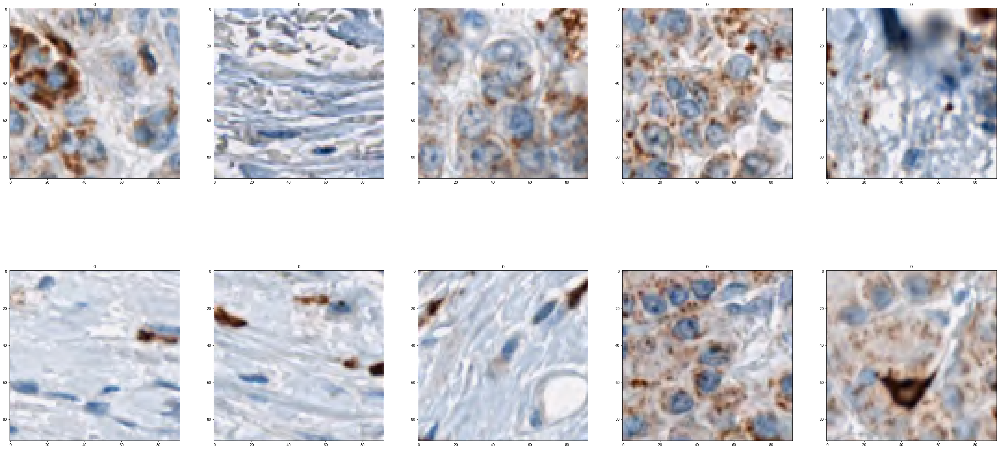

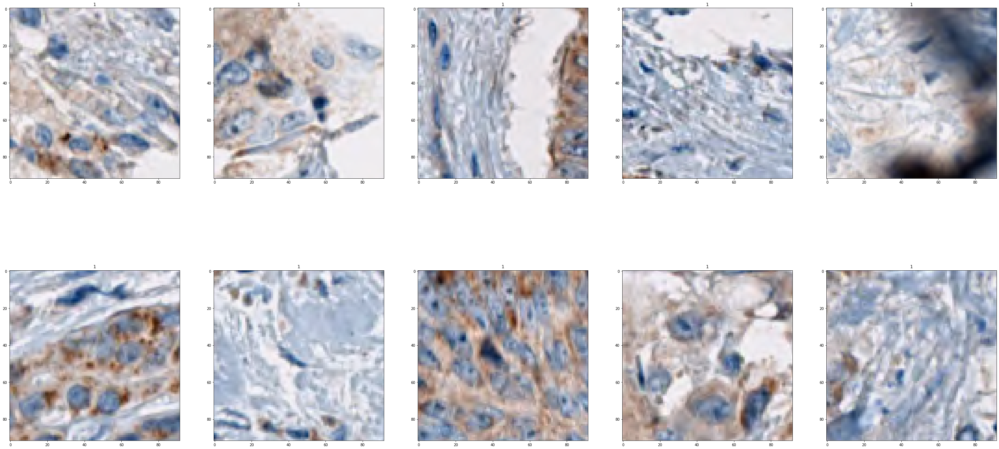

In [18]:
def show_bag(bag, label):
    label = label.numpy()[0]
    len_bag = bag.shape[1]
    f, ax = plt.subplots(2, 5, squeeze = False,
                        figsize = (50,25))
    for i in range(2):
        for j in range(5):
            index = i*5 + j
            img = bag[0,index,:,:,:].numpy().transpose((1,2,0))
            img = (img - np.min(img))/(np.max(img) - np.min(img))
            ax[i,j].imshow(img)
            ax[i,j].set_title(str(label))

for bag_idx, (bag, label) in enumerate(train_loader):
    if bag_idx < 2:
        print(bag.shape)
        print(label)
        bag = bag.cpu()
        label = label.cpu()
        show_bag(bag, label)

In [5]:
len_positive_bag = 0
len_negative_bag = 0
for bag_idx, (bag, label) in enumerate(train_loader):
    if label.numpy()[0] == 0:
        len_negative_bag += 1
    else:
        len_positive_bag += 1
print("There are {} positive bags, {} negative bags in train set".format(len_positive_bag, len_negative_bag))

len_positive_bag = 0
len_negative_bag = 0
for bag_idx, (bag, label) in enumerate(val_loader):
    if label.numpy()[0] == 0:
        len_negative_bag += 1
    else:
        len_positive_bag += 1
print("There are {} positive bags, {} negative bags in val set".format(len_positive_bag, len_negative_bag))

NameError: name 'train_loader' is not defined

# Model and train


In [5]:
# Suggestions: 
# reduce the number of filters:    12, 24, 32


class Attention_92(nn.Module):
    def __init__(self):
        super(Attention_92,self).__init__()
        self.L = 500
        self.D = 128
        self.K = 1
        
        self.dropout = nn.Dropout(p=0.5)

        self.feature_extractor_part1 = nn.Sequential(
            nn.Conv2d(3,20,kernel_size=5),
            nn.ReLU(),
            nn.MaxPool2d(2,stride=2),
            nn.Conv2d(20,50,kernel_size=5),
            nn.ReLU(),
            nn.MaxPool2d(2, stride=2),
            nn.Conv2d(50,60,kernel_size=5),
            nn.ReLU(),
            nn.MaxPool2d(2, stride=2)
        )
        self.feature_extractor_part2 = nn.Sequential(
            nn.Linear(60 * 8* 8, self.L),
            nn.ReLU()
        )
        self.attention = nn.Sequential(
            nn.Linear(self.L, self.D),
            nn.Tanh(),
            nn.Linear(self.D, self.K)
        )
        self.classifier = nn.Sequential(
            nn.Linear(self.L * self.K, 1),
            nn.Sigmoid()
        )
    def forward(self,x):
        x = x .squeeze(0)

        H = self.feature_extractor_part1(x)
        #print(H.shape)
        #H = H.view(-1, 60 * 8 * 8)
        H = torch.flatten(H, start_dim =1)
        #print(H.shape)
        H = self.dropout(H)
        #print(H.shape)
        H = self.feature_extractor_part2(H)

        A = self.attention(H)
        A = torch.transpose(A,1,0)
        A = F.softmax(A,dim=1)

        M = torch.mm(A,H)
        M = self.dropout(M)

        Y_prob = self.classifier(M)
        Y_hat = torch.ge(Y_prob,0.5).float()
        #print(Y_prob.shape, Y_hat.shape)

        return Y_prob, Y_hat, A

    def calculate_classification_error(self, X, Y):
        Y = Y.float()
        Y_prob, Y_hat,_ = self.forward(X)
        #print(Y, Y_hat, Y_hat.eq(Y))
        error = 1. - Y_hat.eq(Y).cpu().float().mean().data.item()

        return error, Y_hat, Y_prob
  
    def calculate_objective(self, X, Y):
        Y = Y.float()
        Y_prob, _, A = self.forward(X)
        Y_prob = torch.clamp(Y_prob, min=1e-5, max=1. - 1e-5)
        neg_log_likelihood =-1. * (Y * torch.log(Y_prob)+(1. - Y) * torch.log(1. - Y_prob))

        return neg_log_likelihood, A

In [6]:
# Suggestions: 
# reduce the number of filters:    12, 24, 32


class Attention_44(nn.Module):
    def __init__(self):
        super(Attention_44,self).__init__()
        self.L = 500
        self.D = 128
        self.K = 1
        
        self.dropout = nn.Dropout(p=0.5)

        self.feature_extractor_part1 = nn.Sequential(
            nn.Conv2d(3,16,kernel_size=5),
            nn.ReLU(),
            nn.MaxPool2d(2,stride=2),
            nn.Conv2d(16,32,kernel_size=5),
            nn.ReLU(),
            nn.MaxPool2d(2, stride=2),
        )
        self.feature_extractor_part2 = nn.Sequential(
            nn.Linear(32 * 8* 8, self.L),
            nn.ReLU()
        )
        self.attention = nn.Sequential(
            nn.Linear(self.L, self.D),
            nn.Tanh(),
            nn.Linear(self.D, self.K)
        )
        self.classifier = nn.Sequential(
            nn.Linear(self.L * self.K, 1),
            nn.Sigmoid()
        )
    def forward(self,x):
        x = x .squeeze(0)

        H = self.feature_extractor_part1(x)
        #print(H.shape)
        #H = H.view(-1, 60 * 8 * 8)
        H = torch.flatten(H, start_dim =1)
        #print(H.shape)
        H = self.dropout(H)
        #print(H.shape)
        H = self.feature_extractor_part2(H)

        A = self.attention(H)
        A = torch.transpose(A,1,0)
        A = F.softmax(A,dim=1)

        M = torch.mm(A,H)
        M = self.dropout(M)

        Y_prob = self.classifier(M)
        Y_hat = torch.ge(Y_prob,0.5).float()
        #print(Y_prob.shape, Y_hat.shape)

        return Y_prob, Y_hat, A

    def calculate_classification_error(self, X, Y):
        Y = Y.float()
        Y_prob, Y_hat,_ = self.forward(X)
        #print(Y, Y_hat, Y_hat.eq(Y))
        error = 1. - Y_hat.eq(Y).cpu().float().mean().data.item()

        return error, Y_hat, Y_prob
  
    def calculate_objective(self, X, Y):
        Y = Y.float()
        Y_prob, _, A = self.forward(X)
        Y_prob = torch.clamp(Y_prob, min=1e-5, max=1. - 1e-5)
        neg_log_likelihood =-1. * (Y * torch.log(Y_prob)+(1. - Y) * torch.log(1. - Y_prob))

        return neg_log_likelihood, A

In [7]:
def train(epoch, loader):
    model.train()
    train_loss = 0.
    train_error = 0.
    for batch_idx, (data, label) in enumerate(loader):
        bag_label = label
        data, bag_label = data.cuda(), bag_label.cuda()
        data, bag_label = Variable(data), Variable(bag_label)

        optimizer.zero_grad()
        loss, _ = model.calculate_objective(data, bag_label)
        train_loss += loss.data[0]
        error, _, _ =model.calculate_classification_error(data, bag_label)
        train_error += error
        loss.backward()
        optimizer.step()

    train_loss /= len(loader)
    train_error /= len(loader)
    print('Epoch: {}, Loss: {:.4f}, Train error : {:.4f}'.format(epoch, train_loss.cpu().numpy()[0], train_error))
    return 1 - train_error, train_loss.cpu().numpy()[0]

def test(loader):
    model.eval()
    test_loss = 0.
    test_error = 0.
    Y_probs = []
    Labels = []
    Attention_weights_positive_bags = []
    Attention_weights_negative_bags = []
    for batch_idx, (data, label) in enumerate(loader):
        bag_label = label
        data, bag_label = data.cuda(), bag_label.cuda()
        data, bag_label = Variable(data), Variable(bag_label)
        loss, attention_weights = model.calculate_objective(data, bag_label)
        test_loss += loss.data[0]
        error, predicted_label, Y_prob = model.calculate_classification_error(data, bag_label)
        test_error += error
        Y_probs.append(Y_prob.cpu().data.numpy()[0][0])
        Labels.append(label)
        if label.numpy()[0]==1:
            Attention_weights_positive_bags.extend(attention_weights.cpu().data.numpy()[0].tolist())
        else:
            Attention_weights_negative_bags.extend(attention_weights.cpu().data.numpy()[0].tolist())

    
    test_error /= len(loader)
    test_loss /= len(loader)
    return 1 - test_error, test_loss.cpu().numpy()[0], Y_probs, Labels, Attention_weights_positive_bags, Attention_weights_negative_bags

In [49]:
class Args:
    def __init__(self):
        self.root_dir_list=['D:/Ashel-slide/458599']
        self.patch_shape = (92,92)
        self.model = Attention_92()
        self.num_bag_train = 500
        self.num_bag_val = 500
        self.length_bag = 50
        self.seed = 1   
        self.epochs = 20
        self.lr = 0.0001
        self.reg = 10e-5
args = Args()
loader_kwards = {'num_workers':1, 'pin_memory':True} 
torch.cuda.manual_seed(args.seed)

In [43]:
Train_tumor_loader_list, val_tumor_loader, Train_stroma_loader_list, val_stroma_loader = prepare_data(args)

Tumor patches in training set: 8488
Stroma patches in training set: 14796
Tumor patches in validation set: 2122
Stroma patches in validation set: 3699
Fold 1, Tumor patches in sub-training set:2122
Fold 2, Tumor patches in sub-training set:2122
Fold 3, Tumor patches in sub-training set:2122
Fold 4, Tumor patches in sub-training set:2122
Fold 1, Stroma patches in sub-training set:3699
Fold 2, Stroma patches in sub-training set:3699
Fold 3, Stroma patches in sub-training set:3699
Fold 4, Stroma patches in sub-training set:3699


In [50]:
val_set = Pathology_Bags(tumor_loader = val_tumor_loader, 
                           stroma_loader = val_stroma_loader, 
                           num_bag = args.num_bag_val, 
                           length_bag = args.length_bag, 
                           seed = args.seed)
val_loader = data_utils.DataLoader(val_set, batch_size = 1, shuffle = False)

len_negative_bag = 0
len_positive_bag = 0
for bag_idx, (bag, label) in enumerate(val_loader):
    print(bag.shape)
    if label.numpy()[0] == 0:
        len_negative_bag += 1
    else:
        len_positive_bag += 1
print("There are {} positive bags, {} negative bags in validation set".format(len_positive_bag, len_negative_bag))

0
1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45
46
47
48
49
50
51
52
53
54
55
56
57
58
59
60
61
62
63
64
65
66
67
68
69
70
71
72
73
74
75
76
77
78
79
80
81
82
83
84
85
86
87
88
89
90
91
92
93
94
95
96
97
98
99
100
101
102
103
104
105
106
107
108
109
110
111
112
113
114
115
116
117
118
119
120
121
122
123
124
125
126
127
128
129
130
131
132
133
134
135
136
137
138
139
140
141
142
143
144
145
146
147
148
149
150
151
152
153
154
155
156
157
158
159
160
161
162
163
164
165
166
167
168
169
170
171
172
173
174
175
176
177
178
179
180
181
182
183
184
185
186
187
188
189
190
191
192
193
194
195
196
197
198
199
200
201
202
203
204
205
206
207
208
209
210
211
212
213
214
215
216
217
218
219
220
221
222
223
224
225
226
227
228
229
230
231
232
233
234
235
236
237
238
239
240
241
242
243
244
245
246
247
248
249
250
251
252
253
254
255
256
257
258
259
260
261
262
263
264
265
266
267
268
269
270
271
272
273
274
275
276
27

torch.Size([1, 50, 3, 92, 92])
torch.Size([1, 50, 3, 92, 92])
torch.Size([1, 50, 3, 92, 92])
torch.Size([1, 50, 3, 92, 92])
torch.Size([1, 50, 3, 92, 92])
torch.Size([1, 50, 3, 92, 92])
torch.Size([1, 50, 3, 92, 92])
torch.Size([1, 50, 3, 92, 92])
torch.Size([1, 50, 3, 92, 92])
torch.Size([1, 50, 3, 92, 92])
torch.Size([1, 50, 3, 92, 92])
torch.Size([1, 50, 3, 92, 92])
torch.Size([1, 50, 3, 92, 92])
torch.Size([1, 50, 3, 92, 92])
torch.Size([1, 50, 3, 92, 92])
torch.Size([1, 50, 3, 92, 92])
torch.Size([1, 50, 3, 92, 92])
torch.Size([1, 50, 3, 92, 92])
torch.Size([1, 50, 3, 92, 92])
torch.Size([1, 50, 3, 92, 92])
torch.Size([1, 50, 3, 92, 92])
torch.Size([1, 50, 3, 92, 92])
torch.Size([1, 50, 3, 92, 92])
torch.Size([1, 50, 3, 92, 92])
torch.Size([1, 50, 3, 92, 92])
torch.Size([1, 50, 3, 92, 92])
torch.Size([1, 50, 3, 92, 92])
torch.Size([1, 50, 3, 92, 92])
torch.Size([1, 50, 3, 92, 92])
torch.Size([1, 50, 3, 92, 92])
torch.Size([1, 50, 3, 92, 92])
torch.Size([1, 50, 3, 92, 92])
torch.Si

In [ ]:
model = args.model
model.cuda()
optimizer = optim.Adam(model.parameters(),lr=args.lr, betas=(0.9, 0.999), weight_decay =args.reg)
scheduler = torch.optim.lr_scheduler.StepLR(optimizer, step_size = 10, gamma = 0.5)



Train_accuracy = []
Val_accuracy = []
Loss_train = []
Loss_val = []
Epochs = np.arange(1,args.epochs+1).tolist()
for epoch in range(1,args.epochs+1):  
    train_set = Pathology_Bags(tumor_loader = Train_tumor_loader_list[epoch % 4], 
                           stroma_loader = Train_stroma_loader_list[epoch % 4], 
                           num_bag = args.num_bag_train, 
                           length_bag = args.length_bag, 
                           seed = args.seed)

    train_loader = data_utils.DataLoader(train_set, batch_size = 1, shuffle = True)
    
    train_accuracy, loss_train = train(epoch, train_loader)
    val_accuracy, loss_val, _, _, _, _ = test(val_loader)
    
    print("epoch = {}, accuracy in training set is {}, accuracy in valiation set is {}".format(epoch, train_accuracy, val_accuracy))
    print("epoch = {}, loss in training set is {}, loss in valiation set is {}".format(epoch, loss_train, loss_val))
    Train_accuracy.append(train_accuracy)
    Val_accuracy.append(val_accuracy)
    Loss_train.append(loss_train)
    Loss_val.append(loss_val)
    scheduler.step()

0
1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45
46
47
48
49
50
51
52
53
54
55
56
57
58
59
60
61
62
63
64
65
66
67
68
69
70
71
72
73
74
75
76
77
78
79
80
81
82
83
84
85
86
87
88
89
90
91
92
93
94
95
96
97
98
99
100
101
102
103
104
105
106
107
108
109
110
111
112
113
114
115
116
117
118
119
120
121
122
123
124
125
126
127
128
129
130
131
132
133
134
135
136
137
138
139
140
141
142
143
144
145
146
147
148
149
150
151
152
153
154
155
156
157
158
159
160
161
162
163
164
165
166
167
168
169
170
171
172
173
174
175
176
177
178
179
180
181
182
183
184
185
186
187
188
189
190
191
192
193
194
195
196
197
198
199
200
201
202
203
204
205
206
207
208
209
210
211
212
213
214
215
216
217
218
219
220
221
222
223
224
225
226
227
228
229
230
231
232
233
234
235
236
237
238
239
240
241
242
243
244
245
246
247
248
249
250
251
252
253
254
255
256
257
258
259
260
261
262
263
264
265
266
267
268
269
270
271
272
273
274
275
276
27

Epoch: 4, Loss: 0.2518, Train error : 0.0820
epoch = 4, accuracy in training set is 0.918, accuracy in valiation set is 0.874
epoch = 4, loss in training set is 0.251769095659256, loss in valiation set is 0.31544673442840576
0
1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45
46
47
48
49
50
51
52
53
54
55
56
57
58
59
60
61
62
63
64
65
66
67
68
69
70
71
72
73
74
75
76
77
78
79
80
81
82
83
84
85
86
87
88
89
90
91
92
93
94
95
96
97
98
99
100
101
102
103
104
105
106
107
108
109
110
111
112
113
114
115
116
117
118
119
120
121
122
123
124
125
126
127
128
129
130
131
132
133
134
135
136
137
138
139
140
141
142
143
144
145
146
147
148
149
150
151
152
153
154
155
156
157
158
159
160
161
162
163
164
165
166
167
168
169
170
171
172
173
174
175
176
177
178
179
180
181
182
183
184
185
186
187
188
189
190
191
192
193
194
195
196
197
198
199
200
201
202
203
204
205
206
207
208
209
210
211
212
213
214
215
216
217
218
219
220
2

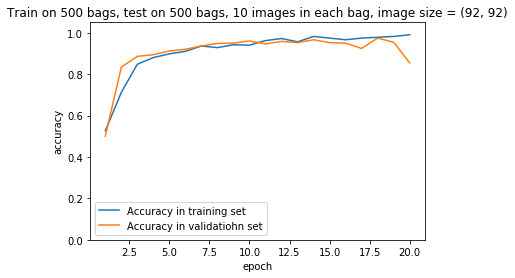

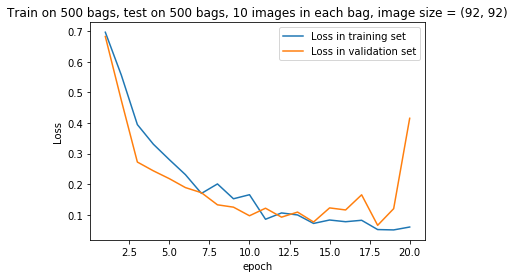

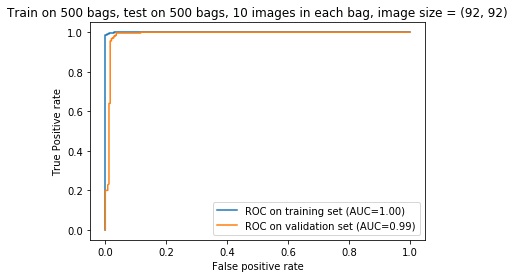

In [48]:
plt.figure()
plt.plot(Epochs, Train_accuracy, label = "Accuracy in training set")
plt.plot(Epochs, Val_accuracy, label = "Accuracy in validatiohn set")
plt.title("Train on {} bags, test on {} bags, {} images in each bag, image size = {}".format(int(args.num_bag_train),
                                                                                             int(args.num_bag_val),
                                                                                               args.length_bag,
                                                                                               args.patch_shape))
plt.ylim([0.0,1.05])
plt.xlabel("epoch")
plt.ylabel("accuracy")
plt.legend()

plt.figure()
plt.plot(Epochs, Loss_train, label = "Loss in training set")
plt.plot(Epochs, Loss_val, label = "Loss in validation set")
plt.title("Train on {} bags, test on {} bags, {} images in each bag, image size = {}".format(int(args.num_bag_train),
                                                                                             int(args.num_bag_val),
                                                                                               args.length_bag,
                                                                                               args.patch_shape))

plt.xlabel("epoch")
plt.ylabel("Loss")
plt.legend()

train_accuracy, train_loss, train_prob, train_labels, _, _ = test(train_loader)
val_accuracy, val_loss, val_prob, val_labels, _, _ = test(val_loader)
train_auc = roc_auc_score(train_labels, train_prob)
val_auc = roc_auc_score(val_labels, val_prob)
fpr_train, tpr_train, _ = roc_curve(train_labels, train_prob)
fpr_val, tpr_val, _ = roc_curve(val_labels, val_prob)
plt.figure()
plt.plot(fpr_train, tpr_train, label = "ROC on training set (AUC=%.2f)"%train_auc)
plt.plot(fpr_val, tpr_val, label = "ROC on validation set (AUC=%.2f)"%val_auc)
plt.title("Train on {} bags, test on {} bags, {} images in each bag, image size = {}".format(int(args.num_bag_train),
                                                                                             int(args.num_bag_val),
                                                                                               args.length_bag,
                                                                                               args.patch_shape))
plt.xlabel("False positive rate")
plt.ylabel("True Positive rate")
plt.legend()

In [41]:
torch.save(model.state_dict(), "model_44_10.pth")

### Calucalte loss on validation set
### Use different bags in each epoch
* Creat as many bags as possible and save in disk
* Save patch in memory. Create bags in each epoch

In [27]:
import matplotlib.patches as patches
def show_bag(instances,instance_level):
  # instance is a tensor with shape (1,num_instances,1,28,28
    instances_array = instances.cpu().detach().numpy()
    num_instances = instances_array.shape[1]
    weights = instance_level
    # highlight any instances whose weight is higher than 0.5
    #k = int(num_instances/5)
    #index_to_highlight = sorted(range(len(weights)), key= lambda x: weights[x])[-k:]
    index_to_highlight=[i for i in range(num_instances) if weights[i]>0.5]

    f,ax = plt.subplots(1, num_instances, squeeze=False, figsize=(3*num_instances, 3))
    for i in range(num_instances):
        title = "Weight="+str(weights[i])
        instance = instances_array[0,i,:,:,:].transpose((1,2,0))
        instance = (instance - np.min(instance))/(np.max(instance)-np.min(instance))
        ax[0,i].imshow(instance)
        ax[0,i].set_title(title)
        if i in set(index_to_highlight):
            rect = patches.Rectangle((0,0),91,91, linewidth=3, edgecolor='r', facecolor='none')
            ax[0,i].add_patch(rect)
    f.tight_layout()
    f.show()


Bag level prediction:  (1, 0.996906)
Instance level prediction  [0.0020000000949949026, 0.02500000037252903, 0.0020000000949949026, 0.0020000000949949026, 0.0020000000949949026, 0.003000000026077032, 0.0020000000949949026, 0.0020000000949949026, 0.0020000000949949026, 0.0020000000949949026, 0.009999999776482582, 0.05000000074505806, 0.3889999985694885, 0.0020000000949949026, 0.0020000000949949026, 0.032999999821186066, 0.0020000000949949026, 0.07199999690055847, 0.0020000000949949026, 0.0020000000949949026, 0.0020000000949949026, 0.04100000113248825, 0.0020000000949949026, 0.0020000000949949026, 0.004000000189989805, 0.0020000000949949026, 0.0020000000949949026, 0.004000000189989805, 0.13600000739097595, 0.0020000000949949026, 0.008999999612569809, 0.0020000000949949026, 0.0020000000949949026, 0.003000000026077032, 0.0020000000949949026, 0.0020000000949949026, 0.0020000000949949026, 0.0020000000949949026, 0.0820000022649765, 0.0020000000949949026, 0.006000000052154064, 0.0020000000949

C:\Users\Jasmine\AppData\Local\Continuum\anaconda3\envs\pytorch_gpu\lib\site-packages\ipykernel_launcher.py:23: UserWarning: Matplotlib is currently using module://ipykernel.pylab.backend_inline, which is a non-GUI backend, so cannot show the figure.



Bag level prediction:  (1, 0.85754335)
Instance level prediction  [0.004000000189989805, 0.004000000189989805, 0.004000000189989805, 0.004000000189989805, 0.004999999888241291, 0.004000000189989805, 0.006000000052154064, 0.004000000189989805, 0.004000000189989805, 0.013000000268220901, 0.004000000189989805, 0.004000000189989805, 0.004000000189989805, 0.004000000189989805, 0.004000000189989805, 0.004000000189989805, 0.004000000189989805, 0.004000000189989805, 0.006000000052154064, 0.004000000189989805, 0.004999999888241291, 0.004000000189989805, 0.004000000189989805, 0.004000000189989805, 0.026000000536441803, 0.050999999046325684, 0.640999972820282, 0.004000000189989805, 0.004999999888241291, 0.004000000189989805, 0.004000000189989805, 0.004000000189989805, 0.004000000189989805, 0.004000000189989805, 0.004000000189989805, 0.004000000189989805, 0.004000000189989805, 0.004000000189989805, 0.004999999888241291, 0.004999999888241291, 0.004000000189989805, 0.05299999937415123, 0.0109999999


Bag level prediction:  (1, 0.9967585)
Instance level prediction  [0.003000000026077032, 0.003000000026077032, 0.003000000026077032, 0.003000000026077032, 0.003000000026077032, 0.004000000189989805, 0.004000000189989805, 0.003000000026077032, 0.004000000189989805, 0.004999999888241291, 0.004000000189989805, 0.003000000026077032, 0.003000000026077032, 0.019999999552965164, 0.003000000026077032, 0.007000000216066837, 0.003000000026077032, 0.003000000026077032, 0.003000000026077032, 0.006000000052154064, 0.006000000052154064, 0.003000000026077032, 0.003000000026077032, 0.004000000189989805, 0.06400000303983688, 0.003000000026077032, 0.003000000026077032, 0.003000000026077032, 0.003000000026077032, 0.003000000026077032, 0.003000000026077032, 0.11999999731779099, 0.003000000026077032, 0.003000000026077032, 0.003000000026077032, 0.41100001335144043, 0.003000000026077032, 0.006000000052154064, 0.041999999433755875, 0.003000000026077032, 0.003000000026077032, 0.003000000026077032, 0.0080000003

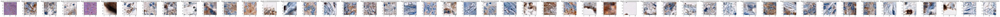

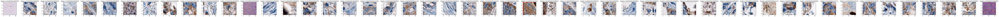

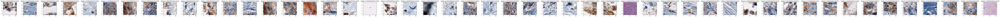

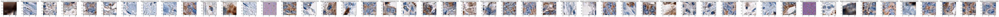

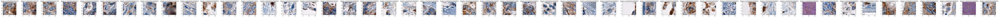

...

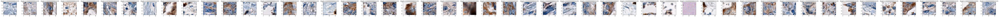

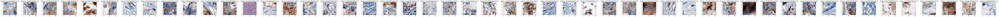

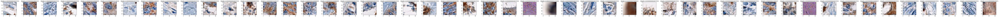

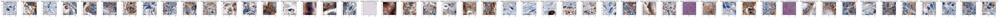

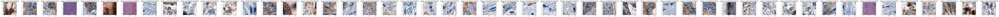

In [28]:
for batch_idx, (data, label) in enumerate(val_loader):
    if batch_idx > 10:
        break
    bag_label = label
    data, bag_label = data.cuda(), bag_label.cuda()
    data, bag_label = Variable(data), Variable(bag_label)
    _, attention_weights = model.calculate_objective(data, bag_label)
    _, _, prob_bag = model.calculate_classification_error(data, bag_label)
    bag_level = (bag_label.cpu().data.numpy()[0], prob_bag.cpu().data.numpy()[0][0])
    instance_level = np.round(attention_weights.cpu().data.numpy()[0], decimals=3).tolist()
    
    print("\nBag level prediction: ", bag_level)
    print("Instance level prediction ", instance_level)    
    show_bag (instances=data, instance_level=instance_level)


Bag level prediction:  (0, 0.0060367314)
Instance level prediction  [0.014999999664723873, 0.014999999664723873, 0.09600000083446503, 0.014999999664723873, 0.014999999664723873, 0.014999999664723873, 0.014999999664723873, 0.014999999664723873, 0.014999999664723873, 0.014999999664723873, 0.014999999664723873, 0.014999999664723873, 0.014999999664723873, 0.017000000923871994, 0.014999999664723873, 0.014999999664723873, 0.014999999664723873, 0.014999999664723873, 0.014999999664723873, 0.014999999664723873, 0.014999999664723873, 0.014999999664723873, 0.014999999664723873, 0.014999999664723873, 0.014999999664723873, 0.014999999664723873, 0.014999999664723873, 0.014999999664723873, 0.014999999664723873, 0.014999999664723873, 0.014999999664723873, 0.01600000075995922, 0.014999999664723873, 0.014999999664723873, 0.041999999433755875, 0.02500000037252903, 0.014999999664723873, 0.014999999664723873, 0.014999999664723873, 0.014999999664723873, 0.014999999664723873, 0.014999999664723873, 0.0149999

C:\Users\Jasmine\AppData\Local\Continuum\anaconda3\envs\pytorch_gpu\lib\site-packages\ipykernel_launcher.py:23: UserWarning: Matplotlib is currently using module://ipykernel.pylab.backend_inline, which is a non-GUI backend, so cannot show the figure.



Bag level prediction:  (0, 0.00040691296)
Instance level prediction  [0.020999999716877937, 0.019999999552965164, 0.019999999552965164, 0.019999999552965164, 0.019999999552965164, 0.019999999552965164, 0.019999999552965164, 0.019999999552965164, 0.019999999552965164, 0.019999999552965164, 0.019999999552965164, 0.019999999552965164, 0.019999999552965164, 0.019999999552965164, 0.019999999552965164, 0.02199999988079071, 0.019999999552965164, 0.019999999552965164, 0.019999999552965164, 0.019999999552965164, 0.019999999552965164, 0.019999999552965164, 0.019999999552965164, 0.019999999552965164, 0.019999999552965164, 0.019999999552965164, 0.019999999552965164, 0.019999999552965164, 0.019999999552965164, 0.020999999716877937, 0.019999999552965164, 0.019999999552965164, 0.019999999552965164, 0.019999999552965164, 0.024000000208616257, 0.019999999552965164, 0.019999999552965164, 0.019999999552965164, 0.019999999552965164, 0.019999999552965164, 0.019999999552965164, 0.019999999552965164, 0.0209


Bag level prediction:  (0, 0.0006847)
Instance level prediction  [0.026000000536441803, 0.024000000208616257, 0.01899999938905239, 0.028999999165534973, 0.01899999938905239, 0.020999999716877937, 0.01899999938905239, 0.01899999938905239, 0.01899999938905239, 0.01899999938905239, 0.01899999938905239, 0.01899999938905239, 0.01899999938905239, 0.01899999938905239, 0.01899999938905239, 0.019999999552965164, 0.01899999938905239, 0.01899999938905239, 0.01899999938905239, 0.01899999938905239, 0.020999999716877937, 0.01899999938905239, 0.019999999552965164, 0.01899999938905239, 0.01899999938905239, 0.01899999938905239, 0.01899999938905239, 0.01899999938905239, 0.01899999938905239, 0.01899999938905239, 0.01899999938905239, 0.039000000804662704, 0.01899999938905239, 0.01899999938905239, 0.01899999938905239, 0.01899999938905239, 0.01899999938905239, 0.01899999938905239, 0.01899999938905239, 0.01899999938905239, 0.01899999938905239, 0.01899999938905239, 0.01899999938905239, 0.01899999938905239, 0

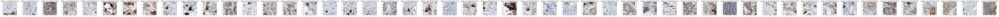

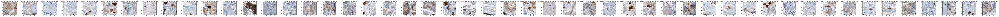

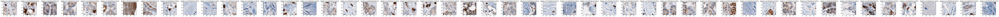

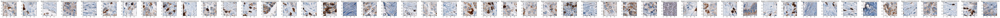

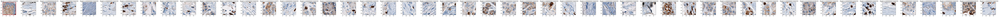

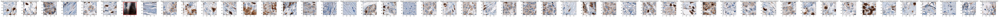

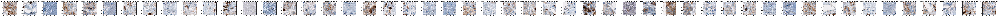

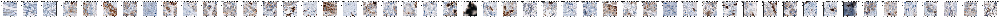

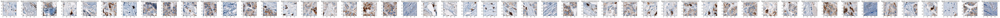

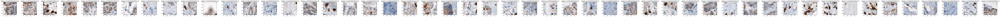

In [62]:
for batch_idx, (data, label) in enumerate(val_loader):
    if batch_idx < 90:
        continue
    bag_label = label
    data, bag_label = data.cuda(), bag_label.cuda()
    data, bag_label = Variable(data), Variable(bag_label)
    _, attention_weights = model.calculate_objective(data, bag_label)
    _, _, prob_bag = model.calculate_classification_error(data, bag_label)
    bag_level = (bag_label.cpu().data.numpy()[0], prob_bag.cpu().data.numpy()[0][0])
    instance_level = np.round(attention_weights.cpu().data.numpy()[0], decimals=3).tolist()
    
    print("\nBag level prediction: ", bag_level)
    print("Instance level prediction ", instance_level)    
    show_bag (instances=data, instance_level=instance_level)

There are 7 high-weighted instances in all


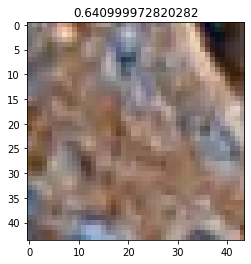

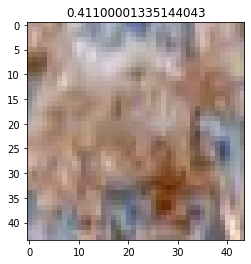

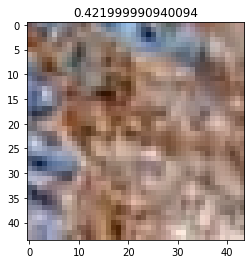

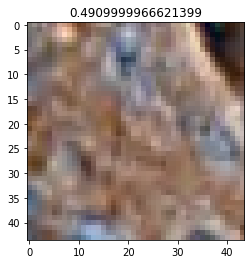

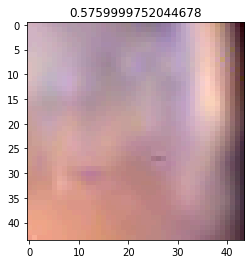

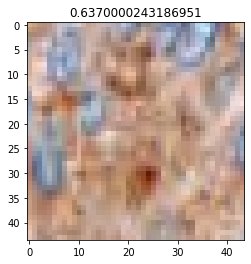

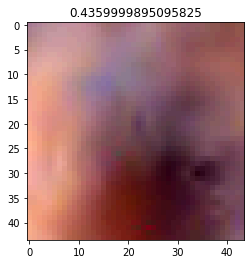

In [29]:
num = 0
for batch_idx, (data, label) in enumerate(val_loader):
    if batch_idx > 100:
        break
    bag_label = label
    data, bag_label = data.cuda(), bag_label.cuda()
    data, bag_label = Variable(data), Variable(bag_label)
    _, attention_weights = model.calculate_objective(data, bag_label)
    _, _, prob_bag = model.calculate_classification_error(data, bag_label)
    instance_level = np.round(attention_weights.cpu().data.numpy()[0], decimals=3).tolist()
    index_high_weighted = [i for i in range(len(instance_level)) if instance_level[i]> 0.4]
    if len(index_high_weighted)>0:
        instances_array = data.cpu().detach().numpy()
        for i in index_high_weighted:
            num+=1
            instance_high_weight = instances_array[0,i,:,:,:].transpose((1,2,0))
            instance = (instance_high_weight - np.min(instance_high_weight))/(np.max(instance_high_weight)-np.min(instance_high_weight))
            plt.figure()   
            plt.imshow(instance)
            plt.title(str(instance_level[i]))
print("There are {} high-weighted instances in all".format(num))

There are 15 high-weighted instances in all


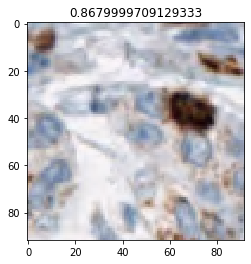

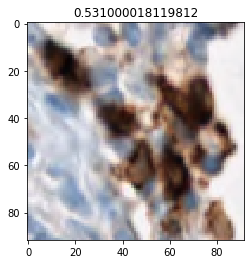

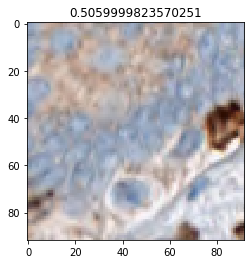

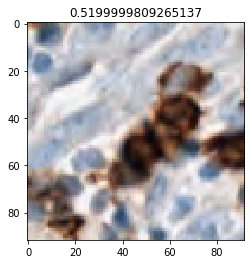

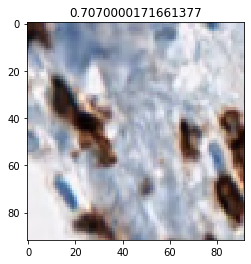

...

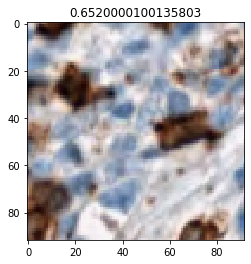

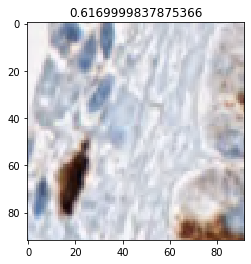

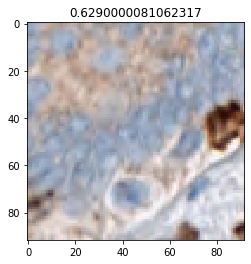

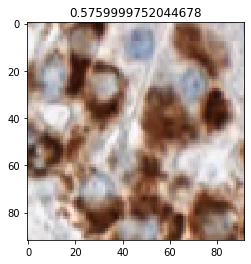

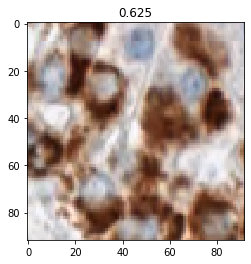

In [35]:
num = 0
for batch_idx, (data, label) in enumerate(val_loader):
    if batch_idx < 100:
        continue
    bag_label = label
    data, bag_label = data.cuda(), bag_label.cuda()
    data, bag_label = Variable(data), Variable(bag_label)
    _, attention_weights = model.calculate_objective(data, bag_label)
    _, _, prob_bag = model.calculate_classification_error(data, bag_label)
    instance_level = np.round(attention_weights.cpu().data.numpy()[0], decimals=3).tolist()
    index_high_weighted = [i for i in range(len(instance_level)) if instance_level[i]> 0.5 ]
    if len(index_high_weighted)>0:
        instances_array = data.cpu().detach().numpy()
        for i in index_high_weighted:
            num+=1
            instance_high_weight = instances_array[0,i,:,:,:].transpose((1,2,0))
            instance = (instance_high_weight - np.min(instance_high_weight))/(np.max(instance_high_weight)-np.min(instance_high_weight))
            plt.figure()   
            plt.imshow(instance)
            plt.title(str(instance_level[i]))
print("There are {} high-weighted instances in all".format(num))

There are 12500 instances in positive bags
There are 12500 instances in negative bags
3
6


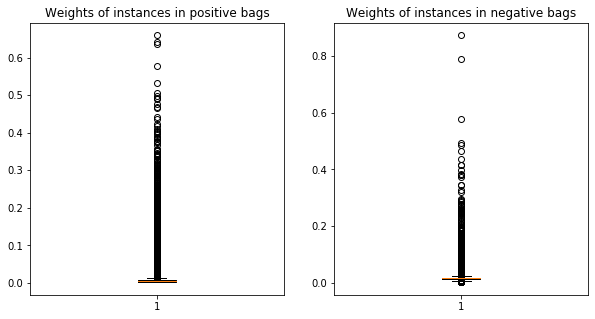

In [23]:
_, _,_,_, Attention_weights_positive_bags, Attention_weights_negative_bags  = test(val_loader)
fig, (ax1, ax2) = plt.subplots(1,2, figsize =(10,5))
ax1.boxplot(Attention_weights_positive_bags)
ax1.set_title("Weights of instances in positive bags")
ax2.boxplot(Attention_weights_negative_bags)
ax2.set_title("Weights of instances in negative bags")

print("There are {} instances in positive bags".format(len(Attention_weights_positive_bags)))
print("There are {} instances in negative bags".format(len(Attention_weights_negative_bags)))
print(len([i for i in Attention_weights_negative_bags if i>0.5 ]))
print(len([i for i in Attention_weights_positive_bags if i>0.5 ]))

In [29]:
print(len([i for i in Attention_weights_positive_bags if i<0.00001 ]))

60
